# AuxTel batoid input different amounts of  Zk4-10, fit with WEP and CWFS...

Last run: 2023-02-14
  
Versions:

    * ts_wep:  `v4.2.2` 
    * lsst_distrib `w2023_06` 
    * batoid: `0.4.0`

In [1]:
import numpy as np # standard package for doing calculations
import matplotlib.pyplot as plt # standard package for plotting

import batoid
import galsim

import sys
sys.path.append('/sdf/data/rubin/gpfs/ncsa-home/home/scichris/aos/wfsim/')
import wfsim

In [9]:
print(batoid.__version__)

0.4.0


In [11]:
print(galsim.__version__)

2.4.6


In [12]:
print(wfsim.__version__)

0.1.0


We want to simulate specific Zernike perturbations. We use phase screen. 

Wrap that simulation as a function:

In [2]:
def simulate_defocal_atmosphere(seed = 10, image_shape_x=1000,image_shape_y=1000,
                               nproc=6):
    ''' 
    Simulate auxTel atmosphere only, one intra and one extra-focal simulator.
    
    This is a workaround to allow simulating different zernikes, but 
    with the same telescope setup and atmosphere.
    
    For some reason, trying to re-simulate the atmosphere & zks in a loop
    fails (as of 2/1/2023) -the simulation never finishes. 
    
    
    '''

    auxtel = batoid.Optic.fromYaml("AuxTel.yaml")
    bandpass = galsim.Bandpass("LSST_r.dat", wave_type='nm')
    rng = np.random.default_rng(seed)

    # parameters associated with the observing conditions
    obs_params = {
        # zenith=0 means straight up, while zenith=90 is the horizon
        # greater zenith angle means more atmospheric turbulence
        "zenith": 30 * galsim.degrees,

        # raw_seeing sets how much atmospheric turbulence there is at zenith=0
        # wfsim uses this to calculate how much turbulence there is at 
        # the zenith angle given above
        "raw_seeing": 0.7 * galsim.arcsec,

        # these next three parameters set attributes of the atmosphere, which
        # help determine how much turbulence there is
        "temperature": 293, # Kelvin
        "pressure": 69, # kPa
        "H2O_pressure": 1, # kPa

        # wavelength of the observed light. this is important because light of 
        # longer/shorter wavelength refracts less/more in the atmosphere
        "wavelength": bandpass.effective_wavelength, # nanometers

        # the AuxTel exposure time
        "exptime": 30, # seconds
    }

    # parameters associated with computational aspects of simulating the atmosphere
    atm_params = {
        "screen_size": 204.8, # 819.2,
        "screen_scale": 0.1,
        "nproc": nproc,
        }

    intra = auxtel.withGloballyShiftedOptic(
        "M2", [0, 0, -0.0008]) # meters 
        
    extra = auxtel.withGloballyShiftedOptic(
        "M2", [0, 0, +0.0008])
        
    # Create an intra-focal simulator with just atmosphere:
    intra_simulator = wfsim.SimpleSimulator(
        obs_params,
        atm_params,
        intra,
        bandpass,
        shape=(image_shape_x, image_shape_y),
        rng=rng
    )
        
    # Create an extra-focal simulator with just atmosphere:
    extra_simulator = wfsim.SimpleSimulator(
        obs_params,
        atm_params,
        extra,
        bandpass,
        shape=(image_shape_x, image_shape_y),
        rng=rng
    )
        
    return intra_simulator, extra_simulator 



def simulate_zernike_screen(intra_simulator, extra_simulator, 
                            z_in = np.array([0, 0, 0, 0, 0, 0, 0, 0,0, 0, 300e-9, 0]),
                            thxDeg=0, thyDeg=39/3600,
                            outDir = 'DM-37629',
                            fname = f"auxTel_batoid_test_zk"
                           ):
    # since the wavelength is 622 nm, 
    # +/- 200 nm corresponds to +/- 0.3 waves of perturbation
    #z_in = rng.uniform(-200e-9, 200e-9, size=12)
    ''' 
    Simulate auxTel donuts with input Zernike wavefront as phase screen.
    
    NB: 
    z_in contains z0,z1,z2....z11   
    so eg. z_in = [0,0,0,200e-9,0,0...] means z3=200e-9 [m],
    i.e. 200 nm 
    
    NB: z_in must be in meters! 
    So  eg. result of ts_wep fit, which is in nanometers, 
    needs to be converted to meters ! 
    z_meters = z_nm  * 1e-9 

    thxDeg : x-position of a star in degrees 
    thyDeg : y-position of a star in degrees 
    
    '''

    auxtel = batoid.Optic.fromYaml("AuxTel.yaml")
    phase = batoid.Zernike(
        np.array(z_in),
        R_outer=0.6,
        R_inner=0.2115
    )
    perturbed_telescope = batoid.CompoundOptic(
                (
                batoid.optic.OPDScreen(
                    batoid.Plane(),
                    phase,
                    name='PhaseScreen',
                    obscuration=batoid.ObscNegation(batoid.ObscCircle(5.0)),
                    coordSys=auxtel.stopSurface.coordSys
                ),
                *auxtel.items
            ),
            name='PerturbedAuxTel',
            backDist=auxtel.backDist,
            pupilSize=auxtel.pupilSize,
            inMedium=auxtel.inMedium,
            stopSurface=auxtel.stopSurface,
            sphereRadius=auxtel.sphereRadius,
            pupilObscuration=auxtel.pupilObscuration
        )

    
    # choose a position for the star
    # these angles specify the angle from the optical axis to the star
    thx = np.deg2rad(thxDeg)
    thy = np.deg2rad(thyDeg)
    
        
    # Now run the image simulation:
    wavelength  =  intra_simulator.bandpass.effective_wavelength * 1e-9 # batoid wants meters 


    # NB: read out the zernikes BEFORE the telescope is shifted by +/- 8 mm ! 
    zk = batoid.zernike(perturbed_telescope, thx, thy, wavelength, eps=0.3525)
    zk *= wavelength  #  waves -> meters 
    
    
    # set the image simulator with the perturbed telescope 
    intra_perturbed_telescope = perturbed_telescope.withGloballyShiftedOptic("M2", [0, 0, -0.0008])    
    intra_simulator.telescope = intra_perturbed_telescope
    intra_simulator.image.setZero()

    
    extra_perturbed_telescope = perturbed_telescope.withGloballyShiftedOptic("M2", [0, 0, +0.0008])   
    extra_simulator.telescope = extra_perturbed_telescope
    extra_simulator.image.setZero()

    
    
    # create a spectrum for the star -- this is needed for chromatic refraction
    # we will randomly select a plausible star temperature, 
    # and calculate the corresponding blackbody spectrum
    rng = intra_simulator.rng
    star_temp = rng.uniform(4_000, 10_000) # Kelvin
    sed = wfsim.BBSED(star_temp) # wfsim has a function to calculate the blackbody spectrum

    # randomly choose a flux (must be an integer)
    flux = 1800000  #rng.integers(1_000_000, 2_000_000)

    intra_simulator.add_star(thx, thy, sed, flux, rng)
    extra_simulator.add_star(thx, thy, sed, flux, rng)
    
    fpath = os.path.join(outDir,fname)
    np.savez(fpath,
             intra=intra_simulator.image.array,
             extra=extra_simulator.image.array,
             zk=zk,
            )
    print(f'saved as {fname}')

    return 



Simulate atmosphere only once:

In [4]:
import time 
t1 = time.time()
intra_simulator, extra_simulator  = simulate_defocal_atmosphere(image_shape_x=500,image_shape_y=500)
t2 = time.time()
dt = t2-t1 #[seconds]
print(f'took {dt} seconds\n')

took 5.904366731643677 seconds



In [8]:
import time 

seed = 10
minZk = 4
maxZk = 23
minMagnitudeNm = 10
maxMagnitudeNm = 500
for i in range(minZk, maxZk):
    # i=10 gives zk9
    # i = 11  # i=11 gives zk10
    for f in np.linspace(minMagnitudeNm, maxMagnitudeNm, 15):
        z_in = np.zeros(maxZk) # always initialize array as empty...
        z_in[i] = f*1e-9
        print(i, z_in)
        t1 = time.time()
        #intra_image, extra_image, zk_true = simulate_auxtel_zernikes(seed = seed, z_in = z_in,
        #                        fname = f"auxtel_b_seed{seed}_image_truth_z{i}")

        simulate_zernike_screen(intra_simulator, extra_simulator, 
                                z_in = z_in,
                                thxDeg=0, thyDeg=39/3600,
                                outDir = 'DM-37629',
                                fname = f"auxTel_batoid_zk{i}_{int(f)}nm_500px"
                               )

        t2 = time.time()

        dt = t2-t1 #[seconds]
        print(f'took {dt} seconds\n')
print('All done! ')

4 [0.e+00 0.e+00 0.e+00 0.e+00 1.e-08 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00
 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00
 0.e+00 0.e+00 0.e+00]
saved as auxTel_batoid_zk4_10nm_500px
took 2.946437120437622 seconds

4 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 4.5e-08 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk4_45nm_500px
took 2.983311653137207 seconds

4 [0.e+00 0.e+00 0.e+00 0.e+00 8.e-08 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00
 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00
 0.e+00 0.e+00 0.e+00]
saved as auxTel_batoid_zk4_80nm_500px
took 2.6710922718048096 seconds

4 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 1.15e-07 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk4_115nm_500px
took 2.978818

saved as auxTel_batoid_zk6_45nm_500px
took 2.8397531509399414 seconds

6 [0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 8.e-08 0.e+00 0.e+00 0.e+00
 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00 0.e+00
 0.e+00 0.e+00 0.e+00]
saved as auxTel_batoid_zk6_80nm_500px
took 2.5883874893188477 seconds

6 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 1.15e-07 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk6_115nm_500px
took 2.536278486251831 seconds

6 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 1.5e-07 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk6_150nm_500px
took 2.607609510421753 seconds

6 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 1.85e-07 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+0

saved as auxTel_batoid_zk8_80nm_500px
took 2.657503843307495 seconds

8 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 1.15e-07 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk8_115nm_500px
took 2.840559482574463 seconds

8 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 1.5e-07
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk8_150nm_500px
took 2.8112289905548096 seconds

8 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 1.85e-07 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk8_185nm_500px
took 2.769120931625366 seconds

8 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 2.2e-07
 0.0e+00 0.0e+00 0.0e+00 

saved as auxTel_batoid_zk10_115nm_500px
took 2.5092623233795166 seconds

10 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 1.5e-07 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk10_150nm_500px
took 2.557537794113159 seconds

10 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 1.85e-07 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk10_185nm_500px
took 2.4419236183166504 seconds

10 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 2.2e-07 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk10_220nm_500px
took 2.4738147258758545 seconds

10 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 2.55e-07 0.00e+00 

saved as auxTel_batoid_zk12_150nm_500px
took 2.4872779846191406 seconds

12 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 1.85e-07 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk12_185nm_500px
took 2.5640532970428467 seconds

12 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 2.2e-07 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk12_220nm_500px
took 2.4352035522460938 seconds

12 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 2.55e-07 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk12_255nm_500px
took 2.572124481201172 seconds

12 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+

saved as auxTel_batoid_zk14_185nm_500px
took 2.5901360511779785 seconds

14 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 2.2e-07 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk14_220nm_500px
took 2.4694061279296875 seconds

14 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 2.55e-07 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk14_255nm_500px
took 2.3575642108917236 seconds

14 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 2.9e-07 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk14_290nm_500px
took 2.5783703327178955 seconds

14 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00

saved as auxTel_batoid_zk16_220nm_500px
took 2.541886806488037 seconds

16 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 2.55e-07 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk16_255nm_500px
took 2.4853458404541016 seconds

16 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 2.9e-07 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk16_290nm_500px
took 2.3502235412597656 seconds

16 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 3.25e-07 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk16_325nm_500px
took 2.366974115371704 seconds

16 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+0

saved as auxTel_batoid_zk18_255nm_500px
took 2.619741439819336 seconds

18 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 2.9e-07 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk18_290nm_500px
took 2.4309704303741455 seconds

18 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 3.25e-07 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk18_325nm_500px
took 2.496211528778076 seconds

18 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 3.6e-07 0.0e+00 0.0e+00 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk18_360nm_500px
took 2.3823044300079346 seconds

18 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0

saved as auxTel_batoid_zk20_290nm_500px
took 2.486166000366211 seconds

20 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 3.25e-07 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk20_325nm_500px
took 2.42864727973938 seconds

20 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 3.6e-07 0.0e+00 0.0e+00]
saved as auxTel_batoid_zk20_360nm_500px
took 2.4817378520965576 seconds

20 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 3.95e-07 0.00e+00 0.00e+00]
saved as auxTel_batoid_zk20_395nm_500px
took 2.554898500442505 seconds

20 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 

saved as auxTel_batoid_zk22_325nm_500px
took 2.4965853691101074 seconds

22 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 3.6e-07]
saved as auxTel_batoid_zk22_360nm_500px
took 2.5107581615448 seconds

22 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 3.95e-07]
saved as auxTel_batoid_zk22_395nm_500px
took 2.390899419784546 seconds

22 [0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00 0.0e+00
 0.0e+00 0.0e+00 0.0e+00 0.0e+00 4.3e-07]
saved as auxTel_batoid_zk22_430nm_500px
took 2.5965805053710938 seconds

22 [0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00
 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.0

Thanks to simulating only 500x500 px image, each sim only takes 2.7 sec! And re-using the atmosphere speeds things up, because that alone took ~6 sec. 

## Fit simulations with WEP 

Just use `onAxis` as a better tested model + each source is basically in the middle of the optical axis.

First, find donuts with `GenerateDonutDirectDetectTask`. To use that, I make each image into an `exposure`. The `donutCatalogs` are saved, and used in a separate loop to make cutouts with `CutOutDonutsScienceSensorTask`. The resulting `donutStamps`  are stored again, and passed together with exposures, to `CalcZernikesTask`, as well as `WEP` or `CWFS` directly. 

In [15]:

from lsst.ts.wep.task.GenerateDonutDirectDetectTask import (
    GenerateDonutDirectDetectTaskConfig, GenerateDonutDirectDetectTask
)

from lsst.ts.wep.task.CutOutDonutsScienceSensorTask import (
    CutOutDonutsScienceSensorTaskConfig, CutOutDonutsScienceSensorTask
)

from lsst.ts.wep.task.CalcZernikesTask import (
    CalcZernikesTask, CalcZernikesTaskConfig
)

from lsst.obs.lsst import Latiss

import analysis_tools as at
# Load a saved simulation image

from copy import copy

minZk = 4
maxZk = 23
minMagnitudeNm = 10
maxMagnitudeNm = 500
for i in range(minZk, maxZk):

    # store separate donut catalog for all magnitudes of a 
    # given Zk # ...
    donut_catalog = {}
    for f in np.linspace(minMagnitudeNm, maxMagnitudeNm, 15):

        donut_catalog[f] = {}
        fname = f"auxTel_batoid_zk{i}_{int(f)}nm_500px.npz"
        fpath = os.path.join('DM-37629',fname)
        print(f'loading {fpath}')
        
        npz = np.load(fpath)
        intra_image = npz['intra']
        extra_image = npz['extra']
        zk = npz['zk']

        # make exposure
        intra_exposure = at.make_exposure(intra_image, focusZ=0.8)
        extra_exposure = at.make_exposure(extra_image, focusZ=-0.8)
        print(id(intra_exposure))

        # common settings for donut detection task,
        # donut cutting out task zernike estimation task...

        focalLength = 21.6 # meters 
        obscuration = 0.3525 # ratio 
        apertureDiameter = 1.2 # meters 
        defocalOffset = 32.8 
        pixelSize = 10.0e-6 # meters 
        opticalModel = 'onAxis'
        
        # pass to WEP, fit transposed and untransposed 
        newConfig = GenerateDonutDirectDetectTaskConfig()
        newConfig.measurementTask.nSigmaDetection = 5
        newConfig.initialCutoutPadding = 40

        # Set auxTel parameters
        newConfig.instObscuration = obscuration
        newConfig.instFocalLength = focalLength
        newConfig.instApertureDiameter = apertureDiameter
        newConfig.instDefocalOffset = defocalOffset
        newConfig.instPixelSize = pixelSize
        newConfig.opticalModel = opticalModel

        # Set donut selection parameters
        newConfig.donutSelector.useCustomMagLimit = True
        newConfig.donutSelector.magMin = 8.
        newConfig.donutSelector.magMax = 20.
        newConfig.donutSelector.unblendedSeparation = 200


        camera = Latiss().getCamera()
        newTask = GenerateDonutDirectDetectTask(config=newConfig)
        donut_catalog_intra = newTask.run(copy(intra_exposure), camera).donutCatalog
        donut_catalog_extra = newTask.run(copy(extra_exposure), camera).donutCatalog
        donut_catalog[f]['intra'] = donut_catalog_intra
        donut_catalog[f]['extra'] = donut_catalog_extra 

    # store donut catalog for the future use...
    fpath = os.path.join('DM-37629',
                         f'auxTel_batoid_zk{i}_{int(f)}nm_500px_donut_catalogs')
    np.savez(fpath,
                 donutcat=donut_catalog
            )
    print(f'saved as {fpath}')
print('All done! ')

INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector


loading DM-37629/auxTel_batoid_zk4_10nm_500px.npz
140636339880240


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk4_45nm_500px.npz
140636374758320
loading DM-37629/auxTel_batoid_zk4_80nm_500px.npz
140636336678448


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk4_115nm_500px.npz
140636338050864
loading DM-37629/auxTel_batoid_zk4_150nm_500px.npz
140636338056112


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk4_185nm_500px.npz
140636383123120
loading DM-37629/auxTel_batoid_zk4_220nm_500px.npz
140636383213744


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk4_255nm_500px.npz
140636335608880
loading DM-37629/auxTel_batoid_zk4_290nm_500px.npz
140636335821488


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk4_325nm_500px.npz
140636336725040


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector


loading DM-37629/auxTel_batoid_zk4_360nm_500px.npz
140636333930160
loading DM-37629/auxTel_batoid_zk4_395nm_500px.npz
140636333967472


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk4_430nm_500px.npz
140636335950320
loading DM-37629/auxTel_batoid_zk4_465nm_500px.npz
140655759138800


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk4_500nm_500px.npz
140636338056112
saved as DM-37629/auxTel_batoid_zk4_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk5_10nm_500px.npz
140636335749104


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk5_45nm_500px.npz
140636493550320
loading DM-37629/auxTel_batoid_zk5_80nm_500px.npz
140636335514096


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk5_115nm_500px.npz
140636334026416
loading DM-37629/auxTel_batoid_zk5_150nm_500px.npz
140636339665968


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector


loading DM-37629/auxTel_batoid_zk5_185nm_500px.npz
140636336090032


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure


loading DM-37629/auxTel_batoid_zk5_220nm_500px.npz
140636334174960
loading DM-37629/auxTel_batoid_zk5_255nm_500px.npz
140636335196720


INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running D

loading DM-37629/auxTel_batoid_zk5_290nm_500px.npz
140636334173296
loading DM-37629/auxTel_batoid_zk5_325nm_500px.npz
140636333968496


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk5_360nm_500px.npz
140636336721520
loading DM-37629/auxTel_batoid_zk5_395nm_500px.npz
140636335552560


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk5_430nm_500px.npz
140636335716464
loading DM-37629/auxTel_batoid_zk5_465nm_500px.npz
140636334418096


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk5_500nm_500px.npz
140636335661680
saved as DM-37629/auxTel_batoid_zk5_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk6_10nm_500px.npz
140636422974640


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk6_45nm_500px.npz
140636910967920
loading DM-37629/auxTel_batoid_zk6_80nm_500px.npz
140636334293552


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk6_115nm_500px.npz
140636368043440
loading DM-37629/auxTel_batoid_zk6_150nm_500px.npz
140636334027312


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk6_185nm_500px.npz
140636336066544
loading DM-37629/auxTel_batoid_zk6_220nm_500px.npz
140636335825904


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk6_255nm_500px.npz
140636334600368
loading DM-37629/auxTel_batoid_zk6_290nm_500px.npz
140636339608432


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure


loading DM-37629/auxTel_batoid_zk6_325nm_500px.npz
140636336090800


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references


loading DM-37629/auxTel_batoid_zk6_360nm_500px.npz
140636335553840
loading DM-37629/auxTel_batoid_zk6_395nm_500px.npz
140636335206768


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk6_430nm_500px.npz
140636339665520
loading DM-37629/auxTel_batoid_zk6_465nm_500px.npz
140636333926320


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk6_500nm_500px.npz
140636335710064
saved as DM-37629/auxTel_batoid_zk6_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk7_10nm_500px.npz
140636333930992


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk7_45nm_500px.npz
140636334663920
loading DM-37629/auxTel_batoid_zk7_80nm_500px.npz
140636334662384


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk7_115nm_500px.npz
140636334664112
loading DM-37629/auxTel_batoid_zk7_150nm_500px.npz
140636374823536


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk7_185nm_500px.npz
140636335577520
loading DM-37629/auxTel_batoid_zk7_220nm_500px.npz
140636334464304


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk7_255nm_500px.npz
140636335782640
loading DM-37629/auxTel_batoid_zk7_290nm_500px.npz
140636334304240


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk7_325nm_500px.npz
140636335715760
loading DM-37629/auxTel_batoid_zk7_360nm_500px.npz
140636332896368


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk7_395nm_500px.npz
140636336747696
loading DM-37629/auxTel_batoid_zk7_430nm_500px.npz
140636334168496


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk7_465nm_500px.npz
140636383673584
loading DM-37629/auxTel_batoid_zk7_500nm_500px.npz
140636335768816


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

saved as DM-37629/auxTel_batoid_zk7_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk8_10nm_500px.npz
140636339649840
loading DM-37629/auxTel_batoid_zk8_45nm_500px.npz
140636335512048


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk8_80nm_500px.npz
140636333927024
loading DM-37629/auxTel_batoid_zk8_115nm_500px.npz
140636335198256


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk8_150nm_500px.npz
140636335092656
loading DM-37629/auxTel_batoid_zk8_185nm_500px.npz
140636334425328


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk8_220nm_500px.npz
140636334588464
loading DM-37629/auxTel_batoid_zk8_255nm_500px.npz
140636334704240


INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running D

loading DM-37629/auxTel_batoid_zk8_290nm_500px.npz
140636335094064
loading DM-37629/auxTel_batoid_zk8_325nm_500px.npz
140636333038448


INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running D

loading DM-37629/auxTel_batoid_zk8_360nm_500px.npz
140636334173360
loading DM-37629/auxTel_batoid_zk8_395nm_500px.npz
140636334591920


INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running D

loading DM-37629/auxTel_batoid_zk8_430nm_500px.npz
140636336081904
loading DM-37629/auxTel_batoid_zk8_465nm_500px.npz
140636333038768


INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running D

loading DM-37629/auxTel_batoid_zk8_500nm_500px.npz
140636333205680
saved as DM-37629/auxTel_batoid_zk8_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk9_10nm_500px.npz
140636332982192


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk9_45nm_500px.npz
140636368101808
loading DM-37629/auxTel_batoid_zk9_80nm_500px.npz
140636335708080


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk9_115nm_500px.npz
140636333211376
loading DM-37629/auxTel_batoid_zk9_150nm_500px.npz
140636334783600


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk9_185nm_500px.npz
140636334661232
loading DM-37629/auxTel_batoid_zk9_220nm_500px.npz
140636334554864


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk9_255nm_500px.npz
140636339614704
loading DM-37629/auxTel_batoid_zk9_290nm_500px.npz
140636333406128


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk9_325nm_500px.npz
140636335547312
loading DM-37629/auxTel_batoid_zk9_360nm_500px.npz
140636335209392


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk9_395nm_500px.npz
140636333931056
loading DM-37629/auxTel_batoid_zk9_430nm_500px.npz
140636335779376


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk9_465nm_500px.npz
140636335032112
loading DM-37629/auxTel_batoid_zk9_500nm_500px.npz
140636383247600


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

saved as DM-37629/auxTel_batoid_zk9_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk10_10nm_500px.npz
140636335030832
loading DM-37629/auxTel_batoid_zk10_45nm_500px.npz
140636335032944


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk10_80nm_500px.npz
140636333518832
loading DM-37629/auxTel_batoid_zk10_115nm_500px.npz
140636333481456


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk10_150nm_500px.npz
140636335750640
loading DM-37629/auxTel_batoid_zk10_185nm_500px.npz
140636334415920


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk10_220nm_500px.npz
140636335521008
loading DM-37629/auxTel_batoid_zk10_255nm_500px.npz
140636334167600


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk10_290nm_500px.npz
140636336747696
loading DM-37629/auxTel_batoid_zk10_325nm_500px.npz
140636335911856


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk10_360nm_500px.npz
140636336735152
loading DM-37629/auxTel_batoid_zk10_395nm_500px.npz
140636333812464


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk10_430nm_500px.npz
140636333810608
loading DM-37629/auxTel_batoid_zk10_465nm_500px.npz
140636334295152


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk10_500nm_500px.npz
140636333679088
saved as DM-37629/auxTel_batoid_zk10_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk11_10nm_500px.npz
140636334309168


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk11_45nm_500px.npz
140636335660272
loading DM-37629/auxTel_batoid_zk11_80nm_500px.npz
140636335466416


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk11_115nm_500px.npz
140636334771696
loading DM-37629/auxTel_batoid_zk11_150nm_500px.npz
140636335712368


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk11_185nm_500px.npz
140636334594736
loading DM-37629/auxTel_batoid_zk11_220nm_500px.npz
140636334602672


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk11_255nm_500px.npz
140636335911536
loading DM-37629/auxTel_batoid_zk11_290nm_500px.npz
140636332891312


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk11_325nm_500px.npz
140636335668080
loading DM-37629/auxTel_batoid_zk11_360nm_500px.npz
140636333808944


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk11_395nm_500px.npz
140636331859248
loading DM-37629/auxTel_batoid_zk11_430nm_500px.npz
140636331930224


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk11_465nm_500px.npz
140636334302960
loading DM-37629/auxTel_batoid_zk11_500nm_500px.npz
140636334301232


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

saved as DM-37629/auxTel_batoid_zk11_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk12_10nm_500px.npz
140636334285296
loading DM-37629/auxTel_batoid_zk12_45nm_500px.npz
140636332978736


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk12_80nm_500px.npz
140636335207152
loading DM-37629/auxTel_batoid_zk12_115nm_500px.npz
140636335817264


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk12_150nm_500px.npz
140636337006064
loading DM-37629/auxTel_batoid_zk12_185nm_500px.npz
140636336735152


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk12_220nm_500px.npz
140636335820208
loading DM-37629/auxTel_batoid_zk12_255nm_500px.npz
140636337002480


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk12_290nm_500px.npz
140636332235760
loading DM-37629/auxTel_batoid_zk12_325nm_500px.npz
140636333214192


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk12_360nm_500px.npz
140636333259696
loading DM-37629/auxTel_batoid_zk12_395nm_500px.npz
140636333676912


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk12_430nm_500px.npz
140636335205040
loading DM-37629/auxTel_batoid_zk12_465nm_500px.npz
140636333673136


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk12_500nm_500px.npz
140636331932400
saved as DM-37629/auxTel_batoid_zk12_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk13_10nm_500px.npz
140636334194736


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk13_45nm_500px.npz
140636336306352
loading DM-37629/auxTel_batoid_zk13_80nm_500px.npz
140636335706736


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk13_115nm_500px.npz
140636334299504
loading DM-37629/auxTel_batoid_zk13_150nm_500px.npz
140636332049776


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk13_185nm_500px.npz
140636383181808
loading DM-37629/auxTel_batoid_zk13_220nm_500px.npz
140636335204272


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk13_255nm_500px.npz
140636334024176
loading DM-37629/auxTel_batoid_zk13_290nm_500px.npz
140636335909104


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk13_325nm_500px.npz
140636335550384
loading DM-37629/auxTel_batoid_zk13_360nm_500px.npz
140636332330288


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk13_395nm_500px.npz
140636332629168
loading DM-37629/auxTel_batoid_zk13_430nm_500px.npz
140636332622704


INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running D

loading DM-37629/auxTel_batoid_zk13_465nm_500px.npz
140636331854832
loading DM-37629/auxTel_batoid_zk13_500nm_500px.npz
140636383172784


INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running D

saved as DM-37629/auxTel_batoid_zk13_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk14_10nm_500px.npz
140636332603440
loading DM-37629/auxTel_batoid_zk14_45nm_500px.npz
140636333126320


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk14_80nm_500px.npz
140636332484336
loading DM-37629/auxTel_batoid_zk14_115nm_500px.npz
140636332354608


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk14_150nm_500px.npz
140636336680688
loading DM-37629/auxTel_batoid_zk14_185nm_500px.npz
140636345693616


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk14_220nm_500px.npz
140636334661040
loading DM-37629/auxTel_batoid_zk14_255nm_500px.npz
140636334195632


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk14_290nm_500px.npz
140636332740400
loading DM-37629/auxTel_batoid_zk14_325nm_500px.npz
140636336723760


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk14_360nm_500px.npz
140636332013616
loading DM-37629/auxTel_batoid_zk14_395nm_500px.npz
140636332356336


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk14_430nm_500px.npz
140636335713072
loading DM-37629/auxTel_batoid_zk14_465nm_500px.npz
140636332839600


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk14_500nm_500px.npz
140636332842480
saved as DM-37629/auxTel_batoid_zk14_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk15_10nm_500px.npz
140636332015088


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk15_45nm_500px.npz
140636340049072
loading DM-37629/auxTel_batoid_zk15_80nm_500px.npz
140636339634480


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk15_115nm_500px.npz
140636334779952
loading DM-37629/auxTel_batoid_zk15_150nm_500px.npz
140636335547120


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk15_185nm_500px.npz
140636333587440
loading DM-37629/auxTel_batoid_zk15_220nm_500px.npz
140636336307184


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk15_255nm_500px.npz
140636335774192
loading DM-37629/auxTel_batoid_zk15_290nm_500px.npz
140636331031216


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk15_325nm_500px.npz
140636331023344
loading DM-37629/auxTel_batoid_zk15_360nm_500px.npz
140636339717040


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk15_395nm_500px.npz
140636331859312
loading DM-37629/auxTel_batoid_zk15_430nm_500px.npz
140636333670896


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk15_465nm_500px.npz
140636334838064
loading DM-37629/auxTel_batoid_zk15_500nm_500px.npz
140636332055664


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

saved as DM-37629/auxTel_batoid_zk15_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk16_10nm_500px.npz
140636335954736
loading DM-37629/auxTel_batoid_zk16_45nm_500px.npz
140636334666608


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk16_80nm_500px.npz
140636332804400
loading DM-37629/auxTel_batoid_zk16_115nm_500px.npz
140636332482928


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk16_150nm_500px.npz
140636334197168
loading DM-37629/auxTel_batoid_zk16_185nm_500px.npz
140636332807792


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk16_220nm_500px.npz
140636335661872
loading DM-37629/auxTel_batoid_zk16_255nm_500px.npz
140636336727024


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk16_290nm_500px.npz
140636335584624
loading DM-37629/auxTel_batoid_zk16_325nm_500px.npz
140636335767664


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk16_360nm_500px.npz
140636339717040
loading DM-37629/auxTel_batoid_zk16_395nm_500px.npz
140636331346608


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk16_430nm_500px.npz
140636331440752
loading DM-37629/auxTel_batoid_zk16_465nm_500px.npz
140636331240944


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk16_500nm_500px.npz
140636333829552
saved as DM-37629/auxTel_batoid_zk16_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk17_10nm_500px.npz
140636331378160


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk17_45nm_500px.npz
140636336690544
loading DM-37629/auxTel_batoid_zk17_80nm_500px.npz
140636333809712


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk17_115nm_500px.npz
140636332744048
loading DM-37629/auxTel_batoid_zk17_150nm_500px.npz
140636332895984


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk17_185nm_500px.npz
140636331590384
loading DM-37629/auxTel_batoid_zk17_220nm_500px.npz
140636333558192


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk17_255nm_500px.npz
140636331601456
loading DM-37629/auxTel_batoid_zk17_290nm_500px.npz
140636337009584


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk17_325nm_500px.npz
140636333972464
loading DM-37629/auxTel_batoid_zk17_360nm_500px.npz
140636332348912


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk17_395nm_500px.npz
140636331235184
loading DM-37629/auxTel_batoid_zk17_430nm_500px.npz
140636331377520


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk17_465nm_500px.npz
140636331925040
loading DM-37629/auxTel_batoid_zk17_500nm_500px.npz
140636331763632


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

saved as DM-37629/auxTel_batoid_zk17_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk18_10nm_500px.npz
140636331694448
loading DM-37629/auxTel_batoid_zk18_45nm_500px.npz
140636332343920


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk18_80nm_500px.npz
140636332234544
loading DM-37629/auxTel_batoid_zk18_115nm_500px.npz
140636332800688


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk18_150nm_500px.npz
140636335471600
loading DM-37629/auxTel_batoid_zk18_185nm_500px.npz
140636331238192


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk18_220nm_500px.npz
140636333519984
loading DM-37629/auxTel_batoid_zk18_255nm_500px.npz
140636330858032


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk18_290nm_500px.npz
140636332837616
loading DM-37629/auxTel_batoid_zk18_325nm_500px.npz
140636329785520


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk18_360nm_500px.npz
140636332844528
loading DM-37629/auxTel_batoid_zk18_395nm_500px.npz
140636334284656


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk18_430nm_500px.npz
140636332049328
loading DM-37629/auxTel_batoid_zk18_465nm_500px.npz
140636336733936


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk18_500nm_500px.npz
140636329779504
saved as DM-37629/auxTel_batoid_zk18_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk19_10nm_500px.npz
140636331608368


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk19_45nm_500px.npz
140636335046576
loading DM-37629/auxTel_batoid_zk19_80nm_500px.npz
140636329944752


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk19_115nm_500px.npz
140636331604656
loading DM-37629/auxTel_batoid_zk19_150nm_500px.npz
140636329948144


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk19_185nm_500px.npz
140636331600048
loading DM-37629/auxTel_batoid_zk19_220nm_500px.npz
140636333677424


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk19_255nm_500px.npz
140636334284656
loading DM-37629/auxTel_batoid_zk19_290nm_500px.npz
140636330013552


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk19_325nm_500px.npz
140636335828528
loading DM-37629/auxTel_batoid_zk19_360nm_500px.npz
140636331663920


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk19_395nm_500px.npz
140636330252784
loading DM-37629/auxTel_batoid_zk19_430nm_500px.npz
140636330133488


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk19_465nm_500px.npz
140636330247216
loading DM-37629/auxTel_batoid_zk19_500nm_500px.npz
140636335552496


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

saved as DM-37629/auxTel_batoid_zk19_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk20_10nm_500px.npz
140636335780976
loading DM-37629/auxTel_batoid_zk20_45nm_500px.npz
140636337007088


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk20_80nm_500px.npz
140636331591472
loading DM-37629/auxTel_batoid_zk20_115nm_500px.npz
140636331465776


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk20_150nm_500px.npz
140636331253680
loading DM-37629/auxTel_batoid_zk20_185nm_500px.npz
140636331922160


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk20_220nm_500px.npz
140636334167792
loading DM-37629/auxTel_batoid_zk20_255nm_500px.npz
140636333569200


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk20_290nm_500px.npz
140636332800048
loading DM-37629/auxTel_batoid_zk20_325nm_500px.npz
140636330357488


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk20_360nm_500px.npz
140636331694768
loading DM-37629/auxTel_batoid_zk20_395nm_500px.npz
140636330134320


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk20_430nm_500px.npz
140636332408496
loading DM-37629/auxTel_batoid_zk20_465nm_500px.npz
140636331910448


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk20_500nm_500px.npz
140636330466480
saved as DM-37629/auxTel_batoid_zk20_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk21_10nm_500px.npz
140636335821040


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk21_45nm_500px.npz
140636334778096
loading DM-37629/auxTel_batoid_zk21_80nm_500px.npz
140636334783984


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk21_115nm_500px.npz
140636332477488
loading DM-37629/auxTel_batoid_zk21_150nm_500px.npz
140636332629424


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk21_185nm_500px.npz
140636333566256
loading DM-37629/auxTel_batoid_zk21_220nm_500px.npz
140636331354928


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk21_255nm_500px.npz
140636333673264
loading DM-37629/auxTel_batoid_zk21_290nm_500px.npz
140636330661360


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk21_325nm_500px.npz
140636332049008
loading DM-37629/auxTel_batoid_zk21_360nm_500px.npz
140636331511216


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk21_395nm_500px.npz
140636331605104
loading DM-37629/auxTel_batoid_zk21_430nm_500px.npz
140636330133872


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk21_465nm_500px.npz
140636332366320
loading DM-37629/auxTel_batoid_zk21_500nm_500px.npz
140636332372848


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

saved as DM-37629/auxTel_batoid_zk21_500nm_500px_donut_catalogs
loading DM-37629/auxTel_batoid_zk22_10nm_500px.npz
140636330355696
loading DM-37629/auxTel_batoid_zk22_45nm_500px.npz
140636332507376


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk22_80nm_500px.npz
140636333681200
loading DM-37629/auxTel_batoid_zk22_115nm_500px.npz
140636330285744


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk22_150nm_500px.npz
140636329852400
loading DM-37629/auxTel_batoid_zk22_185nm_500px.npz
140636332286192


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk22_220nm_500px.npz
140636335703280
loading DM-37629/auxTel_batoid_zk22_255nm_500px.npz
140636331605040


INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSele

loading DM-37629/auxTel_batoid_zk22_290nm_500px.npz
140636331351664
loading DM-37629/auxTel_batoid_zk22_325nm_500px.npz
140636330018928


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk22_360nm_500px.npz
140636332489328
loading DM-37629/auxTel_batoid_zk22_395nm_500px.npz
140636329065776


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk22_430nm_500px.npz
140636328937008
loading DM-37629/auxTel_batoid_zk22_465nm_500px.npz
140636331658032


INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Measured 1 of 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask:Running Donut Selector
INFO:lsst.generateDonutDirectDetectTask.donutSelector:Selected 1/1 references
INFO:lsst.generateDonutDirectDetectTask.measurementTask:Found 1 sources in exposure
INFO:lsst.generateDonutDirectDetectTask.measureme

loading DM-37629/auxTel_batoid_zk22_500nm_500px.npz
140636332396720
saved as DM-37629/auxTel_batoid_zk22_500nm_500px_donut_catalogs


Next: fit with WEP

In [22]:
donutSize = 240 
focalLength = 21.6 # meters 
obscuration = 0.3525 # ratio 
apertureDiameter = 1.2 # meters 
defocalOffset = 32.8 
pixelSize = 10.0e-6 # meters 
opticalModel = 'onAxis'
    
for i in range(minZk, maxZk):
    
    # read in the donut catalog for each Zk 
    # they all got saved with "500nm" in the name
    # that indicates that the donut catalog has 
    # from 10 to 500 nm  per Zk 
    fpath = os.path.join('DM-37629',
                         f'auxTel_batoid_zk{i}_500nm_500px_donut_catalogs.npz')
    file = np.load(fpath, allow_pickle=True)
    donut_catalog = file['donutcat'].item()
    print(f'\nUsing {fpath}')

    # store separat results for a given Zk ...
    results = {} 
    for f in np.linspace(minMagnitudeNm, maxMagnitudeNm, 15):

        results[f] = {}
        fname = f"auxTel_batoid_zk{i}_{int(f)}nm_500px.npz"
        fpath = os.path.join('DM-37629',fname)
        print(f'Making exposure from {fpath}')
        npz = np.load(fpath)
        intra_image = npz['intra']
        extra_image = npz['extra']
        zk = npz['zk']
        results[f]['truth']=zk
        
        # make exposure
        intra_exposure = at.make_exposure(intra_image, focusZ=0.8)
        extra_exposure = at.make_exposure(extra_image, focusZ=-0.8)

        cutOutConfig = CutOutDonutsScienceSensorTaskConfig()
        cutOutConfig.instObscuration = obscuration
        cutOutConfig.instFocalLength = focalLength
        cutOutConfig.instApertureDiameter = apertureDiameter
        cutOutConfig.instDefocalOffset = defocalOffset
        cutOutConfig.instPixelSize = pixelSize
        cutOutConfig.opticalModel = opticalModel
        cutOutConfig.donutStampSize = donutSize
        cutOutConfig.donutTemplateSize = donutSize
        cutOutConfig.initialCutoutPadding = 40

        cutOutTask = CutOutDonutsScienceSensorTask(config=cutOutConfig)
        cutOuts = cutOutTask.run([extra_exposure, intra_exposure], 
                                 [donut_catalog[f]['extra'], donut_catalog[f]['intra'] ], 
                                 camera)

        results[f]['donut_intra'] = cutOuts.donutStampsIntra
        results[f]['donut_extra'] = cutOuts.donutStampsExtra

        calcZernikesConfig = CalcZernikesTaskConfig()
        calcZernikesConfig.instObscuration = obscuration
        calcZernikesConfig.instFocalLength = focalLength
        calcZernikesConfig.instApertureDiameter =apertureDiameter
        calcZernikesConfig.instDefocalOffset = defocalOffset
        calcZernikesConfig.instPixelSize = pixelSize
        calcZernikesConfig.opticalModel = opticalModel
        calcZernikesConfig.combineZernikes.sigma=2

        # Initiate the task with our given configuration
        calcZernikesTask = CalcZernikesTask(config=calcZernikesConfig)

        # Run the CalcZernikes task
        calcZernikesOutput = calcZernikesTask.run(
            cutOuts.donutStampsExtra, 
            cutOuts.donutStampsIntra)

        # illustrate the donut stamp, result transposed, result untransposed, input... 

        zernOutRaw = calcZernikesOutput.outputZernikesRaw
        zernOutAvg = calcZernikesOutput.outputZernikesAvg

        print(zernOutRaw)
        results[f]['zernOutAvg'] = zernOutAvg

    # store the results
    fpath = os.path.join('DM-37629',f'auxtel_batoid_zk{i}_500px_result_wep_no_transpose')
    np.savez(fpath,
                 results=results
            )
    print(f'saved as {fpath}')
print('All done! ')


Using DM-37629/auxTel_batoid_zk4_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk4_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.38796930e-03 -5.06634791e-03  6.69899105e-03  5.27209669e-03
  -1.78116020e-04 -2.02377348e-03 -3.93936103e-05 -9.33771533e-05
  -9.87419869e-05 -1.15253568e-03  1.49057451e-04  1.66116844e-03
   1.51739852e-04  8.33887314e-04 -1.25869400e-05 -8.32957373e-05
   3.95265852e-04  1.36753906e-05 -1.22869166e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.01111764e-02  6.90016540e-03  7.11165768e-03  6.30477745e-03
   2.96136142e-04 -1.52996426e-03  3.23411677e-03  4.13812837e-04
   6.43087893e-04 -6.88281848e-04 -2.62777269e-03  1.87862105e-03
   1.25801456e-04  2.28447322e-04 -1.82384950e-04  2.10077405e-04
  -6.41122537e-04  3.77150393e-04 -6.31212792e-05]]
Making exposure from DM-37629/auxTel_batoid_zk4_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.06194756e-02  1.06229560e-02  5.91404577e-03  5.62000140e-03
   9.87195178e-04 -6.05491107e-04  1.59188373e-03  5.88074754e-04
  -8.18883266e-05 -6.66261994e-04  5.01603450e-04  1.39862429e-03
  -1.29726854e-04  4.89937525e-04 -4.08839090e-04  2.22975223e-04
  -1.67793572e-04  1.50799116e-04 -3.18436733e-06]]
Making exposure from DM-37629/auxTel_batoid_zk4_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-8.69795506e-02  9.79844901e-03  1.06639432e-02  7.73630009e-03
  -2.52543776e-03 -7.21282666e-04  1.58901493e-03  7.29236553e-04
   2.85818704e-04 -1.14997741e-03  3.46916607e-04 -1.11683909e-03
   9.86699438e-04  1.53566016e-04 -3.16870764e-04  3.67376055e-05
  -7.51018309e-04 -3.45446922e-04  9.48735887e-05]]
Making exposure from DM-37629/auxTel_batoid_zk4_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.1023659  -0.00513999  0.0024141   0.00935493 -0.00154364  0.00217733
   0.00084075  0.00227046  0.00026117 -0.00053476 -0.00070995  0.0014046
   0.00037723 -0.00045992 -0.00031718 -0.00013111 -0.00030658 -0.00013071
  -0.0002982 ]]
Making exposure from DM-37629/auxTel_batoid_zk4_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.40777555e-01  6.74395223e-04  3.25189196e-03  5.72263523e-03
  -3.98567417e-03  3.19470162e-04  8.69987368e-04  1.21913293e-03
   6.40085416e-04 -4.93105985e-04 -1.18147134e-03  1.90604970e-03
   1.49671350e-03  4.92728294e-04 -1.10387479e-04 -1.37152219e-04
   2.18403166e-04 -1.89318757e-03 -1.47298894e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.62080438e-01  3.18460448e-03  9.25326858e-03  6.23098855e-03
  -3.64171805e-04 -1.37201323e-03 -1.76130489e-03  2.68428061e-03
  -2.73215357e-04 -8.14025859e-04 -4.36990897e-04  1.25521706e-06
   2.05792086e-04  7.53019182e-04 -1.30626299e-04 -7.20204791e-06
   7.72089568e-04 -7.43607723e-04 -3.62463104e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.89580665e-01  2.08604310e-03  5.04811563e-03  1.19413082e-02
  -1.52788246e-03 -8.78413426e-04  9.79223759e-04  3.18769294e-03
   2.27487761e-04 -6.95543836e-06 -1.71429851e-03 -2.46628269e-03
   3.98074694e-04 -1.40184230e-03 -1.60362221e-04  1.20260062e-04
   1.58846225e-04 -3.68751238e-04 -4.87644547e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.20563226e-01  9.33854006e-03  5.37809908e-03  1.10037322e-02
   8.81184735e-04 -1.05336405e-03  3.43392876e-04  3.21919930e-03
  -1.59486253e-04 -7.66800892e-04 -8.29037874e-04  1.23781805e-03
   1.03935628e-04 -1.21277591e-03 -5.90073530e-04 -1.81793535e-04
   8.82700768e-04 -8.65233933e-04 -4.15642699e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.52135545e-01  5.67238041e-04  4.10702281e-03  1.22960730e-02
   5.52598985e-04 -8.94974882e-04 -7.38936997e-04  3.29233191e-03
  -3.09969885e-05 -2.67962016e-04  1.40033851e-03  1.44705598e-03
  -8.52694980e-06 -1.44178005e-03 -2.83495552e-04 -3.10914393e-04
  -6.25969553e-04  1.37622969e-04 -3.43420983e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.85439955e-01  4.31144374e-03  7.75233981e-03  1.03069720e-02
  -4.43372258e-03  3.29711494e-03  3.10472528e-04  3.22474885e-03
  -2.07699315e-05 -3.28218553e-04 -6.98232079e-04 -2.21415320e-04
   1.78158483e-03 -6.84859048e-04 -2.27780961e-04 -5.32205984e-04
  -3.79884810e-04 -6.95378075e-04 -3.16802086e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.16625031e-01  3.24736955e-03  1.23126590e-02  7.84090436e-03
   3.61593312e-03  3.10322500e-03 -2.03580881e-04  2.81802211e-03
   3.08202285e-04 -6.53065073e-04 -2.17119927e-03 -2.95118440e-04
  -8.96805798e-04 -4.30808360e-05 -1.21122544e-04 -2.59474525e-04
   2.03839796e-03 -5.60955602e-04 -2.06963708e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.48649995e-01 -4.73421710e-04  1.26133383e-02  1.08323968e-02
   1.02751457e-03  1.42694833e-03 -2.07393134e-03  3.14321620e-03
  -3.44699173e-04 -4.01670942e-04 -3.17844504e-04  2.04080882e-03
  -4.05993528e-04 -1.10114172e-03 -2.59840573e-04 -1.13723480e-04
   4.29338461e-04 -3.44145478e-04 -3.49196091e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.82329178e-01  6.90994888e-03  7.98870413e-03  6.59869461e-03
   6.00879621e-03  2.74213323e-03 -1.34080129e-03  2.99792564e-03
  -7.01715284e-05 -5.08157581e-04 -2.11250853e-03 -6.57159801e-04
  -1.88397720e-03  4.50145760e-04 -1.38754885e-04 -4.99047007e-04
  -3.00272815e-04  7.09027431e-04 -1.07898365e-04]]
Making exposure from DM-37629/auxTel_batoid_zk4_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.14356031e-01  1.55608487e-03  1.31130400e-02  7.71035497e-03
   4.54940069e-03  5.53905847e-04 -4.17330809e-04  2.35661353e-03
   4.65520895e-04 -4.82228178e-04 -3.12120982e-03 -1.25376967e-03
  -1.34955506e-03 -1.28553863e-04 -9.55627446e-05 -3.15300089e-05
  -7.56257664e-05 -4.96555795e-04 -1.19652244e-04]]
saved as DM-37629/auxtel_batoid_zk4_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk5_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk5_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00079432 -0.00251839  0.00726285  0.00682089 -0.00171864  0.00155137
   0.00205668 -0.00063079 -0.00011853 -0.00061595  0.00104655 -0.00017573
   0.00064573  0.00040507 -0.0004363  -0.00010693 -0.0003828  -0.000875
   0.00012023]]
Making exposure from DM-37629/auxTel_batoid_zk5_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.85827339e-04 -2.22932034e-02  2.49154811e-03  8.15313521e-03
   8.99699323e-04 -3.07068873e-03  5.20883759e-04 -4.85836714e-04
  -1.28998403e-04 -3.98540660e-04 -9.93871015e-04 -8.90038333e-04
  -2.41358529e-04  1.67175355e-05 -1.58593429e-04  2.11562288e-05
  -6.58983116e-04 -2.62229297e-04 -6.11186055e-06]]
Making exposure from DM-37629/auxTel_batoid_zk5_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.00162780e-03 -4.20245370e-02 -4.24154262e-04  5.44166295e-03
   3.10643511e-03  4.95400716e-03  3.28657137e-04 -4.32775569e-04
   2.55525142e-04 -1.13774419e-03 -3.38947780e-03  1.84545416e-04
  -6.25480253e-04  6.26589983e-04 -3.19727211e-04 -9.76826046e-05
  -2.04750855e-04  4.52847400e-04  2.23015263e-05]]
Making exposure from DM-37629/auxTel_batoid_zk5_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 9.57668945e-05 -6.77875373e-02  9.64330822e-04  6.74632011e-03
  -2.24687846e-03  4.24106351e-03 -2.56845780e-03 -8.30443442e-04
  -2.90905487e-04 -2.04305409e-05 -4.83759550e-07  1.68791716e-03
   9.69464732e-04  4.00890645e-04  2.41667508e-04 -1.51490973e-04
  -2.41714618e-04  4.60353307e-04  1.97281835e-04]]
Making exposure from DM-37629/auxTel_batoid_zk5_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.88322451e-05 -9.53282992e-02  5.10442565e-03  8.33878309e-03
   5.29840732e-04 -2.32073638e-04 -1.09225558e-03 -7.31428794e-04
  -2.93671912e-05 -1.24759245e-03 -9.81055703e-04  4.73203295e-05
   3.44744155e-05 -2.20205554e-04  2.81638333e-05 -1.23899452e-04
   9.63461430e-04  2.29887869e-04  5.87462796e-05]]
Making exposure from DM-37629/auxTel_batoid_zk5_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 3.02676432e-03 -1.07757917e-01  8.00474957e-03  6.30680990e-03
   4.15754280e-03  2.05400800e-03  1.93503283e-03 -7.16856069e-04
   4.48487322e-06 -9.75263785e-04 -6.49046156e-04  1.61732506e-03
  -1.26614696e-03  6.41921810e-04 -2.07416981e-04 -1.98733712e-04
  -6.58381175e-04  6.88546719e-04  3.32614230e-05]]
Making exposure from DM-37629/auxTel_batoid_zk5_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.11469584e-04 -1.37185926e-01  3.88611642e-03  8.16620056e-03
   2.17634528e-03  5.34774009e-03 -7.51372201e-04 -4.81138629e-04
   3.21745645e-05 -9.56612154e-04 -1.01510644e-03  2.59736403e-03
  -3.29022104e-04 -8.87087138e-05 -1.36404401e-04 -9.08528460e-05
  -2.77019446e-05 -6.42226894e-04  1.30491741e-04]]
Making exposure from DM-37629/auxTel_batoid_zk5_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.98263452e-04 -1.56621255e-01  1.81201194e-03  6.47650932e-03
   6.17678977e-03 -8.43333318e-04  2.77708916e-03 -4.22604195e-04
   7.41719531e-05 -9.78917596e-04 -9.83033920e-04 -9.64902133e-04
  -1.93783940e-03  6.17814254e-04 -2.50842413e-04  1.02166563e-04
   1.42049658e-03  1.06518312e-03  6.76503077e-05]]
Making exposure from DM-37629/auxTel_batoid_zk5_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.88844746e-04 -1.78980616e-01  9.45481202e-03  6.99580400e-03
  -4.90667620e-03 -5.25747793e-03  2.43314142e-03 -7.41490794e-04
   7.28483542e-04 -7.37488450e-04  3.94977285e-04 -1.68912376e-03
   1.74864538e-03  3.48705800e-04 -4.65142152e-05  6.75622556e-05
  -3.52764237e-04  4.17858452e-04  1.40196084e-04]]
Making exposure from DM-37629/auxTel_batoid_zk5_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-8.61808292e-04 -2.08514784e-01  1.02865039e-03  4.80529437e-03
   5.52443833e-03  2.20007881e-03  9.43711734e-04 -1.01549995e-03
  -1.66727023e-04 -1.09264014e-03 -1.02647405e-03 -1.45964658e-03
  -1.80010068e-03  9.04072629e-04 -1.38936920e-04 -1.29377895e-04
   1.26819070e-03  7.22189218e-04  1.15772348e-04]]
Making exposure from DM-37629/auxTel_batoid_zk5_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.75982386e-04 -2.42998863e-01  6.11563308e-03  9.46519288e-03
  -6.35002296e-04 -4.53998221e-04 -4.90167884e-03 -6.07562670e-04
   1.57159044e-04 -8.43900856e-04  5.16113126e-04  2.25833238e-04
   2.33857877e-04 -7.42360492e-04 -2.60303141e-04  1.41328765e-04
  -8.25562732e-04  5.99200804e-04  1.50953799e-04]]
Making exposure from DM-37629/auxTel_batoid_zk5_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.36504374e-04 -2.61671790e-01  6.27465654e-03  6.28655160e-03
   1.87930829e-03  6.25456976e-04  1.63504034e-03 -6.45424235e-04
  -1.73799928e-04 -1.00578323e-03 -1.48337809e-03  1.23093133e-03
  -6.53963106e-04  4.76899511e-04 -3.73182779e-04 -1.11256062e-04
   1.30673911e-04  5.19334509e-04  1.72167549e-04]]
Making exposure from DM-37629/auxTel_batoid_zk5_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 8.13006281e-04 -2.92986042e-01 -2.20571645e-03  5.99967931e-03
   6.70411604e-04  8.37687809e-04  4.38162029e-03 -8.30072494e-04
  -1.06494584e-04 -9.07192441e-04 -7.75012401e-04  8.07050066e-04
   5.86672759e-05  7.11907064e-04 -2.44935635e-04 -6.59790752e-05
  -1.97720298e-03  4.35046842e-04  5.92435107e-05]]
Making exposure from DM-37629/auxTel_batoid_zk5_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.29078312e-03 -3.31350367e-01  6.93037160e-03  1.25170604e-02
   7.40953210e-04  3.31958806e-04 -4.94719698e-03 -4.49057469e-04
   1.60644465e-04 -9.70489895e-04 -3.76959665e-06 -4.01328724e-04
  -2.88606409e-04 -1.55947783e-03  2.57012661e-04 -2.75089247e-05
  -2.70406714e-04  1.50290766e-03  1.42846474e-04]]
Making exposure from DM-37629/auxTel_batoid_zk5_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.12971454e-04 -3.58243759e-01  5.51777080e-03  5.71662353e-03
   2.40506235e-03  1.40089002e-03  2.90859434e-04 -2.87241030e-04
   4.39140157e-04 -1.05082125e-03  8.12432483e-04 -1.68980259e-03
  -4.68330850e-04  8.83311447e-04 -1.40803001e-04 -1.20302302e-04
  -1.05989394e-03 -1.47958888e-03 -8.25888913e-05]]
saved as DM-37629/auxtel_batoid_zk5_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk6_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk6_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 7.93446357e-04  9.78517262e-03 -2.20773082e-03  5.50004541e-03
  -7.67841134e-04  1.79475006e-03 -3.90315907e-03 -5.05230852e-04
   1.04440353e-04 -3.52422259e-04 -1.26608225e-03  1.01305564e-03
   6.05943101e-04  8.60924148e-04  1.24058784e-04 -1.59797897e-04
  -1.15434855e-03  9.61059622e-04  6.52628184e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.87814140e-05  9.86307586e-05 -2.76228180e-02  7.80045636e-03
  -4.02592043e-03  1.43291420e-04 -1.77500913e-04 -4.02976245e-04
   1.58542104e-04 -7.39863976e-04 -1.68161979e-03  1.29668433e-04
   1.62359762e-03  3.50516919e-04 -2.05226662e-05 -9.03197982e-05
   2.06942719e-03  1.22653470e-03 -8.92876630e-06]]
Making exposure from DM-37629/auxTel_batoid_zk6_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.36006349e-05  4.73366961e-03 -4.61152987e-02  7.83852445e-03
   1.38014909e-03 -7.71118319e-05 -8.40735549e-04 -5.99174672e-04
   2.50492133e-04 -3.24372984e-04 -2.77927152e-05  2.73689508e-03
  -4.10656038e-04  4.18644861e-07  1.32449254e-05  3.98558108e-05
  -6.18565436e-04 -2.20097780e-04  1.04642561e-04]]
Making exposure from DM-37629/auxTel_batoid_zk6_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.25211060e-04  4.40754364e-03 -6.32023309e-02  1.00400177e-02
   2.00839607e-04  1.90408315e-03 -3.50253797e-03 -3.16895094e-04
   1.63024775e-04 -7.03752279e-04 -1.60032883e-04  3.98421339e-04
  -1.09209234e-04 -5.53611063e-04  2.47018324e-04 -5.22825483e-06
   4.39816422e-04 -4.36094755e-04  4.66254635e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.59836844e-03  2.83489950e-03 -9.87958577e-02  7.40289188e-03
  -1.66670548e-03  2.77360956e-03 -1.07654389e-03 -6.43036558e-04
   4.28667376e-04 -3.86942909e-04  9.08117886e-04  1.79688404e-03
   6.76113187e-04  1.00538978e-04 -2.25308964e-04 -4.29266649e-06
  -4.82900383e-04 -1.15499937e-05  1.54949387e-04]]
Making exposure from DM-37629/auxTel_batoid_zk6_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.51874105e-04  4.61917502e-03 -1.22087187e-01  7.18749098e-03
   1.87112166e-03 -6.50655248e-04 -2.72407310e-03 -5.55678704e-04
  -1.81850322e-04 -7.00362600e-04  2.14114057e-03 -2.92122005e-05
  -3.67095609e-04 -1.49207238e-04  1.42281283e-05 -4.06079665e-04
   1.28151346e-05  1.04660208e-03  6.43973778e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 6.71014554e-04  5.70236395e-03 -1.32656963e-01  6.88730952e-03
  -1.17748574e-03 -3.80377869e-03 -1.23930242e-03 -6.17132455e-04
  -1.73242338e-04 -9.03078248e-04  2.55967573e-03  1.79484516e-04
   6.50400776e-04  3.11059380e-04 -6.75440808e-05  2.91156822e-04
   2.95434389e-03  6.30092971e-04  1.41883279e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.55762929e-03  7.36533504e-03 -1.55016786e-01  8.41178760e-03
   9.10650891e-04  2.56593402e-03 -4.09619671e-03 -6.25410503e-04
  -5.35108476e-04 -1.78143974e-04 -1.32105779e-03 -1.74979013e-03
  -2.54013017e-04 -1.10125068e-04 -1.21162104e-04 -2.66888859e-04
   1.43715652e-03 -1.98246355e-04  6.06091816e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.06268623e-04  2.41175691e-03 -1.81127999e-01  5.79384503e-03
   4.35516913e-04  1.05632794e-03 -2.24198954e-03 -6.59557412e-04
   4.06263253e-04 -2.07157416e-04 -3.90342240e-04 -5.02008414e-05
   1.89354626e-05  9.70276154e-04  1.99730115e-04 -1.19216223e-04
   1.12568537e-03 -8.98909725e-04  7.61220370e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.17022842e-03  2.08403281e-03 -2.36889933e-01  8.00228021e-03
   1.20524072e-03  1.55134481e-03  8.66966306e-04 -9.22806531e-04
  -4.89078410e-04 -3.59392845e-04 -1.83841450e-04 -3.99503437e-04
  -8.72118307e-05 -2.28955016e-04 -4.15003430e-05 -3.28145543e-04
  -9.89649678e-04  9.30987714e-04  1.51503701e-04]]
Making exposure from DM-37629/auxTel_batoid_zk6_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.96909613e-04  2.58922360e-03 -2.38291579e-01  1.10382615e-02
   6.23662184e-04  4.63026776e-03  5.90355343e-04 -5.43690626e-04
  -4.90796289e-04  7.00956155e-05  7.24081988e-05  4.42101637e-04
  -2.60809751e-04 -1.02981234e-03  8.79744252e-05  1.41147204e-04
   3.62155883e-04  5.24391009e-04  1.12361196e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.79983109e-04  5.62824699e-03 -2.67012850e-01  5.59059205e-03
  -3.87602901e-03  3.65171041e-04 -1.44764393e-03 -6.87694353e-04
  -4.94368804e-04 -1.14679773e-03  1.04748718e-03 -4.93997890e-04
   1.52337019e-03  9.64653886e-04 -1.75642225e-04 -6.81221366e-05
  -4.43390300e-04 -2.15158327e-03  8.52609778e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.97803115e-05  4.83055631e-03 -2.88119015e-01  1.02425696e-02
  -4.12379986e-03  5.06676372e-03 -3.12724423e-03 -5.18820958e-04
  -4.58617370e-05 -9.50699118e-04 -2.62648948e-03 -2.08597675e-03
   1.58997969e-03 -9.05529016e-04  1.53984858e-04 -1.81407234e-04
  -6.84776527e-04  1.05655162e-03  1.36562901e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.79383820e-03  2.18169816e-03 -3.23416492e-01  6.38047733e-03
  -5.67616014e-03 -2.62191664e-03 -5.04249554e-03 -7.84245672e-04
  -3.79621200e-04 -3.74926934e-04 -5.10675336e-04  4.91940100e-04
   2.22140256e-03  5.76770883e-04  2.31037327e-04  6.76823626e-05
  -7.23302159e-04  7.55866745e-04  8.80035031e-05]]
Making exposure from DM-37629/auxTel_batoid_zk6_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.31441112e-04  5.38732602e-04 -3.52334660e-01  1.23578903e-02
   1.50373627e-03  3.21237778e-03 -7.43856450e-03 -9.68474793e-04
   1.44033500e-06 -1.08908488e-03  1.67082009e-03  2.58626866e-03
  -3.09908042e-04 -1.55349712e-03 -4.51671993e-05 -2.81221267e-04
  -3.81214228e-04  7.77871754e-04  1.24608292e-04]]
saved as DM-37629/auxtel_batoid_zk6_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk7_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk7_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.46442843e-03  5.15851346e-04  1.08011803e-02 -1.00248639e-03
   5.70807741e-03  9.45731282e-04 -1.86064580e-03 -4.71819406e-04
   3.43713317e-04 -5.32263832e-04 -3.36484732e-04 -3.14586181e-04
  -1.90938059e-03  8.50187298e-06  1.51000002e-04 -2.49538199e-04
   1.64845587e-04  2.19133619e-03  5.12106299e-05]]
Making exposure from DM-37629/auxTel_batoid_zk7_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.21746642e-04  1.68542217e-03  6.53336085e-03 -3.31669018e-02
  -6.72905048e-04  3.06321375e-03 -2.12960216e-03 -6.47662678e-04
   3.44160866e-04 -1.13172384e-03 -3.22135946e-04 -1.65343627e-03
   1.45196524e-04  2.28771859e-04  9.05371733e-06 -1.21841127e-04
  -1.73372519e-04  1.79998816e-03  1.53499677e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.19404900e-03  5.05207647e-03  1.10133626e-02 -8.13193020e-02
  -4.07651687e-04  4.73318521e-03 -4.33471183e-04 -1.40858814e-04
  -3.43518233e-04 -1.79575616e-04 -6.14307637e-04  2.35685275e-03
   5.29893997e-04  6.29071677e-03 -4.00390065e-05 -7.32751555e-05
   4.71546443e-04 -2.35138585e-03 -1.40155242e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.63629141e-03  2.40939986e-04  1.05871729e-02 -1.10549877e-01
  -1.66233112e-03  5.83938612e-03 -1.92701078e-03 -8.57196497e-04
   2.26048166e-04 -9.40108334e-04  1.69860211e-04  9.06346808e-04
   7.30986353e-04  5.71947016e-03  2.12602881e-04 -1.08253955e-04
   9.60191808e-04 -1.94821509e-05  3.71309091e-05]]
Making exposure from DM-37629/auxTel_batoid_zk7_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.09486696e-03  2.03977795e-03  4.17026504e-03 -1.52668437e-01
  -5.97330872e-04  1.60332906e-02 -1.62004908e-03  3.94149555e-04
   5.47769060e-04 -8.51565867e-04 -3.65162671e-03  2.50186380e-03
   4.12038773e-04  9.57029907e-03  6.93402333e-05 -1.43522302e-04
   1.66655480e-03  9.54624436e-04 -1.16654009e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 3.73815488e-03 -1.16247101e-02  3.43160435e-03 -1.84371688e-01
  -2.59805556e-04  1.63809784e-02 -5.44381148e-04  1.39658900e-04
   3.06659452e-04  1.30345067e-04 -2.71966210e-04 -8.14890352e-04
   3.37015070e-04  9.45252474e-03 -8.33572959e-05 -4.48410186e-05
   4.13782910e-04  1.70175032e-03  2.10966781e-05]]
Making exposure from DM-37629/auxTel_batoid_zk7_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.50030627e-03  6.01900631e-03  1.73904549e-02 -2.15121486e-01
  -1.60463811e-04  1.26047967e-02 -1.78360835e-03 -6.56233986e-04
   5.04023815e-04 -6.58244980e-04  1.57758889e-03  6.03472749e-04
   1.16744876e-04  9.40762281e-03  1.33291906e-04 -2.38260101e-04
   1.74857770e-04  1.82779809e-03  8.09541733e-05]]
Making exposure from DM-37629/auxTel_batoid_zk7_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 6.99326452e-03 -6.56696858e-03  1.08442469e-02 -2.44058328e-01
   4.17232443e-03  2.37747644e-02 -2.23975016e-03  2.16018662e-04
   1.73954626e-04 -3.70722758e-04  9.54609889e-04 -5.82590191e-04
  -1.18274782e-03  8.76259006e-03  3.85994148e-04 -4.31249378e-04
   4.51092355e-04  2.64147611e-03 -2.50221872e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.43588505e-03  1.37876909e-03  1.41893554e-02 -2.72571310e-01
  -9.50714606e-04  2.51822532e-02 -1.01945013e-03 -8.67182063e-04
   2.45889358e-05 -7.36700170e-04  1.34132804e-03 -5.40490046e-04
   5.74618277e-04  7.88613710e-03 -2.24270897e-04 -8.38102615e-04
   1.78439985e-04  2.02487985e-03  6.79605341e-05]]
Making exposure from DM-37629/auxTel_batoid_zk7_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.15469071e-04 -4.89908896e-06  1.16069075e-02 -3.07833596e-01
  -8.78855045e-04  2.73690769e-02 -2.63684254e-04 -3.83630201e-04
   3.71446812e-04 -1.36820515e-03 -1.30662977e-03 -1.15098824e-04
   4.98503778e-04  9.23807205e-03 -3.18250657e-04 -9.54823625e-04
   3.56978753e-04  2.99524585e-03  2.23648375e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.22279366e-03  4.94128772e-03  1.24276666e-02 -3.39052249e-01
  -4.09929016e-05  2.84751222e-02 -1.58737150e-03 -1.15214685e-03
   2.25589567e-06 -3.14051345e-04 -8.64986642e-04  1.50303101e-03
   4.61264832e-04  9.03068701e-03 -1.39165488e-04 -9.97520679e-04
   1.66063362e-04  3.96894287e-03  1.71013951e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.80990334e-03  1.74696777e-03  3.20267650e-03 -3.76292890e-01
   2.65575180e-03  3.14686279e-02 -2.69631722e-03  2.75392499e-04
   8.30837558e-04 -5.88126584e-04 -5.37275946e-04 -4.20429863e-04
  -4.43808285e-04  1.09498608e-02 -3.98915178e-04 -2.07977984e-03
  -5.44646825e-04  3.95721210e-03 -1.56555569e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.69772641e-03  2.01693259e-03  5.41834734e-03 -4.10827534e-01
   4.82756799e-04  3.54108978e-02 -1.97988236e-03 -1.52751277e-04
   1.45966511e-03 -1.36818768e-03 -9.94032380e-04  1.56129994e-04
   6.69352432e-05  1.21654526e-02 -2.62643581e-04 -2.45804624e-03
   1.02915273e-03  5.04083055e-03 -3.90295789e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 5.06419685e-03  1.27470236e-04  3.58868311e-03 -4.43132200e-01
   6.69668799e-04  3.60167484e-02 -2.26348042e-03 -2.09886631e-04
   1.47330155e-03 -9.37416749e-04 -1.20635007e-03  7.92081972e-05
   1.83654237e-04  1.26628671e-02  6.58226436e-05 -3.26399805e-03
  -3.91752118e-04  5.26567208e-03 -3.01681189e-04]]
Making exposure from DM-37629/auxTel_batoid_zk7_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.39622474e-03  3.69874095e-03  4.63301038e-03 -4.76733703e-01
   2.23378729e-03  3.61150633e-02 -2.79242027e-03 -8.98397278e-05
   1.03104352e-03 -1.08544032e-03 -5.90819340e-04  1.30731031e-03
  -2.42057416e-04  1.41209058e-02 -2.86961707e-05 -4.26748435e-03
   8.46995323e-04  6.86133412e-03 -3.44831860e-04]]
saved as DM-37629/auxtel_batoid_zk7_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk8_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk8_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.66991855e-03  2.64921717e-03  3.35051506e-03  1.19214905e-02
  -6.37616486e-03  2.49630004e-03  7.95150606e-04 -3.41701118e-04
   1.27282155e-04  6.35178379e-05  2.29803072e-03  1.10399517e-03
  -4.77711343e-04 -1.35717979e-03 -1.95257533e-04  1.43024943e-04
  -5.45167751e-04 -2.00681032e-04  7.25502132e-05]]
Making exposure from DM-37629/auxTel_batoid_zk8_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.97627651e-04 -1.07767602e-03  1.53308466e-03  6.26985524e-03
  -4.54689277e-02  7.43327087e-04  1.75009986e-03 -1.22562304e-03
  -1.64507759e-04 -1.00301642e-03 -2.27039388e-05  1.25333335e-03
   2.43563916e-03  4.06316782e-04 -3.18448179e-04  1.98213303e-05
  -1.06720559e-03 -8.61361246e-04  1.48884798e-04]]
Making exposure from DM-37629/auxTel_batoid_zk8_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.16497262e-04  2.10022776e-04  9.07391065e-03  5.41802307e-03
  -8.13416637e-02  8.19524779e-04 -4.15368971e-03 -6.80329101e-04
  -5.72462213e-05 -5.12743748e-04  1.02018263e-03 -3.37468520e-04
   3.65804240e-03  7.45071089e-04 -1.54352409e-04  3.34086540e-04
  -2.48701619e-05 -4.00660878e-04  1.25685353e-04]]
Making exposure from DM-37629/auxTel_batoid_zk8_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.04063625e-03  4.35457841e-03  6.03599382e-03  5.71505213e-03
  -1.15953961e-01 -1.10332779e-03 -5.72438408e-03 -4.73659458e-04
  -9.92501204e-05 -5.76714979e-04 -1.86055052e-04 -7.92769719e-04
   5.11381130e-03  9.59042970e-04 -3.19323479e-04  2.85802849e-04
  -2.12541757e-04  8.91069340e-04  1.07222477e-04]]
Making exposure from DM-37629/auxTel_batoid_zk8_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.18622213e-03 -5.53012926e-03  5.67508982e-03  1.40584008e-02
  -1.53481301e-01  4.21048348e-03 -8.29666909e-03 -5.86291268e-04
   3.98134488e-04 -5.59684908e-04 -2.21825840e-03  1.33084441e-03
   7.36372536e-03 -2.10230510e-03 -3.54769058e-06  1.30372469e-04
   1.12391973e-03  5.19795359e-05  2.45014645e-04]]
Making exposure from DM-37629/auxTel_batoid_zk8_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.63541058e-03 -2.92294826e-03  1.11914974e-02  4.11724717e-03
  -1.86975816e-01  5.00591772e-03 -1.32964847e-02 -1.07508484e-03
   2.58437361e-04 -8.06849091e-04  9.18815593e-04 -3.00195338e-04
   7.80549625e-03  1.21837648e-03  1.24456506e-04  4.25256221e-05
   1.41220872e-03 -7.27523710e-04  2.16830749e-04]]
Making exposure from DM-37629/auxTel_batoid_zk8_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.23608332e-04  1.47617342e-03  1.51289239e-02  1.29354315e-02
  -2.20377835e-01  4.96086086e-03 -1.56680287e-02 -2.27224216e-04
  -2.52265376e-04 -9.56386318e-04  1.51961644e-03  3.93000576e-04
   8.87169997e-03 -1.49573199e-03  1.59739928e-04 -8.91368601e-05
  -1.07842515e-05  3.11940729e-04  4.35693519e-05]]
Making exposure from DM-37629/auxTel_batoid_zk8_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.40898726e-03  1.55741102e-04  9.58802878e-03  1.46944926e-02
  -2.54190061e-01  5.24274676e-03 -1.42520003e-02 -2.88004912e-04
   1.01733609e-04 -5.02186199e-04 -1.84074416e-05  4.38952169e-04
   9.60799117e-03 -2.13801415e-03  3.33909863e-04 -1.55119010e-04
   7.77857588e-04 -5.60591379e-05  4.43347340e-05]]
Making exposure from DM-37629/auxTel_batoid_zk8_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.83267128e-04 -4.34586273e-03  8.41490974e-03  6.81012112e-03
  -2.84789881e-01  2.74566276e-03 -1.76304586e-02 -1.21626771e-04
   5.50180300e-04 -6.98854051e-04 -4.52844418e-04  7.57981871e-04
   9.23683219e-03  6.15534283e-04  5.02624239e-04  8.04267195e-05
   2.57166693e-03  1.43459851e-04  4.81032116e-05]]
Making exposure from DM-37629/auxTel_batoid_zk8_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.06039925e-02 -3.17122574e-03  2.48880880e-03  7.60996613e-03
  -3.17449709e-01  4.00664691e-03 -2.85296106e-02 -1.46570298e-03
   4.09547943e-04 -8.13365813e-04  2.20885152e-03 -8.38664433e-04
   9.62860551e-03  2.36246793e-05  7.77970691e-04  1.39640739e-04
   2.49059974e-03  9.14312797e-04  3.50219885e-04]]
Making exposure from DM-37629/auxTel_batoid_zk8_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 9.77789120e-05 -5.03533730e-03  1.02221482e-02  6.35256247e-03
  -3.49977677e-01  3.08210008e-03 -2.13074085e-02 -3.95606251e-04
  -1.69380153e-04 -9.31901718e-04  4.42173303e-04  1.49258876e-03
   1.02009483e-02  5.16046444e-04  9.22659255e-04 -1.13944040e-04
   2.99150583e-03 -7.11963664e-04  3.71962930e-05]]
Making exposure from DM-37629/auxTel_batoid_zk8_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.08170766e-02 -8.54900313e-03 -1.42409993e-03  7.38715040e-03
  -3.76233294e-01  3.65705119e-03 -3.37974834e-02 -1.16432326e-03
   4.00071383e-04 -4.30321675e-04  2.57475228e-03  1.56196801e-03
   8.47677250e-03  2.82250428e-04  1.64835896e-03 -8.92869244e-05
   4.15846582e-03 -1.89115695e-04  4.18396010e-04]]
Making exposure from DM-37629/auxTel_batoid_zk8_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.75373253e-03 -5.87989774e-03 -5.54401270e-03  8.83056874e-03
  -4.18167908e-01  2.63733133e-03 -2.65863802e-02 -8.91217191e-04
   1.26644135e-03 -2.32553015e-04  2.47145012e-03  1.16073149e-03
   1.25833666e-02 -8.72960842e-05  2.24375492e-03  1.36860489e-04
   4.15846982e-03 -2.91652409e-04  5.82520066e-04]]
Making exposure from DM-37629/auxTel_batoid_zk8_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.57208976e-03 -8.01733182e-03  8.82557833e-03  1.02100505e-02
  -4.49008913e-01  3.77149991e-03 -3.81902776e-02 -1.67105640e-04
   6.95499737e-04 -2.51693569e-04  1.22978903e-03  1.60415402e-03
   1.17788190e-02 -6.67152796e-04  3.12083797e-03 -3.59809142e-04
   5.17807951e-03 -9.52776689e-05  4.32978357e-07]]
Making exposure from DM-37629/auxTel_batoid_zk8_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.68020529e-02 -8.25312576e-03  2.21266080e-02  6.37655705e-03
  -4.89000793e-01  2.59390521e-03 -4.02533582e-02  1.27115965e-03
  -8.36474175e-04 -2.57972381e-04  3.42073088e-04  2.09703925e-03
   1.51813176e-02  6.70648549e-04  4.41841505e-03  1.68055876e-04
   6.10836878e-03 -2.02075484e-04 -1.04903050e-03]]
saved as DM-37629/auxtel_batoid_zk8_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk9_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk9_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.09928829e-04 -4.78407745e-03  2.87795347e-03  6.59801031e-03
  -9.49007344e-05  3.22335600e-04 -2.74148236e-03 -4.55136949e-04
   6.02778467e-04 -4.71225141e-04  1.12898228e-03 -1.65242213e-03
   1.66440287e-04  3.78938610e-04 -4.00264101e-05  1.11642923e-04
  -5.68145415e-04 -2.60149567e-04 -9.37518833e-06]]
Making exposure from DM-37629/auxTel_batoid_zk9_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.85812753e-04 -4.66939837e-04  8.89618760e-04  5.15642203e-03
   1.00722783e-03 -1.74907886e-02  4.38201708e-05 -2.76145861e-04
   2.46584746e-04 -6.24548171e-04 -1.89151151e-04 -1.94029945e-03
  -1.73939376e-04  7.89417031e-04 -3.18327213e-05 -2.29312964e-04
   3.35604352e-04  2.76702323e-04 -2.33973205e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.57458961e-03  6.76673745e-03  6.12839209e-03  7.17931458e-03
  -1.23846167e-03 -3.99132382e-02  8.68145498e-05 -6.37341339e-04
   5.50090293e-05 -9.69687489e-04  5.60343385e-04  1.90569265e-03
   6.42706891e-04  2.33775210e-04  2.13084663e-04  1.20789550e-04
  -5.20189631e-04 -1.76598388e-04  6.10731231e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.47288580e-03  9.66586665e-03  2.56387580e-03  6.30894137e-03
  -1.67154926e-03 -5.62456966e-02  3.70794403e-04 -2.03906004e-04
   1.45892031e-04 -4.25268110e-04  2.20587435e-03 -3.09069837e-03
   6.45134541e-04  7.18904123e-04 -3.81404864e-04  1.48373973e-04
   9.18653934e-05 -1.59551407e-04 -4.35681762e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.37983293e-03  4.10847064e-03  1.17371111e-02  5.96834882e-03
  -2.37557367e-03 -7.95187670e-02 -7.69442717e-04 -6.20175444e-04
   7.66715547e-04 -5.64294173e-04 -1.12053828e-03  2.11649604e-03
   1.01336947e-03  6.25607375e-04 -2.05557038e-04 -7.41761731e-05
  -1.81298773e-04  2.34994794e-03  1.83921215e-04]]
Making exposure from DM-37629/auxTel_batoid_zk9_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.97528141e-04 -9.63735143e-03  3.07923091e-03  4.23301278e-03
  -1.29161706e-03 -1.06358465e-01 -6.90886587e-04 -1.09958400e-03
   2.34434151e-04 -2.09170332e-04  5.61853110e-04  9.64567942e-04
   5.11142983e-04  1.15931704e-03  3.61347377e-04  2.81209952e-04
  -9.10626629e-04 -4.20089427e-05  6.98347864e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-8.77988272e-04 -1.13450058e-02  3.52599293e-03  1.06578256e-02
   1.66056295e-03 -1.29404737e-01 -4.28702247e-03 -1.09590133e-03
  -6.30935098e-04 -7.17815168e-04  6.88455536e-04 -1.39849362e-03
  -2.00870966e-04 -1.06643271e-03 -1.31545328e-04  1.42427716e-04
  -1.18019913e-03  1.43582135e-05  7.06208254e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.92335620e-03  7.87661779e-03  8.87359305e-03  5.20146371e-03
   9.51834005e-05 -1.81899461e-01  8.53488663e-04 -6.27589165e-04
  -5.72117372e-06 -8.90834216e-04  5.56524227e-04  2.29521009e-04
   6.26891267e-05  1.02147355e-03 -4.66223687e-04  6.08506113e-04
  -6.40262265e-04  7.08965553e-04  6.00817704e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.14513528e-03  1.92619505e-03  9.94741728e-04  3.53326879e-03
  -1.15340597e-03 -1.86508734e-01 -5.65675105e-04 -8.00695312e-04
  -5.01556510e-05 -6.01418644e-04  1.27755806e-03  1.12148960e-03
   5.11060660e-04  1.32500693e-03 -5.98176793e-05  5.15892097e-04
  -1.30721906e-03  1.15005636e-03  2.06342447e-04]]
Making exposure from DM-37629/auxTel_batoid_zk9_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.85048410e-04 -1.30393219e-02  3.06480448e-03  7.15478495e-03
  -6.50549433e-04 -2.16805228e-01  2.76474224e-03 -3.90720794e-04
  -1.52649590e-04  2.96460768e-04  2.10463902e-03 -1.93643212e-03
   1.85561149e-04  4.35742023e-04 -1.37154888e-04  5.19386578e-04
   1.05087910e-03 -1.42868657e-03 -1.99078400e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.14190072e-03 -6.03333688e-03  6.89107460e-04  6.26689584e-03
   5.56158480e-05 -2.75995438e-01 -5.00012237e-06 -4.29493520e-04
   3.76692086e-04 -1.02921426e-04 -8.23692708e-05 -1.60745953e-03
   1.13436983e-04  4.29117184e-04 -2.09855125e-04  5.90547042e-04
  -1.26559175e-04 -1.76547521e-05  8.02290243e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.50109995e-03  4.09412304e-03  6.03464831e-03  5.52237108e-03
   4.70092388e-04 -3.07812940e-01 -3.93751021e-03 -7.67856409e-04
   1.70251334e-04 -7.15091288e-04 -1.46682055e-04  1.68456862e-03
   1.31767842e-04  7.16503962e-04 -6.09536611e-05  5.96770912e-04
  -3.34812725e-06  1.03826480e-04  9.62375850e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.78493316e-03 -3.70849884e-03  1.82213935e-03  4.87001087e-03
  -2.12889041e-05 -3.12678852e-01 -1.73185856e-03 -9.82326612e-04
   2.28047386e-04 -9.32217185e-04 -4.71104513e-04  8.20220725e-04
   3.22025654e-05  9.46187209e-04 -5.34864199e-06  4.74299304e-04
  -9.17589785e-04 -8.98442439e-04  1.61394764e-04]]
Making exposure from DM-37629/auxTel_batoid_zk9_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.21062531e-03  7.94394273e-04  6.47400124e-03  7.11368334e-03
   4.18174325e-04 -3.73318017e-01  1.02091186e-03 -6.97654852e-04
   1.80846148e-05 -7.27437314e-04  1.87834496e-03  2.43450676e-03
  -2.81330098e-04  3.52473399e-04 -2.02579470e-04  6.69854341e-04
  -2.19039149e-04  5.79040751e-04  9.09618969e-05]]
Making exposure from DM-37629/auxTel_batoid_zk9_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.43717143e-03  8.88747827e-03  6.62714834e-03  4.01705916e-03
   2.60763691e-03 -4.05974322e-01 -5.93568035e-04 -7.64608872e-04
  -2.78410706e-04 -1.18785453e-04  2.29825023e-03  1.69221268e-03
  -2.67791842e-04  1.15321765e-03  2.03742337e-04  7.85082122e-04
  -1.05545183e-03  1.05221871e-03  1.11978602e-04]]
saved as DM-37629/auxtel_batoid_zk9_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk10_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk10_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.32613803e-03  8.41592825e-03 -8.64997894e-04  5.47319888e-03
  -3.88843909e-05  1.89810176e-03 -4.27503476e-03 -3.97401708e-04
  -2.27590393e-04 -2.08812515e-04  9.65823745e-04  3.13915081e-04
  -1.14951006e-04  9.62443337e-04 -1.75815990e-04  9.65704032e-06
  -8.29058846e-04 -1.10770946e-03  6.99511071e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.77183205e-03  6.91682170e-03 -2.01805444e-03  4.40268000e-03
  -2.25086673e-03 -5.83757848e-05 -2.03675550e-02 -7.84765937e-04
   3.95055635e-04 -9.37566285e-04 -1.66191875e-03 -1.44099921e-03
   7.90661555e-04  1.02829584e-03 -8.96821967e-05 -8.20083628e-05
  -1.67386953e-05 -7.41857242e-04  7.77155269e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 0.00128076  0.00757169  0.00384761  0.00634105 -0.00236603  0.00201201
  -0.03753413 -0.00104975  0.00014975 -0.00046074 -0.00022093 -0.00033755
   0.00092992  0.00050482 -0.00025966 -0.00017431  0.00053924 -0.00122519
   0.00017466]]
Making exposure from DM-37629/auxTel_batoid_zk10_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.46616960e-03  3.18792460e-03  4.60673397e-03  8.75721203e-03
  -5.41489434e-04 -7.22123887e-05 -6.16628356e-02 -7.12023996e-04
   6.78746430e-04 -5.00541648e-04 -2.51570593e-03 -7.18772923e-05
   2.04004771e-04 -2.19316682e-04 -6.47890690e-05  3.95177049e-04
   2.43306317e-04 -1.34211312e-03 -8.28182023e-06]]
Making exposure from DM-37629/auxTel_batoid_zk10_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.16992445e-04  1.64505201e-03  3.67315096e-03  1.06855439e-02
  -1.21704149e-04 -7.46685261e-04 -8.00693592e-02 -4.57928815e-04
   1.57872305e-04 -6.62018043e-04 -2.50002558e-03 -7.25540897e-05
   6.64494953e-05 -1.31510331e-03 -2.69920164e-05  3.16731589e-04
   5.53405157e-04  1.50652025e-03  4.51237051e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.09339276e-03 -1.27847408e-03  1.45465348e-03  7.13160903e-03
   1.02416645e-03  7.63531862e-04 -1.09289096e-01 -6.35431355e-04
   8.24760437e-04 -1.04872898e-03 -1.11238874e-03 -1.63546683e-03
  -3.53317832e-04  2.50615281e-04  2.23808661e-04 -3.52106722e-04
   1.23439759e-03 -1.57990795e-04  9.82547531e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 6.99179729e-05  1.34797636e-03  1.23758254e-02  5.96291476e-03
   5.13933304e-03  1.60985190e-03 -1.33844059e-01 -7.77386705e-04
   4.32269313e-04 -5.37572081e-04 -1.81899869e-03 -3.11976488e-03
  -1.60456105e-03  5.39832605e-04 -9.13029975e-05 -9.51489022e-05
   5.08818077e-05  7.07359678e-04  8.96389264e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.97711751e-04  8.38384726e-03 -3.04226608e-03  6.04307282e-03
   1.17121196e-03  2.09982297e-03 -1.62269337e-01 -1.06728675e-03
   2.68529396e-04 -8.73734689e-04 -9.98423342e-04  9.68626123e-04
  -8.03099948e-05  6.31765316e-04  1.70109496e-04  5.54831183e-05
   1.83424012e-04  6.96978084e-04  3.85777203e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 8.15526322e-04 -6.46977436e-03  1.24628249e-02  7.17903596e-03
   1.59827307e-03  3.40469373e-04 -1.88617775e-01 -6.84920897e-04
  -8.38476767e-05 -5.44217250e-04  8.14831777e-04  2.12133970e-03
  -1.14583985e-04  2.71548347e-04 -9.40704815e-05  4.88771575e-05
  -1.83316343e-04 -1.09894060e-03  4.49824689e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.23205756e-03  7.20729643e-03  6.60706242e-03  7.27757403e-03
   5.30975698e-03 -4.79475858e-05 -2.19627261e-01 -4.88766659e-04
   6.73006259e-04 -8.33302570e-05 -2.12372687e-04 -1.57874419e-03
  -1.68325033e-03  1.85687479e-04  6.59853927e-04 -1.56241792e-04
   2.31989817e-04  1.55590640e-03  6.12270388e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.19869680e-04  8.10292565e-03  8.35807456e-03  5.57140949e-03
  -2.57588830e-04  2.34460232e-03 -2.52937787e-01 -5.93980152e-04
   2.85158355e-04 -9.06402329e-04  2.14199776e-04 -6.82258718e-04
   2.58461389e-04  4.61280393e-04  7.50143516e-05  3.57490975e-04
   3.62513701e-04 -9.57093768e-04  4.67098541e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.86866048e-04  5.58697265e-03  1.30483307e-04  4.03530299e-03
   1.95798198e-04  1.53650940e-03 -3.06933514e-01 -6.50039027e-04
  -1.29437050e-04 -4.47441686e-04 -3.75509010e-03 -9.82603926e-04
   1.14272043e-04  9.96150967e-04  6.21729339e-04 -1.50707144e-04
   1.02405226e-03  4.70195692e-05  7.64210024e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.40530631e-03  1.02966752e-02 -2.65048755e-03  8.93834713e-03
  -8.97657489e-04  2.44278286e-03 -3.17440690e-01 -5.48321417e-04
   6.95702572e-04 -5.78564755e-04 -3.79401179e-03 -2.01842273e-03
   2.75768766e-04 -3.34703540e-04  4.51857765e-04 -2.12430839e-04
   6.58226512e-04  9.51536731e-04  5.85841402e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.56890877e-03  9.41631988e-03  8.79960472e-03  5.96764660e-03
   1.43704878e-03  1.17005498e-03 -3.51817364e-01 -3.52921771e-04
   3.18964518e-04 -7.67300060e-04  1.28800693e-03 -1.17466615e-03
  -5.47364710e-04  2.59101377e-04  2.23967798e-04  5.48086985e-06
  -1.06908116e-03  1.62484427e-03 -1.89740795e-05]]
Making exposure from DM-37629/auxTel_batoid_zk10_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.47983108e-03  1.60612153e-03 -9.40964548e-03  5.04934406e-03
   1.86270009e-03  3.37895212e-03 -3.83696343e-01 -7.08318905e-04
  -1.96034181e-04 -7.61798670e-04 -3.44979906e-03 -2.32288936e-03
  -5.42051904e-04  6.36022073e-04  3.85480773e-04 -2.77665216e-04
   1.29260739e-03 -1.34041722e-04  1.16686099e-04]]
saved as DM-37629/auxtel_batoid_zk10_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk11_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk11_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 3.90585035e-02  3.08691230e-03  8.33355607e-03  8.10470044e-03
   1.25217400e-04 -4.51482067e-04 -5.86660208e-04 -5.84886061e-03
   2.34239630e-04 -8.49548309e-04 -6.97098918e-04  2.20308964e-03
  -2.60458666e-05 -3.11870731e-05 -1.04683362e-04  2.55343505e-04
   3.78791958e-04 -1.97181744e-03 -3.09835708e-04]]
Making exposure from DM-37629/auxTel_batoid_zk11_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 7.87466880e-02  6.98288040e-03  9.85923717e-03  7.27803971e-03
   4.93418285e-04  1.27724843e-03  2.10320626e-03 -3.33288920e-02
   4.48966048e-04 -2.02129631e-04 -2.36325671e-03  1.02050103e-03
   2.58858879e-04  1.38692900e-04 -3.66090025e-04  1.18788052e-06
   1.45098245e-03  1.02496773e-03 -2.48887356e-04]]
Making exposure from DM-37629/auxTel_batoid_zk11_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 6.88496530e-02  4.22196263e-03  1.03394641e-02  5.85570916e-03
   9.69735018e-04 -1.44645835e-03  3.11727534e-04 -6.57675682e-02
   4.43161488e-04 -7.92125884e-04 -3.72745718e-04  4.89401109e-04
   1.20764352e-04  4.93997034e-04 -3.02234097e-04 -2.96040764e-06
   1.66669058e-04  3.75116537e-04  6.10962108e-04]]
Making exposure from DM-37629/auxTel_batoid_zk11_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.71759500e-02  1.79483982e-03  6.84714054e-03  5.69756864e-03
  -2.69612285e-03 -6.78810644e-04 -5.97648788e-04 -9.83274174e-02
   1.15280923e-04 -9.82618641e-05 -2.27571279e-03  1.26389130e-04
   2.37691960e-04  7.28330297e-05  9.49228538e-05  3.05576719e-04
   2.61289598e-05  8.91836686e-04  1.89206401e-03]]
Making exposure from DM-37629/auxTel_batoid_zk11_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.38814844e-02 -3.50095384e-04  1.39498933e-02  8.09981678e-04
  -5.17047274e-03  2.96784331e-03  1.17304392e-04 -1.28641312e-01
  -3.05864637e-05 -6.59264250e-05  1.49066248e-04 -1.16774070e-05
   1.46059645e-03  1.03103698e-03  1.52307651e-04 -1.83725627e-04
   1.71283098e-03 -1.20030501e-03  4.71123461e-03]]
Making exposure from DM-37629/auxTel_batoid_zk11_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.40797940e-01  3.95951137e-02  9.53644228e-02 -2.28243846e-01
   9.46648852e-02  1.12134315e-03 -1.54896701e-02 -1.56714476e-01
  -4.85791506e-03 -2.89205120e-03  8.13216774e-03  3.77858312e-03
  -2.10553051e-02  5.29861285e-02  2.34498468e-03 -1.70075857e-04
   7.50312689e-04 -1.01672045e-03  8.77562078e-03]]
Making exposure from DM-37629/auxTel_batoid_zk11_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.44377352  0.1940786  -0.16332908  0.35969242 -0.52266849  0.11078165
   0.00317735 -0.17197605  0.03255426 -0.04989224  0.00887582 -0.00686641
   0.12399306 -0.07762738 -0.01719401 -0.01773753 -0.01598217 -0.00550203
   0.01166874]]
Making exposure from DM-37629/auxTel_batoid_zk11_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.72377084 -0.52107871  0.61692249  0.43199256 -0.02007907 -0.17124778
   0.16851606 -0.15558116 -0.10028878  0.12687914  0.01550113  0.02250188
   0.03706631 -0.07405245 -0.06072276  0.02980843 -0.04296305  0.02280799
   0.01232472]]
Making exposure from DM-37629/auxTel_batoid_zk11_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.76741915 -1.0010831  -0.30294441 -0.75785284 -0.30989873  0.08937277
  -0.10048712 -0.13774079  0.11292544  0.15798176 -0.00803961 -0.05565427
   0.05737606  0.22804883 -0.0461763  -0.05673092  0.05006101  0.11024535
  -0.01497219]]
Making exposure from DM-37629/auxTel_batoid_zk11_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.70459421  0.59804664  0.40425918  0.79632496 -0.00082689  0.18301905
   0.1227281  -0.11936324  0.01259254 -0.22022366 -0.19684308  0.07226234
  -0.06272258 -0.20886458 -0.01383177  0.07962805  0.01088916 -0.08975448
  -0.03393048]]
Making exposure from DM-37629/auxTel_batoid_zk11_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.68218887  0.09762557  0.19014633  0.59678735 -0.21221484  0.41905436
   0.21560333 -0.15970637  0.07314213 -0.13123513 -0.20781247 -0.03908163
   0.00157955 -0.16352792 -0.06698275  0.00771126  0.04378893 -0.06002048
  -0.02035934]]
Making exposure from DM-37629/auxTel_batoid_zk11_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-8.20326047e-01  9.68724184e-01 -4.02961885e-01  2.32061198e-04
  -6.91101656e-01 -1.50186029e-01 -9.07781051e-03 -1.38456544e-01
   3.14966615e-02 -2.28482849e-01  3.70676756e-02 -8.22499149e-02
   1.69006510e-01  4.91887272e-02  6.73294802e-02  5.24555576e-02
   3.81595442e-02  1.36416407e-01  4.14991516e-03]]
Making exposure from DM-37629/auxTel_batoid_zk11_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.66094653 -0.45090081 -0.75876556 -0.18960185  0.57195809 -0.11169491
  -0.04598603 -0.16238566  0.13897953  0.12695943  0.07229773 -0.02158093
  -0.13213547  0.07240102 -0.00155193  0.06672193  0.1010286   0.01751084
   0.00330543]]
Making exposure from DM-37629/auxTel_batoid_zk11_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.71204402  0.00319936 -0.23379831  0.08393888  0.29735126 -0.14163256
   0.14891683 -0.14835954  0.15196729 -0.0112927  -0.01344923 -0.07248782
  -0.05528222 -0.01912369  0.04461248  0.0051567  -0.02546581 -0.01884019
   0.01094026]]
Making exposure from DM-37629/auxTel_batoid_zk11_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.33746167 -0.08459782 -0.25504771  0.06209609  0.14435542 -0.0695476
   0.08376939 -0.18744764  0.05264515 -0.00163496  0.04912251 -0.03054864
  -0.03452836 -0.01923242  0.00898602  0.0077379   0.01131668 -0.00908828
   0.02169503]]
saved as DM-37629/auxtel_batoid_zk11_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk12_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk12_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.15868420e-04  2.06511632e-03  4.87934377e-02  6.87970152e-03
   1.53979020e-03  2.00026374e-03 -1.89605184e-03 -7.38952294e-04
  -8.61554796e-03 -6.80389948e-04 -6.33046694e-04  1.20258701e-04
  -4.52622693e-04  2.32842397e-04 -1.04619945e-04 -3.50965086e-05
  -9.12371347e-04  7.62914612e-05  7.76365748e-05]]
Making exposure from DM-37629/auxTel_batoid_zk12_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.80821336e-04  1.08253480e-03  1.17109251e-01  7.58197975e-03
  -5.88342867e-03 -1.46935008e-03 -5.92657428e-03 -1.00254119e-03
  -3.77171612e-02 -1.79135400e-04 -2.01805931e-03 -2.32267106e-04
   2.20941843e-03  2.98643360e-04 -6.22237271e-05  4.32029272e-06
  -7.26848737e-05  7.10568580e-04  1.83240098e-04]]
Making exposure from DM-37629/auxTel_batoid_zk12_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00245264  0.00437567  0.11358175  0.00672358  0.00117672  0.00351031
   0.00385237 -0.00053489 -0.06797372 -0.00051016  0.00060629  0.00025744
  -0.0002361  -0.00012511  0.00014478  0.00023569 -0.00067469  0.00111585
   0.00016557]]
Making exposure from DM-37629/auxTel_batoid_zk12_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00262636  0.00573062  0.03646281  0.00260366  0.00121742 -0.00585966
  -0.00181927 -0.00070765 -0.09618646 -0.00029985  0.00055878 -0.00066428
  -0.00025161  0.00156102 -0.00031155 -0.00013337  0.00151032  0.00015953
   0.00011529]]
Making exposure from DM-37629/auxTel_batoid_zk12_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.18249662e-03  4.41693299e-03  8.38110715e-03  3.82287282e-03
   2.99514398e-03 -3.93332698e-03 -1.27639358e-03 -8.51260761e-04
  -1.24770263e-01 -1.93669439e-04 -3.68382897e-04 -2.25865391e-03
  -4.14315151e-04  5.34476122e-04  8.84332992e-05 -4.68637892e-04
   1.01295188e-03  1.66703362e-03  1.28561299e-04]]
Making exposure from DM-37629/auxTel_batoid_zk12_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.39378048e-03  1.07344043e-03 -1.13744631e-01  1.59821321e-02
  -6.03768705e-04 -1.05354460e-02  3.33529296e-03 -9.36350322e-04
  -1.46988798e-01 -3.94400908e-05 -1.68558978e-03 -4.37600405e-04
   3.60291370e-04 -1.23383782e-03 -2.10530248e-04 -3.87936768e-04
   1.33468455e-03 -1.90778292e-04  2.02734187e-04]]
Making exposure from DM-37629/auxTel_batoid_zk12_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.31384571e-03 -7.40252125e-04 -4.29370074e-01  6.69515452e-02
  -5.32032475e-02 -3.21933891e-03  1.32446296e-02 -2.01226287e-04
  -1.52182953e-01 -4.94472489e-04 -5.38769442e-03 -5.44691392e-03
   1.18716125e-02 -1.29380388e-02 -2.37524761e-03 -2.33847612e-03
   1.96562007e-03  1.17293891e-03  1.08051218e-05]]
Making exposure from DM-37629/auxTel_batoid_zk12_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-8.37797044e-03 -1.51117864e-03 -8.65700889e-01 -2.09771873e-01
   2.01722301e-01 -7.68520372e-02 -5.55021967e-02 -2.59269192e-03
  -1.46784280e-01 -2.63522776e-04 -5.82992657e-03  3.01356722e-03
  -4.92973906e-02  5.27500862e-02  1.19932818e-02  1.35742886e-02
   5.84011289e-03  5.54122579e-03  1.29444595e-03]]
Making exposure from DM-37629/auxTel_batoid_zk12_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.22051610e-04 -3.41321638e-03 -1.40116057e+00 -2.05629170e-01
  -1.96091448e-01 -7.10042211e-02  5.70186371e-02 -1.07680969e-03
  -1.12736747e-01  8.57934533e-04  1.79465442e-04 -3.53361792e-03
   3.76951447e-02  4.02465240e-02 -1.38134278e-02  1.55933640e-02
   8.20309698e-03  1.05947938e-02  7.53466715e-04]]
Making exposure from DM-37629/auxTel_batoid_zk12_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 8.67587050e-03 -6.93858154e-03 -1.67921176e+00 -2.07933232e-01
  -1.76226859e-01 -9.14852210e-02  1.78570049e-02 -8.72474907e-04
  -1.04011420e-01  7.01943792e-03 -4.43009352e-03 -6.20685256e-02
   2.59231586e-02  3.45534074e-02 -2.13439404e-02  2.34374945e-02
   2.32166748e-02  3.22597923e-02  1.09092764e-03]]
Making exposure from DM-37629/auxTel_batoid_zk12_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 7.60508870e-03  3.77855073e-03 -2.07870953e+00 -1.64192944e-01
  -1.86967498e-01  7.05533453e-02  4.37406916e-02 -1.13476327e-03
  -9.29148274e-02 -9.75989902e-03  2.95510729e-02 -6.25743753e-02
   2.68511927e-02  2.47000963e-02 -2.30166305e-02  1.73301842e-02
   6.85523956e-02  3.22112295e-02 -2.30044675e-03]]
Making exposure from DM-37629/auxTel_batoid_zk12_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.77976812e-03  9.36004774e-04 -2.89362240e+00 -8.02975236e-02
  -1.18459803e-01  2.08643388e-01 -2.74698172e-02 -6.36299300e-04
  -4.75190635e-02 -6.54560033e-03  7.26194171e-02 -6.61441141e-02
   1.61198753e-02  1.44935386e-02 -1.72328210e-02  4.46958979e-03
   6.79664053e-02  2.67853418e-02 -2.28813959e-03]]
Making exposure from DM-37629/auxTel_batoid_zk12_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.03574085 -0.04230277 -3.17367234  0.25141771  0.06246734  0.35707908
  -0.35689038 -0.00682459 -0.02079493  0.02807578  0.00548617  0.15184623
  -0.00390149 -0.04851058  0.03828244 -0.01636978  0.03032022  0.04619622
   0.00412565]]
Making exposure from DM-37629/auxTel_batoid_zk12_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.37720521e-02  1.30001517e-02 -3.58580973e+00  1.72430954e-01
   1.25130577e-02  4.10311707e-01  1.79795712e-01 -1.59023365e-02
  -6.95281588e-03 -2.55182162e-02  1.32409776e-01 -1.27872323e-01
  -1.73649735e-02 -2.83805528e-02 -4.11947701e-02 -1.52504765e-02
  -3.53342397e-02 -3.72786770e-04  2.23288774e-03]]
Making exposure from DM-37629/auxTel_batoid_zk12_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.06147476e-02  9.48687970e-02 -3.90546131e+00  1.20723457e-01
   1.20833504e-01  3.96580750e-01  2.32784726e-01 -2.69970195e-02
   1.26064884e-02 -4.64737010e-02  1.32581589e-01 -1.12950053e-01
  -3.73052891e-02 -5.53456969e-03 -5.06231421e-02 -1.24499212e-02
  -3.34856693e-02 -6.30400885e-03  1.52444652e-03]]
saved as DM-37629/auxtel_batoid_zk12_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk13_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk13_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.16123185e-03  3.98540343e-02  9.37128395e-03  6.23150302e-03
  -4.24977501e-03 -6.65780058e-04  8.38023105e-06 -8.33872051e-04
  -1.55086254e-05 -8.81875478e-03  1.75792594e-04  3.28618904e-03
   1.76090726e-03  5.06224495e-04 -2.71798314e-05 -1.12119480e-06
   5.30908609e-04 -1.85025200e-04  9.16958575e-05]]
Making exposure from DM-37629/auxTel_batoid_zk13_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.46516518e-04  1.18361089e-01  1.06648825e-02  1.18202866e-02
  -5.82391259e-04 -3.56061418e-03 -5.41854164e-04 -5.19520294e-04
  -1.94326769e-05 -3.98307540e-02 -1.04123379e-03  1.58433608e-03
   2.71289197e-04 -1.78813077e-03 -1.43272331e-04  2.80143598e-04
  -3.83856005e-04 -1.75599002e-03  7.54951552e-05]]
Making exposure from DM-37629/auxTel_batoid_zk13_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.22907134e-04  1.05714522e-01  1.02631909e-02  8.84955638e-03
  -1.59020438e-04 -4.83642653e-03  1.12565412e-03 -2.76537460e-04
   7.32914746e-05 -6.92276261e-02  2.09858844e-03 -2.19305168e-03
  -8.21545357e-05 -8.60951858e-04  7.60898772e-05  1.04506718e-04
  -3.93139562e-04  1.00656459e-03  7.40575708e-05]]
Making exposure from DM-37629/auxTel_batoid_zk13_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.60928187e-04  7.34376700e-02  1.07031255e-02  4.05486589e-03
   1.43124514e-03  5.84038397e-03  2.49252501e-03 -3.30936767e-04
   5.86323589e-04 -9.81486692e-02 -1.94022029e-03  2.43001621e-04
  -3.55833133e-04  1.28070716e-03 -8.57122094e-05 -3.05068437e-04
  -4.89207241e-04 -5.06666142e-04  1.18886918e-04]]
Making exposure from DM-37629/auxTel_batoid_zk13_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 0.00025035  0.00638509  0.01012825  0.01174345 -0.00656072  0.00573047
   0.00378104 -0.0004087   0.00018121 -0.12519559  0.0001638   0.00295383
   0.00108801 -0.00084973 -0.00028184 -0.00047991  0.00132293 -0.00119127
   0.00021044]]
Making exposure from DM-37629/auxTel_batoid_zk13_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 8.05471345e-04 -1.16516263e-01  1.00260588e-02  1.25252884e-02
  -2.63859181e-03 -6.56587304e-03  2.37025080e-03  1.61327715e-04
  -1.59666632e-04 -1.47852938e-01  1.19387330e-03 -6.70636722e-04
   2.40030616e-04 -1.19373679e-03  1.12441993e-04  2.44549620e-04
   9.77154407e-04 -9.81052580e-04  5.23756680e-05]]
Making exposure from DM-37629/auxTel_batoid_zk13_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.89619092e-04 -3.76224772e-01  4.67965774e-03  4.77575196e-02
  -1.98854899e-03 -7.04918429e-03  3.82543303e-03 -5.18186630e-04
   2.71164565e-04 -1.57193804e-01  5.97475462e-03 -3.49170489e-04
   3.09855936e-04 -9.16324777e-03  2.68597219e-04  1.22389404e-03
  -3.77839384e-03  1.08436024e-03  2.48574064e-04]]
Making exposure from DM-37629/auxTel_batoid_zk13_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 5.77938945e-03 -9.06171865e-01  1.17252757e-02 -3.50353285e-01
   9.03940542e-03  9.79648658e-02  2.88757465e-03 -4.47141597e-04
  -1.46691163e-03 -1.46038117e-01  3.14145755e-03  8.83458924e-03
  -2.67291859e-03  8.57227019e-02  4.54820123e-04 -2.46294085e-02
   1.68735014e-03  1.81841313e-03  6.45199824e-04]]
Making exposure from DM-37629/auxTel_batoid_zk13_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.23202620e-03 -1.33980621e+00  1.32957502e-02  5.43064119e-01
  -2.60097144e-02 -1.81209571e-01  1.76674813e-03 -6.66315460e-04
  -1.37477030e-03 -1.33978859e-01  2.33292116e-03  4.77650371e-03
   5.37841787e-03 -1.29227982e-01  8.07636630e-04  4.63769905e-02
   2.97076567e-03 -1.77533471e-03  1.51464614e-03]]
Making exposure from DM-37629/auxTel_batoid_zk13_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.95126883e-03 -1.85252398e+00  6.41351302e-02 -4.25727224e-01
   1.48692033e-01  1.37898595e-01 -1.10569363e-02  1.50171751e-03
  -1.63878458e-02 -9.60353939e-02  2.09902594e-02  9.81549647e-02
  -5.35734382e-02  1.03642997e-01  2.52504434e-02 -3.63310964e-02
  -7.82256807e-03 -1.41763845e-02  2.99923310e-04]]
Making exposure from DM-37629/auxTel_batoid_zk13_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-8.97951742e-02 -2.14770757e+00 -3.14543921e-02  9.28577177e-02
  -2.18335496e-01 -1.59608681e-01 -9.27457686e-02 -7.78192450e-04
   1.90796380e-02 -9.05657179e-02  2.49567712e-02 -1.36140180e-01
   3.13199872e-02 -1.60800729e-02  4.31445896e-02  1.81486454e-02
  -3.84158671e-03  2.15098587e-02  1.60322075e-02]]
Making exposure from DM-37629/auxTel_batoid_zk13_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.15485496e-03 -3.03713855e+00 -4.82628491e-03 -5.36116689e-01
   1.46519596e-03  2.34993200e-01  2.15279301e-02  2.81255203e-03
  -1.04935875e-03 -4.64864804e-02  1.28016833e-02 -2.40222556e-01
  -4.22888504e-04  1.26566236e-01  3.09568656e-03 -5.21939537e-02
   9.39535029e-03  1.93468612e-02 -9.94252907e-04]]
Making exposure from DM-37629/auxTel_batoid_zk13_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.14299765e-01 -2.84709786e+00 -1.89223003e-02 -2.96440915e-02
   4.23325405e-01 -1.44791526e-01  3.02045590e-01 -1.15939894e-02
  -2.79569560e-02 -8.58151925e-02  1.01570157e-01  8.00730851e-02
  -8.27598189e-02  4.35914983e-03 -5.55625508e-02 -3.52200155e-03
   9.13122991e-02  5.24962683e-02 -2.34195579e-03]]
Making exposure from DM-37629/auxTel_batoid_zk13_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.04310257 -3.08881946 -0.03509957  0.29554003  0.09439817 -0.74133607
   0.21414776  0.03195054  0.02963933 -0.04692312  0.29958563 -0.14431542
  -0.02093773 -0.02987342  0.03832743  0.08516874  0.13457531  0.04973298
   0.00481875]]
Making exposure from DM-37629/auxTel_batoid_zk13_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 5.26103133e-02 -3.94148991e+00 -1.51949943e-01 -1.97484898e-01
   5.76947681e-01 -4.57988187e-01  4.41051114e-01 -7.43092310e-03
  -3.72439228e-03  2.31808278e-02  1.83855873e-01  1.87747915e-01
  -1.32478889e-01  5.74461697e-02 -5.07698323e-02  3.59110904e-02
   9.99516689e-03  1.30104622e-01  5.19806565e-03]]
saved as DM-37629/auxtel_batoid_zk13_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk14_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk14_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.58204169e-04  2.81446933e-03  4.16014273e-03  7.29056453e-03
  -3.50054284e-03 -3.64641807e-03  8.15913839e-04 -1.43009093e-04
   4.79200912e-04 -7.95391277e-04 -2.85031509e-03 -2.32022329e-04
   1.45391982e-03  2.54083254e-04 -6.16651756e-05  3.08068508e-04
  -2.95569371e-06  2.03064597e-03  4.11776679e-05]]
Making exposure from DM-37629/auxTel_batoid_zk14_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 9.18302706e-04  3.07062661e-03  5.61643106e-03  5.98744182e-03
   1.34424850e-03  1.73084350e-03 -1.03556587e-03 -9.09815928e-05
   2.32322290e-04 -8.76689963e-04 -1.62674834e-02  3.71573724e-04
  -3.80708237e-04  5.18731934e-04 -8.09203111e-05  1.01101433e-04
  -9.27273791e-04 -1.47713045e-03 -3.65697318e-05]]
Making exposure from DM-37629/auxTel_batoid_zk14_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.16188288e-04  1.71941872e-03  5.82440271e-03  4.39888121e-03
   2.87577855e-04  2.81108122e-03 -1.88594940e-03 -2.67977159e-04
  -2.69161959e-04 -5.89532763e-04 -3.17972716e-02  9.97828696e-04
   3.12959582e-04  1.04585659e-03  1.63275626e-05 -3.49137290e-05
  -3.64079235e-04 -1.11863591e-03 -5.47464329e-05]]
Making exposure from DM-37629/auxTel_batoid_zk14_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00239253  0.00363598  0.00502006  0.006341    0.00124779  0.00336548
  -0.00115175 -0.00042824  0.00019989 -0.00019779 -0.04936313  0.00152089
  -0.00049071  0.00063473 -0.00012248 -0.00023855  0.00164339 -0.0008055
   0.00010146]]
Making exposure from DM-37629/auxTel_batoid_zk14_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.61772551e-04  3.89544766e-03  1.10814890e-02  8.06203102e-03
  -1.32677357e-03  5.22283593e-03 -4.59571628e-04 -5.24074866e-04
   2.98903889e-04 -3.24949422e-04 -8.61351860e-02 -2.56095382e-05
   7.01449781e-04 -1.76785406e-04  9.73345370e-07 -2.71348842e-04
  -9.52804975e-04 -1.06892304e-03 -5.33756011e-06]]
Making exposure from DM-37629/auxTel_batoid_zk14_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.55959930e-03 -3.87364476e-04  9.54316071e-03  7.80257778e-03
   9.82166817e-04  3.57446602e-03 -1.11399284e-02 -7.76556475e-04
   3.79690196e-04 -2.61732010e-04 -1.14430065e-01  5.72507278e-04
  -2.44214274e-05 -1.33727878e-04 -1.34877253e-04  3.61076412e-05
  -1.78837116e-03  3.72187265e-04  1.30365712e-04]]
Making exposure from DM-37629/auxTel_batoid_zk14_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.09147738e-03 -3.07664043e-03  6.23931101e-03  8.61004541e-03
   2.98640305e-04  4.51644679e-03  6.37936987e-04 -6.31412605e-04
   2.92220557e-04 -2.66934054e-04 -1.40818591e-01  7.03830787e-04
   5.50955541e-05 -2.72028791e-04  8.21924200e-06 -7.99635174e-05
  -1.00860464e-03 -1.03555198e-03  1.25184289e-04]]
Making exposure from DM-37629/auxTel_batoid_zk14_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.88806266e-04  1.97286103e-03  9.66973094e-03  3.56017321e-03
   1.25954624e-03  5.42225390e-03  5.53778268e-04 -9.26208108e-04
   5.50417600e-04 -6.05614844e-04 -1.55492862e-01  4.04385043e-04
  -1.73950510e-04  1.47796065e-03 -5.82189017e-04  1.72321172e-04
   5.78787250e-05 -1.36829511e-03  1.81765272e-04]]
Making exposure from DM-37629/auxTel_batoid_zk14_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.75582134e-04  5.24347868e-04  5.28291975e-03  5.98259316e-03
   2.16085339e-04  3.70868815e-03 -7.77993577e-04 -7.35226930e-04
   2.53101061e-04 -7.34395205e-04 -2.05095250e-01  2.33529770e-03
  -1.36017421e-04  6.83788352e-04 -1.65648989e-06 -2.98608877e-04
  -1.63911832e-04 -2.18264414e-03  1.09461413e-04]]
Making exposure from DM-37629/auxTel_batoid_zk14_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.84267200e-03  1.41654671e-03  1.30293782e-02  5.33142412e-03
   1.33070049e-03  3.39966550e-03 -3.03030409e-04 -8.75723209e-04
   6.93783150e-04 -6.30953242e-04 -2.20168179e-01  2.11070354e-03
  -2.05679365e-04  8.78786475e-04 -3.91656248e-04 -3.30711550e-06
   7.64445840e-04 -5.44832564e-04  1.88177443e-04]]
Making exposure from DM-37629/auxTel_batoid_zk14_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.62927188e-03  2.98384317e-03  1.01535434e-02  9.95378476e-03
   1.67003520e-04  4.03397408e-03  1.33257718e-03 -4.29353439e-04
   1.59704408e-04 -6.64655947e-04 -2.55880991e-01  2.84793291e-05
   1.65291125e-04 -4.47647399e-04 -1.56449925e-04  2.46365505e-04
  -5.67535875e-05 -1.26983088e-03 -1.06314186e-05]]
Making exposure from DM-37629/auxTel_batoid_zk14_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-8.21176786e-04  1.01518826e-03  1.32685590e-02  5.25403135e-03
   1.71778967e-03  5.70553507e-03  2.68497777e-03 -5.44682402e-04
  -9.67257391e-05 -8.46739653e-04 -3.05733643e-01 -5.33073571e-04
  -2.32965796e-04  7.65463743e-04 -5.13148192e-04 -1.74447255e-04
  -1.32671345e-03 -8.92132867e-04  1.31361161e-04]]
Making exposure from DM-37629/auxTel_batoid_zk14_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.90298377e-03  1.82270293e-03  1.21602271e-02  5.69272726e-03
  -1.28860025e-03  4.44491693e-03  2.10134776e-03 -4.87726889e-04
  -2.95325021e-05 -6.09626965e-04 -3.24604762e-01  1.33141505e-03
   3.20896178e-04  6.17928767e-04  6.29827024e-05 -2.55539962e-04
  -2.92054484e-04 -1.28321730e-03  7.88416299e-05]]
Making exposure from DM-37629/auxTel_batoid_zk14_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.53254324e-04  5.16097585e-05  1.12834302e-02  6.74312703e-03
  -1.33991948e-03  3.35161250e-03  2.61236662e-03 -3.58582920e-04
   3.00540545e-04 -1.05056812e-03 -3.76285071e-01  6.88700426e-04
   4.11292934e-04  6.09462551e-04 -3.87826039e-04  2.67145612e-04
  -8.10375812e-04 -1.90743192e-03  4.79496009e-05]]
Making exposure from DM-37629/auxTel_batoid_zk14_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.00141485e-04 -2.27490206e-03  1.42184061e-02  4.81901698e-03
   1.16801546e-03  4.10521133e-03  6.96997435e-04 -7.67479065e-04
   7.25738345e-05 -8.20666501e-04 -3.98404613e-01  1.19536344e-03
  -1.66690700e-05  1.11282210e-03 -2.14928588e-04  9.27303741e-05
   2.71431028e-04 -1.41226689e-03  1.33787077e-04]]
saved as DM-37629/auxtel_batoid_zk14_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk15_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk15_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.87885437e-04  5.63157124e-04  3.76156651e-03  4.44335101e-03
  -2.92552349e-03 -6.81339905e-04 -1.61706321e-03 -4.59060797e-04
  -9.94170196e-05 -5.92052844e-04 -1.34304574e-03 -3.17701235e-03
   1.20013556e-03  8.78632497e-04  1.88217011e-04 -2.03088929e-04
   4.35216254e-04  6.05974463e-05  2.67765166e-05]]
Making exposure from DM-37629/auxTel_batoid_zk15_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.74238327e-05 -8.95859781e-05  5.53552768e-03  8.44553273e-03
   8.57139949e-04  2.65272831e-03 -2.30503080e-03 -7.07144366e-04
   5.96715668e-04 -4.06730228e-04  1.26329772e-03 -2.07917648e-02
  -5.67182597e-05 -2.21349747e-04 -1.79093630e-04 -3.29473635e-04
   1.36709369e-04  1.04996240e-04  1.84196749e-04]]
Making exposure from DM-37629/auxTel_batoid_zk15_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 8.61428790e-05  3.73832525e-03  6.04149474e-03  4.25877529e-03
   2.24745889e-03  5.30601583e-03 -1.27163333e-03 -5.74596060e-04
   2.09603414e-04 -9.96069100e-04  8.43879687e-04 -3.95495841e-02
  -9.68629505e-04  1.03461202e-03 -1.40932247e-04 -2.18628082e-04
   1.94022645e-03 -6.24463935e-04  1.02718866e-04]]
Making exposure from DM-37629/auxTel_batoid_zk15_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00196609 -0.0027804   0.00753644  0.00832833  0.00121046  0.00296739
  -0.00458521 -0.00097309  0.00065412 -0.00044832 -0.00038173 -0.04796259
  -0.00019414 -0.00041493 -0.00018052 -0.00019321  0.00036776  0.00086676
   0.00020923]]
Making exposure from DM-37629/auxTel_batoid_zk15_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.27483219e-04  8.62755175e-03  8.71795537e-03  6.16028107e-03
   1.76357638e-03  3.88837068e-03 -2.31243644e-03 -7.72375556e-04
   4.10021140e-04 -7.62448139e-04  1.85075604e-03 -7.35101343e-02
  -5.64932320e-04  5.92427124e-04 -1.72594557e-04 -3.42865545e-04
   1.67639723e-03  5.68024676e-04  8.36081177e-05]]
Making exposure from DM-37629/auxTel_batoid_zk15_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.78142183e-03  5.80574377e-03  6.76673468e-03  6.14954177e-03
   3.52701304e-03  4.17757706e-04 -2.94270644e-03 -6.08872911e-04
   8.37131560e-04 -5.06032941e-04 -2.84710709e-03 -9.98295728e-02
  -1.27594392e-03  4.47965980e-04  2.33611088e-05  4.04460766e-04
   2.55185766e-03  7.15193453e-04  2.32204494e-04]]
Making exposure from DM-37629/auxTel_batoid_zk15_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.18610767e-03  2.07835896e-03  1.24584975e-02  6.23233527e-03
  -6.45966325e-04 -9.13735589e-03  6.22110945e-03 -6.42307884e-04
   2.37725962e-05 -5.23787316e-04  7.34948767e-04 -1.27408259e-01
   2.77392724e-04  4.75804948e-04 -1.58182284e-04 -1.96047618e-04
  -9.49529308e-04 -3.22156012e-03  2.68712904e-05]]
Making exposure from DM-37629/auxTel_batoid_zk15_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.06632464e-03  6.46594622e-04  1.15253231e-02  6.74098476e-03
  -3.43842435e-04 -1.07463892e-02 -5.26761529e-03 -8.04251087e-04
   5.39508789e-04 -8.35201896e-04 -2.05049812e-04 -1.54948596e-01
   2.03979381e-04  4.43686506e-04 -2.08964227e-04 -6.42712808e-06
   1.25941037e-03 -1.44913057e-03  3.20829213e-05]]
Making exposure from DM-37629/auxTel_batoid_zk15_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.04715798e-04  3.46437374e-03  1.60688726e-02  6.58486137e-03
  -1.21402899e-03 -1.15513088e-02 -5.63345793e-03 -3.18608022e-04
   1.34100597e-04 -2.30763901e-04 -1.41741872e-04 -1.86413661e-01
   3.78540314e-04  4.22782833e-04 -1.77676505e-04 -3.51224409e-04
   2.24798251e-03 -2.62141817e-03 -2.13191502e-06]]
Making exposure from DM-37629/auxTel_batoid_zk15_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.03207306e-04  2.32266183e-03  9.92323361e-03  6.29374190e-03
   1.70489631e-04 -1.21044853e-02 -4.27355113e-03 -6.82245535e-04
   5.21844695e-05 -1.40662603e-04  6.58235428e-04 -2.20446501e-01
  -5.85305919e-05  6.27151645e-04 -3.06916472e-04  3.05742415e-05
   1.76263977e-03 -4.05496382e-03  4.63559448e-05]]
Making exposure from DM-37629/auxTel_batoid_zk15_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.42004946e-04  7.18448118e-04  1.39557572e-02  6.65136688e-03
  -2.28757941e-03  3.49826207e-03 -4.69913161e-03 -4.70075539e-04
   1.97267348e-04 -9.30405928e-04 -1.32138475e-03 -2.69835256e-01
   7.73688997e-04  5.11016683e-04 -1.05595085e-04 -3.71619919e-04
   1.48461496e-03  2.90548232e-05  1.28158715e-04]]
Making exposure from DM-37629/auxTel_batoid_zk15_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.45234759e-04  1.92106664e-03  1.20764417e-02  6.79086983e-03
   1.40492407e-04 -1.19685063e-02 -2.85601333e-03 -5.28748325e-04
   1.03179355e-04 -6.00633294e-04 -2.75934303e-04 -2.87950748e-01
   1.48466690e-05  3.98938154e-04 -3.09941531e-04 -1.39558032e-04
   2.48675485e-03 -3.02293812e-03  2.38503764e-04]]
Making exposure from DM-37629/auxTel_batoid_zk15_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.36340234e-04  2.02609179e-03  1.46811784e-02  7.89421050e-03
   4.93444643e-04 -1.32727405e-02 -4.51762891e-03 -8.03830204e-04
   1.31713769e-04 -5.73904228e-04  8.59530330e-05 -3.38824964e-01
  -2.34905209e-05  1.20019670e-04 -5.28878983e-04  1.66082020e-04
   2.76985780e-03 -2.79422900e-03  1.89644437e-04]]
Making exposure from DM-37629/auxTel_batoid_zk15_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.47392038e-04 -4.13402761e-04  1.26770314e-02  6.21775921e-03
  -1.14558111e-03 -1.27019315e-02 -5.48563804e-03 -2.53319740e-04
   2.35824146e-04 -8.98280598e-04  3.86247084e-04 -3.60492171e-01
   3.87035892e-04  7.33974685e-04  1.41938385e-04  2.08998306e-04
   1.82761184e-03 -2.46634955e-03  1.20364452e-04]]
Making exposure from DM-37629/auxTel_batoid_zk15_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.68165425e-04  1.46460643e-03  1.39073762e-02  6.13644100e-03
   2.35206705e-04  4.74573629e-03 -5.88008368e-03 -7.28375055e-04
   7.53412169e-05 -3.74055496e-04  3.66976672e-04 -3.98015922e-01
   9.81292209e-05  4.61594222e-04 -6.99047180e-05 -6.16859621e-04
   1.90979481e-03 -5.74695021e-04  1.05979113e-04]]
saved as DM-37629/auxtel_batoid_zk15_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk16_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk16_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.14655227e-05  2.63641787e-03  1.13883598e-03  7.66595889e-03
  -1.18012281e-02  1.80116933e-03 -3.34848380e-03 -6.85194753e-04
   5.30569825e-04 -4.38043521e-04 -1.43248613e-04  1.20089013e-03
  -2.61873890e-03  3.27393014e-04 -2.98845482e-04 -1.07537855e-04
  -2.87262843e-05  5.62088879e-04  8.69818570e-05]]
Making exposure from DM-37629/auxTel_batoid_zk16_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.31394443e-03  1.07577022e-02  4.16261461e-03  3.68923659e-03
  -3.07972841e-02  1.92886744e-03 -3.57235016e-02 -2.46442557e-03
  -4.47365200e-04 -4.43052776e-04  4.77373984e-04  9.32684708e-06
  -1.99702164e-02  1.32247460e-03 -4.95516238e-04  2.55288732e-04
   4.95597188e-03  4.07394792e-04  4.15128770e-04]]
Making exposure from DM-37629/auxTel_batoid_zk16_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.46818340e-04 -4.57763676e-03  1.05981753e-02  4.63114816e-03
  -1.40635611e-02  2.15690982e-03 -6.30807728e-02  1.75391573e-04
   2.91532089e-04 -1.25869326e-03  4.46000892e-04  1.27187914e-03
  -5.69191530e-02  1.31363223e-03 -2.80793163e-03  8.39740995e-05
   7.36609072e-03  4.58122152e-04  8.40535375e-06]]
Making exposure from DM-37629/auxTel_batoid_zk16_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00050072 -0.00631645  0.00700801  0.00525481 -0.02862108  0.00359374
  -0.06462242  0.00054678  0.00064658 -0.00082696  0.00114711  0.00151976
  -0.0823998   0.00160138 -0.0033527   0.00060185  0.01118448  0.00078498
  -0.00018085]]
Making exposure from DM-37629/auxTel_batoid_zk16_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.99463291e-04 -4.05189052e-03  1.42621973e-02  6.16301177e-03
  -5.13505653e-02  3.28905186e-03 -5.45861522e-02  5.59287264e-04
   6.12968924e-04 -1.71166919e-03 -6.70576988e-04  8.78592572e-04
  -9.56272614e-02  1.30557919e-03  1.91378446e-03  1.01849292e-03
   1.63642585e-02  2.36071306e-04 -6.83657771e-05]]
Making exposure from DM-37629/auxTel_batoid_zk16_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.25274526e-04 -4.00470550e-03  1.21323538e-02  6.77031065e-03
  -8.12838604e-02  4.35474934e-03 -3.75017807e-02  4.26602211e-04
   2.06772024e-04 -2.11711491e-03 -1.13504585e-04  1.22321820e-03
  -9.56553423e-02  1.15914780e-03  1.21729292e-02  3.31259266e-05
   1.97974689e-02  1.88630486e-04 -3.01926521e-04]]
Making exposure from DM-37629/auxTel_batoid_zk16_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 0.00050385 -0.00856383  0.01429745  0.00720165 -0.0930842   0.00258755
  -0.01377737  0.00030951 -0.00013483 -0.00138946  0.00083571  0.00090575
  -0.09545169  0.00050283  0.02157263  0.00012257  0.02198576 -0.00073689
  -0.0002982 ]]
Making exposure from DM-37629/auxTel_batoid_zk16_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00889231 -0.00774368  0.00127766  0.00745123 -0.08897909  0.0015855
  -0.00016383 -0.00490958 -0.00208504 -0.00238164  0.00201506  0.0008084
  -0.09929987  0.00034114  0.03181345 -0.00062343  0.02470503 -0.00054123
   0.00106129]]
Making exposure from DM-37629/auxTel_batoid_zk16_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.17957228e-07 -4.89219080e-03  1.72466653e-02  6.59784347e-03
  -6.93754048e-02  2.53465413e-03  3.20485362e-02  1.08460408e-03
   6.44600453e-04 -1.99237151e-03  6.08315172e-04  2.47222461e-03
  -1.03563909e-01  7.96477589e-04  4.04113095e-02 -1.36494056e-04
   2.04253230e-02 -1.53346363e-03 -3.52391738e-04]]
Making exposure from DM-37629/auxTel_batoid_zk16_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.01077714 -0.00393675 -0.01096421  0.00740436 -0.03256632  0.00291417
   0.04385195 -0.01106033 -0.00170286 -0.00258058  0.00698838  0.00280685
  -0.11785062  0.000506    0.04693006 -0.00077297  0.02375052 -0.00227227
   0.00348398]]
Making exposure from DM-37629/auxTel_batoid_zk16_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00215775 -0.00753584  0.00714092  0.00654277 -0.00595928  0.00176806
   0.06814143 -0.00225536  0.00043647 -0.0022676  -0.00034739  0.00322591
  -0.12261354  0.00043614  0.05176115 -0.00081372  0.01662786 -0.00041112
   0.0015113 ]]
Making exposure from DM-37629/auxTel_batoid_zk16_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.25833682e-04 -9.14726230e-03  1.42430214e-02  7.11103246e-03
   3.95020262e-02  2.26952622e-03  7.82561611e-02  1.31970784e-03
   1.27134318e-03 -2.53440413e-03  1.92815519e-05  2.17999651e-03
  -1.40609800e-01  3.95241186e-04  5.49596814e-02 -5.77634592e-04
   1.78774629e-02 -1.09740967e-03 -4.21733047e-04]]
Making exposure from DM-37629/auxTel_batoid_zk16_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 0.00032104 -0.00866231  0.0130199   0.00655886  0.0750841   0.00126612
   0.09817817  0.0010038   0.00076421 -0.00203066  0.00041106  0.00046845
  -0.14104465  0.00063376  0.05992807 -0.00110178  0.0079756  -0.00078798
  -0.00054831]]
Making exposure from DM-37629/auxTel_batoid_zk16_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00136597  0.01493347  0.01169723  0.00543493  0.11095035  0.00067017
   0.11069625 -0.00343896 -0.00058394  0.00360045 -0.00121887 -0.00126734
  -0.15086208  0.00092989  0.06099108 -0.0004815   0.00365297 -0.00174181
   0.00141528]]
Making exposure from DM-37629/auxTel_batoid_zk16_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00031549 -0.00425772  0.01605277  0.00582803  0.16629838  0.00117167
   0.11170596  0.00230695  0.00109187 -0.00275494  0.00114027  0.0030222
  -0.16616982  0.00073713  0.06471413 -0.00076033  0.00409442 -0.00094966
  -0.00052696]]
saved as DM-37629/auxtel_batoid_zk16_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk17_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk17_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 0.00020151  0.00652266  0.00778763  0.00041643  0.00108075  0.00317168
  -0.00238341 -0.00099129  0.00070702 -0.0005563   0.00196275  0.00125231
  -0.00033466 -0.00393611 -0.0002026  -0.00024627  0.00077749  0.00051465
   0.00010482]]
Making exposure from DM-37629/auxTel_batoid_zk17_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.25543798e-03 -1.36171738e-02  8.96150842e-03 -2.58537731e-02
  -1.70015175e-03  3.71178658e-02 -4.45396187e-03  1.35264236e-03
   3.11210658e-04 -7.31541972e-04 -8.52753061e-04 -2.23409921e-03
   7.48065953e-04 -1.89710549e-02  2.28091648e-04  6.94288584e-05
   3.10472932e-05  6.13548454e-03 -4.46490906e-04]]
Making exposure from DM-37629/auxTel_batoid_zk17_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.0065879   0.00300459  0.02484375 -0.00219775  0.00023707  0.06148166
  -0.00105104 -0.00188494  0.00064249 -0.00042084 -0.00218646  0.00081147
   0.00044205 -0.05681445 -0.00050873  0.00214331 -0.00065828  0.00667784
   0.00028366]]
Making exposure from DM-37629/auxTel_batoid_zk17_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.0055915   0.00280746  0.01925352 -0.01170656  0.00028625  0.06393602
  -0.00212675 -0.00165054  0.00107916 -0.00104172 -0.00164079  0.00155251
   0.00043617 -0.08551249 -0.00021138  0.00301111  0.00055726  0.01254404
   0.00016802]]
Making exposure from DM-37629/auxTel_batoid_zk17_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.79119563e-03  2.80293380e-03  4.74177384e-03 -4.04887607e-02
   9.72242888e-05  6.83657964e-02  2.97758406e-04  3.44291171e-03
  -1.08904235e-03 -1.17670859e-03 -8.19136405e-04  1.62045404e-03
   7.96771018e-04 -1.01241939e-01 -6.91050277e-04 -1.09671799e-03
   2.93964185e-04  2.04272276e-02 -8.85619970e-04]]
Making exposure from DM-37629/auxTel_batoid_zk17_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 0.00247817  0.00343538 -0.00155794 -0.06964741  0.00141191  0.04750898
  -0.00202969  0.00395665 -0.00136114 -0.00070286 -0.00328428  0.00136223
   0.00026447 -0.10105068 -0.00052826 -0.01055973 -0.00023169  0.02286716
  -0.00089611]]
Making exposure from DM-37629/auxTel_batoid_zk17_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.15810424e-03  2.72455228e-03  2.00782487e-02 -8.16562047e-02
   5.06990315e-05  2.44277947e-02 -1.82222189e-03 -1.35205818e-03
   3.83705659e-04 -1.00352731e-03  1.17880233e-04 -5.55756363e-04
   6.93452842e-04 -1.01511269e-01 -1.27139543e-04 -2.07327582e-02
  -8.11961159e-04  2.55072729e-02  4.90146643e-04]]
Making exposure from DM-37629/auxTel_batoid_zk17_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00909204  0.00487982  0.02760631 -0.08234121  0.00035983  0.00102203
  -0.00122437 -0.00571059  0.00175649 -0.00049207  0.00215852  0.00131877
   0.00052558 -0.10137824 -0.00028674 -0.03112637 -0.00102102  0.02622408
   0.00239122]]
Making exposure from DM-37629/auxTel_batoid_zk17_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00425099  0.00337253  0.01646364 -0.05905609  0.0009173  -0.02448084
  -0.00203253 -0.00159109  0.00079857 -0.00017092  0.00070238  0.00025218
   0.00041882 -0.10991645 -0.00039757 -0.03957162 -0.00143648  0.02667633
   0.00050675]]
Making exposure from DM-37629/auxTel_batoid_zk17_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00520376  0.00325571  0.01984976 -0.02727332  0.00134141 -0.04585383
  -0.00289511 -0.00227     0.00117942  0.00094101 -0.00118366  0.00060768
   0.00012018 -0.11975636 -0.00053605 -0.04622299  0.00042387  0.02545931
   0.00071224]]
Making exposure from DM-37629/auxTel_batoid_zk17_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.0023587   0.00462734  0.01930387 -0.00219147 -0.00077496 -0.07006452
  -0.00292796 -0.00174805  0.00039509  0.00013267 -0.00027766  0.00148925
   0.00058459 -0.12355799 -0.00040203 -0.05054249  0.00081865  0.01840235
   0.00065712]]
Making exposure from DM-37629/auxTel_batoid_zk17_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.72318801e-03  5.33273511e-03  1.70059171e-02  4.30883871e-02
   1.32719466e-03 -7.97100574e-02 -1.76611384e-03 -2.27227033e-03
   7.69803357e-04 -3.37443721e-04  1.82249326e-03  2.47804130e-03
   7.04786296e-05 -1.39574335e-01 -1.38473506e-04 -5.59146403e-02
   1.53916636e-04  1.84436512e-02  6.61114159e-04]]
Making exposure from DM-37629/auxTel_batoid_zk17_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.56258049e-03  4.80620743e-03  1.98975217e-02  7.69052320e-02
   4.88227122e-04 -9.89780630e-02 -2.00921390e-03 -5.69826904e-03
   4.00829478e-04 -1.82142246e-04  8.25847159e-05 -3.35918128e-04
   6.72177120e-05 -1.42082246e-01  2.50620003e-04 -5.83675699e-02
  -8.03267916e-04  8.61373016e-03  2.55663550e-03]]
Making exposure from DM-37629/auxTel_batoid_zk17_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.78000688e-03  5.18035401e-03  1.85320569e-02  1.19906662e-01
   2.83411175e-03 -1.04435062e-01 -2.52282368e-03 -2.78751614e-03
   5.06809463e-04  3.97897332e-04  1.79844229e-03  1.36469463e-03
   4.61790206e-05 -1.58525581e-01 -2.17648644e-04 -6.04368742e-02
  -1.95441066e-04  9.47033003e-03  7.79055645e-04]]
Making exposure from DM-37629/auxTel_batoid_zk17_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.24534566e-03  3.60442153e-03  1.60227755e-02  1.52344127e-01
  -1.39746890e-03 -1.22832825e-01 -1.61463562e-04 -1.47797466e-03
   1.07728240e-04 -3.22687870e-04  7.50492917e-04  1.38310491e-03
   8.95472259e-04 -1.61222214e-01 -9.05437247e-04 -6.17333781e-02
   5.16328781e-05  4.44063095e-04  5.45733624e-04]]
saved as DM-37629/auxtel_batoid_zk17_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk18_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk18_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 7.35107978e-04 -4.56760765e-03  6.06627344e-03  7.83023758e-03
  -5.94010614e-05  3.27262032e-03  7.05154099e-02 -4.88561246e-04
   4.64666745e-04 -6.60943043e-04 -4.05161908e-03  3.67655015e-03
   2.65523107e-04 -3.57565260e-04 -7.81524554e-03 -9.15439617e-05
   7.66248156e-05  5.11500360e-04  7.15533363e-05]]
Making exposure from DM-37629/auxTel_batoid_zk18_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 6.18045780e-04  4.24439753e-03 -3.33598634e-04  5.70487401e-03
   1.50729818e-03  2.11765711e-03  1.26402791e-01 -7.56506426e-04
   1.03558573e-04 -5.08579911e-04 -5.32804351e-03 -2.79424952e-03
  -1.10013243e-04  8.26822346e-04 -3.54915358e-02 -1.58487950e-05
   7.21268346e-05  1.05832541e-03  1.31026247e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.41661303e-03  3.71377821e-03  1.39774358e-02  7.25873168e-03
   6.63643115e-04  8.34811185e-04  1.07958595e-01 -7.06579975e-04
   9.34173646e-04 -1.90365380e-04  8.09506463e-04 -7.08928008e-04
  -1.57848935e-05  1.05277626e-04 -6.50240388e-02 -6.73558039e-05
  -7.31027342e-04  5.12927473e-04  1.18425075e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 5.86205118e-05  3.54290635e-03  1.59417606e-02  3.44521810e-03
   1.26356881e-03  1.83639997e-03  2.82746919e-02 -8.22367121e-04
   8.64088261e-04 -3.63748525e-04  2.13153571e-04 -2.42558179e-03
  -5.04580771e-04  1.14336151e-03 -9.29248852e-02 -5.16103702e-05
  -3.12647516e-04  6.41153654e-04  2.09825681e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.39182423e-04  3.19312297e-02 -1.06132906e-02  1.23298032e-02
   9.98527294e-04  1.71710805e-03 -1.16050546e-01 -8.78564368e-04
  -1.42614500e-03 -4.98441108e-03 -1.15102451e-02 -1.49340106e-03
  -2.92173510e-04 -7.77442481e-04 -1.18807209e-01  1.24689858e-04
   1.59326874e-03 -3.86649509e-06  2.08661693e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 7.71052232e-04 -2.17590928e-02  1.07265416e-02  8.27051495e-02
  -4.28986400e-02  1.35364696e-04 -2.71519939e-01 -3.55966548e-05
   2.17601028e-03  5.86649283e-03  1.16583765e-03 -2.64643033e-03
   1.08100479e-02 -1.88438293e-02 -1.42195873e-01 -4.22746117e-05
   6.49597251e-03  6.95211499e-03  1.95034534e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 4.58582797e-04  9.54329859e-03 -1.77749016e-02  1.34137905e-01
  -9.23932301e-02 -5.67023533e-03 -4.60319162e-01 -6.26016011e-04
  -1.47845030e-03 -8.68417387e-04 -8.52413274e-03  8.65807381e-05
   2.48953590e-02 -3.46127371e-02 -1.58792999e-01  8.03730315e-04
   8.59152810e-03  1.08606805e-02  4.48235772e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.80574625e-04  6.24112216e-03  2.13763808e-02  1.41040132e-01
  -9.44734201e-02 -3.06486454e-03 -5.56923398e-01  3.09333036e-04
   9.40091831e-04 -1.43758749e-04  5.09197640e-03 -1.92919237e-03
   2.49045929e-02 -3.61940034e-02 -1.77304344e-01  4.45670924e-04
   8.31610547e-03  9.81808489e-03  5.28463555e-05]]
Making exposure from DM-37629/auxTel_batoid_zk18_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.54224516e-03  7.53121866e-03  2.18427009e-02 -1.47310043e-01
  -1.01144845e-01  3.31755588e-03 -6.46935233e-01  4.10241054e-04
   9.21895983e-04  1.75738347e-04  1.81777605e-03 -2.78931610e-03
   2.68055571e-02  4.12300286e-02 -1.85900553e-01 -8.81044805e-04
   6.85913959e-03 -6.27719332e-03  3.56025215e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.26007425e-03  3.14288212e-02  1.40000979e-02 -1.49220845e-01
  -8.86155658e-02  9.71034939e-04 -6.95736162e-01  6.10583929e-04
   2.48080099e-03 -5.88373643e-03 -1.00570410e-03 -2.20354315e-03
   2.47411574e-02  4.34468262e-02 -2.03656994e-01  3.46830540e-04
   4.18691006e-03 -6.21675889e-03 -1.32785159e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.72145821e-03 -6.35881256e-01  2.66106323e-02  2.66216919e-03
  -1.33627186e-01 -4.34602201e-03 -6.83842977e-01  2.70096823e-04
  -1.24775247e-03  1.90084615e-01  8.14128053e-03 -3.45085583e-02
   3.97279037e-02  5.05642508e-04 -2.37200897e-01  1.16210148e-03
   3.51418446e-03  9.03977993e-04  5.78847755e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.69472506e-04 -6.28370035e-01 -1.18148771e-02  1.00791203e-03
  -1.25052187e-01  9.47241042e-04 -6.88748564e-01  5.12837459e-04
  -5.41463806e-03  1.93006520e-01 -4.12301225e-03 -3.90706432e-02
   3.80419417e-02  9.41029512e-04 -2.51744508e-01  7.87517565e-04
  -5.14853358e-04  1.98518167e-03  4.60737081e-05]]
Making exposure from DM-37629/auxTel_batoid_zk18_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.44277786e-03 -5.97101162e-01  4.44344350e-02  4.81021822e-03
  -1.04475873e-01 -2.51952910e-04 -6.66343630e-01  1.88750332e-03
  -6.98700682e-03  1.83961982e-01  5.39584292e-04 -4.19690633e-02
   3.32091761e-02 -1.21770858e-05 -2.70655223e-01 -1.92558483e-04
  -5.43844763e-03 -4.63532516e-04  7.66968602e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.63100552e-04  1.05072983e-02  4.23892215e-02  9.37296965e-02
  -6.79258257e-02 -4.09381909e-03 -6.46866539e-01  1.43638779e-03
  -3.69940822e-03 -4.42800866e-04 -5.23959153e-03 -2.47096412e-03
   2.06637911e-02 -2.85929017e-02 -2.76305960e-01  1.31373494e-03
  -9.95779167e-04 -5.01234973e-03  5.34690830e-04]]
Making exposure from DM-37629/auxTel_batoid_zk18_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.91524346e-03  1.83934126e-03  1.89781452e-02  8.87943571e-02
  -4.35743651e-02  2.16984586e-03 -6.17581671e-01  8.68452207e-04
   2.62584984e-03  1.97818966e-03  3.38815643e-03 -4.44068035e-03
   1.38362249e-02 -2.70442875e-02 -2.88840652e-01 -6.36994409e-04
  -3.09533518e-03 -6.78178772e-03  3.08157626e-04]]
saved as DM-37629/auxtel_batoid_zk18_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk19_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk19_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.83924454e-03  1.92367813e-03  9.52293566e-03  9.31104928e-03
  -2.41640842e-03  7.03952038e-02  2.86944381e-04 -6.44373623e-04
   3.77949004e-04 -8.45120008e-04 -2.02024368e-03  2.67380981e-03
   9.22525096e-04 -5.81137067e-04  5.63683282e-05 -7.57771885e-03
  -1.53556371e-03 -1.24634712e-04  1.37354505e-04]]
Making exposure from DM-37629/auxTel_batoid_zk19_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 8.24427045e-04  3.10193132e-03  3.32368863e-03  4.95193399e-03
  -1.91864589e-04  1.29212857e-01  5.96641508e-04 -3.63547451e-04
  -6.87683720e-05 -3.36530873e-04  4.90990539e-04  2.21904873e-03
   1.60088120e-04  1.20989593e-03 -4.27454744e-04 -3.55548597e-02
  -3.33760619e-04 -1.65621027e-03  1.48346909e-06]]
Making exposure from DM-37629/auxTel_batoid_zk19_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.25515656e-03  9.25522885e-04  1.02618607e-02  6.08337301e-03
   1.61237462e-03  8.08821767e-02  4.30316435e-05 -8.34817018e-04
  -2.91602761e-05 -3.73500232e-04  1.50655958e-03  5.73257110e-04
  -1.19491794e-04  6.60082450e-04  7.94015493e-05 -6.42366134e-02
  -1.47204070e-04  1.41650884e-03  2.38612296e-04]]
Making exposure from DM-37629/auxTel_batoid_zk19_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.08009853e-04  6.70295151e-03  1.27558406e-02  1.42472059e-02
   6.02152882e-04  6.09875998e-02 -1.30957976e-03 -4.34960025e-04
  -7.62340282e-04 -3.89744913e-04 -1.79602466e-03  1.48004467e-03
   5.58815883e-05 -1.44190067e-03  2.67595713e-04 -9.49100584e-02
  -5.09848488e-04  1.67066156e-03  1.16947179e-04]]
Making exposure from DM-37629/auxTel_batoid_zk19_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.00102319  0.00271919  0.00455674 -0.00123487 -0.00223824 -0.11455094
  -0.00065588 -0.00056148 -0.00041715 -0.00042646  0.00152326  0.00297701
   0.00103431  0.00250693 -0.00029038 -0.11891016 -0.00082228  0.00038966
   0.00025641]]
Making exposure from DM-37629/auxTel_batoid_zk19_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.88405668e-04  2.86307069e-01  1.54137813e-02  6.85889000e-02
   9.17703643e-03 -3.06253586e-01 -4.35263608e-04  6.04485034e-04
  -5.02842008e-04 -5.60062597e-02  2.96296728e-03 -2.69263462e-03
  -1.84052973e-03 -1.47888731e-02 -3.43349800e-04 -1.40895204e-01
   7.64979053e-04 -4.39149965e-03 -1.54724096e-05]]
Making exposure from DM-37629/auxTel_batoid_zk19_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.29927890e-04  4.78612420e-01  7.61520561e-03  1.10558644e-01
  -5.76881080e-03 -4.28392508e-01  1.22406636e-04 -3.19215258e-04
  -8.73726372e-05 -1.18987633e-01  2.20304359e-03 -1.76141683e-02
   2.11169253e-03 -2.77455704e-02 -3.22867120e-04 -1.66606185e-01
   3.47219488e-04 -6.18590537e-03  3.63317481e-04]]
Making exposure from DM-37629/auxTel_batoid_zk19_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.81853399e-03  5.82275665e-01 -1.96326329e-02  1.25642994e-01
  -6.60552878e-03 -5.41371919e-01  5.78699985e-04 -9.76368296e-04
   7.51631769e-03 -1.51671153e-01  4.09062641e-03 -1.73341872e-02
   3.68676130e-03 -3.31399053e-02 -3.49135380e-04 -1.86522859e-01
  -1.11214680e-03 -5.95569773e-03  1.72723868e-03]]
Making exposure from DM-37629/auxTel_batoid_zk19_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.03814641e-03  6.54858518e-01 -1.12073325e-02  1.52927196e-01
  -1.76163595e-03 -6.33533407e-01 -4.78358651e-04  1.05378135e-05
   6.43556125e-03 -1.82868393e-01  2.62692282e-03 -1.62412845e-02
   1.98790115e-03 -4.26335139e-02 -1.29434497e-04 -2.00863512e-01
   9.93806982e-04 -5.89524786e-03  1.52659016e-03]]
Making exposure from DM-37629/auxTel_batoid_zk19_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.04855551e-03 -4.97010230e-03  6.00656885e-03  1.18946852e-01
  -1.40371887e-01 -6.99907318e-01 -9.84572313e-03  8.17945755e-04
  -1.69751485e-03  4.54216106e-04 -3.40798454e-04  2.45086515e-03
   4.00440046e-02 -3.27283161e-02  2.73422613e-03 -2.02096470e-01
  -6.34395534e-03 -2.86088913e-03  1.45464802e-05]]
Making exposure from DM-37629/auxTel_batoid_zk19_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 9.79053222e-05  1.64293717e-03  5.50334208e-03  9.25707186e-02
  -1.39900281e-01 -7.00115059e-01 -6.97472883e-04  8.03967471e-04
  -1.54470760e-03  7.24854398e-04  1.31434812e-03  5.46878395e-03
   4.14100766e-02 -2.60970883e-02 -1.64859604e-05 -2.23793432e-01
  -8.47379217e-04 -1.47702628e-03 -3.76876108e-04]]
Making exposure from DM-37629/auxTel_batoid_zk19_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.85957187e-03  3.42404561e-03  7.02791499e-03  8.67744122e-02
  -1.26325652e-01 -6.98623132e-01 -2.50553811e-03 -4.80340403e-05
  -1.62162356e-03  1.47803764e-03 -6.10940468e-04  4.04660431e-03
   3.92211235e-02 -2.54461669e-02  1.38937128e-04 -2.39953969e-01
   2.14201013e-03  3.81143177e-03  2.08690066e-04]]
Making exposure from DM-37629/auxTel_batoid_zk19_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.84845259e-03  6.48624475e-01  2.27242148e-04  1.22583179e-01
  -2.54639580e-03 -6.54806907e-01  2.06382599e-03  5.26258745e-04
   1.94337699e-04 -1.85527247e-01  6.44608859e-03 -3.07816617e-02
   9.30312998e-04 -3.60716187e-02 -7.82442348e-04 -2.62294479e-01
  -8.92045578e-04  8.13239623e-03 -1.27244780e-05]]
Making exposure from DM-37629/auxTel_batoid_zk19_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.04806144e-03  6.19655529e-01 -1.91291758e-02  9.89736489e-02
   5.62819677e-03 -6.20146346e-01 -8.14913993e-03  6.73190801e-04
   4.20255262e-03 -1.75397121e-01 -4.85412933e-03 -3.56831610e-02
  -1.32744050e-03 -2.98471680e-02  1.70246803e-03 -2.78346789e-01
   1.27979153e-04  9.56422239e-03 -1.57211921e-04]]
Making exposure from DM-37629/auxTel_batoid_zk19_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.42461239e-03  6.36545781e-01 -1.46882760e-02  7.70713741e-02
   4.30222603e-03 -6.24938286e-01 -2.04572404e-03  9.70959719e-04
   6.32699188e-03 -1.90531447e-01  1.67879041e-03 -4.40640541e-02
  -1.25057620e-03 -2.51860367e-02  2.43843002e-04 -2.95193306e-01
   9.52335380e-04  1.19495849e-02  2.35737295e-05]]
saved as DM-37629/auxtel_batoid_zk19_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk20_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk20_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.33880640e-04  7.04191127e-03  5.03707319e-03  8.73224265e-03
  -2.30139563e-04 -1.21969730e-03 -2.85309204e-03 -6.56909916e-04
   4.14501518e-04 -9.72418508e-04 -1.46786746e-04 -2.43332352e-04
   5.94317212e-04 -3.14603859e-04 -4.76236511e-05 -3.41106076e-05
  -2.97373071e-03 -1.44812352e-04  1.21131533e-04]]
Making exposure from DM-37629/auxTel_batoid_zk20_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-8.83277839e-04  6.06239915e-03  3.80793536e-04  4.56799270e-03
  -4.33666760e-05 -1.67773094e-03 -2.22999812e-03 -4.19112738e-04
   3.21160435e-04 -3.87826940e-04  1.13006119e-03  1.11821307e-03
   4.06748545e-04  1.21651457e-03 -8.99311200e-05 -2.40575815e-04
  -2.19723580e-02  2.55719375e-04  6.57755528e-05]]
Making exposure from DM-37629/auxTel_batoid_zk20_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.70525486e-04  2.46293527e-03  1.04688457e-02  7.02994256e-03
  -1.18766579e-03  3.32961178e-03 -2.11323520e-03 -5.44686555e-04
  -1.41080491e-04 -1.09401719e-03 -4.76597543e-03 -1.12074803e-03
   2.98583791e-04  2.15051694e-04  1.54346160e-04 -3.69197378e-05
  -3.32752000e-02  1.71653790e-04  1.61263945e-07]]
Making exposure from DM-37629/auxTel_batoid_zk20_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.0008077  -0.00056195  0.00722014  0.00759984  0.00258332  0.00183627
  -0.002125   -0.00059767 -0.00011816 -0.00142015 -0.00233806  0.00174316
  -0.00078033  0.0003091   0.00035329 -0.00027781 -0.05570312 -0.00064017
   0.00021381]]
Making exposure from DM-37629/auxTel_batoid_zk20_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.82150328e-04 -4.10065941e-04  9.66539159e-03  4.32567815e-03
  -1.96196934e-03  2.06613153e-03 -5.37865407e-04 -5.75658923e-04
   2.98558248e-04 -8.40386136e-04  2.28476012e-03  2.92628702e-03
   6.22854763e-04  8.07758887e-04 -8.13293826e-06 -3.77846632e-04
  -9.24177443e-02 -9.93606257e-04  6.14323455e-05]]
Making exposure from DM-37629/auxTel_batoid_zk20_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.73449286e-04  3.32113359e-03  7.15815423e-03  8.38918604e-03
   4.06291001e-04 -3.56572401e-05 -1.34111242e-03 -2.77243415e-04
   1.76305537e-04 -7.44358831e-04  1.03146422e-03  2.19138468e-03
   1.42090663e-05 -5.26358598e-05  5.43022525e-05 -3.19832232e-04
  -1.23716891e-01 -5.14752287e-05  1.22017648e-05]]
Making exposure from DM-37629/auxTel_batoid_zk20_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 6.13837812e-05 -2.47737530e-04  8.51438082e-03  6.13243041e-03
   1.32534686e-03 -3.95886211e-04 -2.15130896e-03 -5.26748633e-04
   6.48207192e-05 -5.26750889e-04 -7.58676141e-03  3.05897234e-03
  -2.80696598e-04  8.12842339e-04  3.77810367e-05  1.97881435e-04
  -1.44166527e-01 -4.65058826e-05  4.97280614e-05]]
Making exposure from DM-37629/auxTel_batoid_zk20_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.27483520e-04  8.35130958e-04  1.45054951e-02  5.47212656e-03
   1.61760295e-03  1.37757628e-03 -2.96244294e-03 -6.11906794e-04
   6.26973678e-04 -1.51998803e-05  7.80865030e-04  2.43065604e-03
  -4.86758662e-04  6.21427662e-04 -2.92088062e-05 -1.97702810e-04
  -1.87919895e-01 -4.09131996e-04  1.89060865e-04]]
Making exposure from DM-37629/auxTel_batoid_zk20_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.57064993e-04  2.42735815e-03  9.14130289e-03  4.49185685e-03
   3.42794001e-03 -5.17902804e-04 -9.48805022e-04 -4.61749714e-04
   5.50068551e-04 -7.80550744e-04  1.66251890e-03  2.97740107e-03
  -7.96512826e-04  1.15424353e-03 -1.71802226e-04 -2.60773782e-04
  -2.12877172e-01  6.42584695e-04  1.51112262e-04]]
Making exposure from DM-37629/auxTel_batoid_zk20_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 2.52777709e-04  8.88885206e-04  1.27294167e-02  4.95771630e-03
  -7.69924036e-04 -8.80972327e-04 -8.54880103e-04 -7.76176514e-04
   3.45524687e-04 -8.20502590e-04  2.84634082e-03  2.99463343e-03
   1.82723993e-04  7.80331374e-04 -2.02970024e-05 -5.70482697e-05
  -2.59630515e-01 -6.95806005e-04  2.43191435e-04]]
Making exposure from DM-37629/auxTel_batoid_zk20_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 3.68790270e-04  2.85311208e-03  9.67694823e-03  2.65363143e-03
   2.70643353e-04 -5.65454412e-04 -8.53390621e-04 -7.03803844e-04
   1.93552925e-04 -6.68918454e-04 -1.02124971e-02  4.05037121e-03
   1.90493564e-05  1.44336741e-03  3.72695244e-05 -1.53587830e-04
  -2.87875576e-01  1.17591600e-04  2.11316641e-04]]
Making exposure from DM-37629/auxTel_batoid_zk20_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.62617435e-04  2.00838063e-04  8.55902141e-03 -3.18152664e-04
   1.22247442e-03 -6.17586322e-04 -7.47873222e-04 -4.47240799e-04
   1.88407260e-04 -3.95815549e-04  1.77489002e-03  2.02640402e-03
  -3.46982885e-04  2.29891724e-03 -1.97907312e-04 -7.75293976e-05
  -3.35221243e-01  8.78955514e-04  1.30541075e-04]]
Making exposure from DM-37629/auxTel_batoid_zk20_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 5.26586123e-04 -3.47638942e-03  1.26207902e-02  7.98575479e-04
   2.22586438e-03  1.27931217e-03  6.00593784e-05 -6.39216462e-04
   3.81919739e-04 -3.61622097e-04  2.23007557e-03  2.98190001e-03
  -8.29700741e-04  2.23779836e-03 -7.90362423e-05  5.12275967e-05
  -3.74508026e-01 -8.39388377e-04  2.81920845e-04]]
Making exposure from DM-37629/auxTel_batoid_zk20_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 3.59610561e-03 -1.26353628e-03  1.43352221e-02  1.52595129e-02
   7.10404042e-03 -1.23637183e-03 -1.28278084e-03  5.73123803e-05
   3.32882079e-04 -9.62575005e-05  3.21868692e-03  1.76897342e-03
  -2.56645247e-03  1.25065358e-03 -6.02721424e-05 -1.82086983e-04
  -4.12305563e-01  7.65969142e-05  4.08701561e-04]]
Making exposure from DM-37629/auxTel_batoid_zk20_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 3.02407492e-03 -8.25854112e-03  1.40028383e-02  1.26637681e-02
   6.98147180e-03  2.62762573e-04 -4.90043442e-03 -2.88079932e-04
   1.21106531e-04 -1.89993352e-04  3.58000244e-03 -1.24553649e-02
  -3.04530569e-03  3.35752416e-03 -7.06534319e-05 -3.17161819e-05
  -4.46976425e-01 -4.64444975e-04  2.25772405e-04]]
saved as DM-37629/auxtel_batoid_zk20_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk21_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk21_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 3.25111615e-03  8.46999020e-03  1.59093146e-04  8.37295736e-03
   1.95777783e-03  7.70770446e-04  4.07280026e-04 -1.40429068e-04
   1.83588521e-04 -7.87476074e-04  4.74268266e-04  1.57161484e-03
  -5.92517779e-04 -6.71259636e-05  5.29221391e-05 -1.91374439e-04
  -6.65964184e-04 -3.97894807e-03  3.35664757e-05]]
Making exposure from DM-37629/auxTel_batoid_zk21_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.70874345e-06  4.60577364e-03  6.30650113e-03  6.96301959e-03
   9.22227321e-05  1.34953559e-03 -2.98012254e-03 -6.05055813e-04
   1.60832901e-04 -9.33567485e-04 -7.92098512e-04 -1.66917028e-03
   2.98573948e-04  1.81306532e-04 -3.99676038e-05  1.97015574e-04
  -3.36246431e-06 -1.56627135e-02  9.40029203e-05]]
Making exposure from DM-37629/auxTel_batoid_zk21_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.06801626e-03  1.68507734e-03  9.39099741e-03  5.30195669e-03
  -1.43328054e-03 -3.24495714e-04 -6.10477008e-04 -3.07143209e-04
  -3.52349652e-05 -5.88415285e-04 -3.30086646e-03  3.71877188e-03
   5.07653475e-04  7.86714009e-04  9.03688482e-05  6.69748057e-05
   1.68607616e-03 -4.11500510e-02 -4.58282456e-06]]
Making exposure from DM-37629/auxTel_batoid_zk21_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-7.42556601e-04  3.41774028e-03  1.12680399e-02  6.25683687e-03
  -4.82105441e-04  1.64436241e-04 -1.41193273e-03 -5.05016194e-04
  -3.43914386e-04 -3.41575874e-04 -3.63734305e-03 -6.74107403e-03
   2.92303632e-04  6.37692173e-04  3.54462310e-05  1.53263293e-04
   5.64053702e-04 -6.61648141e-02  8.71209275e-05]]
Making exposure from DM-37629/auxTel_batoid_zk21_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.54790933e-04  1.78903291e-03  6.68637480e-03  6.92763019e-03
  -7.56688497e-04  2.32056948e-03  1.51606197e-04 -4.61842751e-04
   3.31912436e-04 -7.10220874e-04 -1.46806159e-03  1.49779400e-03
  -4.70135271e-05  1.32681446e-04 -2.67673051e-04 -1.10883683e-04
  -3.21534383e-05 -9.37321102e-02  1.26945558e-05]]
Making exposure from DM-37629/auxTel_batoid_zk21_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 0.0005638   0.00512453  0.01119229  0.00931165  0.00014246 -0.00040444
  -0.00150806 -0.00071676  0.00037164 -0.00036045 -0.00113108  0.00115093
   0.00019603 -0.00028764  0.00028728 -0.00022145  0.00119411 -0.11159719
   0.00015324]]
Making exposure from DM-37629/auxTel_batoid_zk21_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.47344472e-04  4.94382018e-03  1.11884510e-02  6.03207977e-03
  -1.55352082e-03  6.60327071e-04  1.54604499e-03 -6.10038357e-04
   1.34527702e-04 -9.06739832e-04 -2.86973592e-03  3.35508226e-03
   7.26952044e-04  6.27656750e-04 -1.70837514e-04 -2.38393848e-05
  -3.37882507e-04 -1.44164903e-01  7.47765548e-05]]
Making exposure from DM-37629/auxTel_batoid_zk21_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.16186813e-04 -1.14030573e-03  6.83259518e-03  4.79939699e-03
   1.02337839e-03  8.90631935e-04  9.63332077e-04 -5.00470443e-04
   4.35350904e-05 -2.35484805e-04 -2.89013273e-03  3.00962595e-03
  -1.23446301e-04  8.55732702e-04  4.53457419e-05 -1.26054897e-04
  -1.83456406e-04 -1.88181288e-01  7.96306698e-05]]
Making exposure from DM-37629/auxTel_batoid_zk21_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.16252064e-04 -6.62836732e-05  1.11103277e-02  5.76524571e-03
   1.32619682e-03  9.04233995e-04 -6.68860508e-04 -9.17723971e-04
  -1.82203342e-04 -5.49576710e-04 -2.75274877e-03  3.11618611e-03
  -3.43052019e-04  8.23141500e-04  2.22721661e-04 -1.11916834e-04
   4.98766800e-04 -2.12091293e-01  1.45374799e-04]]
Making exposure from DM-37629/auxTel_batoid_zk21_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.32731989e-04  9.83963290e-04  1.11242075e-02  4.59936187e-03
  -1.63246149e-03  5.10512321e-04  1.44189959e-04 -6.45900635e-04
   7.96169957e-04 -1.88470063e-04 -2.57417040e-03 -7.31222139e-03
   5.64010659e-04  1.00080588e-03 -3.08715762e-04  3.69708204e-05
   3.81624317e-04 -2.49188827e-01  1.45378510e-04]]
Making exposure from DM-37629/auxTel_batoid_zk21_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-3.32856048e-04  4.80083210e-04  1.11252479e-02  3.47245999e-03
  -7.69432954e-04  1.08786488e-03 -7.51794264e-04 -9.50878662e-04
   5.57730563e-04 -3.55958870e-04 -2.64427560e-03  3.84366730e-03
   4.37277213e-04  1.18230202e-03 -3.99340298e-05 -6.94188247e-05
  -3.05523384e-04 -2.97169016e-01  1.96066931e-04]]
Making exposure from DM-37629/auxTel_batoid_zk21_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.11307618e-03 -2.15344254e-04  9.68735232e-03  2.83823700e-03
  -9.34407202e-06  1.16789647e-03 -6.06064137e-04 -5.87141650e-04
  -1.60782276e-04 -4.10100012e-04 -3.09880420e-03  1.68282511e-03
   1.92972844e-04  1.65597314e-03  1.14675078e-04 -1.53279727e-06
  -9.96493590e-04 -3.27391416e-01  1.71882317e-04]]
Making exposure from DM-37629/auxTel_batoid_zk21_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-2.70799427e-04 -5.07891016e-03  1.22709777e-02  3.23063755e-04
   1.05180640e-03 -5.67648510e-04  1.54028564e-04 -7.26807354e-04
   9.67781370e-05 -7.04414733e-04 -3.18993083e-03  3.67409870e-03
  -1.90719428e-04  2.49118861e-03  3.27404124e-04 -2.45784365e-04
  -1.22595149e-03 -3.67739988e-01  2.18008690e-04]]
Making exposure from DM-37629/auxTel_batoid_zk21_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.97018105e-04  2.03683948e-03  1.27044126e-02  1.98233715e-02
   3.62093520e-03  5.85446400e-04 -2.38230400e-03 -3.73673070e-04
   1.55834280e-04 -3.86463961e-04 -1.17834655e-03 -9.63055805e-03
  -1.51980618e-03 -9.41380260e-04  1.77683877e-04  3.08160413e-05
   7.68692193e-04 -4.07656292e-01  2.37536588e-04]]
Making exposure from DM-37629/auxTel_batoid_zk21_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 1.30070372e-03 -3.34334327e-03  9.46002002e-03  7.10045765e-03
   5.40149250e-03 -7.90118952e-04 -6.56818923e-04  4.60899905e-05
  -8.67427104e-05 -8.38908758e-05 -4.25265898e-03 -9.89798383e-03
  -2.49092919e-03  3.85867636e-03  5.14875107e-05  8.31041394e-05
  -6.05480413e-04 -4.44585442e-01  3.17656248e-04]]
saved as DM-37629/auxtel_batoid_zk21_500px_result_wep_no_transpose

Using DM-37629/auxTel_batoid_zk22_500nm_500px_donut_catalogs.npz
Making exposure from DM-37629/auxTel_batoid_zk22_10nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 7.47155740e-02  6.59926797e-03  9.22546161e-03  1.07148603e-02
   3.50700186e-03 -6.27867451e-04 -2.50907981e-03  1.14390701e-02
  -3.61473650e-05 -9.55292396e-04 -2.49755766e-03  6.51351381e-05
  -9.99507126e-04 -1.32943764e-03  2.77344245e-04 -9.65505345e-05
   2.54268908e-04  4.26773868e-04 -7.91929835e-03]]
Making exposure from DM-37629/auxTel_batoid_zk22_45nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-4.59580104e-02  5.43942297e-04  1.47228168e-02  3.95633994e-03
  -1.81314961e-03  6.07520122e-04 -3.32486813e-03  1.72838416e-02
  -8.93282163e-06 -2.03839404e-04  1.25341917e-03  2.22917433e-04
   1.02807671e-03  7.10841299e-04 -1.60926605e-04  1.37886139e-04
  -3.31829335e-04 -1.72591994e-03 -3.15568857e-02]]
Making exposure from DM-37629/auxTel_batoid_zk22_80nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.74951346e-01 -4.47620081e-03  1.22608074e-02  6.77970739e-03
  -3.50627636e-02  1.75225026e-04 -3.27768368e-03  1.63432619e-02
  -3.00057216e-04 -5.87686962e-04  1.89553411e-03  1.00465826e-03
   6.12483644e-03 -5.70624496e-04 -6.61722486e-05 -1.92352089e-05
  -1.59592621e-04  2.56116026e-04 -5.08462096e-02]]
Making exposure from DM-37629/auxTel_batoid_zk22_115nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.24061320e-01 -1.18865485e-03  1.49592153e-02  4.70230198e-03
   2.69062115e-03 -6.94885166e-04 -2.48964362e-03  2.31710275e-02
   1.41207256e-04 -4.28916225e-04 -4.25127715e-03  4.69581187e-04
  -2.05206002e-04 -3.46653854e-04  7.67392579e-05  1.04867695e-04
  -6.06650969e-04 -5.06607747e-04 -6.84980492e-02]]
Making exposure from DM-37629/auxTel_batoid_zk22_150nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-9.68920503e-02 -7.63130557e-03  1.60342688e-02  6.56181386e-03
   4.50303901e-03  2.85619893e-03 -4.50869156e-03  4.70930665e-02
   3.61169690e-04 -6.07485584e-04 -2.20655636e-03  3.01183541e-03
  -2.00798608e-03 -8.34102739e-04  3.33048317e-04  5.84828940e-06
   3.46771816e-04  1.04773670e-03 -7.87776053e-02]]
Making exposure from DM-37629/auxTel_batoid_zk22_185nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-6.83344163e-02  1.37290685e-03  5.17377954e-03  8.55660072e-03
  -7.70952787e-04 -1.63909562e-03 -2.83219684e-03  7.72457053e-02
  -2.63991958e-04 -8.39242501e-04 -2.47555645e-03  1.11149220e-03
   8.53280259e-04 -2.56822006e-03  6.18467780e-05 -1.21246059e-05
   4.19494422e-04 -1.13198409e-03 -8.81136412e-02]]
Making exposure from DM-37629/auxTel_batoid_zk22_220nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.0859984  -0.0174953   0.01639348  0.00935069 -0.00098005  0.00175478
  -0.00084763  0.09436075  0.00061836 -0.00119718  0.00034014  0.00095296
   0.00130109 -0.00309002  0.00016651  0.00016221 -0.00047073 -0.00023411
  -0.09635606]]
Making exposure from DM-37629/auxTel_batoid_zk22_255nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.16879133  0.00657007  0.02089038  0.00604854 -0.00267455 -0.00384827
   0.00629561  0.0883597  -0.00115203  0.00426206  0.00089484  0.00341798
  -0.00118781  0.00325376  0.00094287 -0.00261075 -0.00033858  0.00097287
  -0.09805669]]
Making exposure from DM-37629/auxTel_batoid_zk22_290nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.06230092 -0.01605714  0.01562703  0.00049075  0.00077728 -0.00220357
  -0.00756419  0.13090913 -0.00072639 -0.00163889 -0.00015664  0.00194361
  -0.00075373  0.00593157 -0.00034107 -0.00062303 -0.00013353 -0.00052922
  -0.0961486 ]]
Making exposure from DM-37629/auxTel_batoid_zk22_325nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-5.60835303e-03  1.08865128e-02  1.20459783e-02  8.21888542e-03
  -3.66677445e-03 -4.13847119e-04  8.29984062e-04  1.43203146e-01
  -1.20349531e-03  1.49095629e-04 -6.76272054e-05 -3.56498959e-04
   3.93596836e-03 -3.64025524e-03  6.04255957e-04  7.47080439e-05
  -4.29113697e-04  1.05086649e-03 -8.64490229e-02]]
Making exposure from DM-37629/auxTel_batoid_zk22_360nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[ 3.18700158e-02 -1.42923425e-02  9.34247099e-03  7.43375377e-03
   2.49943017e-03  3.12159221e-03 -1.07531777e-03  1.38968714e-01
  -9.63951847e-04 -8.17997232e-04 -3.07722055e-04 -3.63228939e-04
  -2.66769209e-03 -2.64212093e-03 -4.47539460e-05  3.81245285e-04
   1.16725099e-04  4.53465839e-04 -7.53763870e-02]]
Making exposure from DM-37629/auxTel_batoid_zk22_395nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-1.18768975e-01 -9.18634510e-03  2.27052290e-01  1.13883658e-01
   2.85750013e-03 -2.20404663e-02 -4.52190378e-03  8.15773715e-02
   9.92662016e-02 -5.98117691e-03 -1.20143586e-02  6.36567178e-04
  -4.05422716e-03 -1.55102302e-01 -3.39357272e-04 -6.80944906e-03
   5.09964601e-05  3.05890246e-03 -6.36989271e-02]]
Making exposure from DM-37629/auxTel_batoid_zk22_430nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.3181409   0.02593257  0.40868571  0.10952967 -0.10735999  0.00827747
   0.01759532  0.06835313  0.11435545  0.05811209 -0.0355671   0.01299406
   0.05967964 -0.16608532  0.01084712 -0.00501109  0.01342345 -0.00748114
  -0.06269508]]
Making exposure from DM-37629/auxTel_batoid_zk22_465nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.48840419  0.17892083 -0.46200134 -0.13889361 -0.10112307 -0.02067395
   0.02444159  0.04262322 -0.13868234 -0.04432071  0.00469138  0.02507053
   0.15292503  0.05314837 -0.01369944 -0.00903387  0.00945011  0.0011042
  -0.05572203]]
Making exposure from DM-37629/auxTel_batoid_zk22_500nm_500px.npz
no transpose!


INFO:CombineZernikesSigmaClipTask:Using 1 pairs out of 1 in final Zernike estimate.


[[-0.5588291   0.20317842 -0.51113544 -0.24090263 -0.13730729  0.06276764
   0.02933867  0.03617392 -0.13581054 -0.07071113  0.00823239  0.0428252
   0.14971382  0.09607338 -0.0170127  -0.02700708  0.0188484   0.00100401
  -0.0545723 ]]
saved as DM-37629/auxtel_batoid_zk22_500px_result_wep_no_transpose


Now use the same stamps, and with with WEP / CWFS directly, using correct obscuration value. 

In [34]:
model = 'onAxis'

for i in range(minZk, maxZk):
    
     # read the donut stamps 
    fpath = os.path.join('DM-37629',f'auxtel_batoid_zk{i}_500px_result_wep_no_transpose.npz')
    file = np.load(fpath, allow_pickle=True)
    results = file['results'].item()
    print(f'\nUsing {fpath}')
    
    # initialize dict to store direct fit results 
    direct_results = {}

    # run WEP & CWFS 
    for f in np.linspace(minMagnitudeNm, maxMagnitudeNm, 15):
        direct_results[f] = {}
        print(f)
        intra_stamp = results[f]['donut_intra'][0]
        fieldXYIntra = intra_stamp.calcFieldXY()
        print('intra', fieldXYIntra)

        extra_stamp = results[f]['donut_extra'][0]
        fieldXYExtra = extra_stamp.calcFieldXY()
        print('extra', fieldXYExtra)

        donut_size =  np.shape(intra_stamp.stamp_im.image.array)[0]

        wepZk= at.fit_ts_wep(intra_stamp.stamp_im.image.array, 
                             extra_stamp.stamp_im.image.array, 
                             fieldXYIntra=fieldXYIntra, 
                             fieldXYExtra=fieldXYExtra, 
                             sizeInPix = donut_size,
                             opticalModel=model
                            )

        # run CWFS with incorrect obscuration
        cwfsZk = at.fit_cwfs(intra_stamp.stamp_im.image.array, 
                             extra_stamp.stamp_im.image.array, 
                             fieldXYIntra=fieldXYIntra, 
                             fieldXYExtra=fieldXYExtra, 
                             side = int(donut_size/2), 
                             opticalModel=model
                            )

#         wepZkSwap= at.fit_ts_wep(extra_stamp.stamp_im.image.array, 
#                              intra_stamp.stamp_im.image.array, 
#                              fieldXYIntra=fieldXYIntra, 
#                              fieldXYExtra=fieldXYExtra, 
#                              sizeInPix = donut_size,
#                              opticalModel=model
#                             )

#         # run CWFS with incorrect obscuration
#         cwfsZkSwap = at.fit_cwfs(extra_stamp.stamp_im.image.array, 
#                              intra_stamp.stamp_im.image.array, 
#                              fieldXYIntra=fieldXYIntra, 
#                              fieldXYExtra=fieldXYExtra, 
#                              side = int(donut_size/2), 
#                              opticalModel=model
#                             )

        direct_results[f]['wepZk'] = wepZk
       # direct_results[f]['wepZkSwap'] = wepZkSwap
        direct_results[f]['cwfsZk'] = cwfsZk
        #direct_results[f]['cwfsZkSwap'] = cwfsZkSwap

    # store all the results in one file 
    fpath = os.path.join('DM-37629',f'auxtel_batoid_zk{i}_500px_result_wep_cwfs_direct')
    np.savez(fpath,
                 directresults=direct_results
            )
    print(f'saved as {fpath}')
print('All done! ')


Using DM-37629/auxtel_batoid_zk4_500px_result_wep_no_transpose.npz
10.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
45.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
80.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
115.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
150.0
intra (-0.04885761388888889, -0.04657156666666666)
extra (-0.04888419583333333, -0.0465981486111111)
185.0
intra (-0.04888419583333333, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
220.0
intra (-0.04885761388888889, -0.04657156666666666)
extra (-0.04885761388888889, -0.0465981486111111)
255.0
intra (-0.04885761388888889, -0.04657156666666666)
extra (-0.04885761388888889, -0.0465981486111111)
290.0
intra (-0.04883103194444444, -0.04657156666666667)
extra (-0.04885761388888889

360.0
intra (-0.04853863055555556, -0.046598148611111105)
extra (-0.04853863055555556, -0.046598148611111105)
395.0
intra (-0.04848546666666667, -0.046624730555555556)
extra (-0.04851204861111113, -0.046598148611111105)
430.0
intra (-0.048458884722222234, -0.046598148611111105)
extra (-0.048458884722222234, -0.046598148611111105)
465.0
intra (-0.04843230277777778, -0.04662473055555555)
extra (-0.048432302777777776, -0.0465981486111111)
500.0
intra (-0.04840572083333333, -0.0465981486111111)
extra (-0.048379138888888895, -0.0465981486111111)


saved as DM-37629/auxtel_batoid_zk8_500px_result_wep_cwfs_direct

Using DM-37629/auxtel_batoid_zk9_500px_result_wep_no_transpose.npz
10.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
45.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
80.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
115

220.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
255.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




290.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)




325.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




360.0
intra (-0.048857613888888894, -0.046624730555555556)
extra (-0.04885761388888889, -0.0465981486111111)




395.0
intra (-0.04888419583333333, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




430.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.04657156666666667)




465.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




500.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)




saved as D

80.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
115.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
150.0
intra (-0.04888419583333333, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
185.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
220.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
255.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
290.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
325.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
360.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
395.0
intra (-0.04888419583333333, -0.046598148





500.0
intra (-0.04901710555555555, -0.04662473055555555)
extra (-0.04901710555555556, -0.0465981486111111)




saved as DM-37629/auxtel_batoid_zk16_500px_result_wep_cwfs_direct

Using DM-37629/auxtel_batoid_zk17_500px_result_wep_no_transpose.npz
10.0
intra (-0.048857613888888894, -0.046624730555555556)
extra (-0.048857613888888894, -0.046624730555555556)
45.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.04657156666666667)
80.0
intra (-0.048857613888888894, -0.04654498472222222)
extra (-0.048884195833333324, -0.04654498472222221)




115.0
intra (-0.048884195833333324, -0.04651840277777777)
extra (-0.048884195833333324, -0.04651840277777777)




150.0
intra (-0.048857613888888894, -0.04654498472222222)
extra (-0.048857613888888894, -0.04651840277777777)




185.0
intra (-0.04885761388888889, -0.04657156666666666)
extra (-0.048857613888888894, -0.04654498472222222)




220.0
intra (-0.04885761388888889, -0.04657156666666666)
extra (-0.048884195833





255.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)




290.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)




325.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




360.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




395.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




430.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




465.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




500.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




saved as DM-37629/auxtel_batoid_zk18_500px_result_wep_cwfs_direct

Using DM-37629/auxtel_batoid_zk19_500px_result_we





500.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)




saved as DM-37629/auxtel_batoid_zk19_500px_result_wep_cwfs_direct

Using DM-37629/auxtel_batoid_zk20_500px_result_wep_no_transpose.npz
10.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
45.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
80.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
115.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
150.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
185.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04885761388888889, -0.0465981486111111)
220.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04888419583333333, -0.0465981486111111)
255.0
intra 



395.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.048937359722222226, -0.0476082625)


430.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.048990523611111114, -0.04766142638888888)


465.0
intra (-0.048857613888888894, -0.046624730555555556)
extra (-0.04779433611111112, -0.04643865694444444)


500.0
intra (-0.04885761388888889, -0.0465981486111111)
extra (-0.04774117222222222, -0.04667789444444444)


saved as DM-37629/auxtel_batoid_zk22_500px_result_wep_cwfs_direct
All done! 


Compare WEP as a task (no transpose), and WEP/ CWFS run directly... 

In [55]:
def compare_wep_direct(zkNum = 4,x0=0.7):
    fpath = os.path.join('DM-37629',f'auxtel_batoid_zk{zkNum}_500px_result_wep_no_transpose.npz')
    file = np.load(fpath,allow_pickle=True)
    results = file['results'].item()

    fpath = os.path.join('DM-37629',f'auxtel_batoid_zk{zkNum}_500px_result_wep_cwfs_direct.npz')
    file = np.load(fpath,allow_pickle=True)
    resultsD = file['directresults'].item()

    for f in np.linspace(minMagnitudeNm, maxMagnitudeNm, 15):
        fig = plt.figure(figsize=(12,7))
        plt.plot(np.arange(4,23), results[f]['zernOutAvg']*1e3, '-.', lw=4, 
                 label='taskWEP no transpose') # in microns

        plt.plot(np.arange(4,23), resultsD[f]['wepZk'], '-x', lw=3, 
                 label='WEP direct, no transpose')

        plt.plot(np.arange(4,23), results[f]['truth'][4:]*1e9, ls='--',lw=4,c='k', alpha=0.9, 
                 label='Batoid  truth') # in meters

        plt.legend(loc='upper right')
        plt.xlabel('Zernike Polynomial Number')
        plt.ylabel('Zernike Coefficient (nm)')
        plt.title(f'zk{zkNum}={f}nm')
        plt.xticks(range(4,22)[::2])

        ax = fig.add_axes([x0,0.17,0.2,0.2])
        ax.imshow(results[f]['donut_intra'][0].stamp_im.image.array)

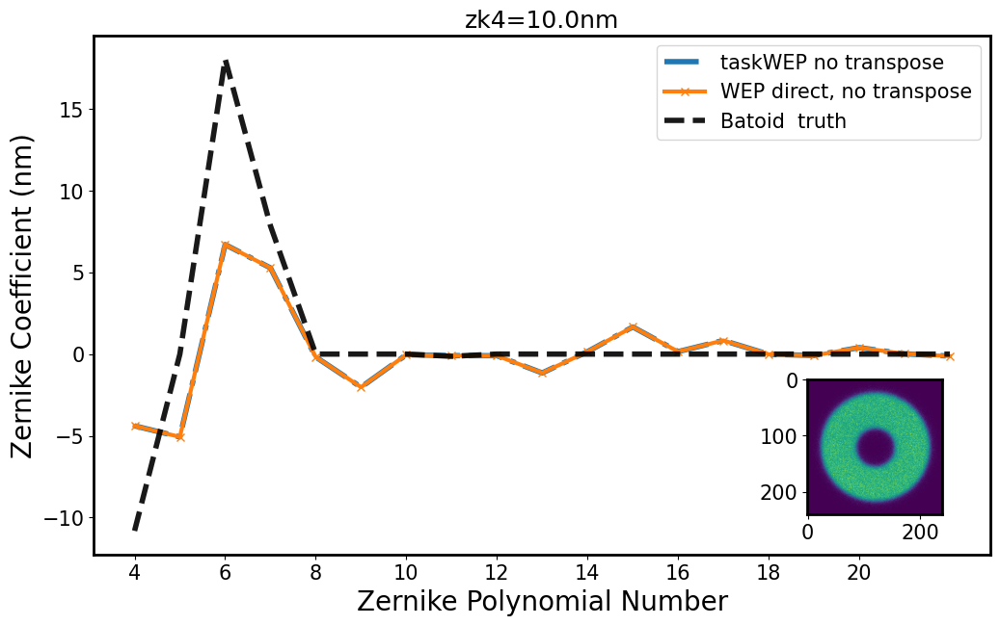

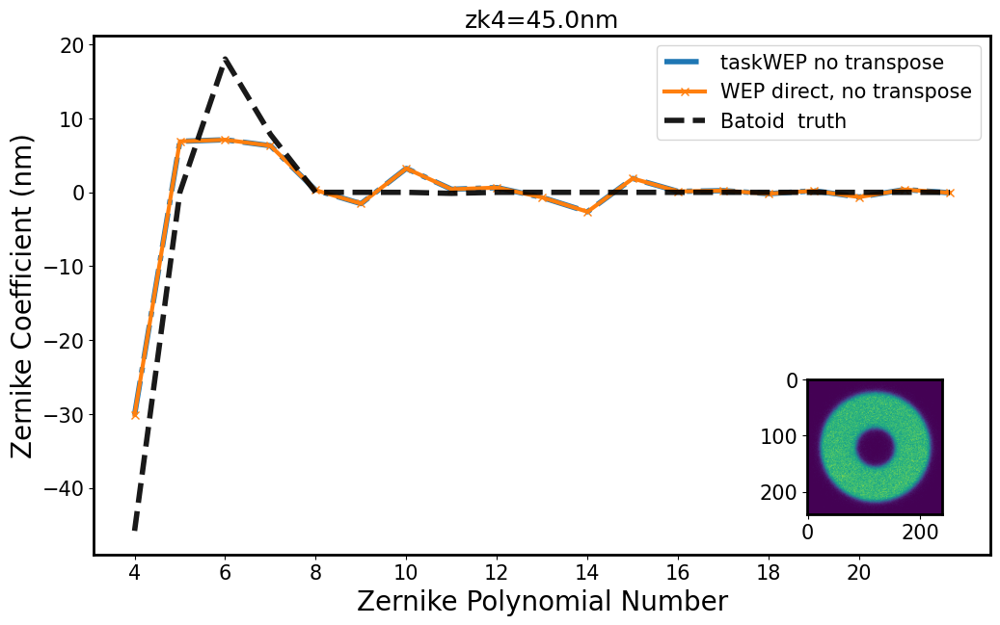

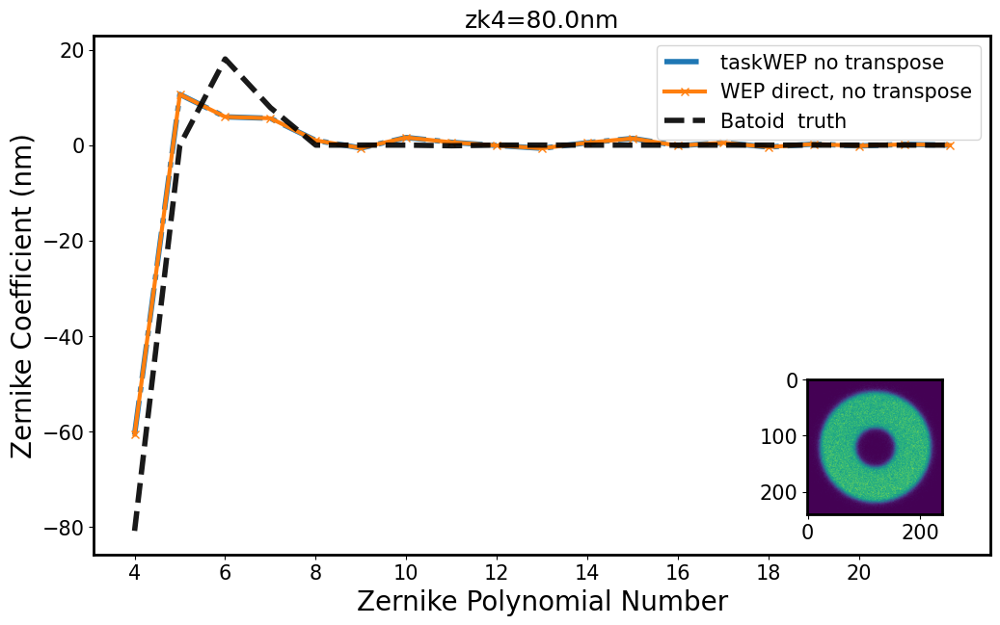

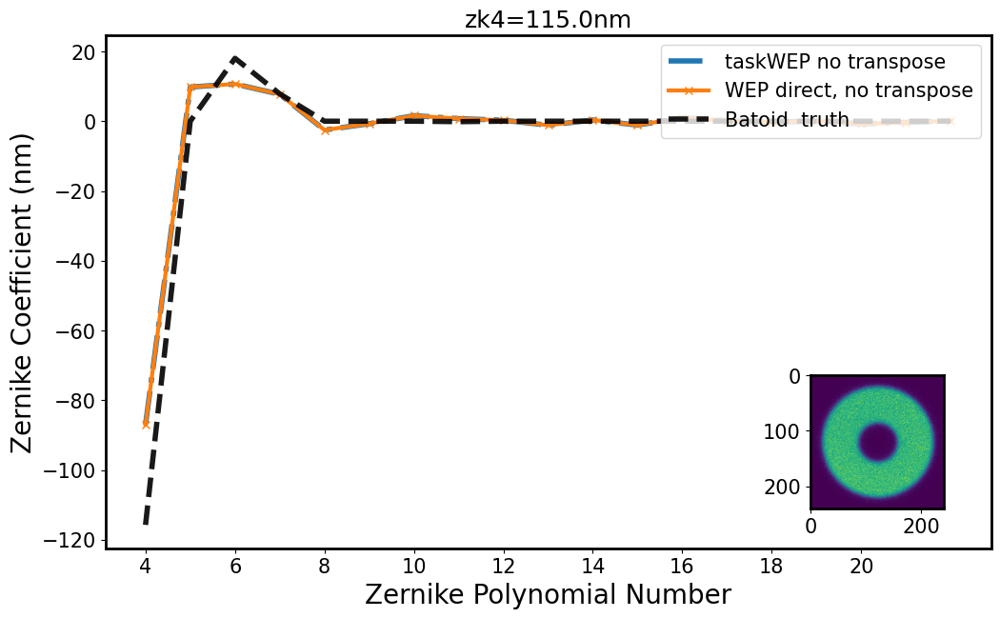

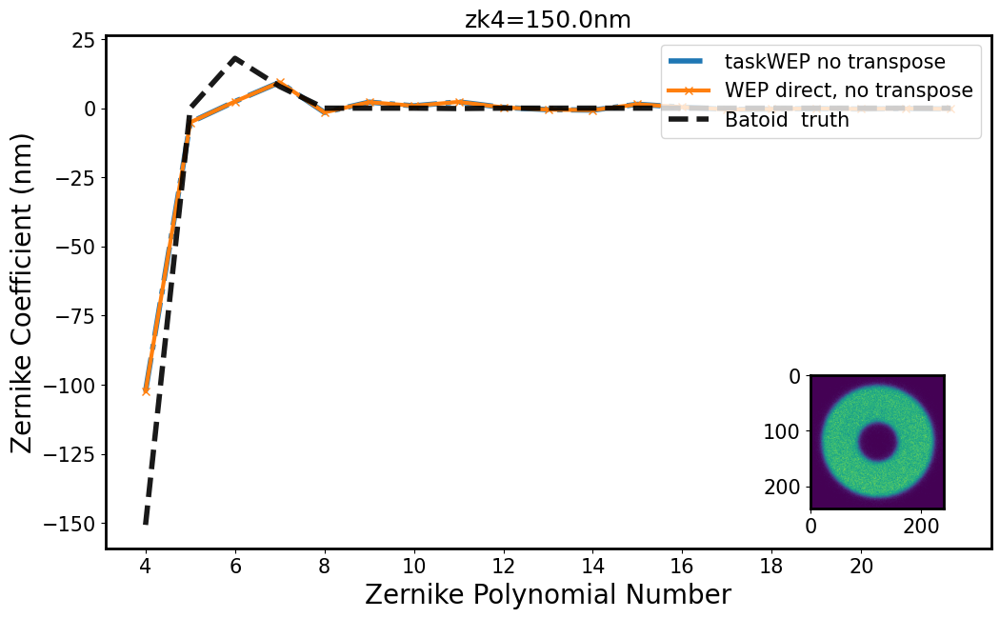

...

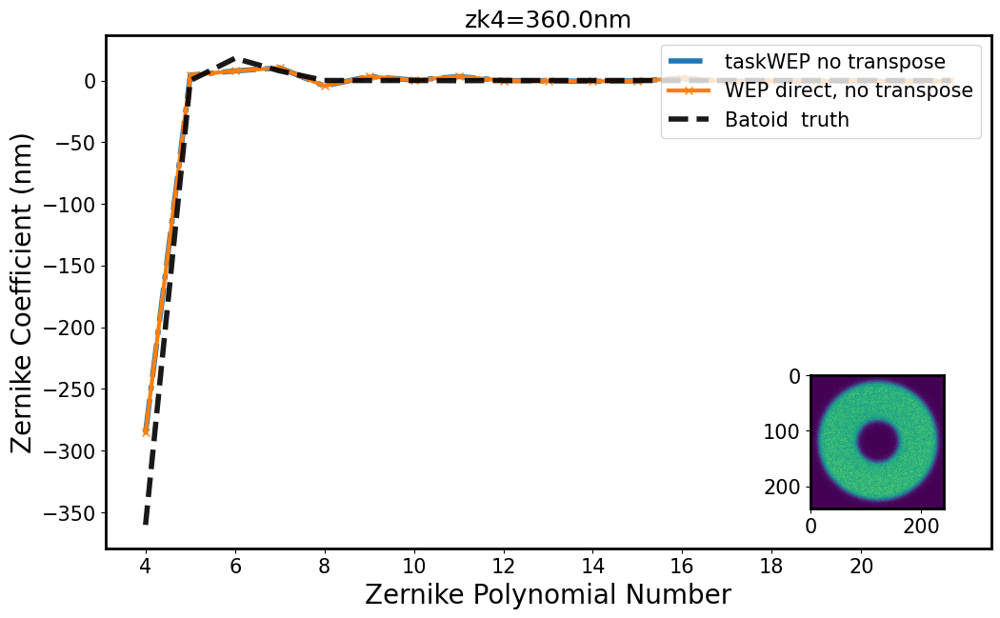

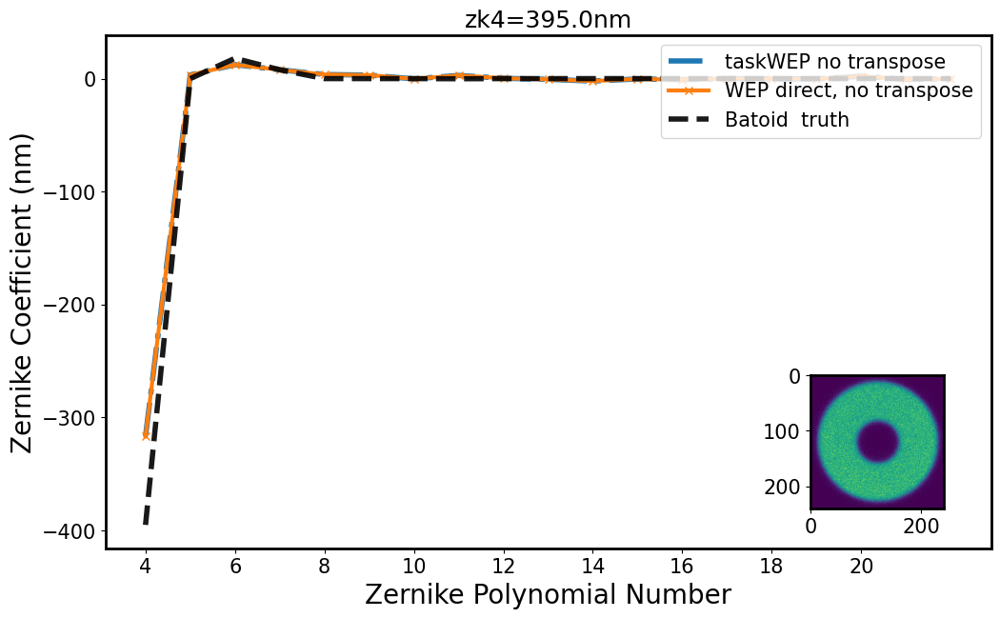

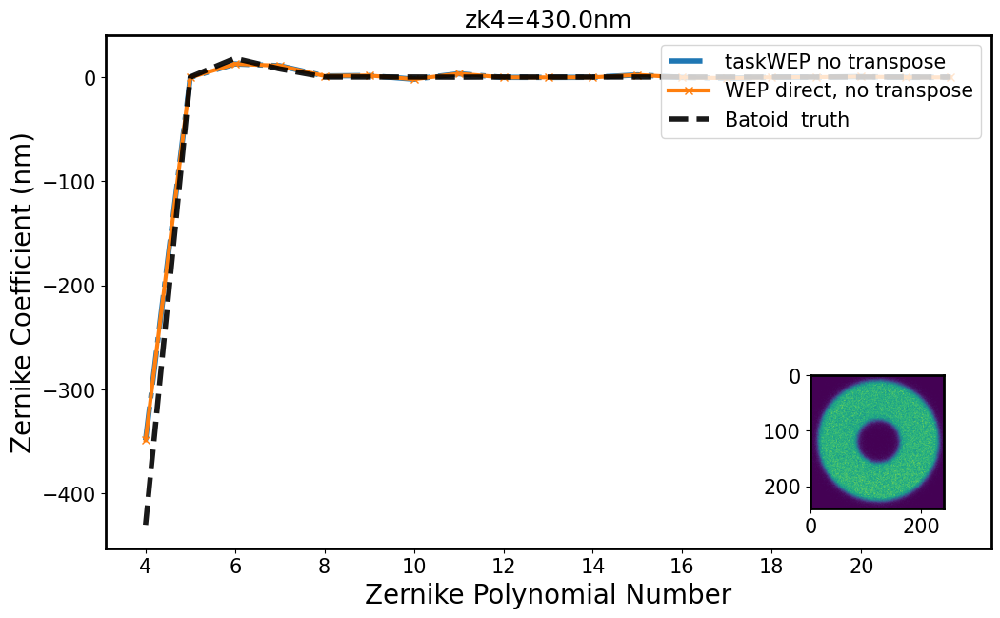

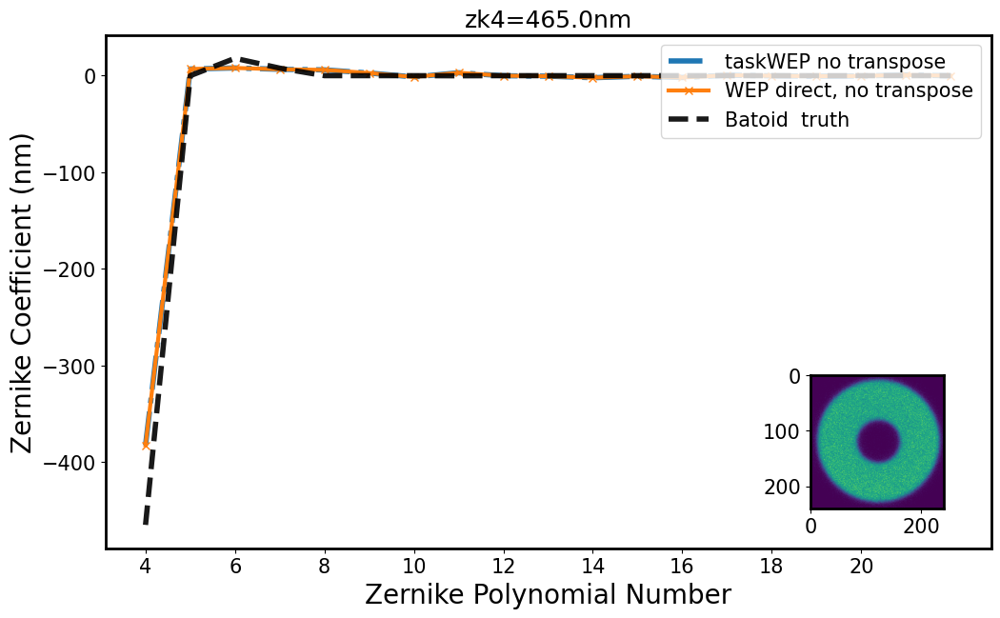

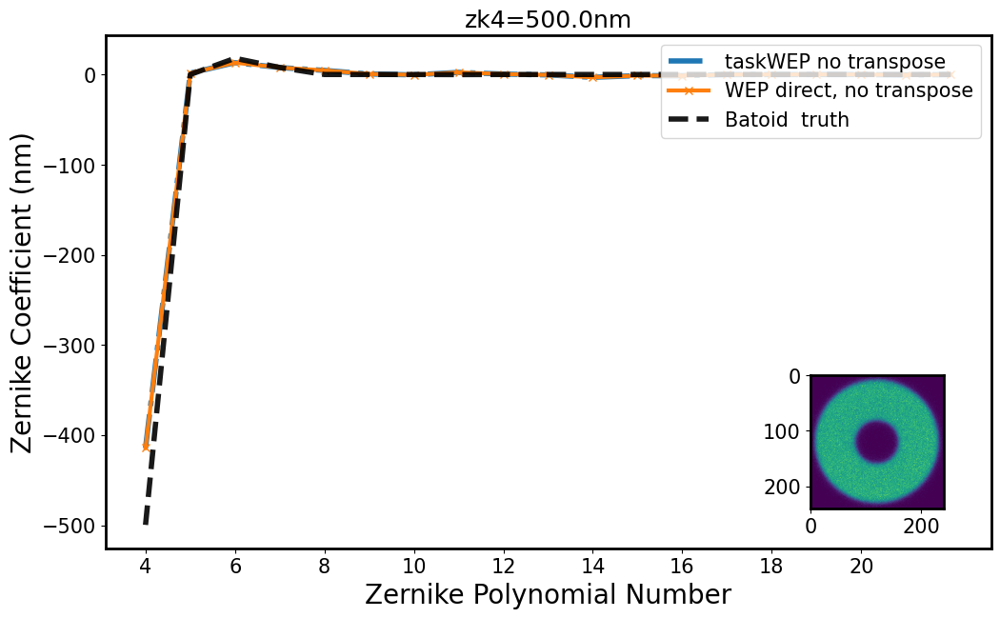

In [39]:
compare_wep_direct(zkNum = 4)

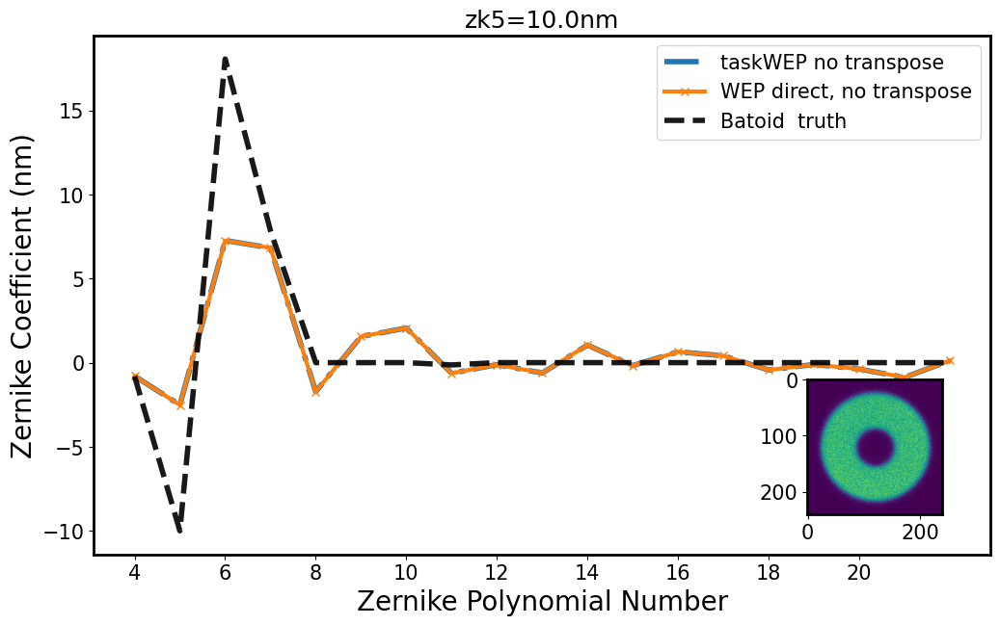

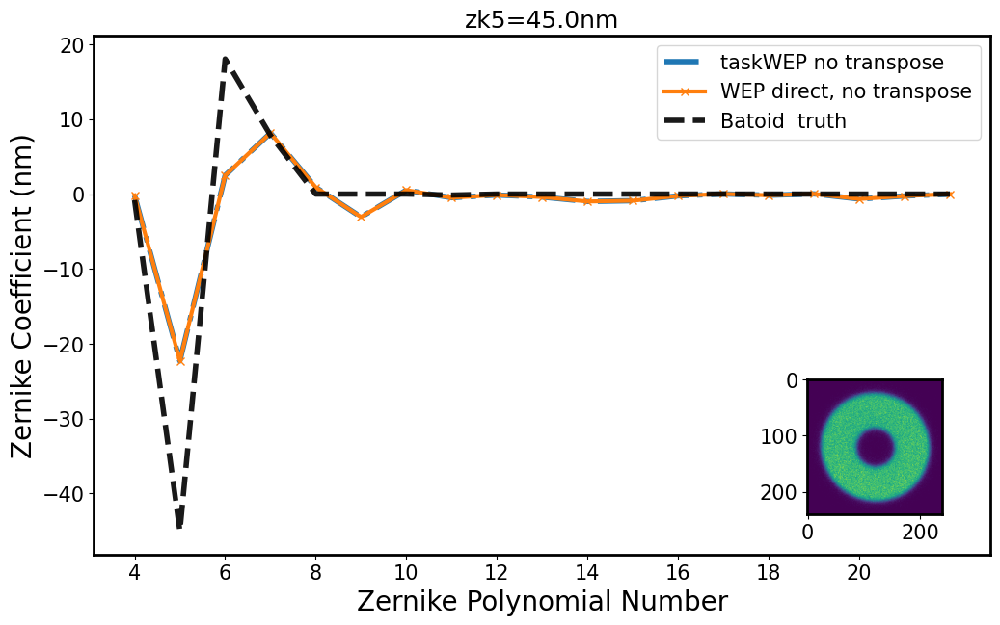

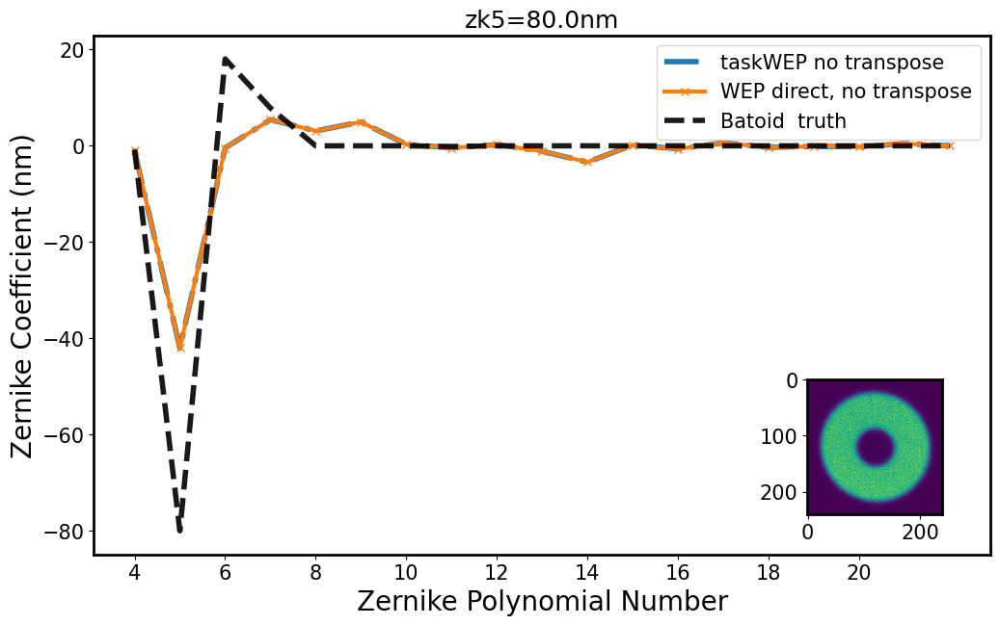

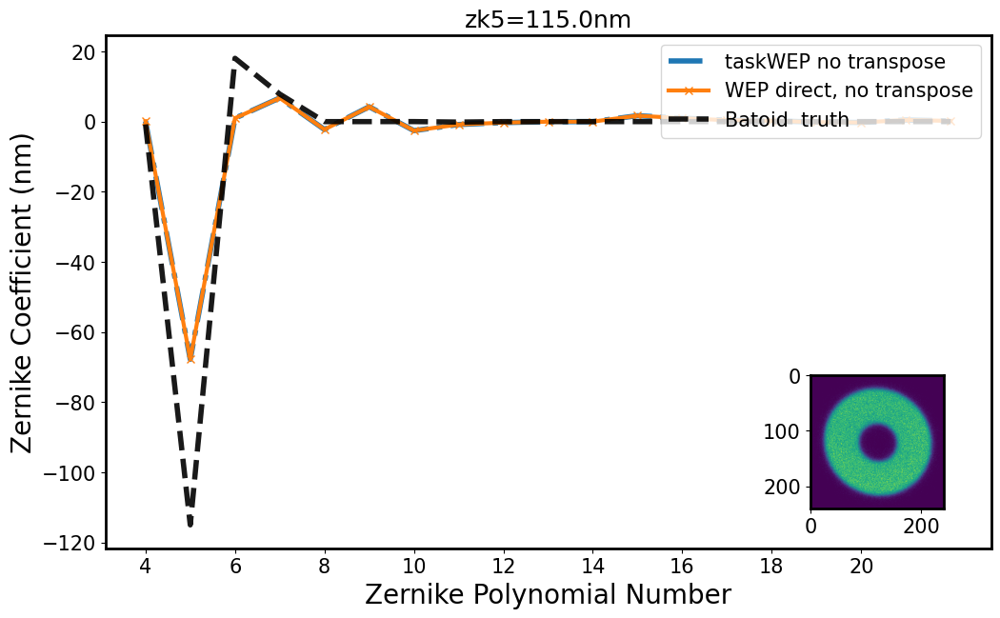

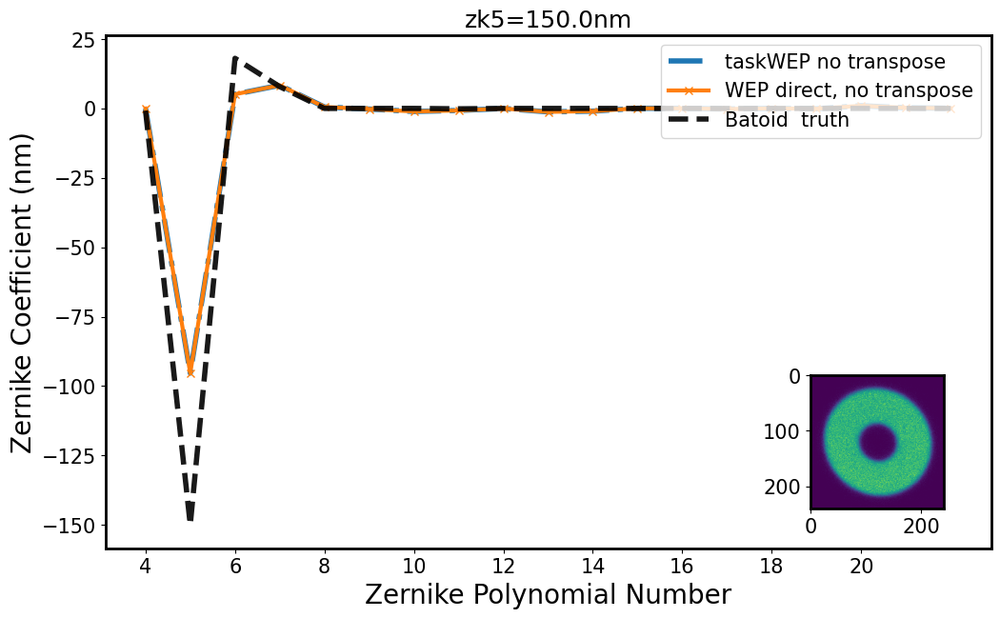

...

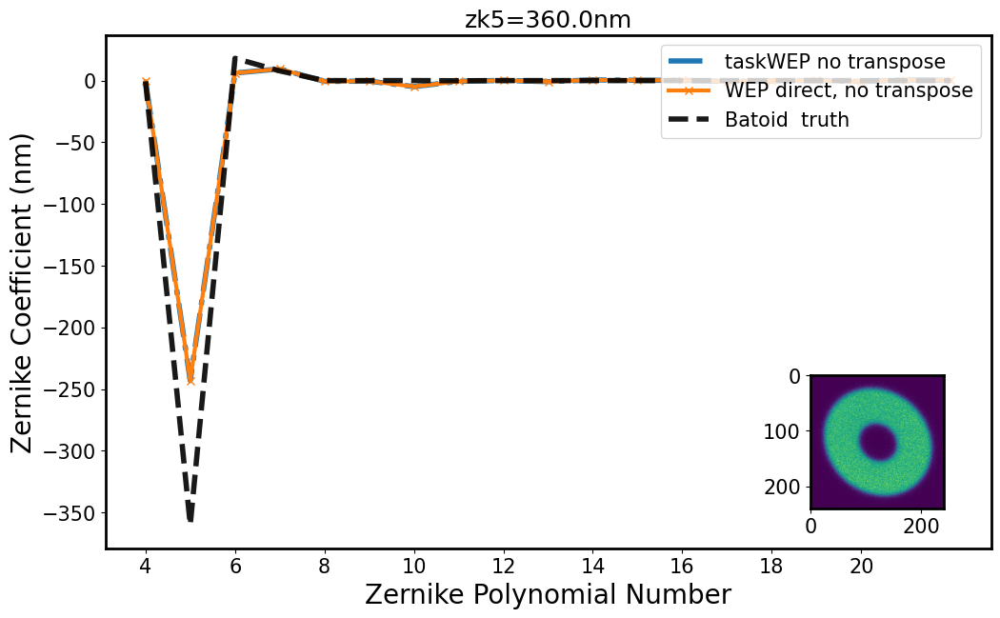

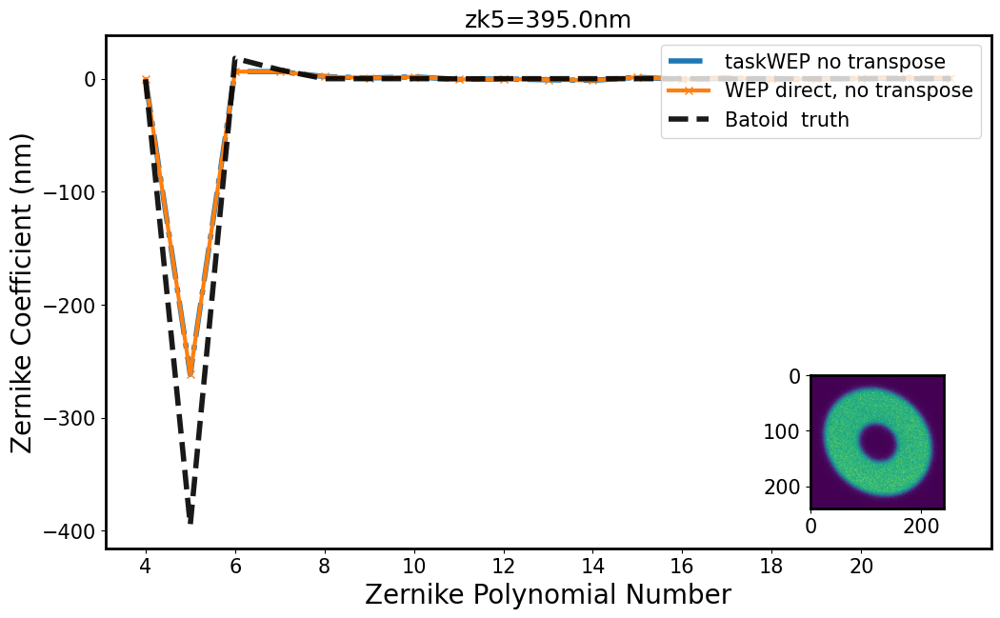

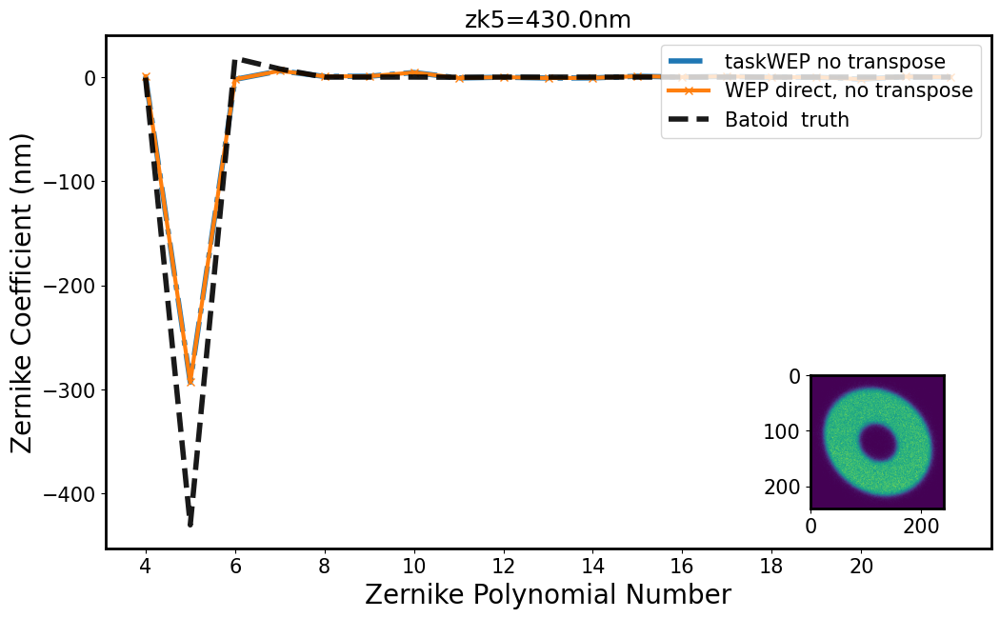

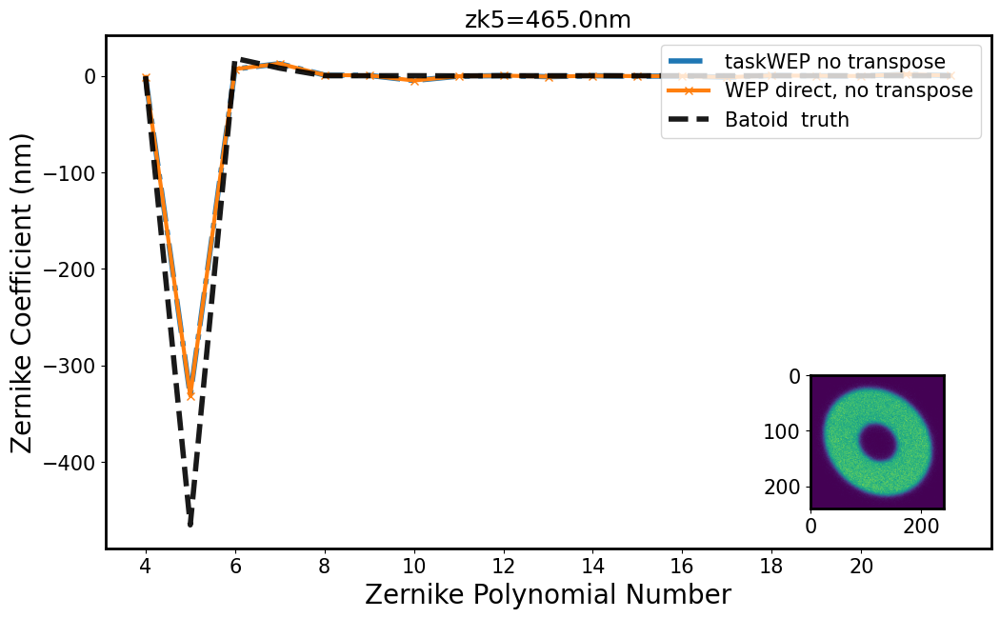

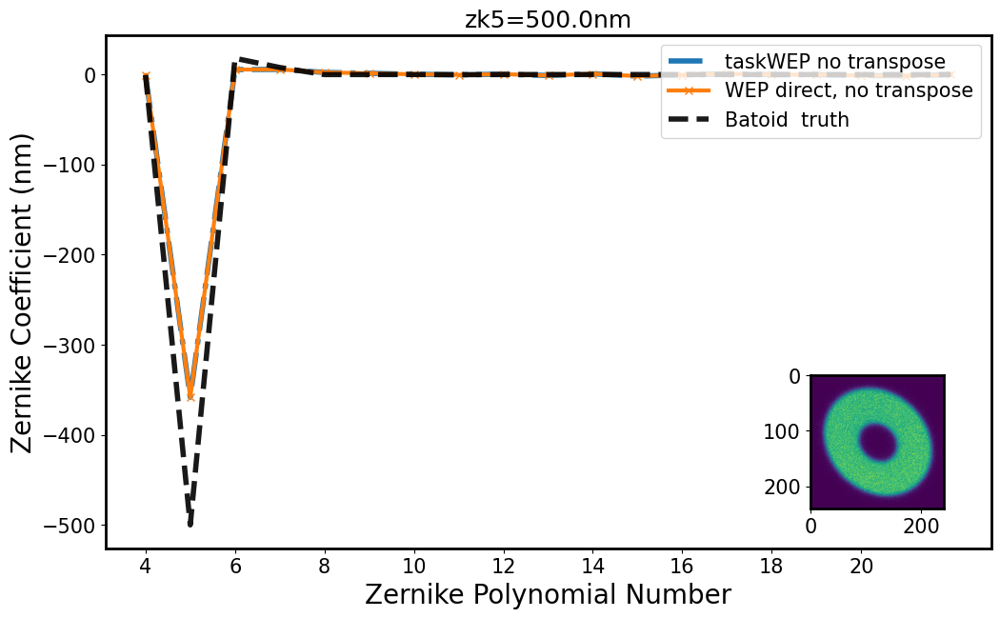

In [40]:
compare_wep_direct(zkNum = 5)

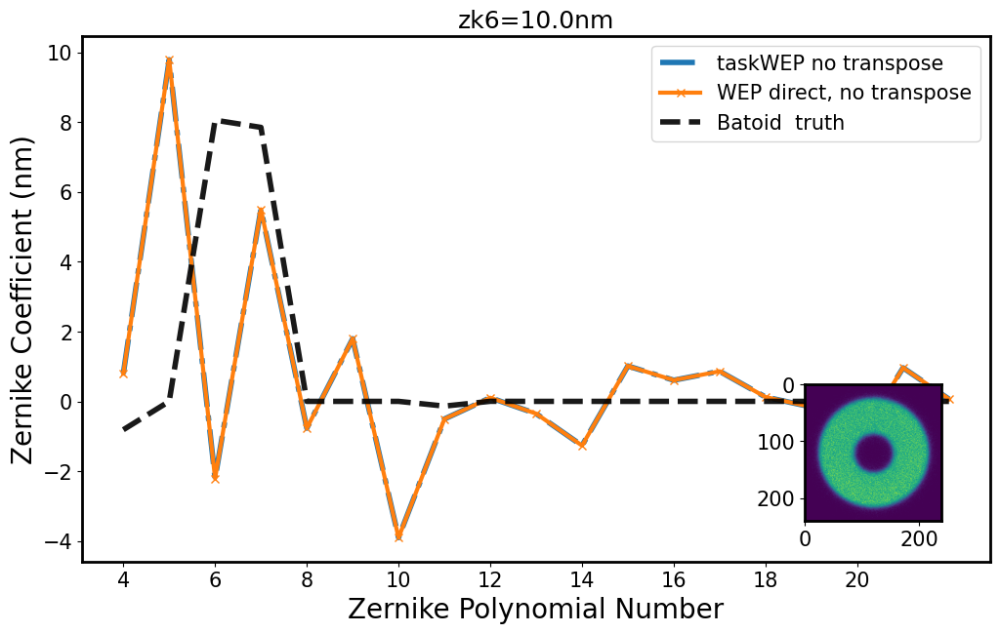

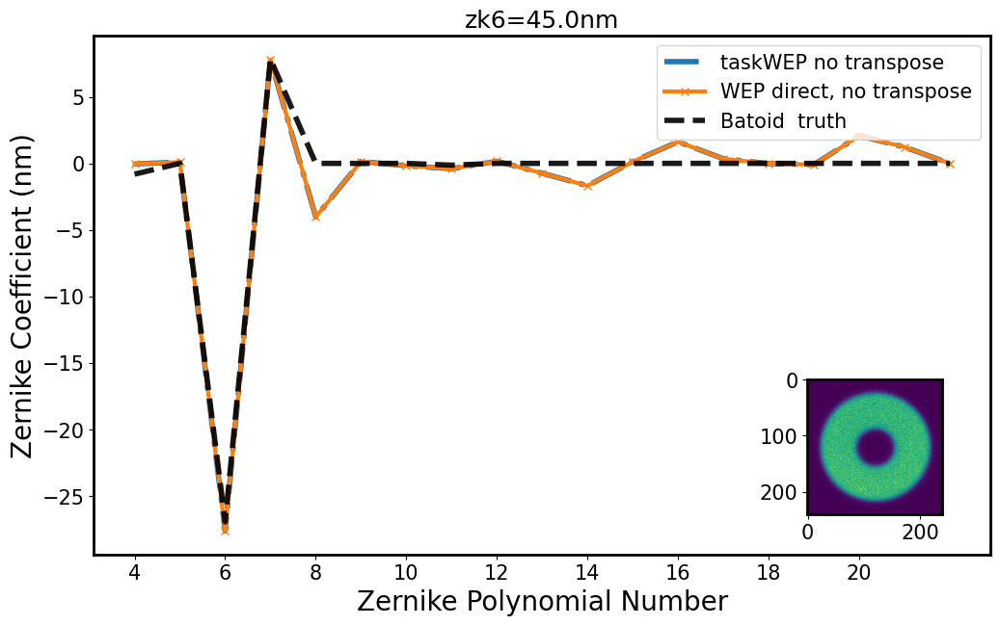

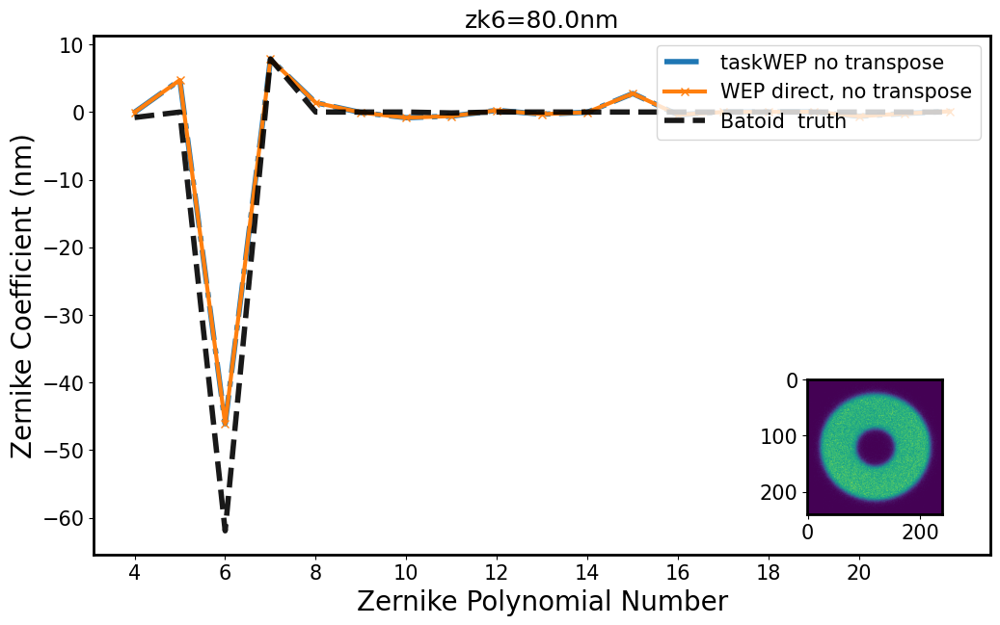

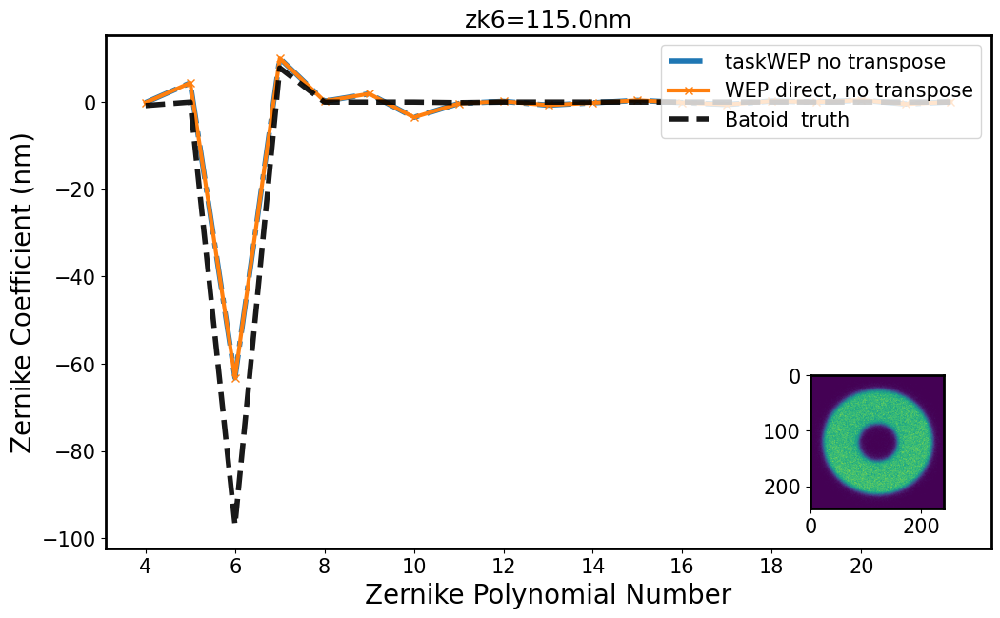

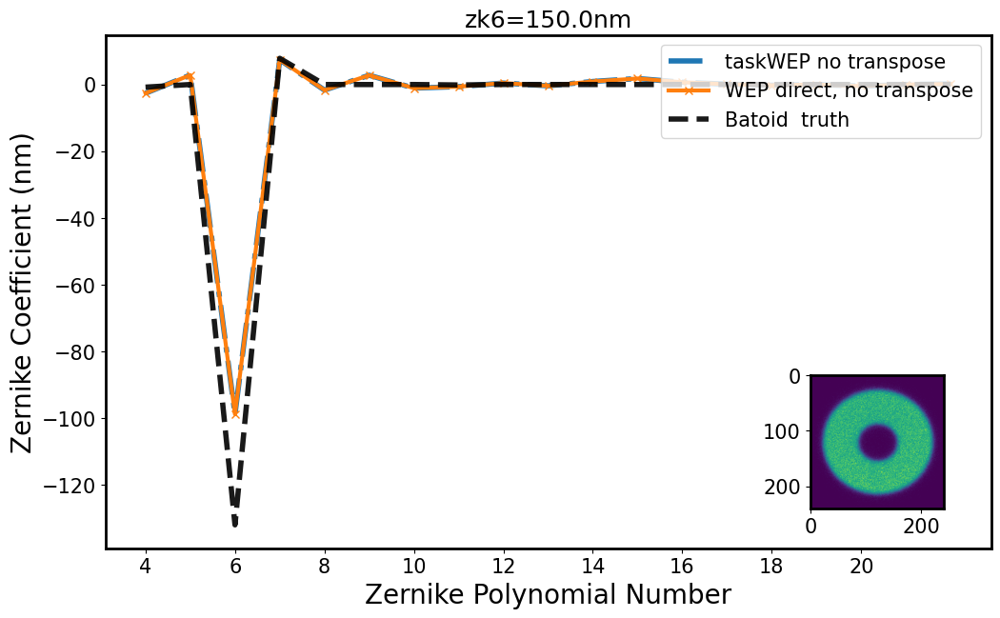

...

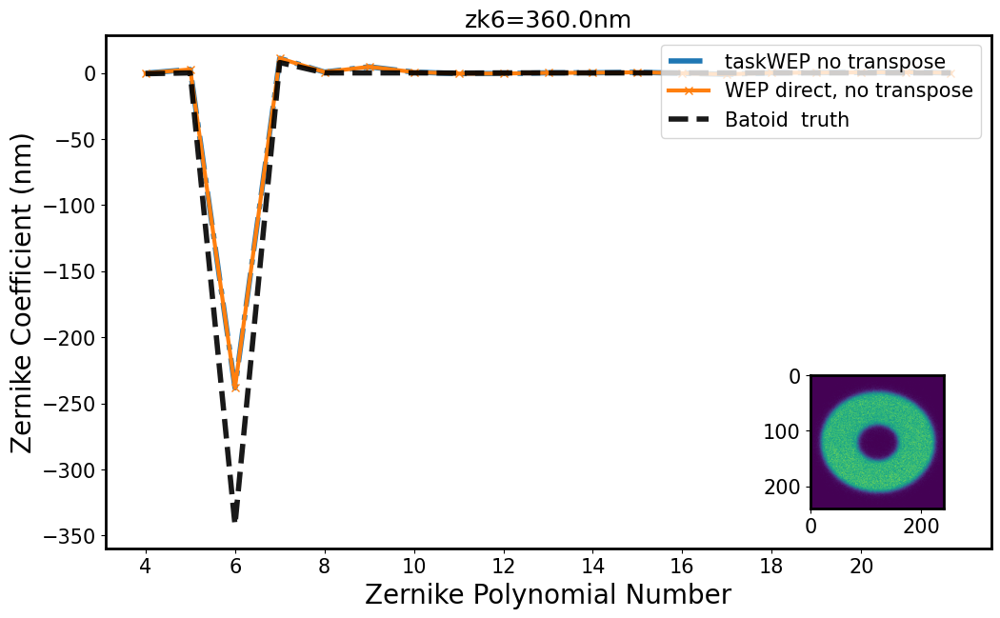

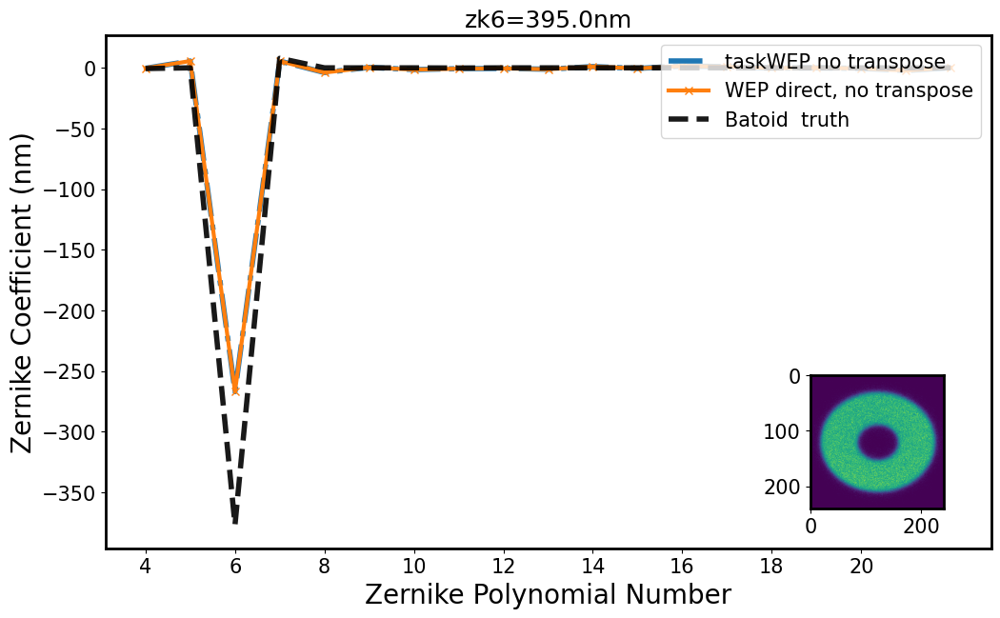

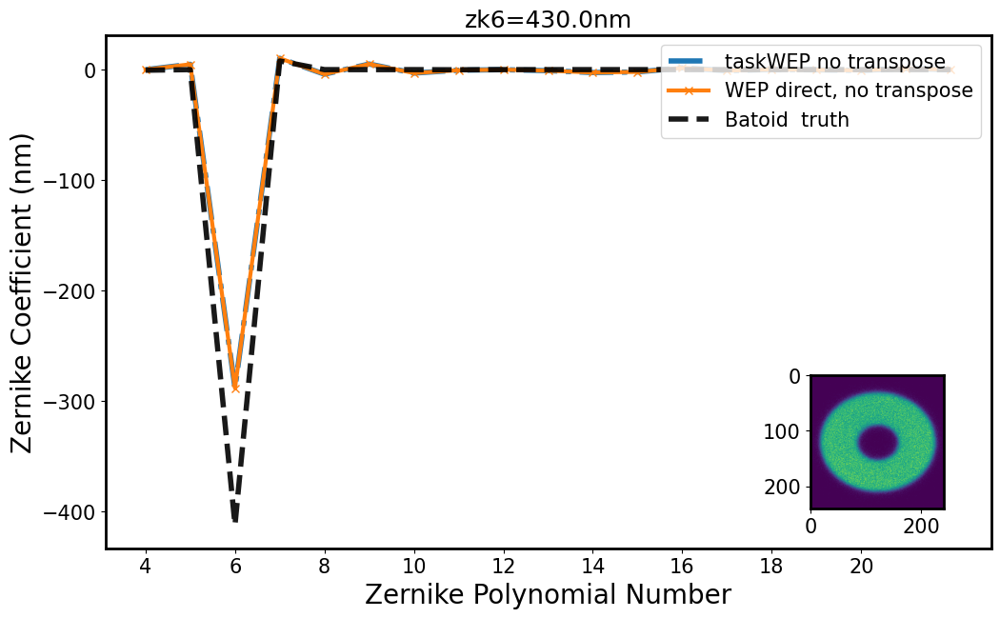

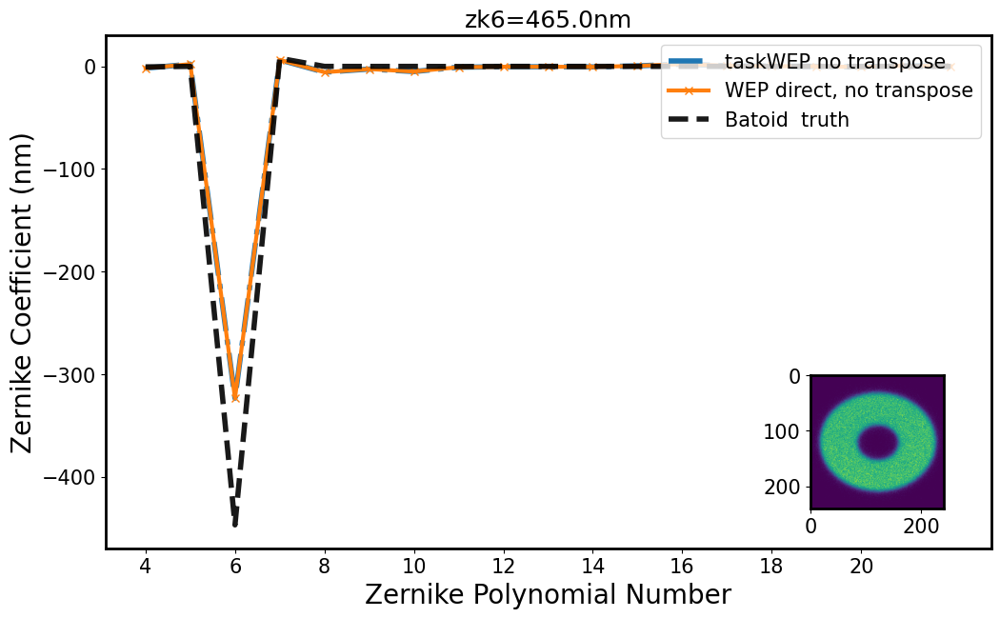

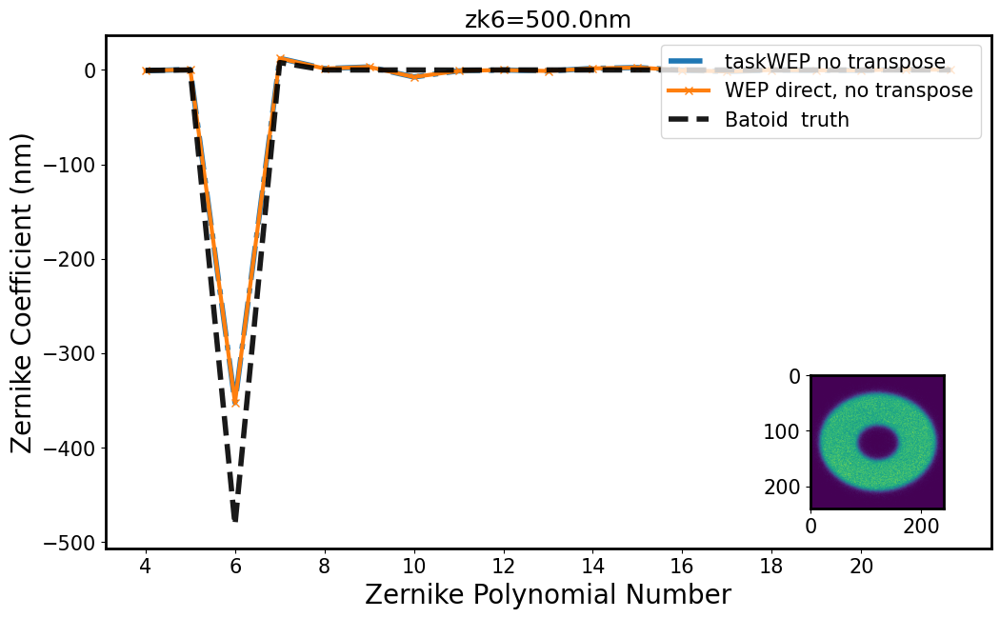

In [41]:
compare_wep_direct(zkNum = 6)

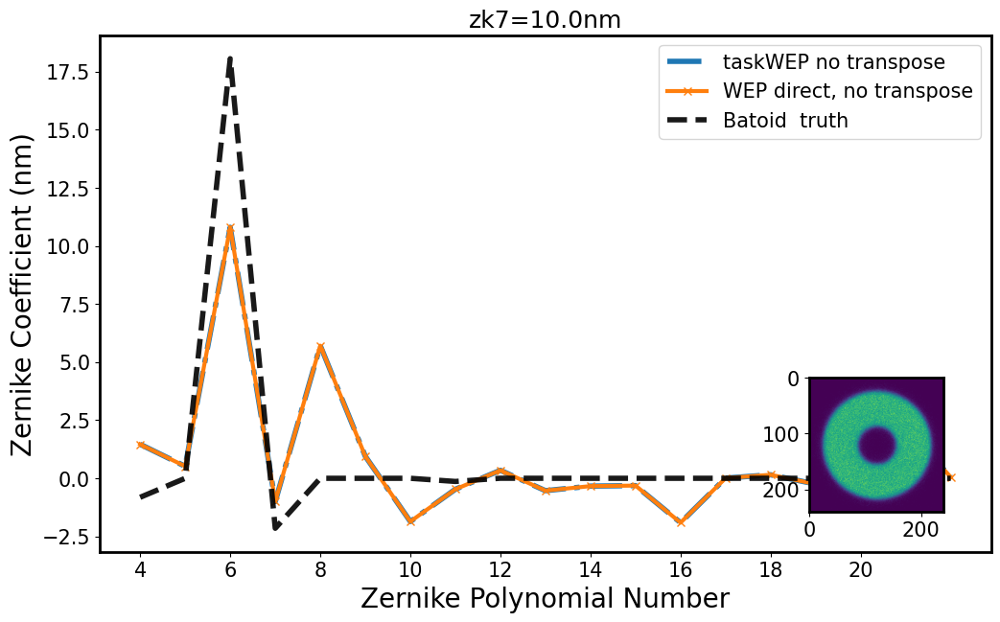

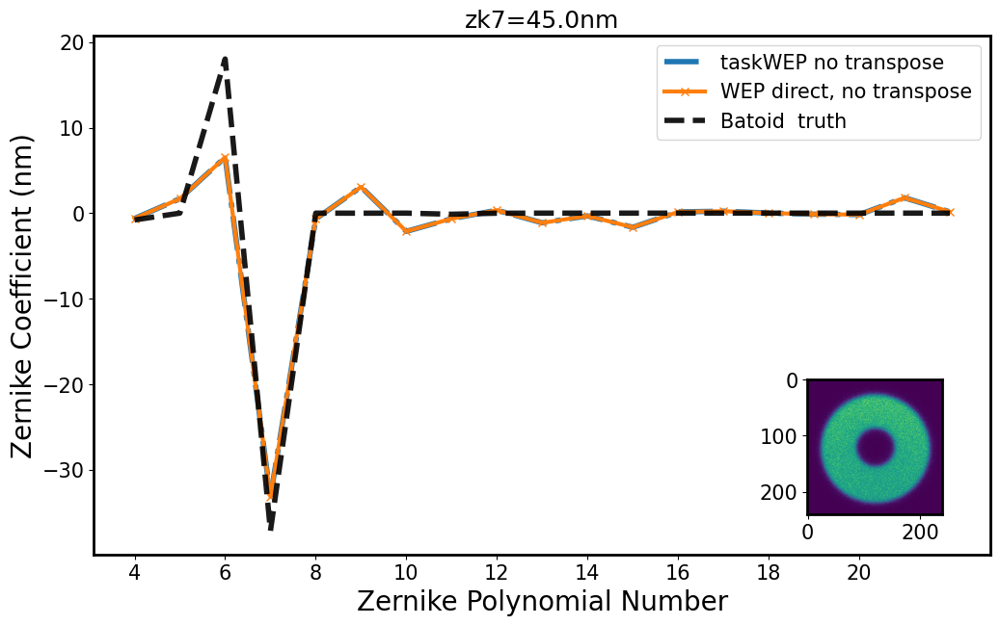

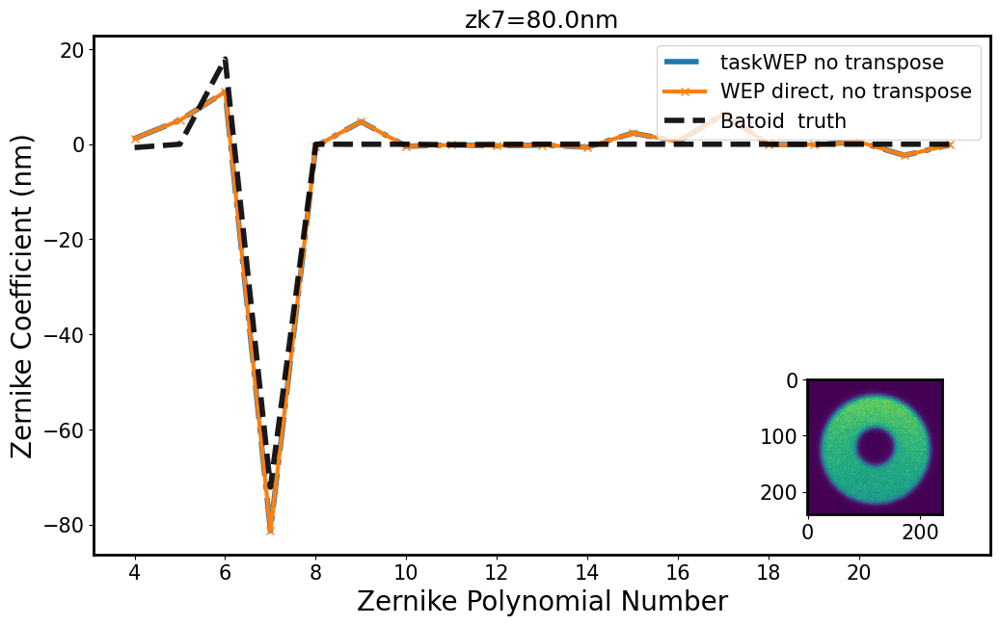

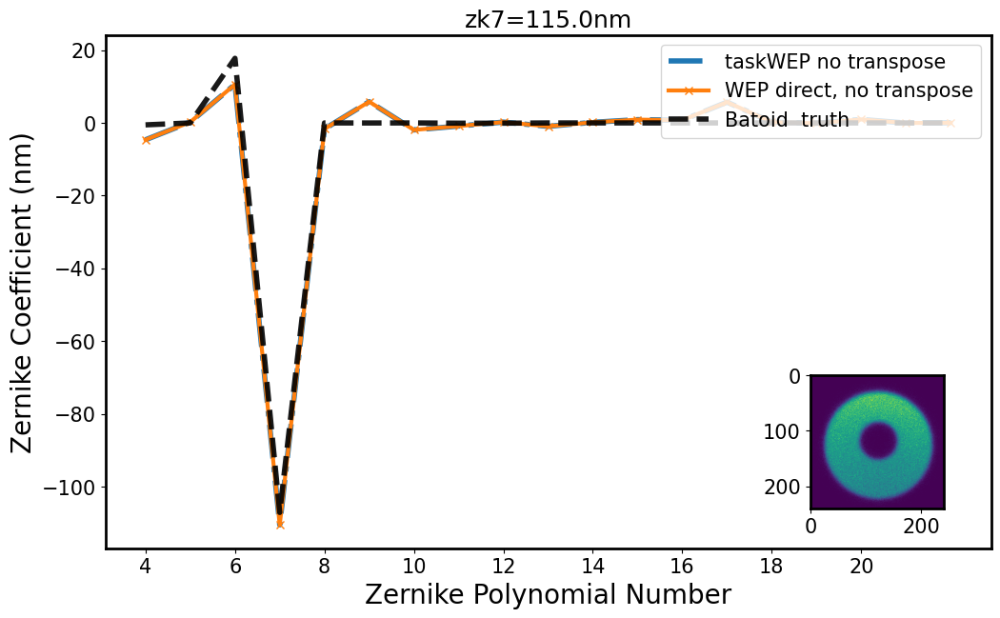

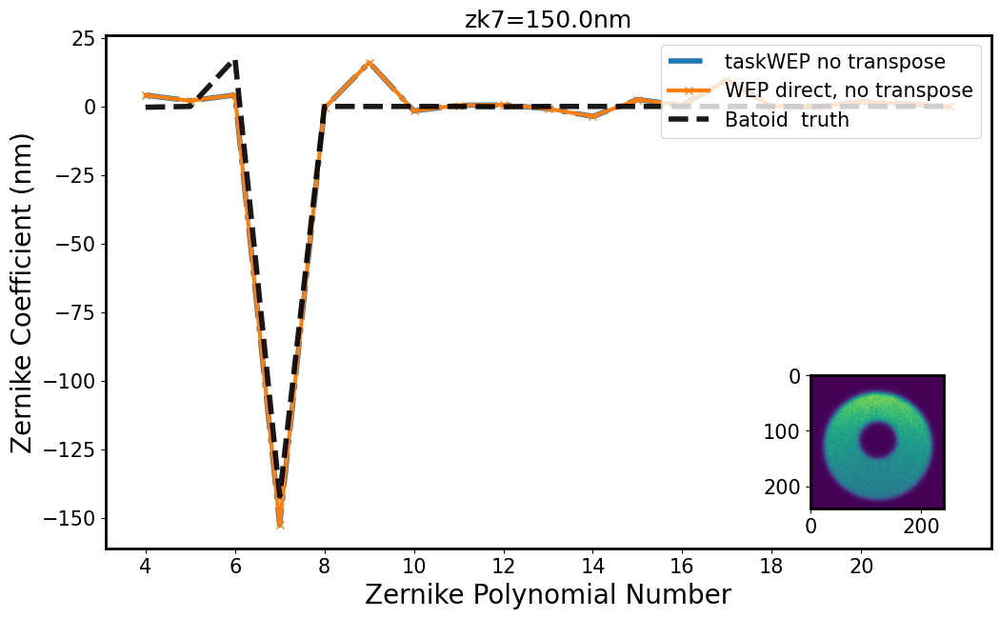

...

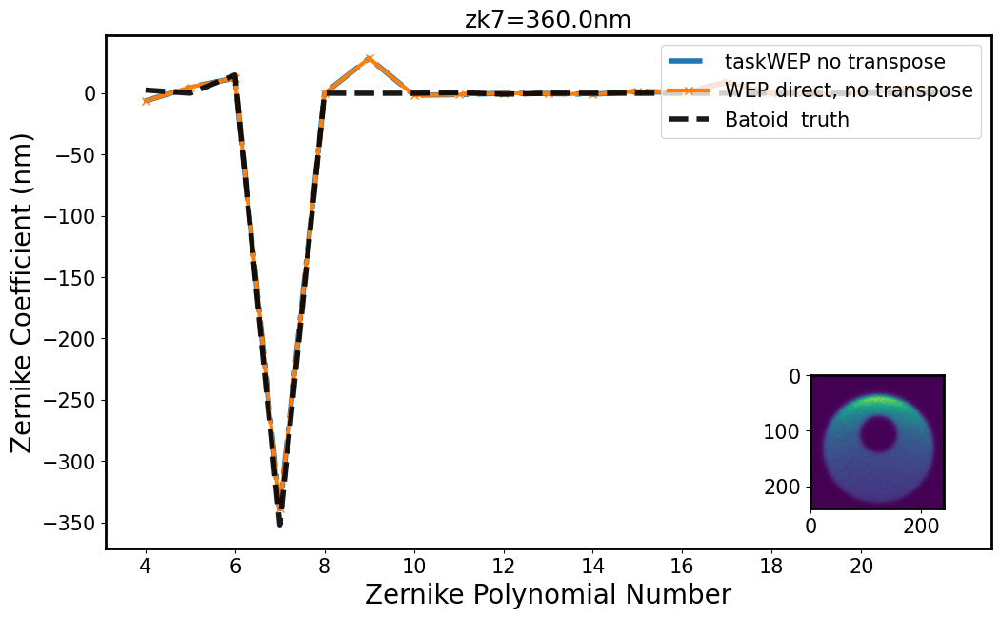

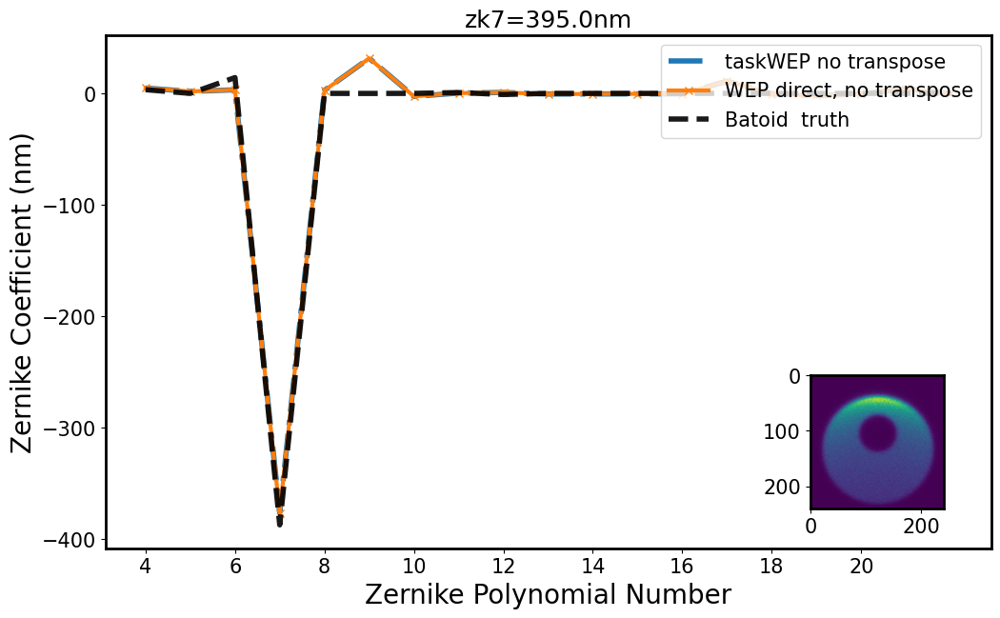

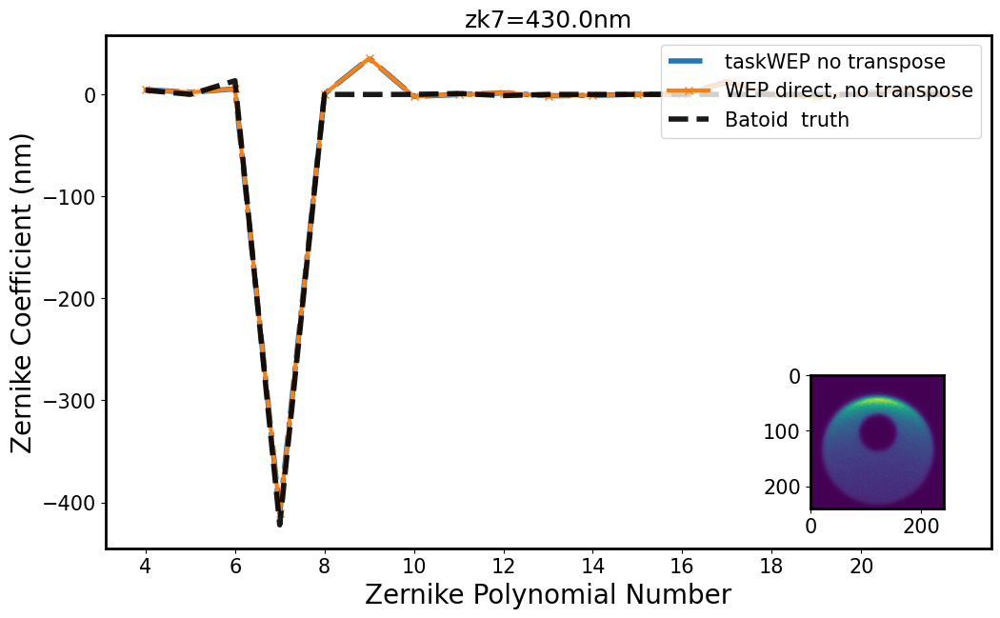

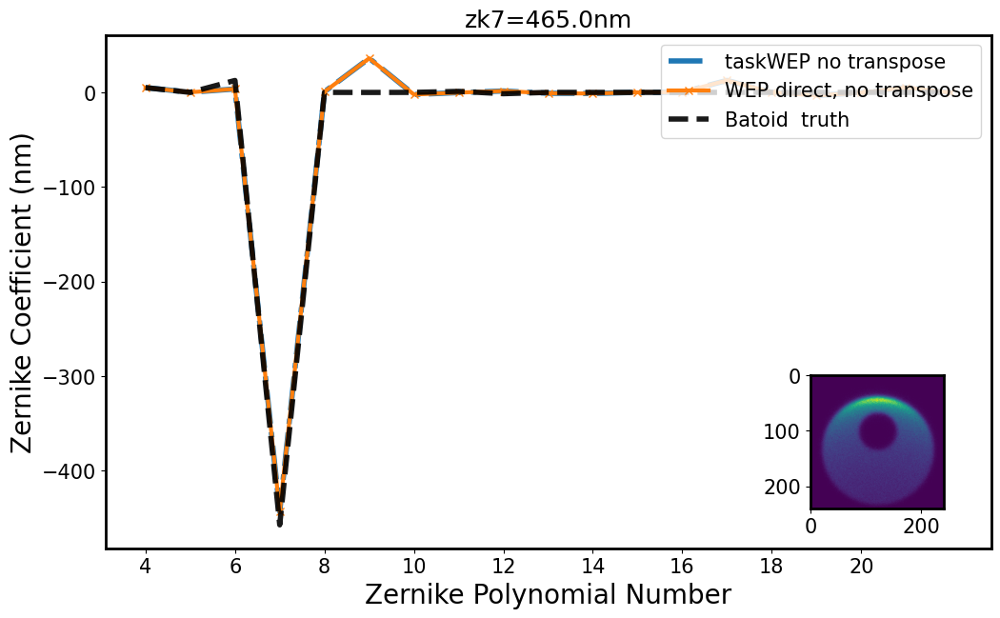

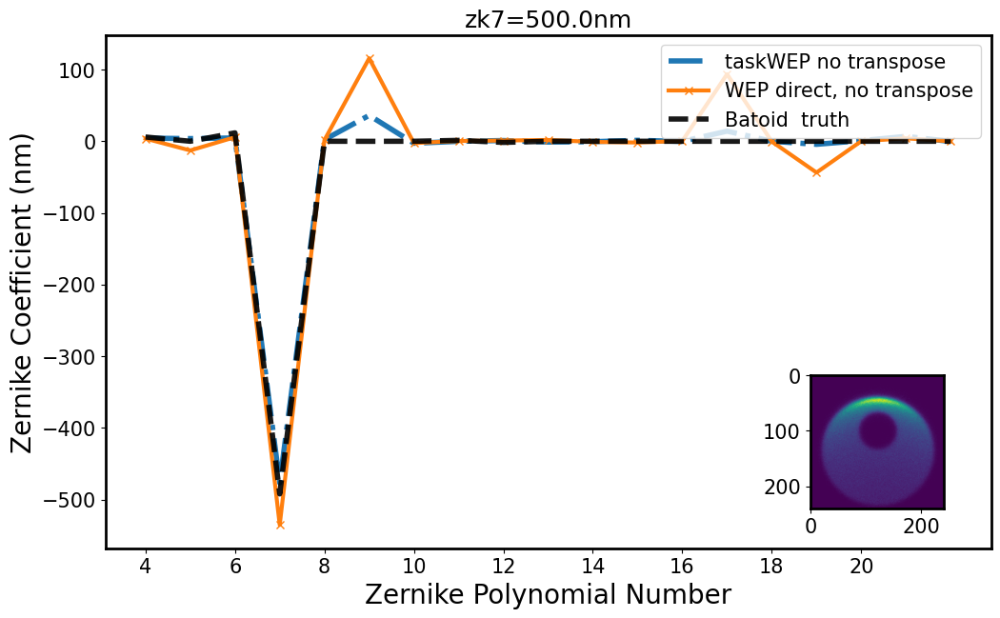

In [42]:
compare_wep_direct(zkNum = 7)

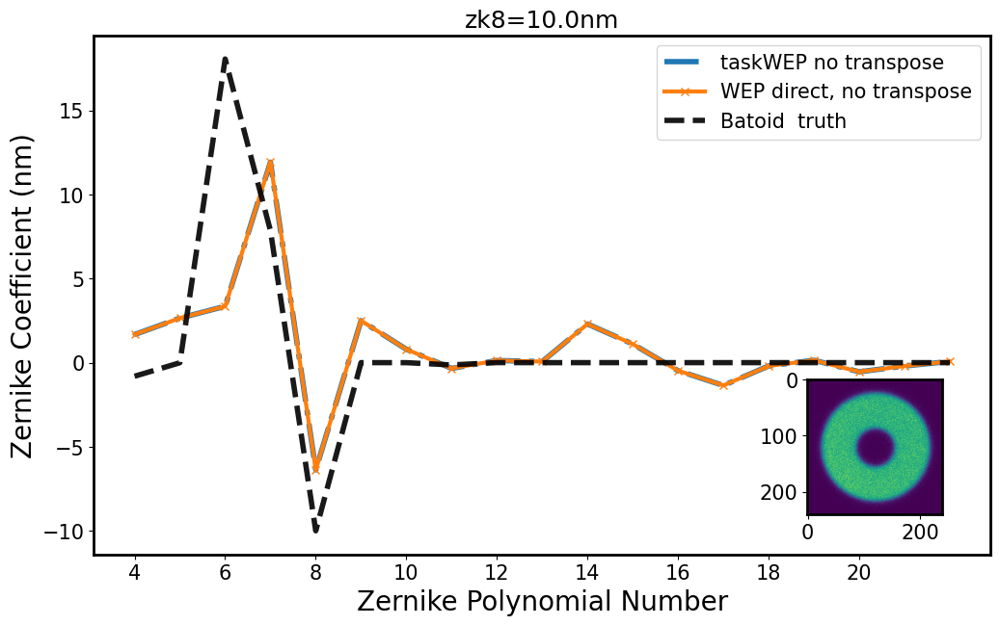

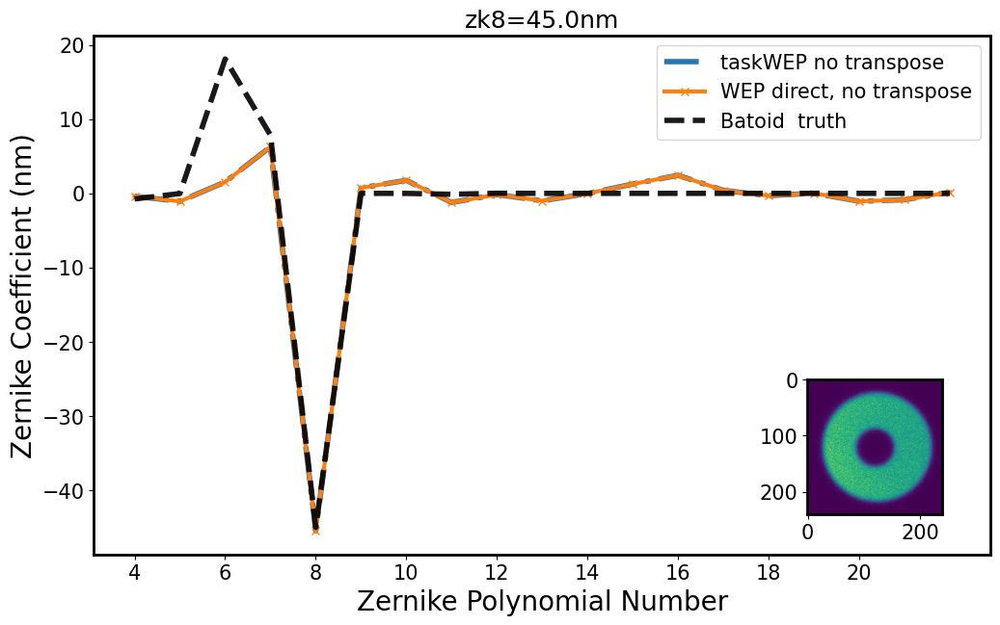

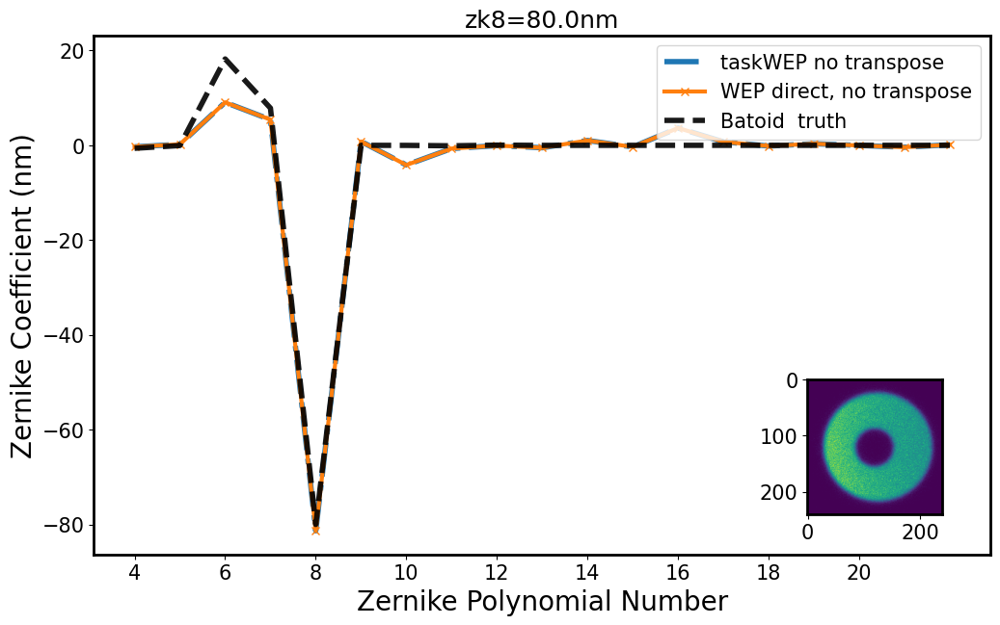

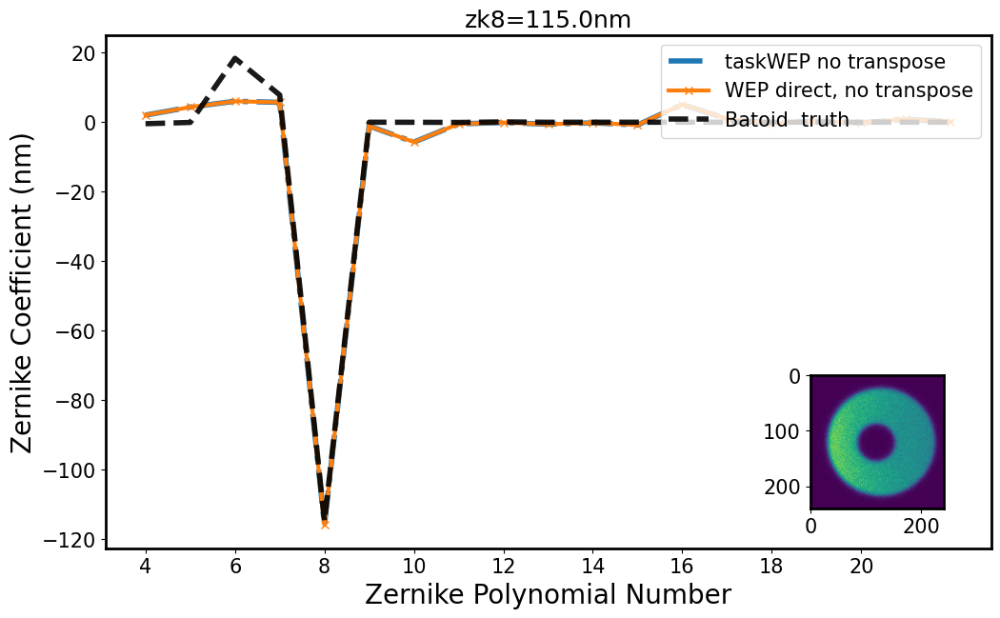

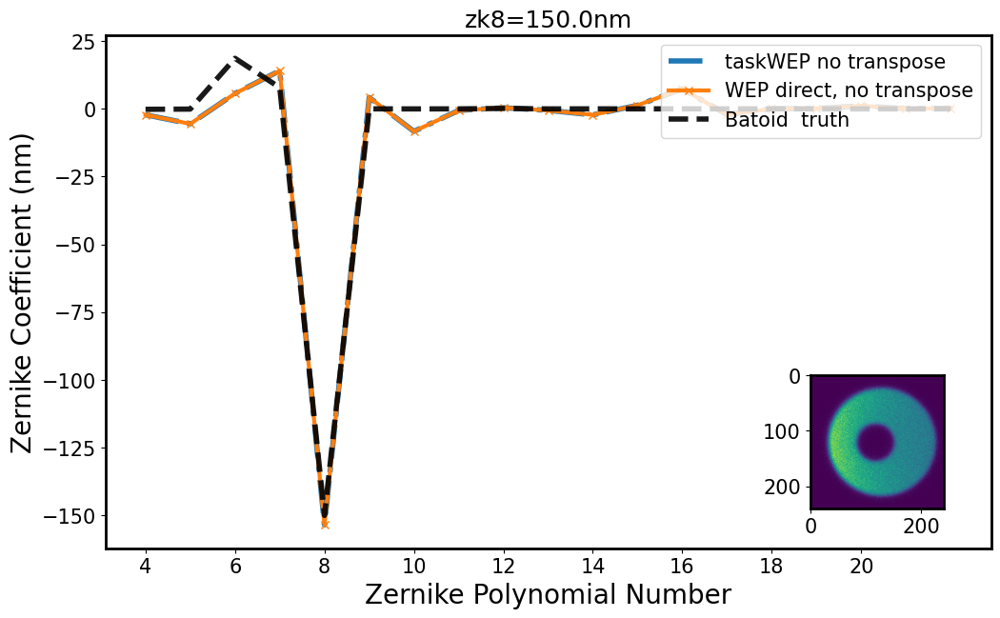

...

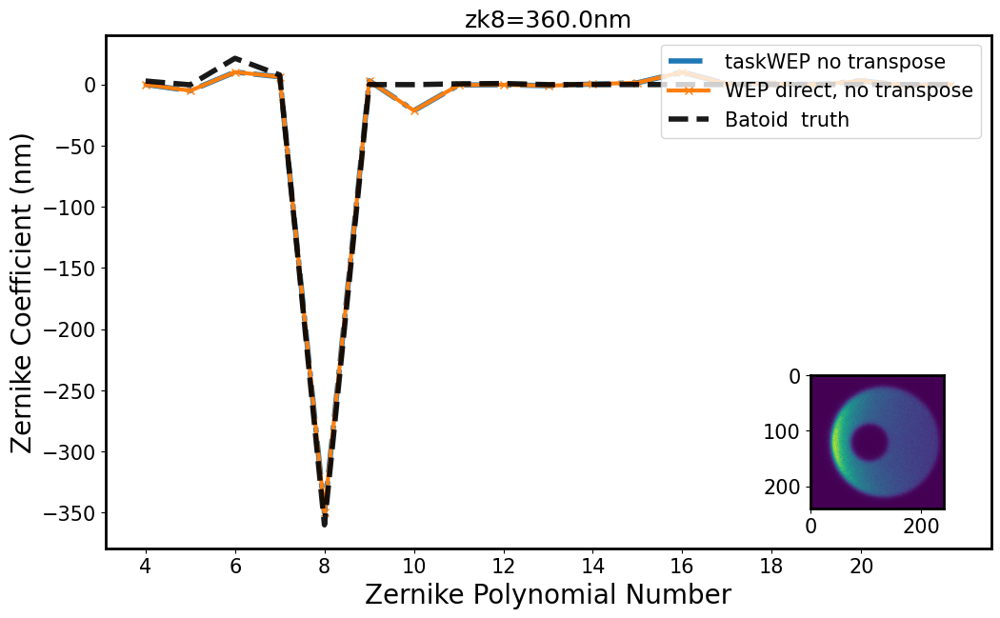

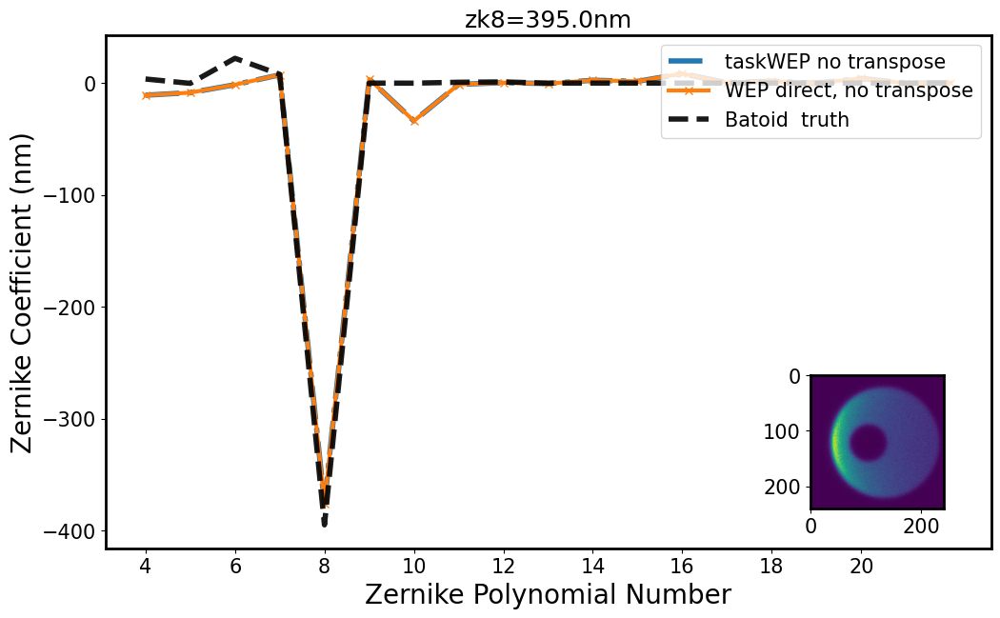

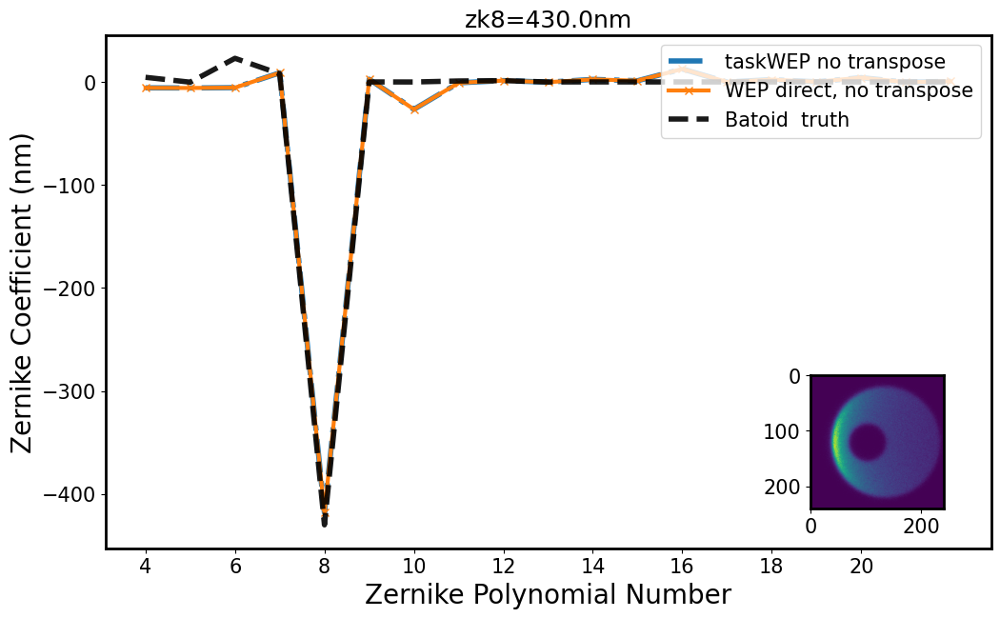

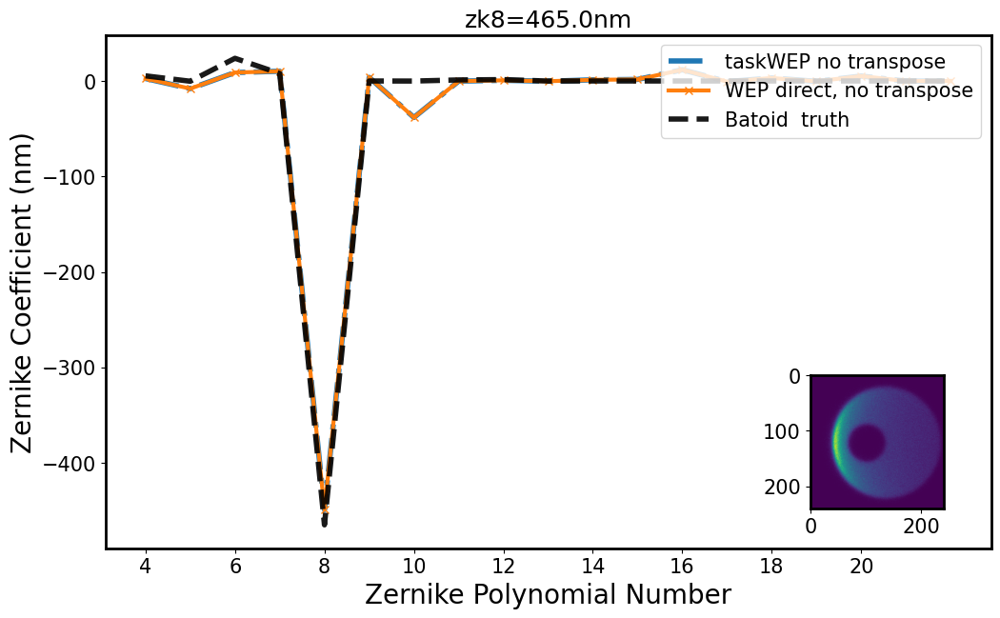

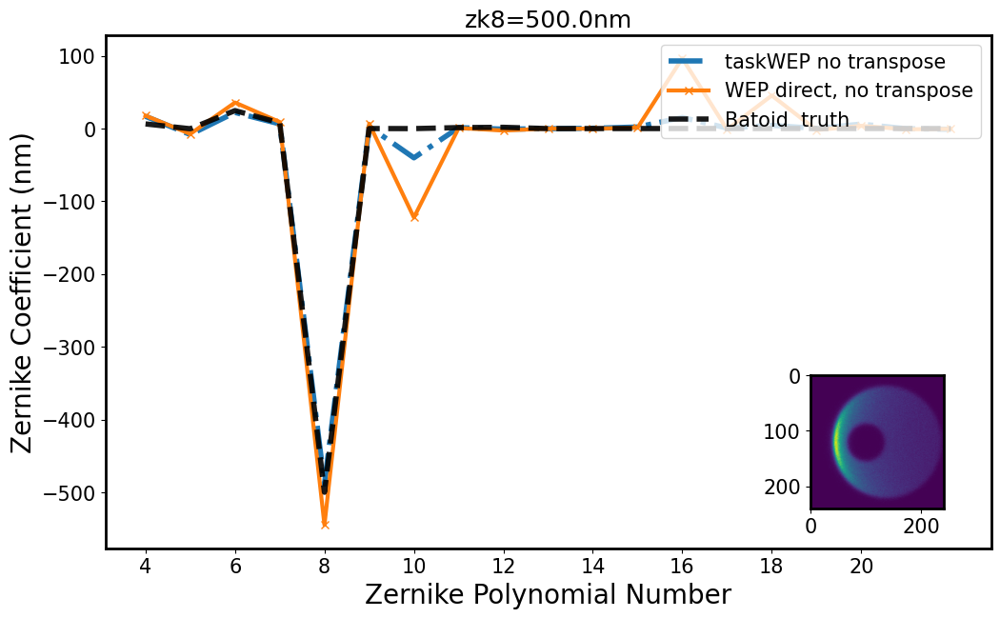

In [43]:
compare_wep_direct(zkNum = 8)

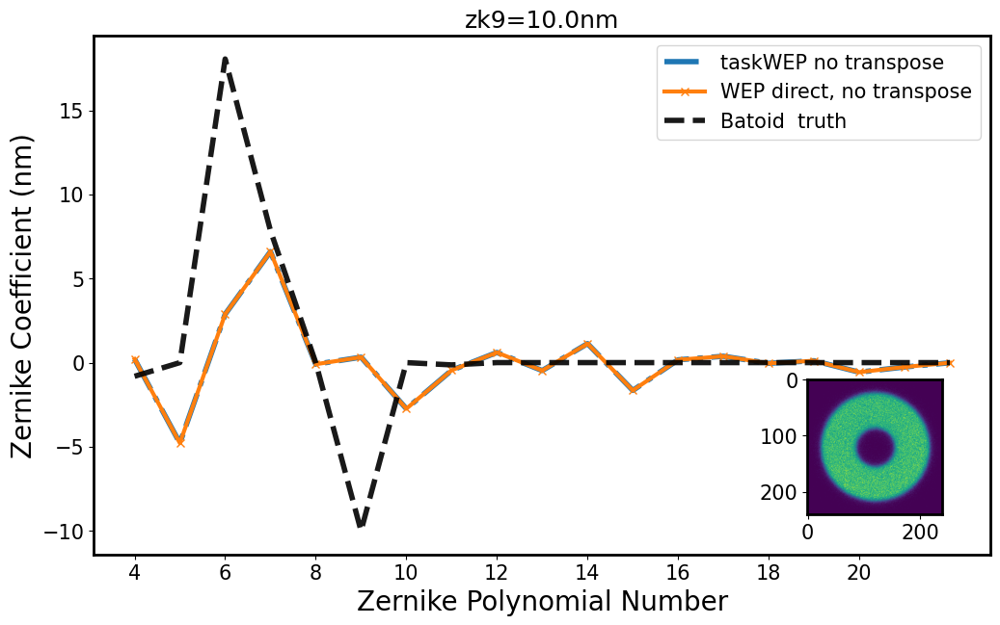

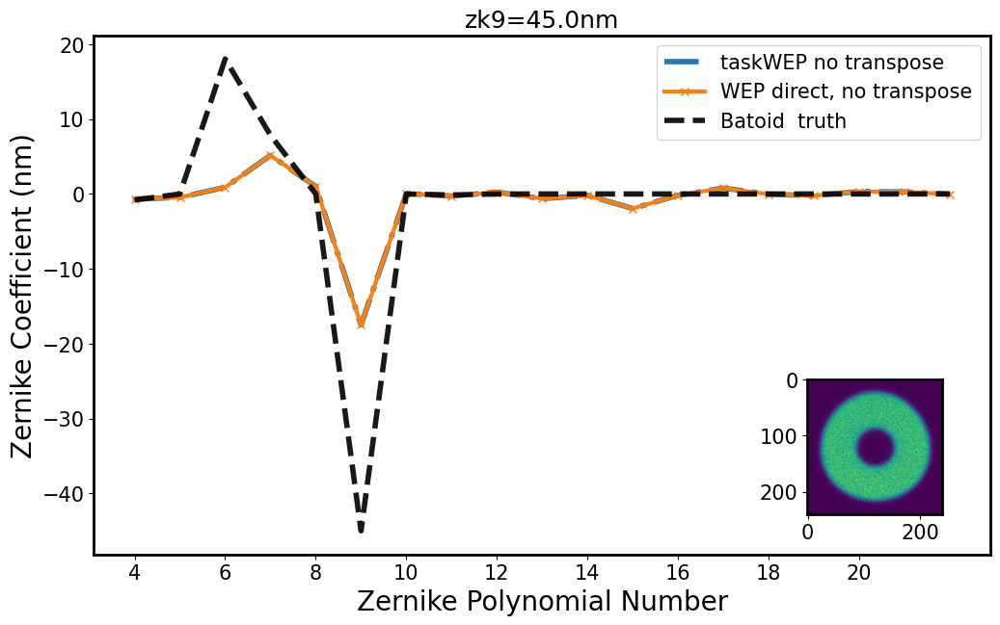

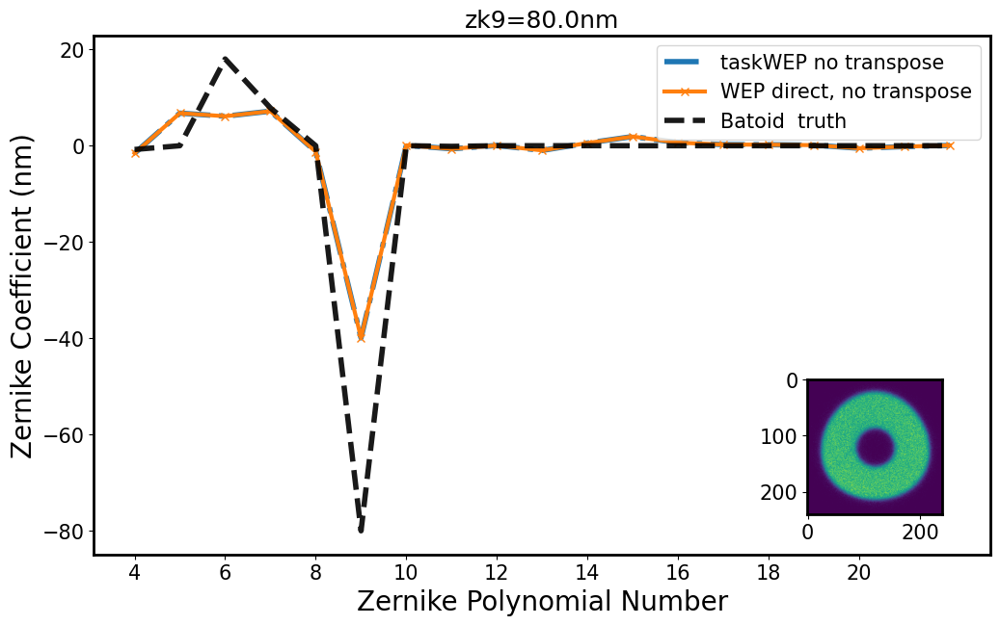

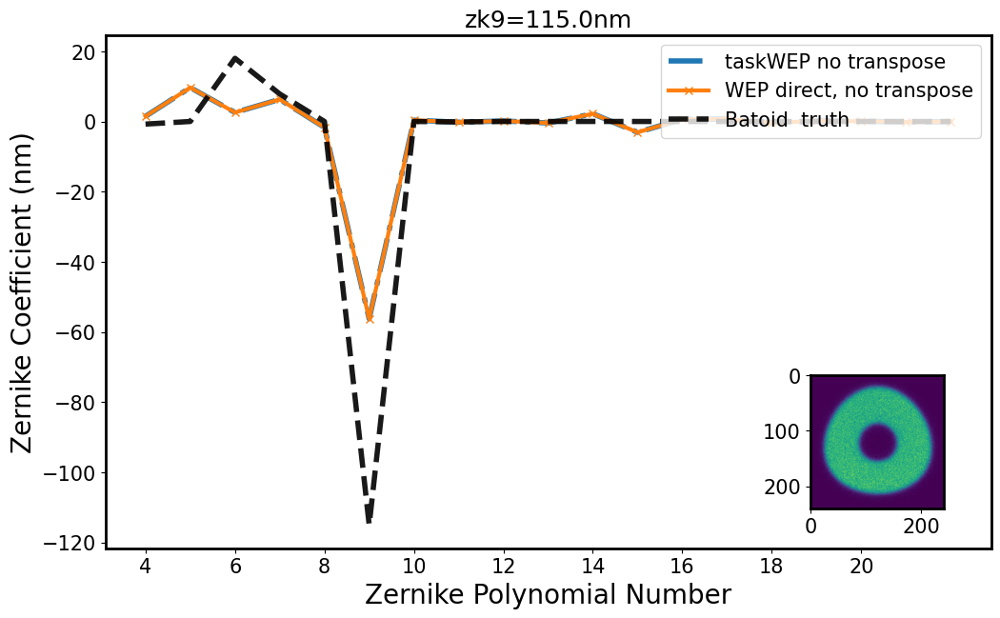

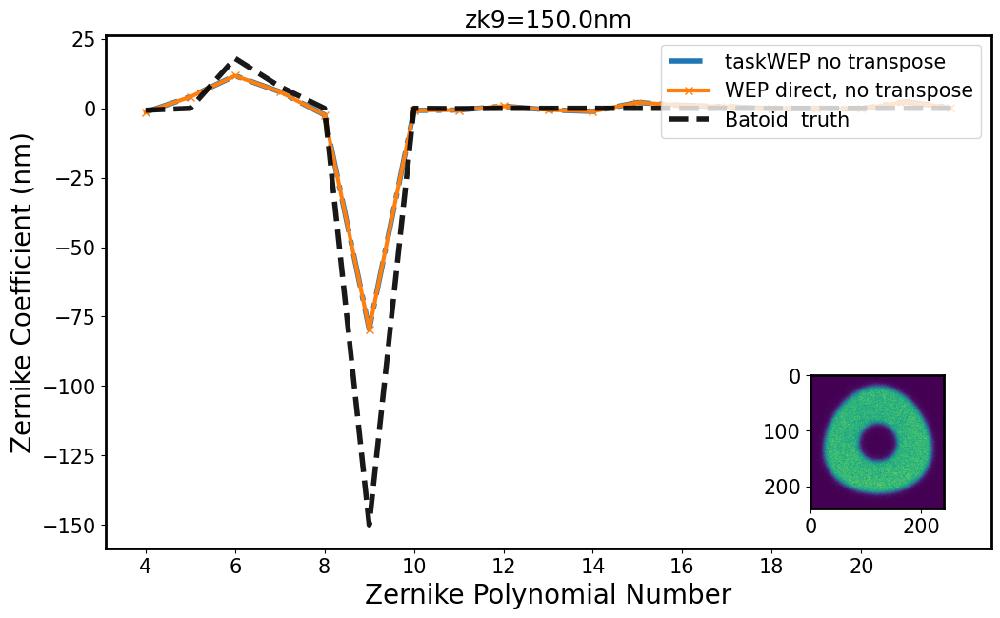

...

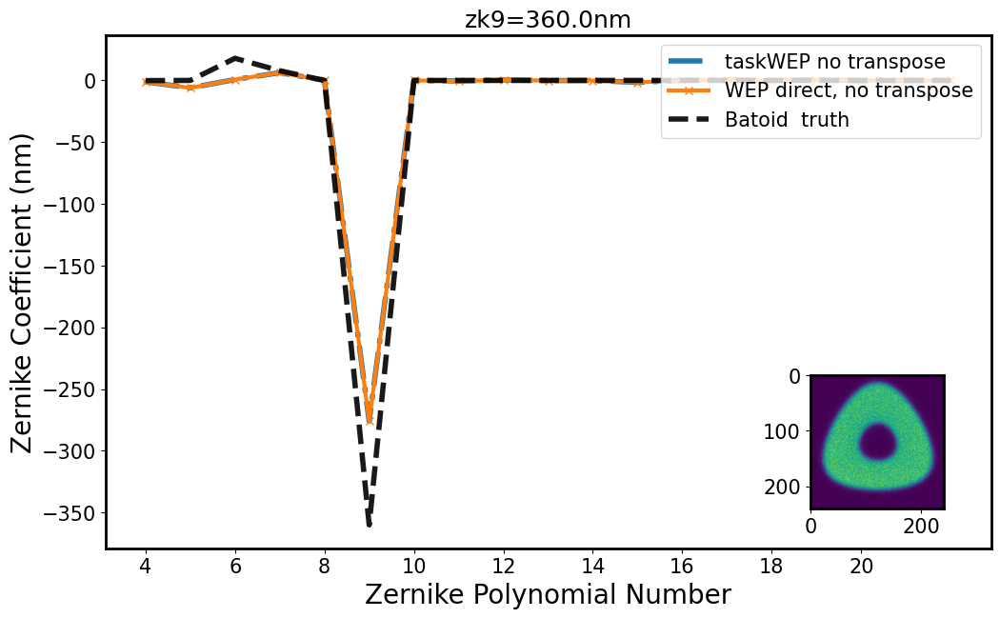

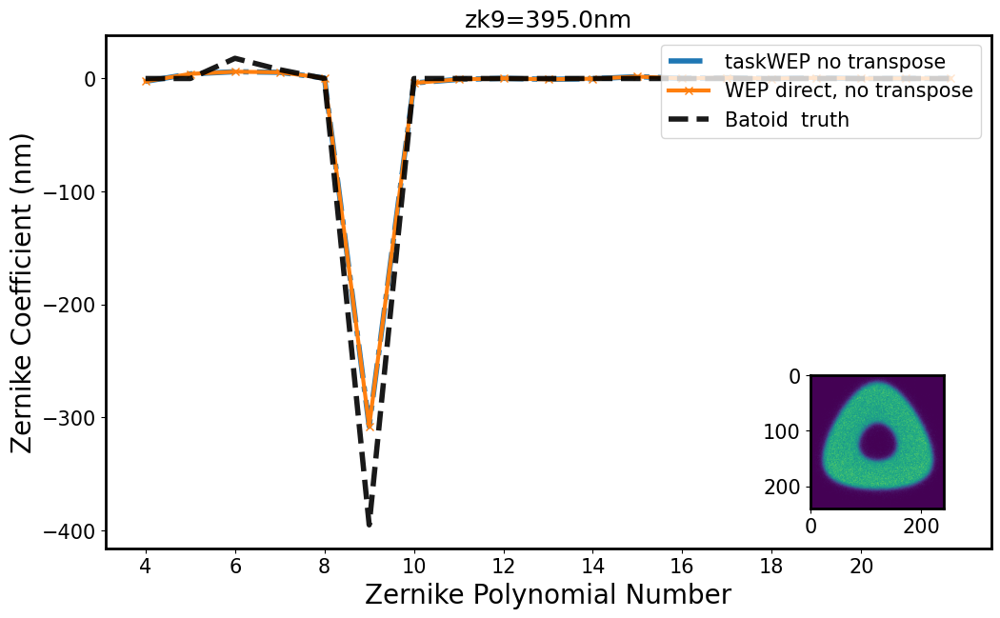

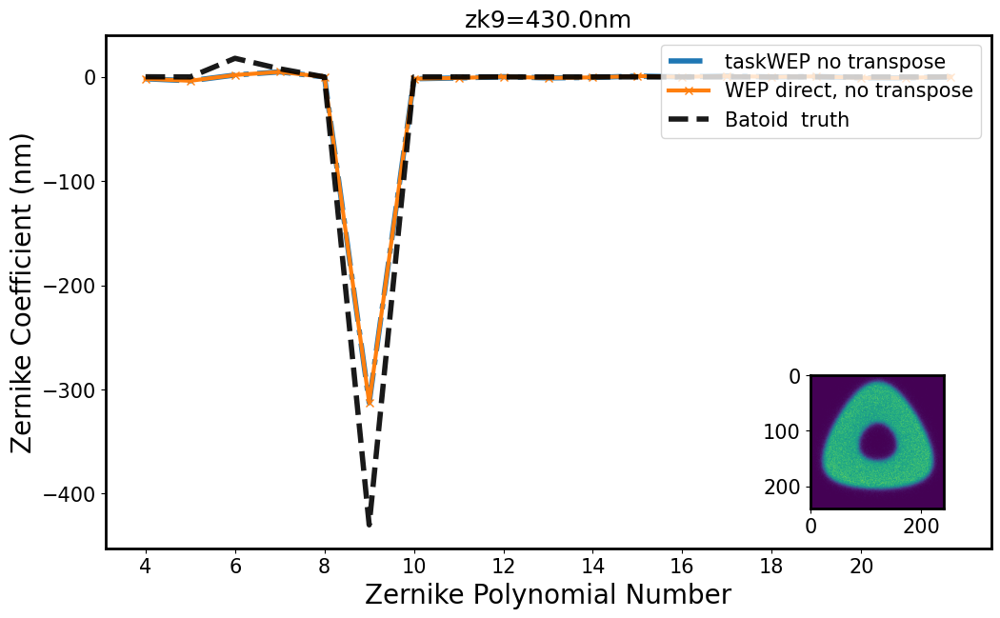

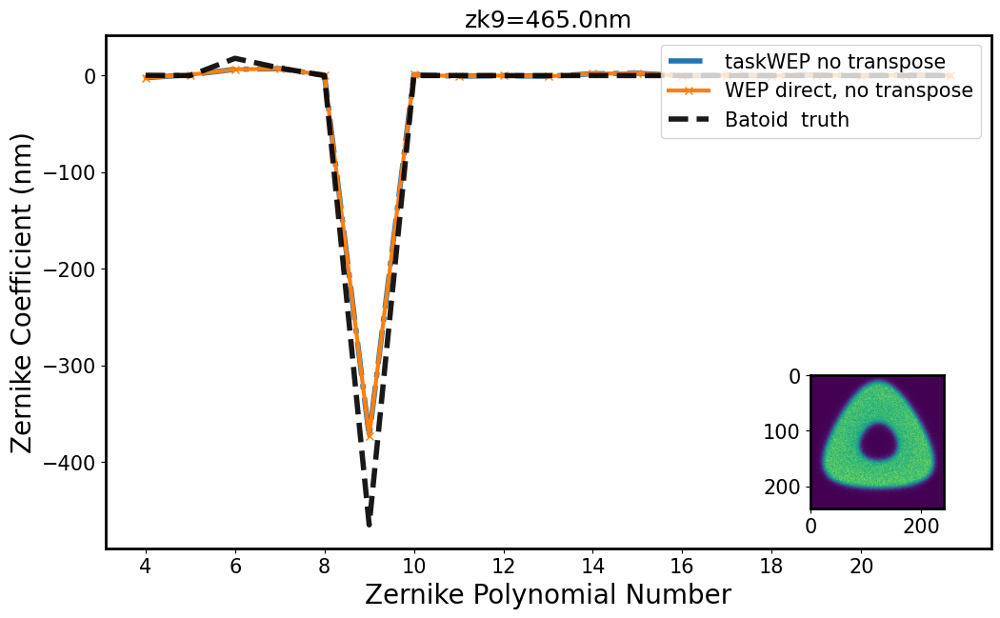

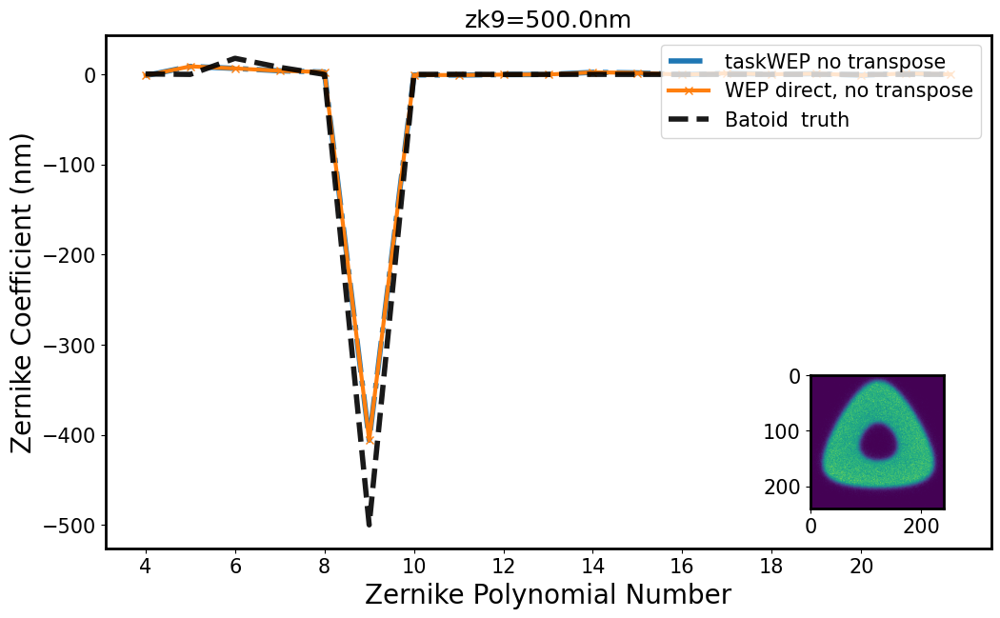

In [44]:
compare_wep_direct(zkNum = 9)

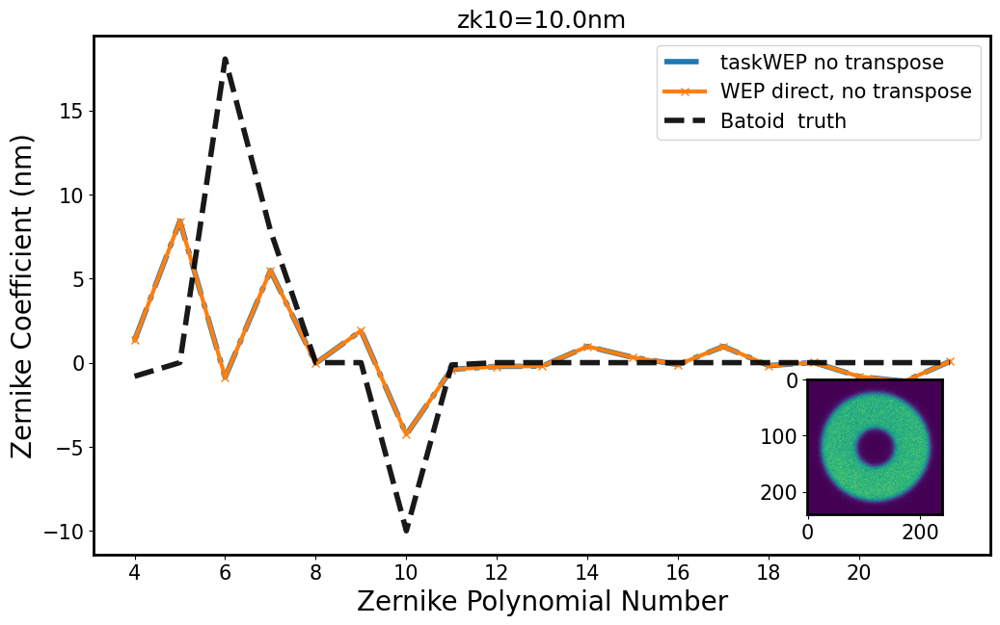

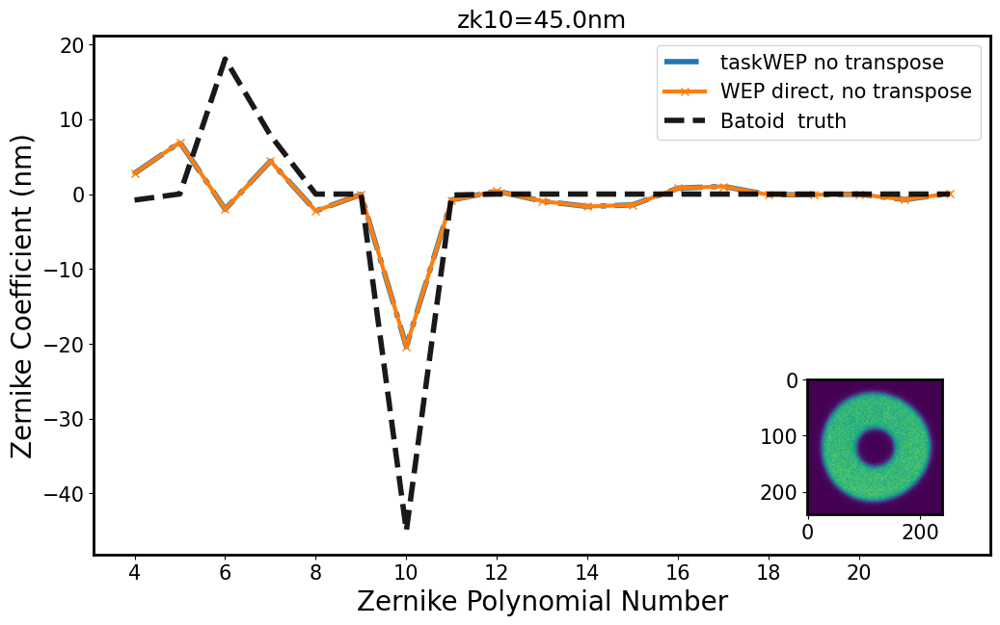

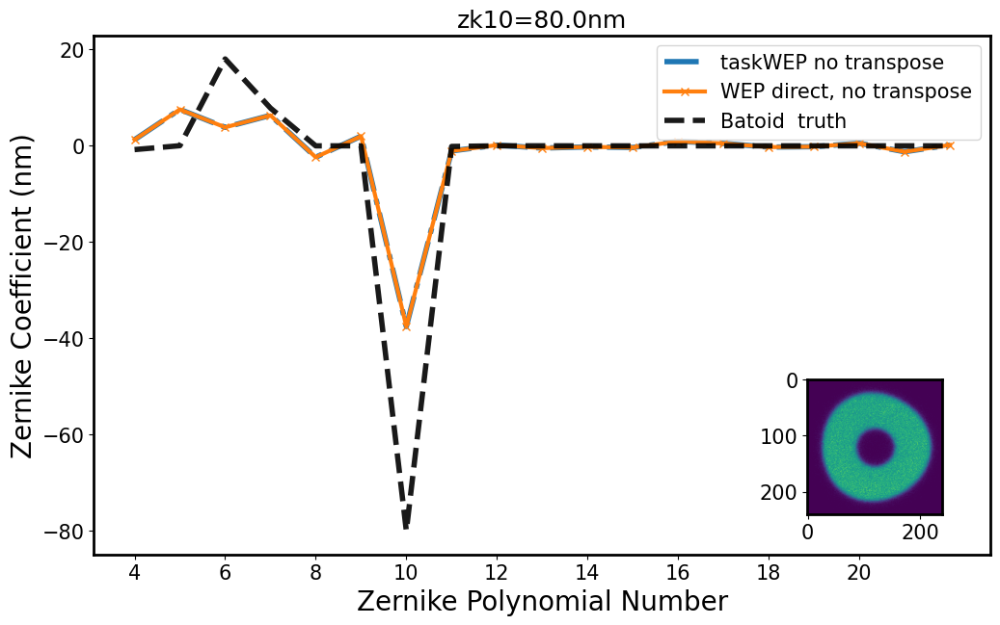

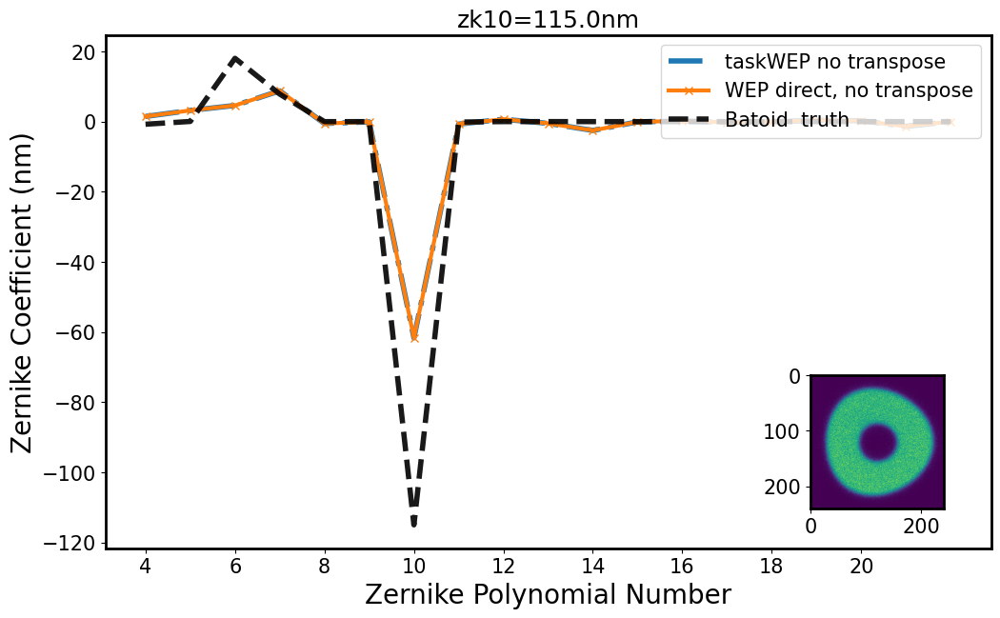

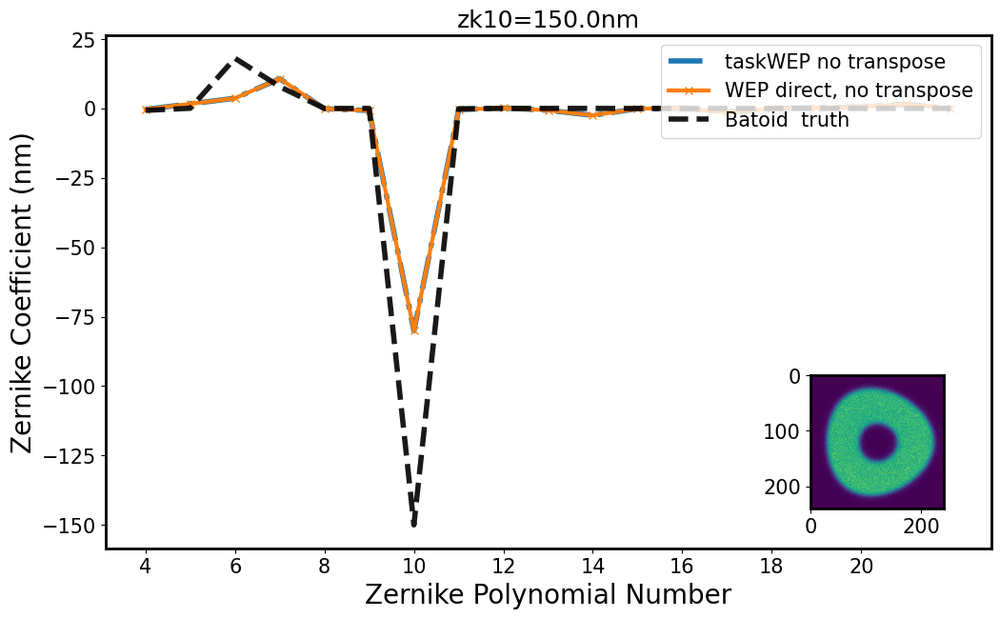

...

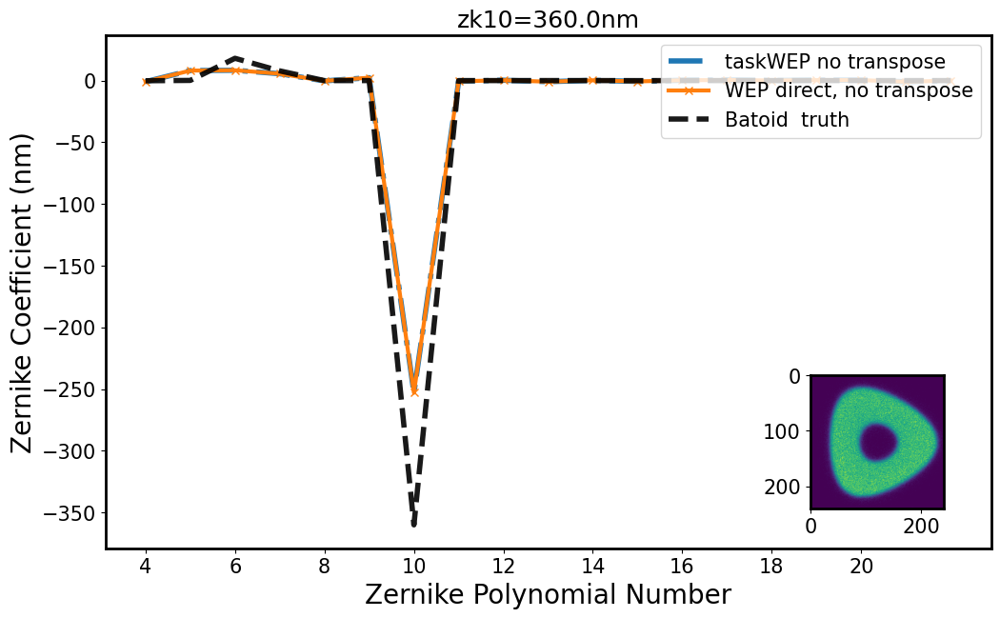

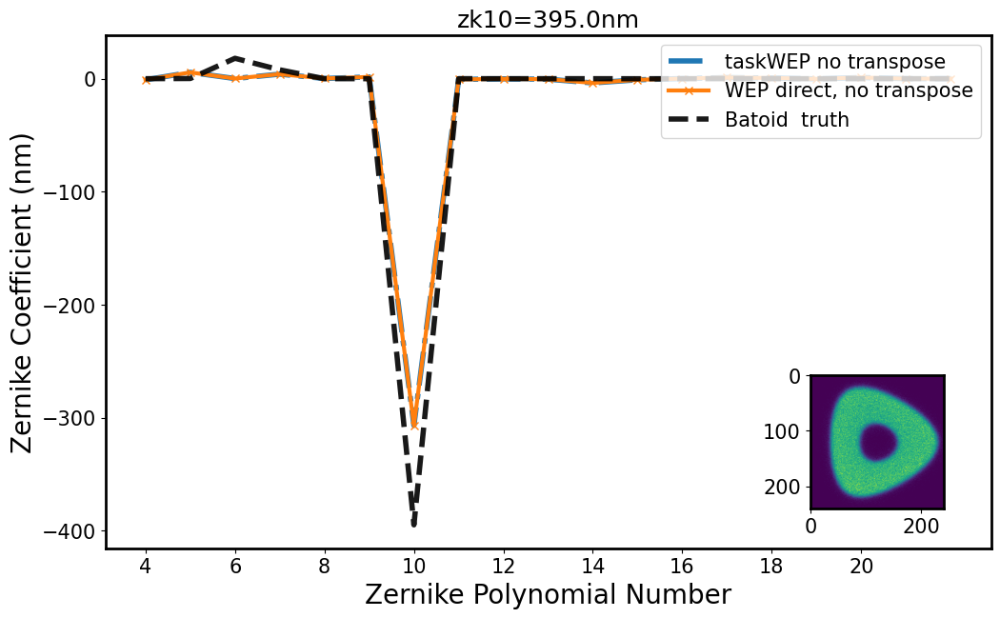

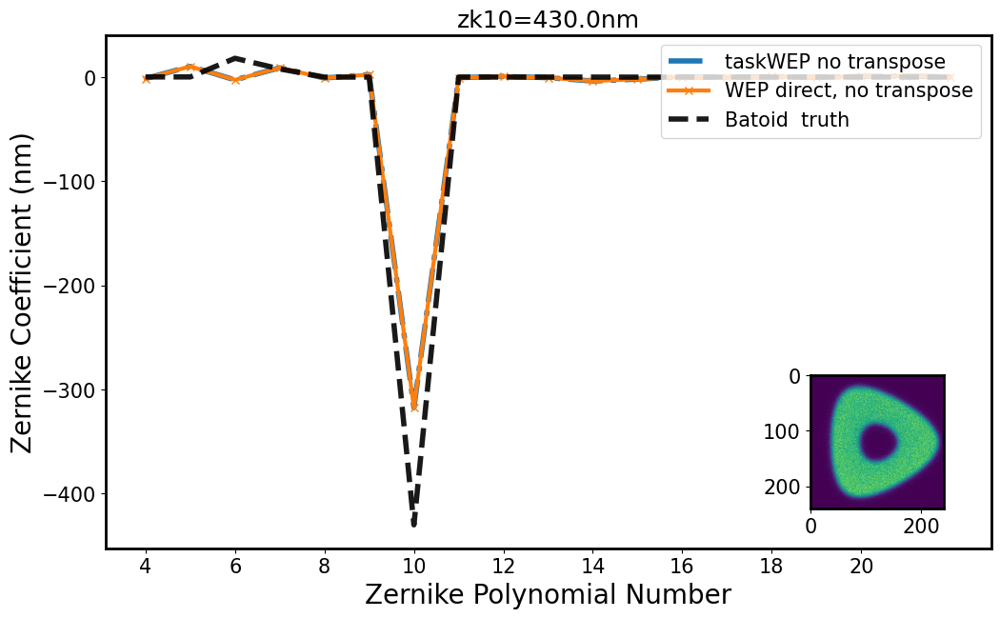

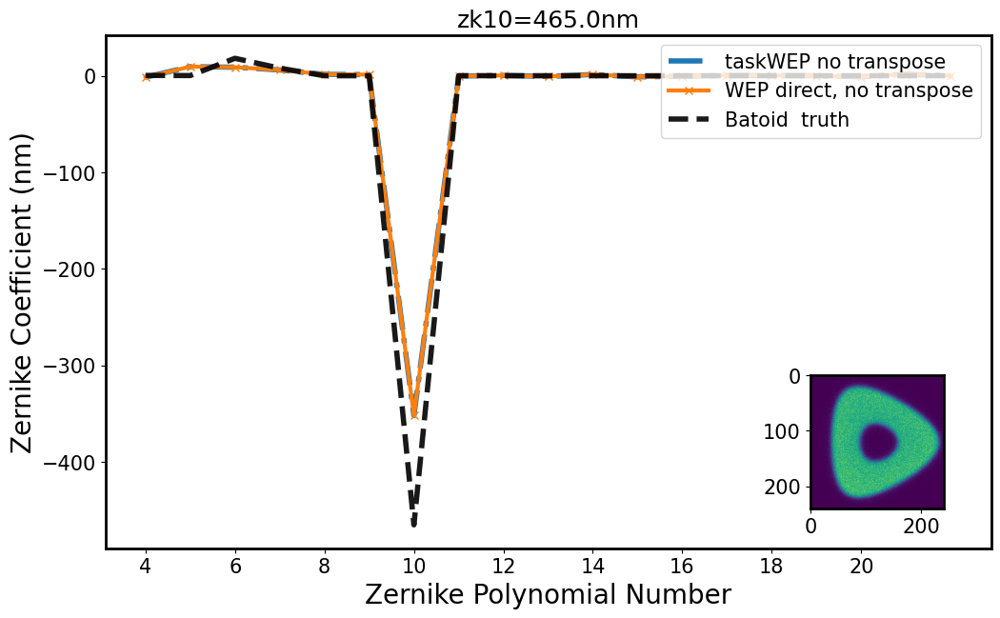

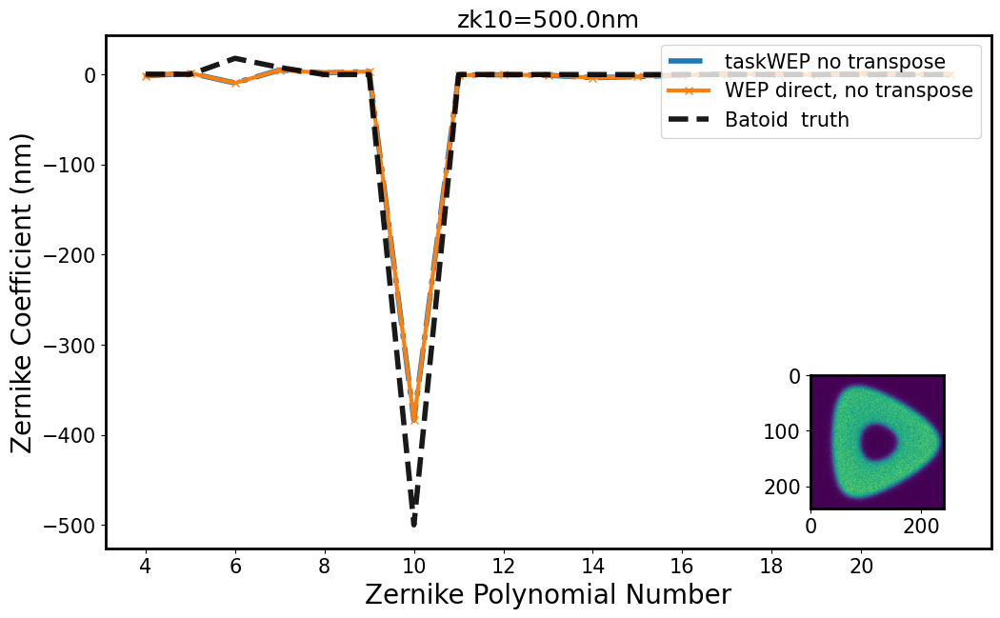

In [45]:
compare_wep_direct(zkNum = 10)

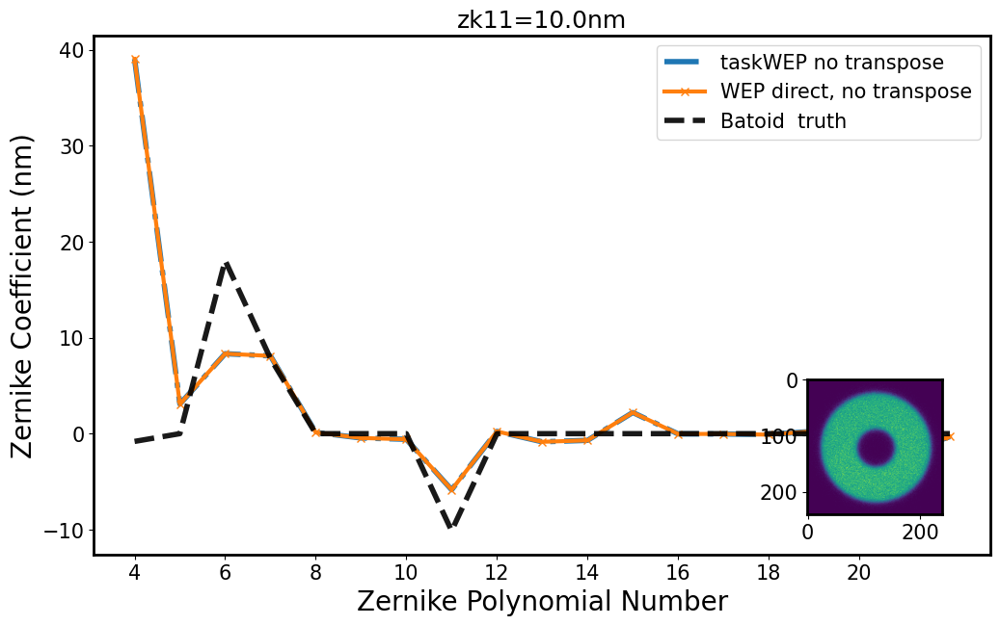

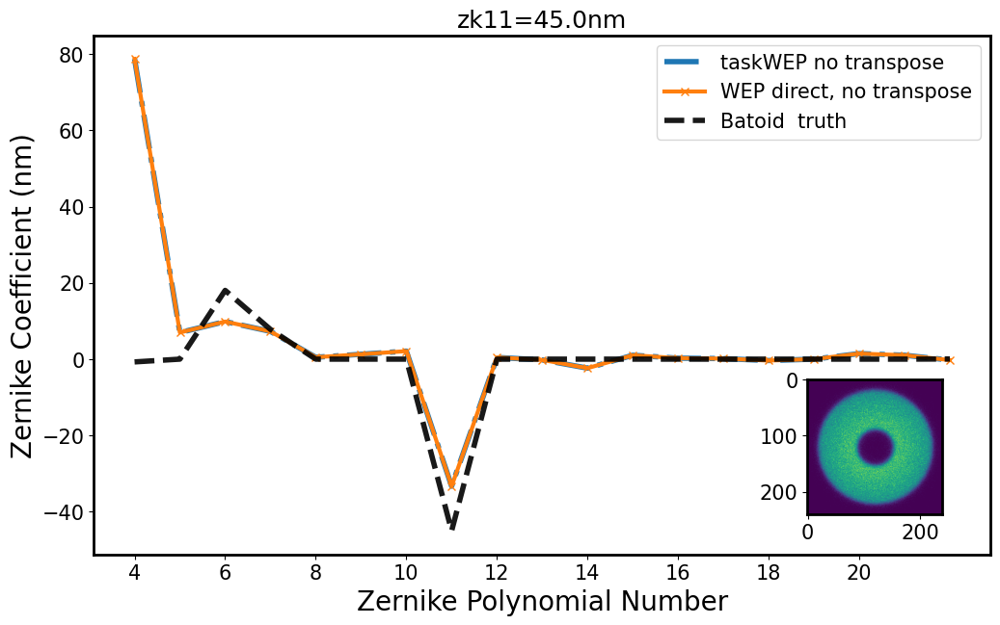

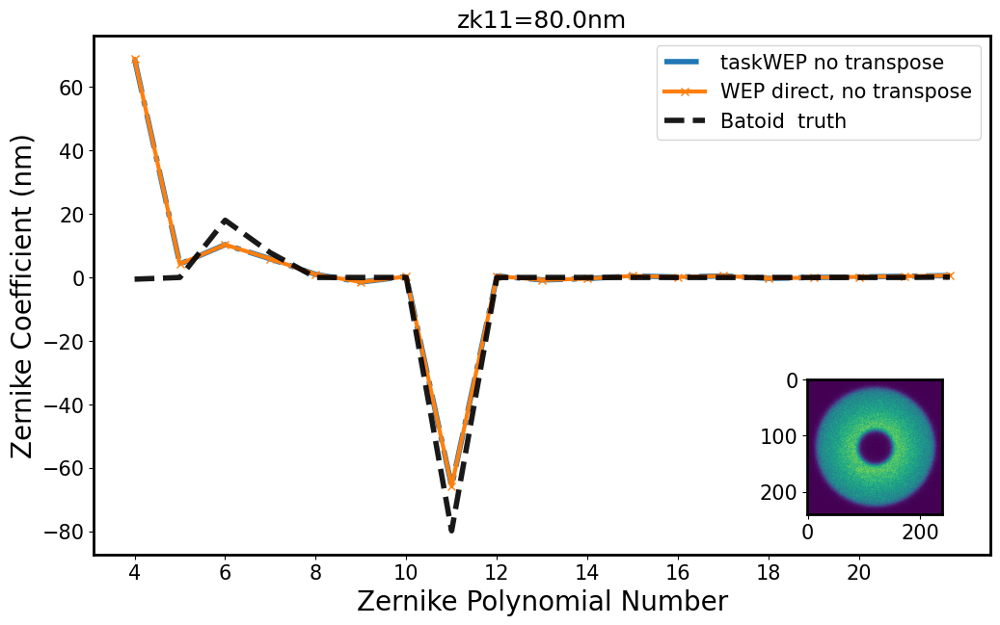

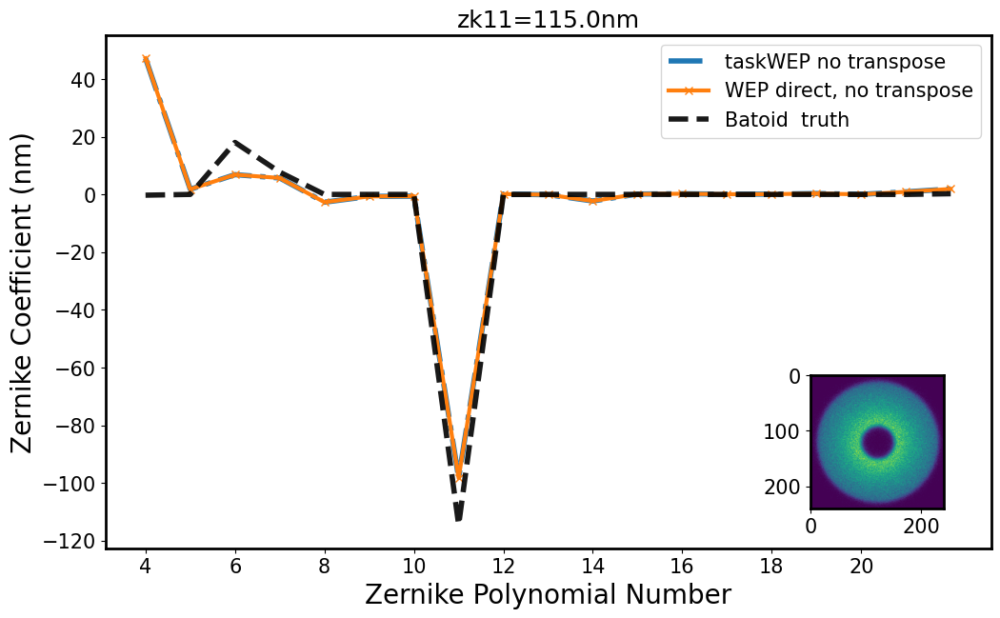

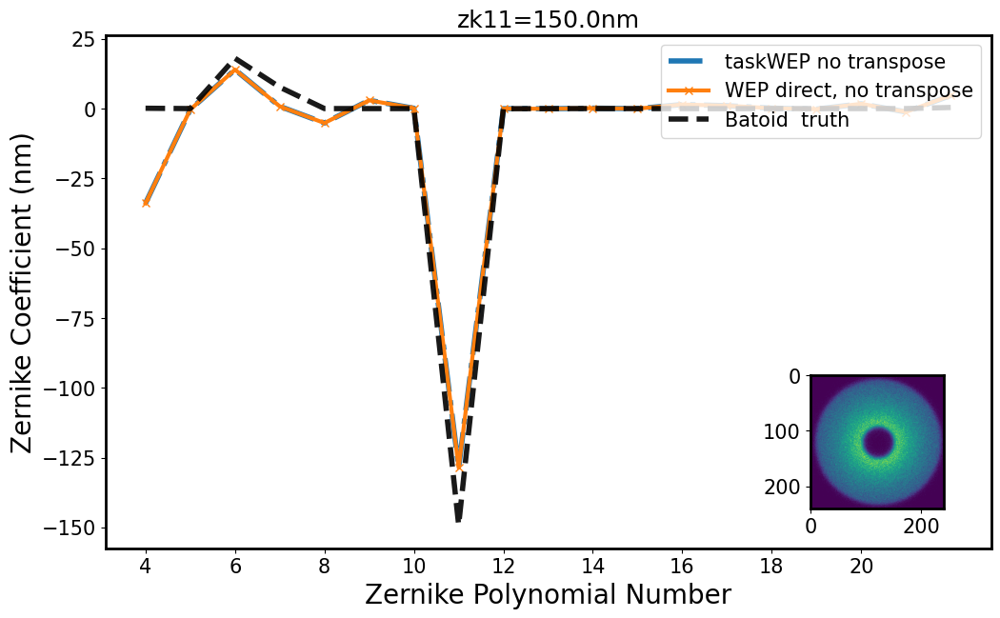

...

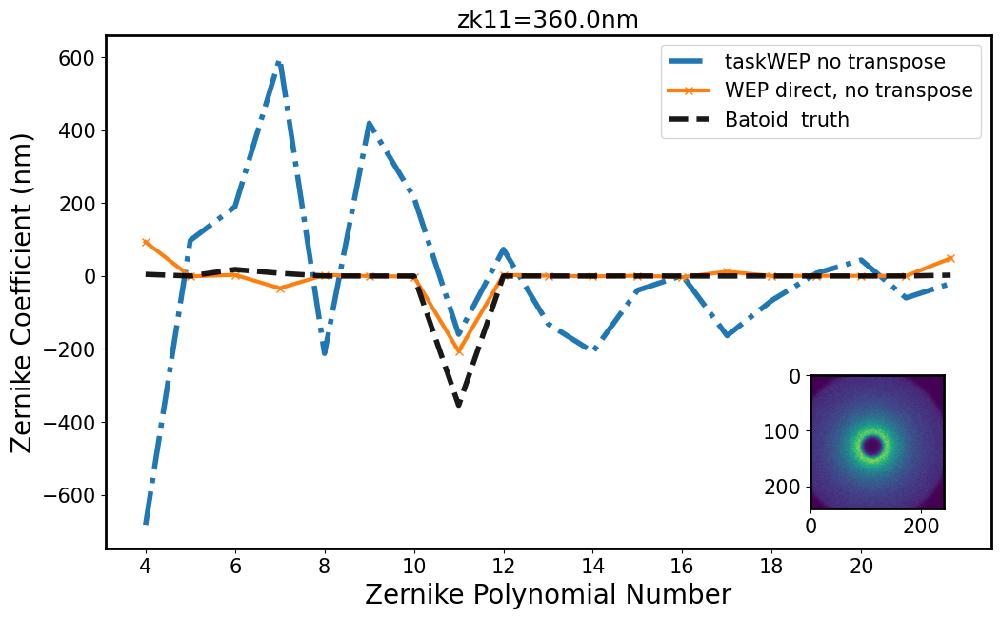

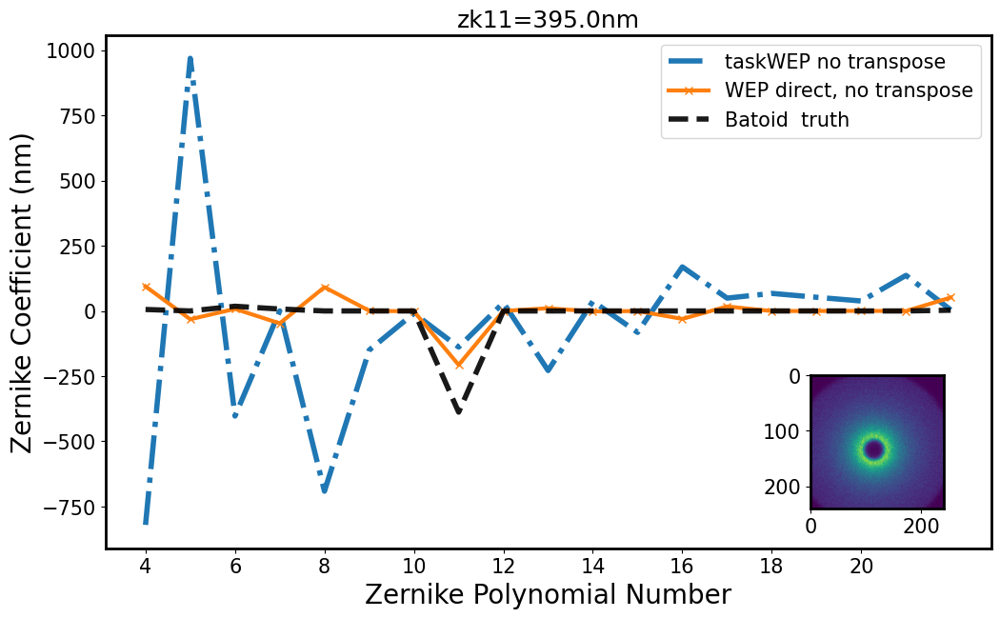

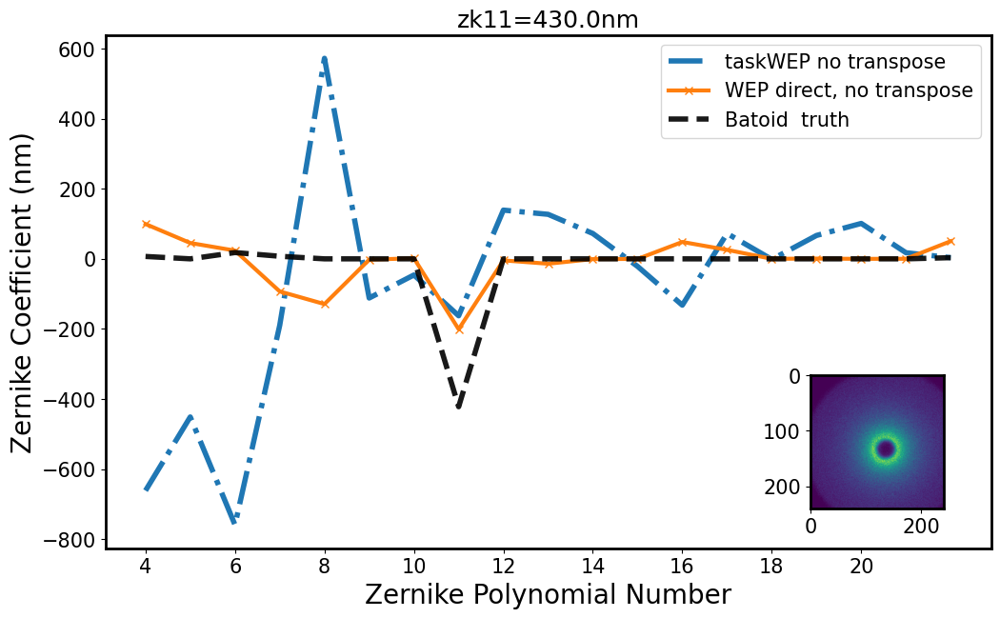

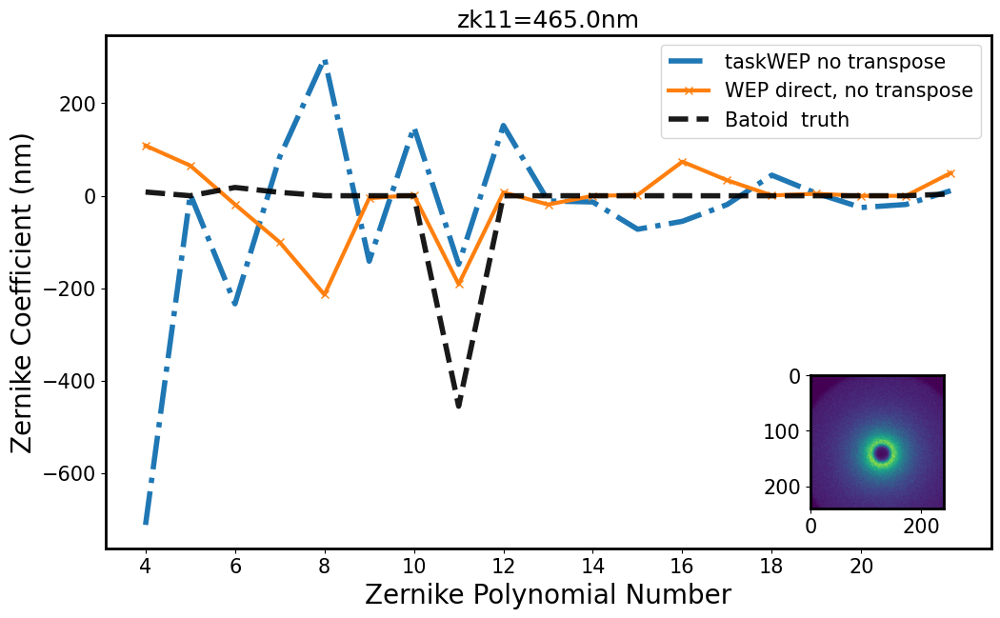

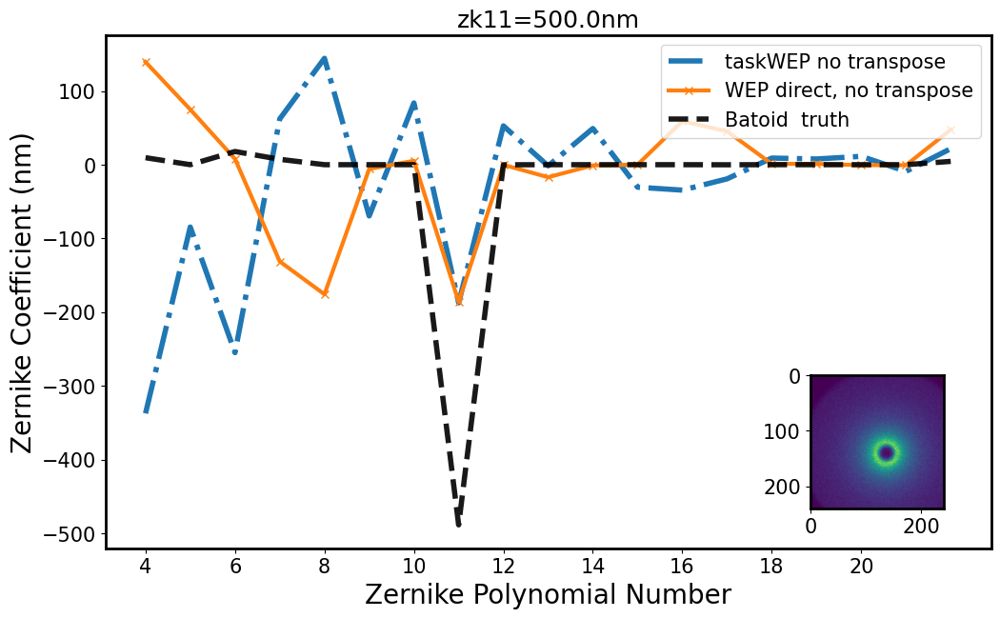

In [46]:
compare_wep_direct(zkNum = 11)

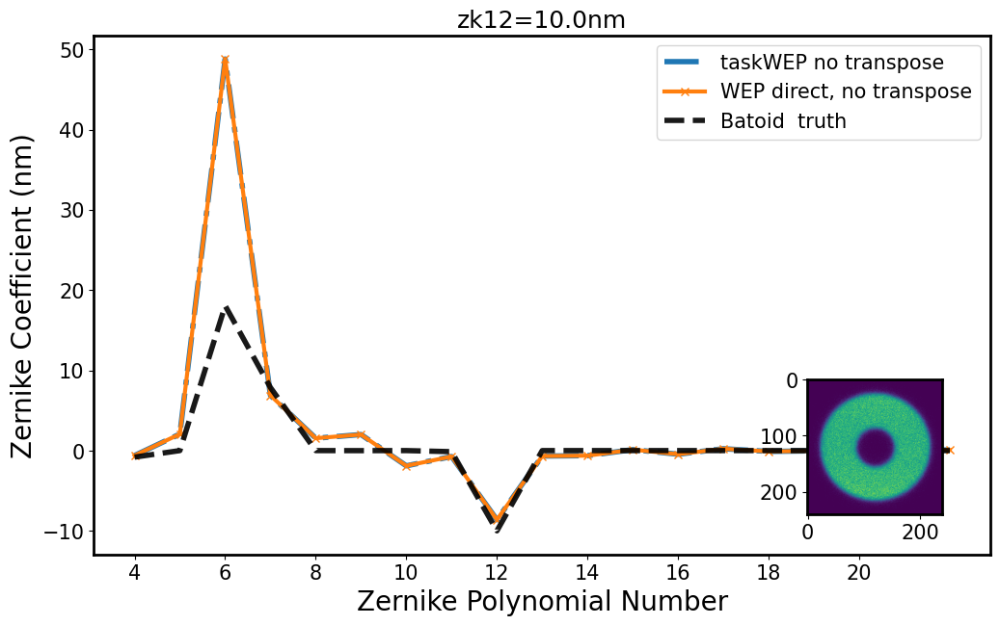

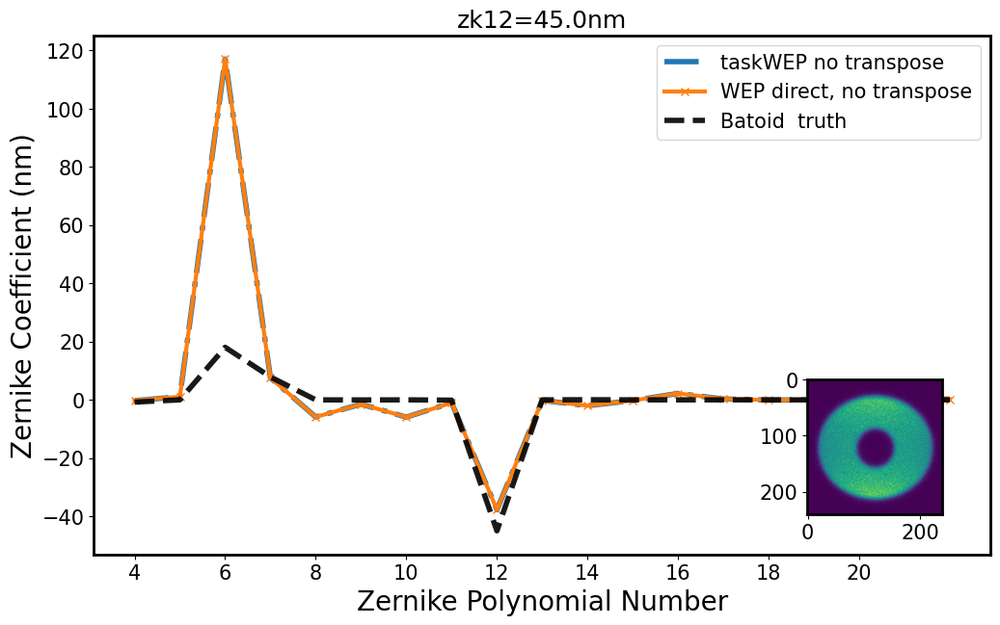

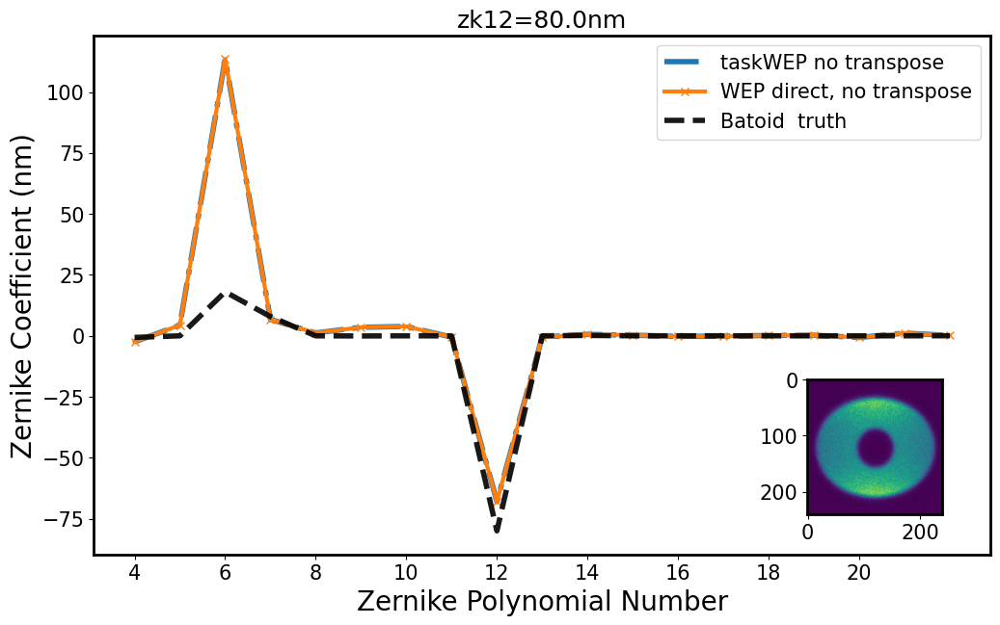

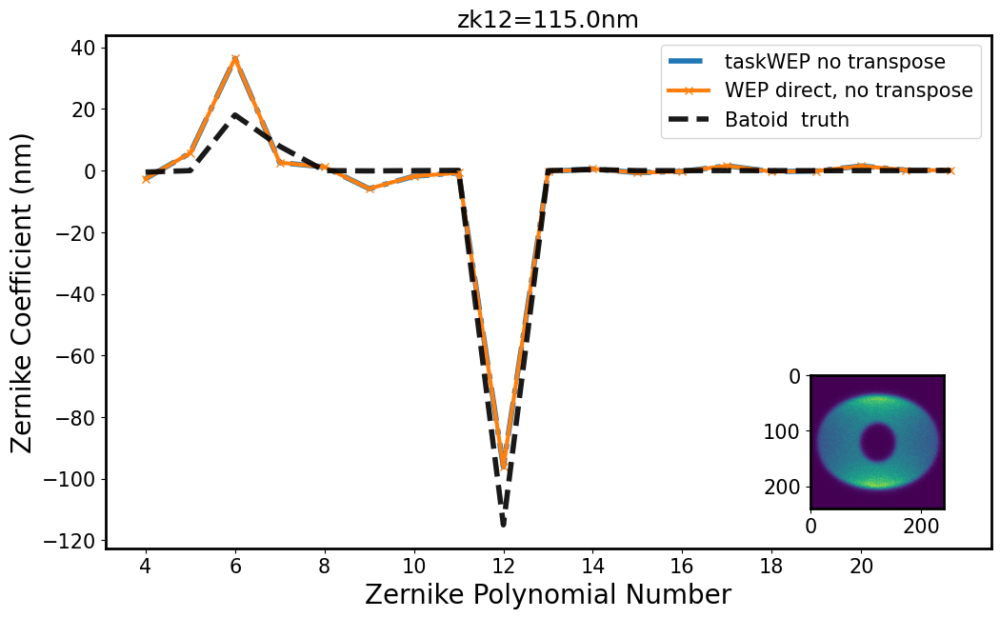

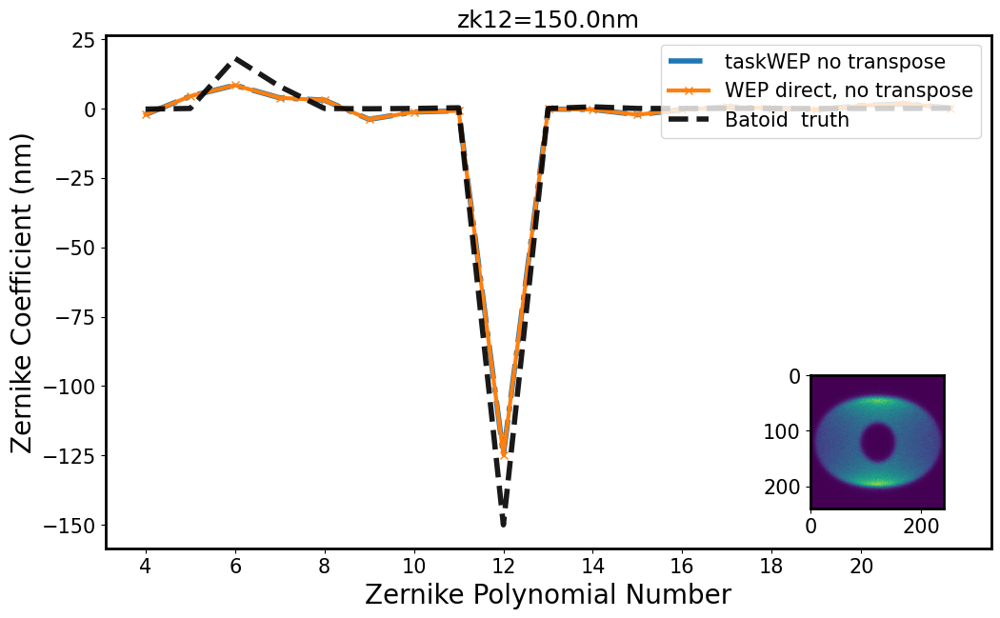

...

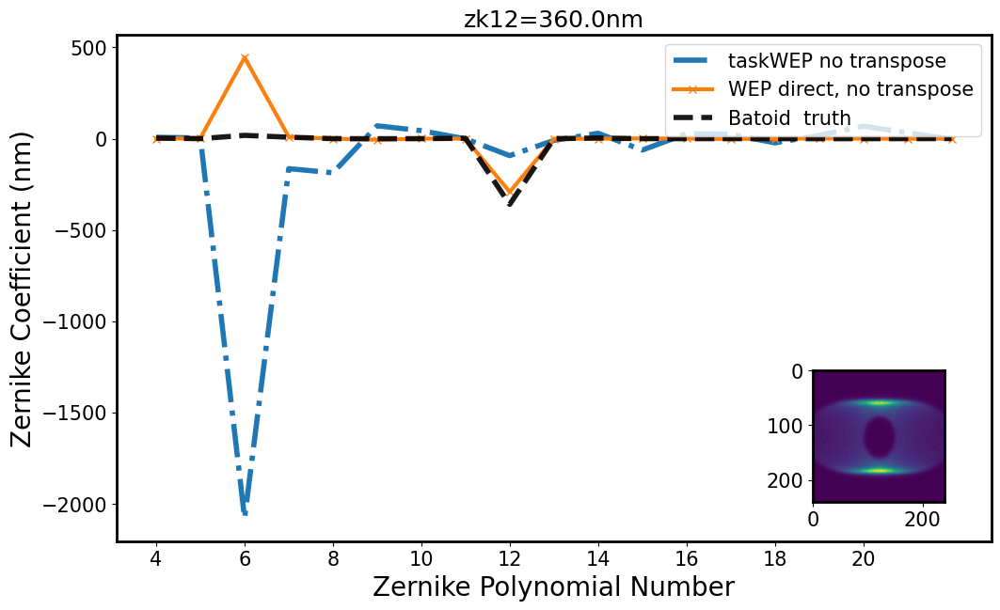

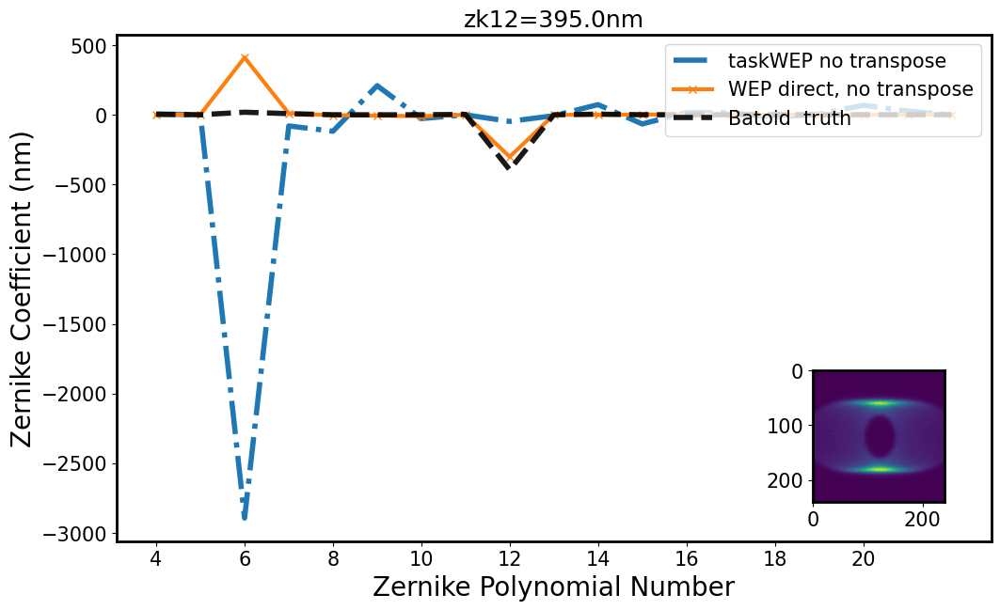

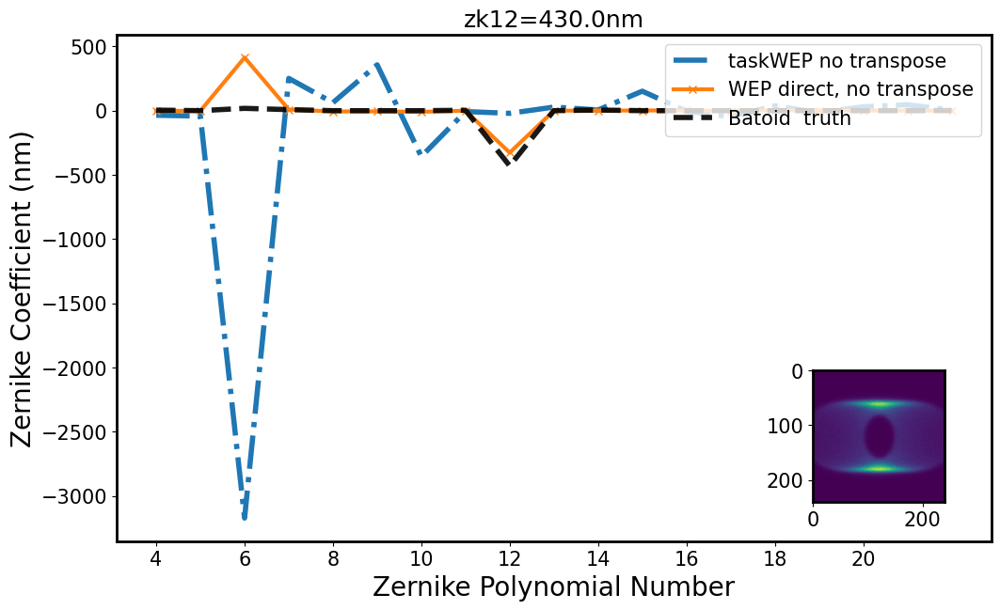

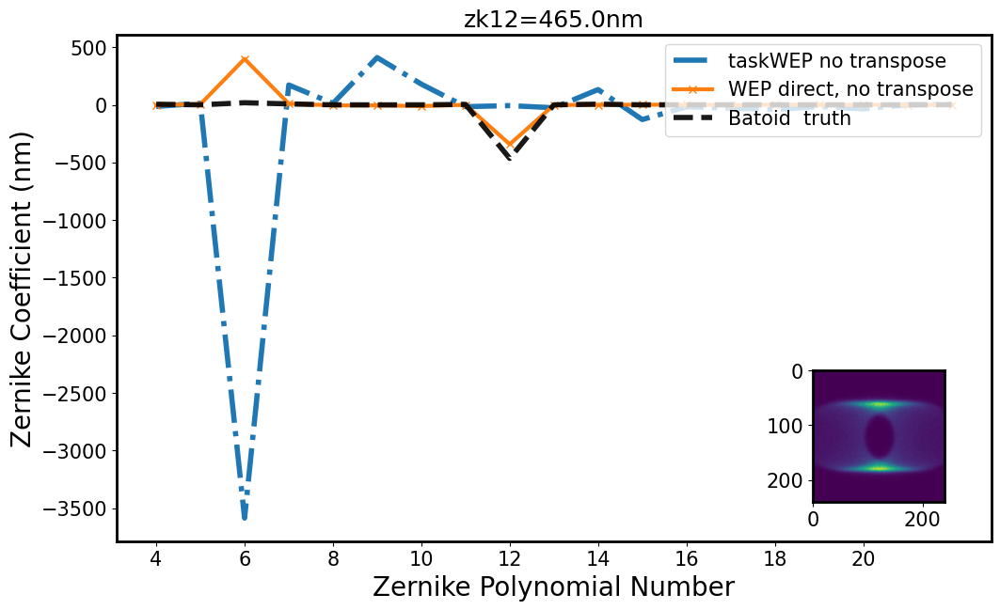

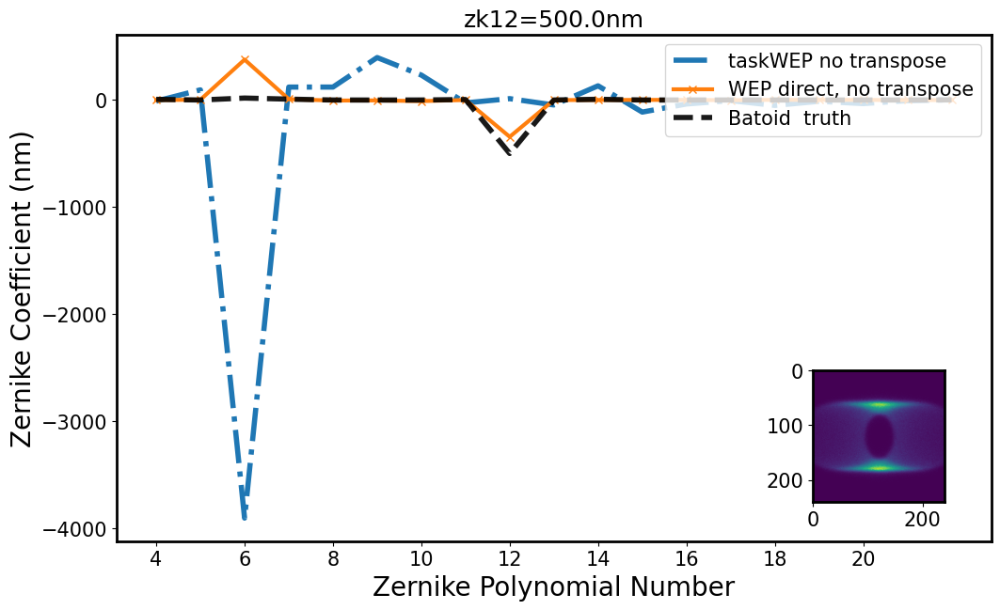

In [47]:
compare_wep_direct(zkNum = 12)

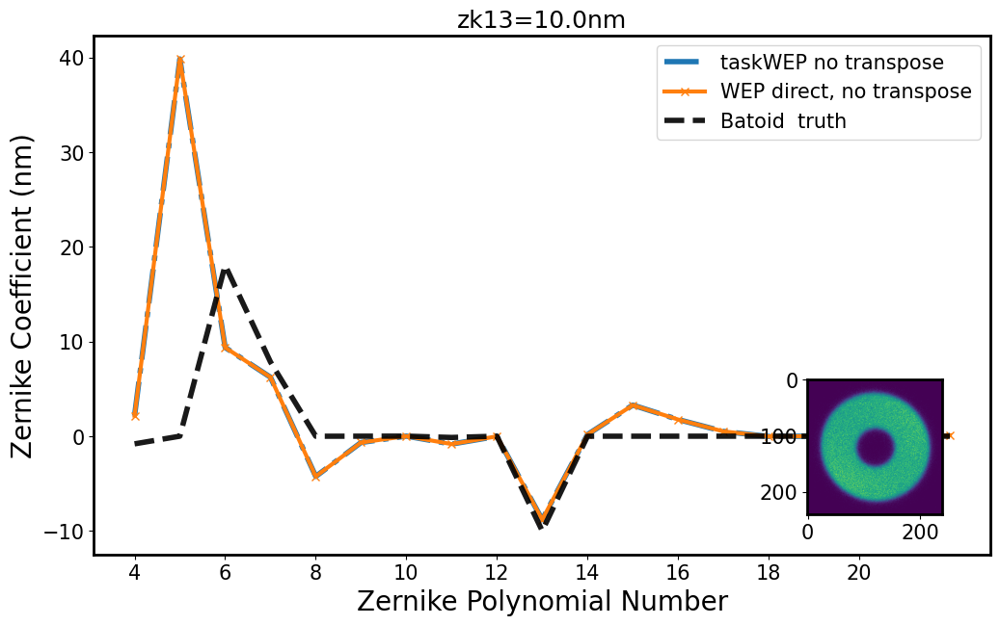

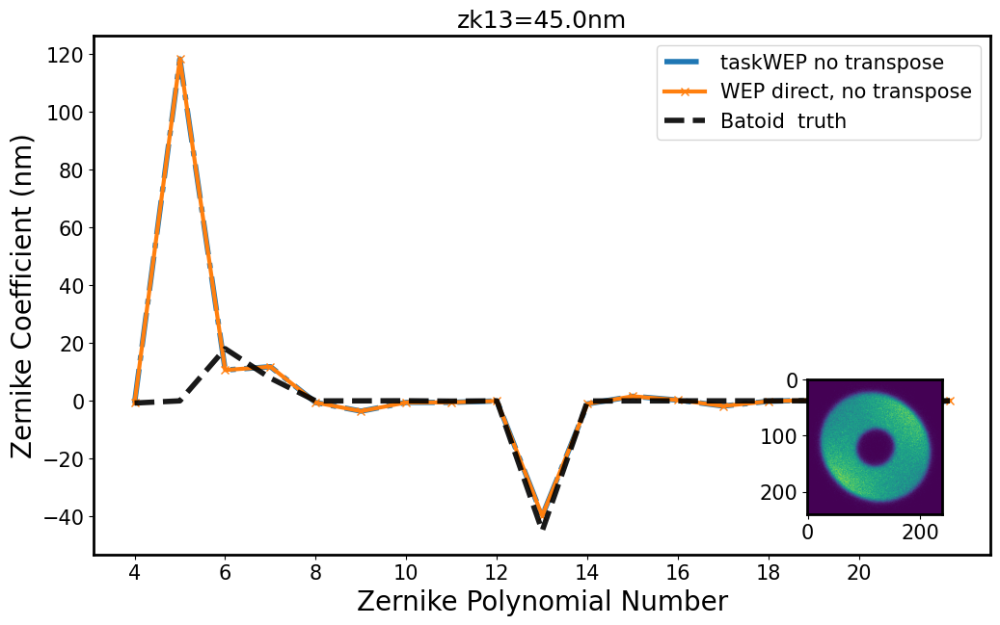

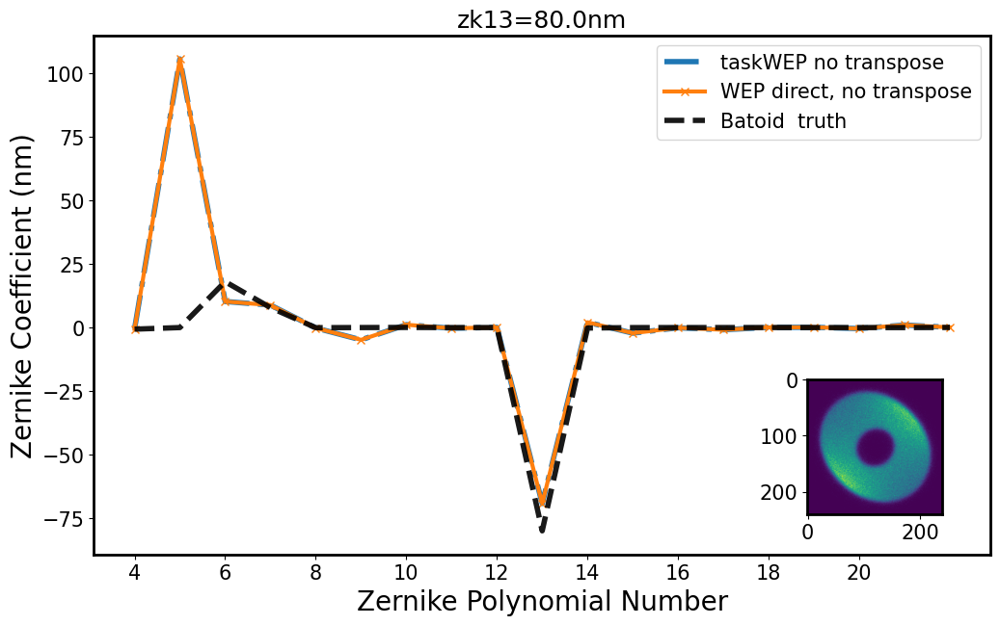

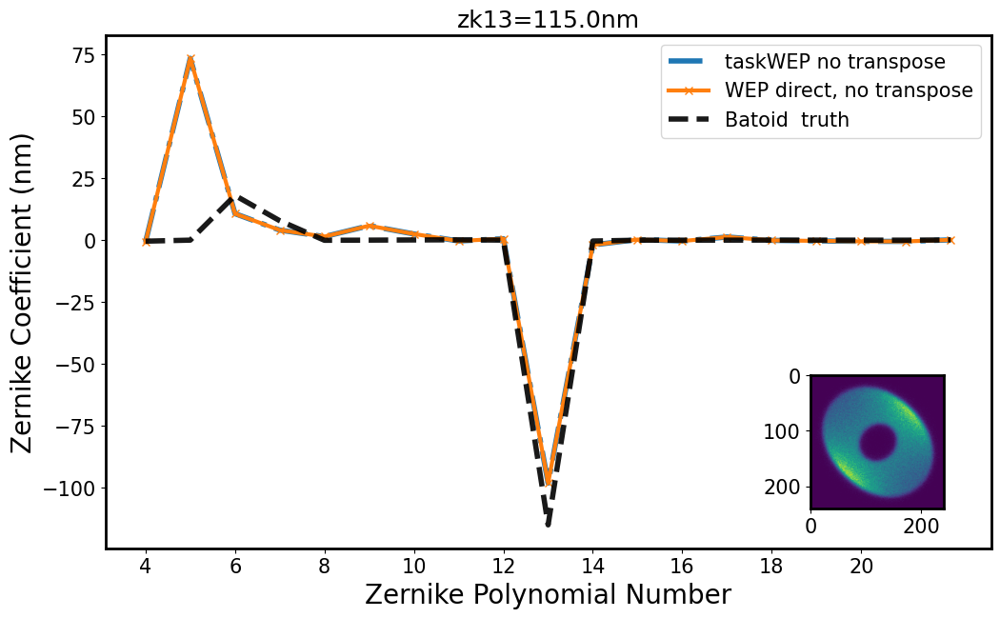

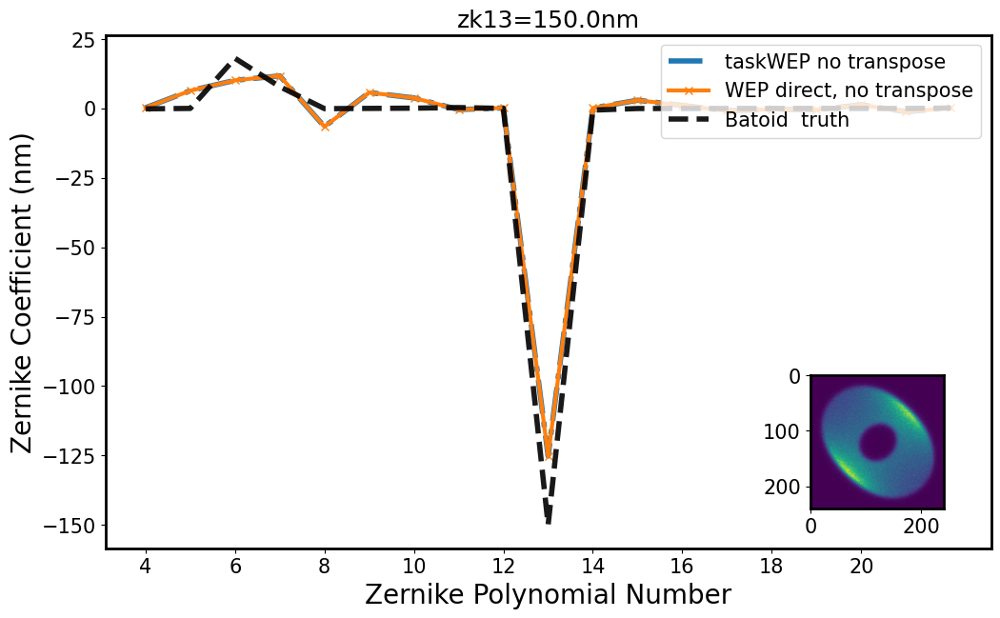

...

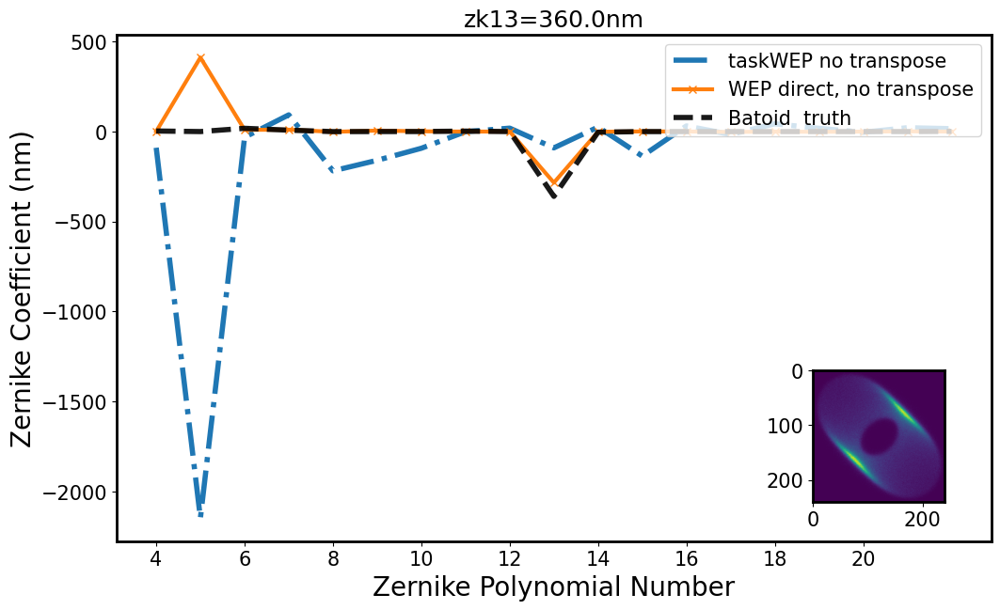

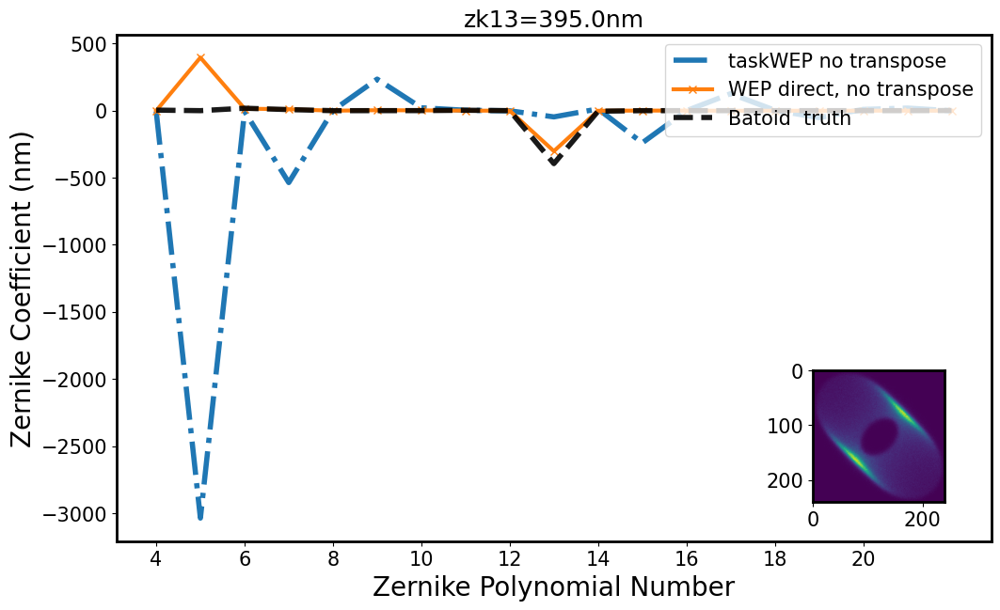

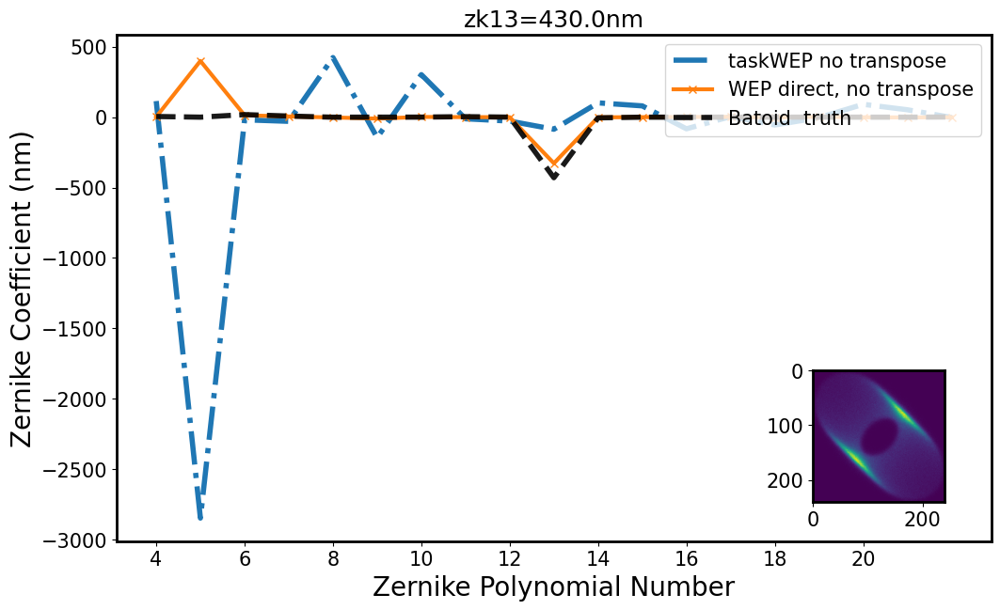

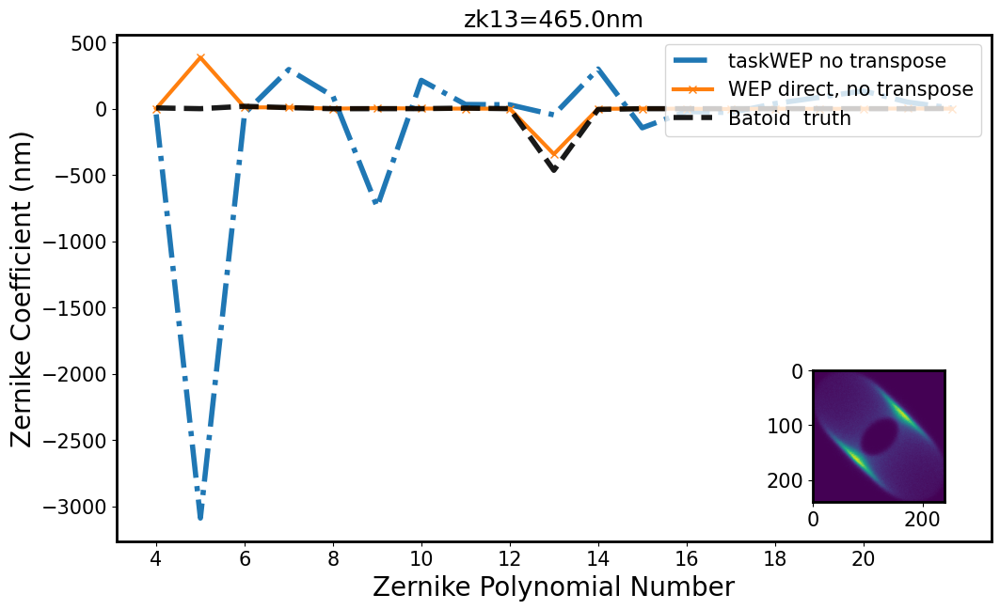

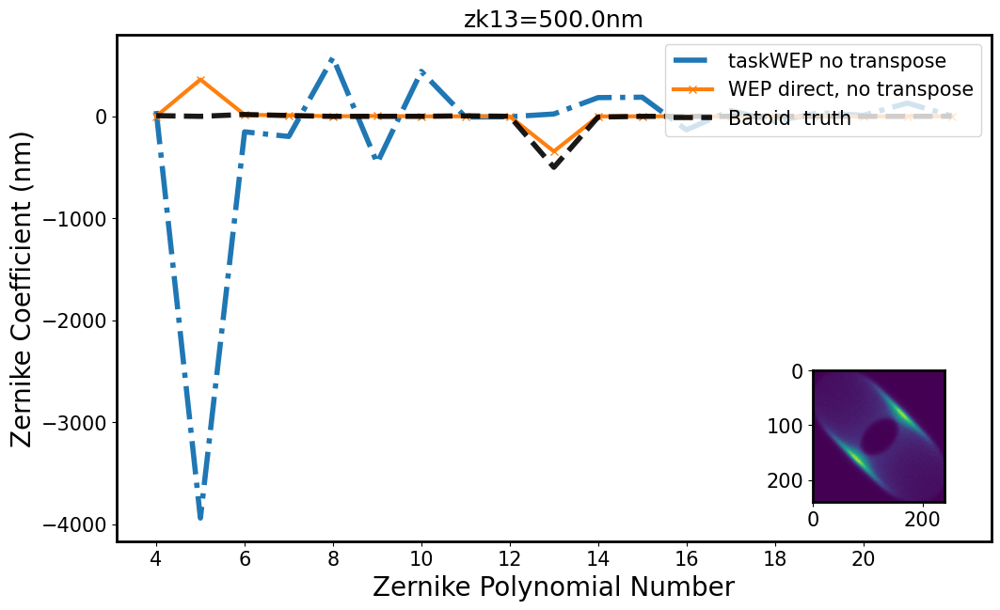

In [48]:
compare_wep_direct(zkNum = 13)

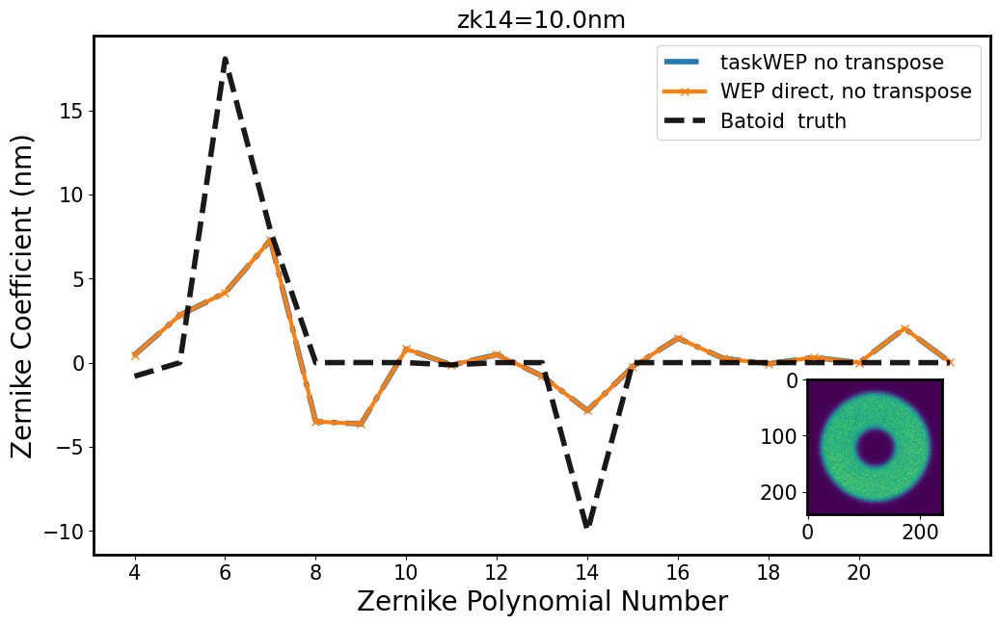

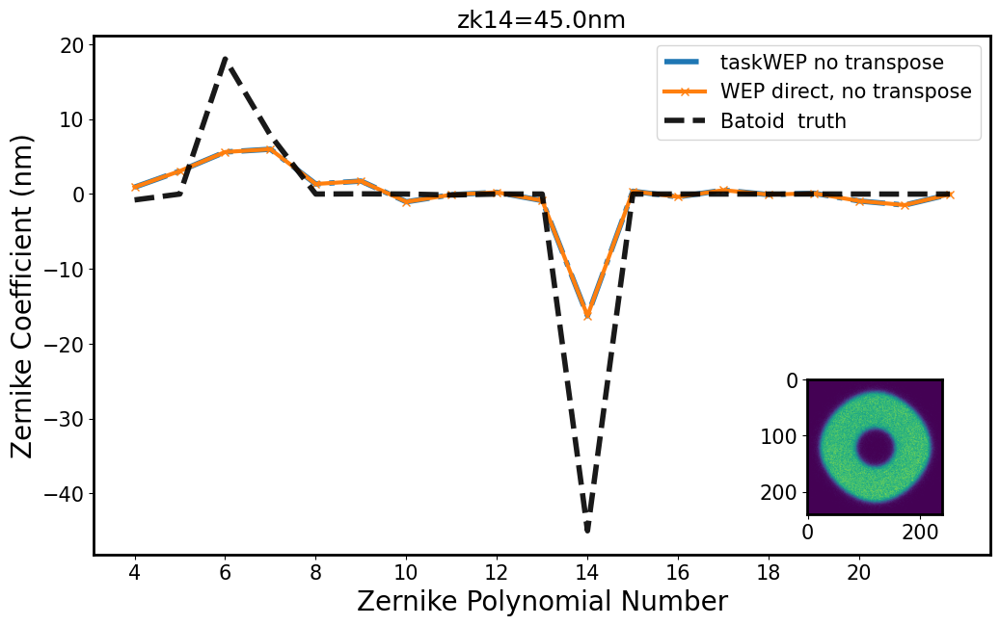

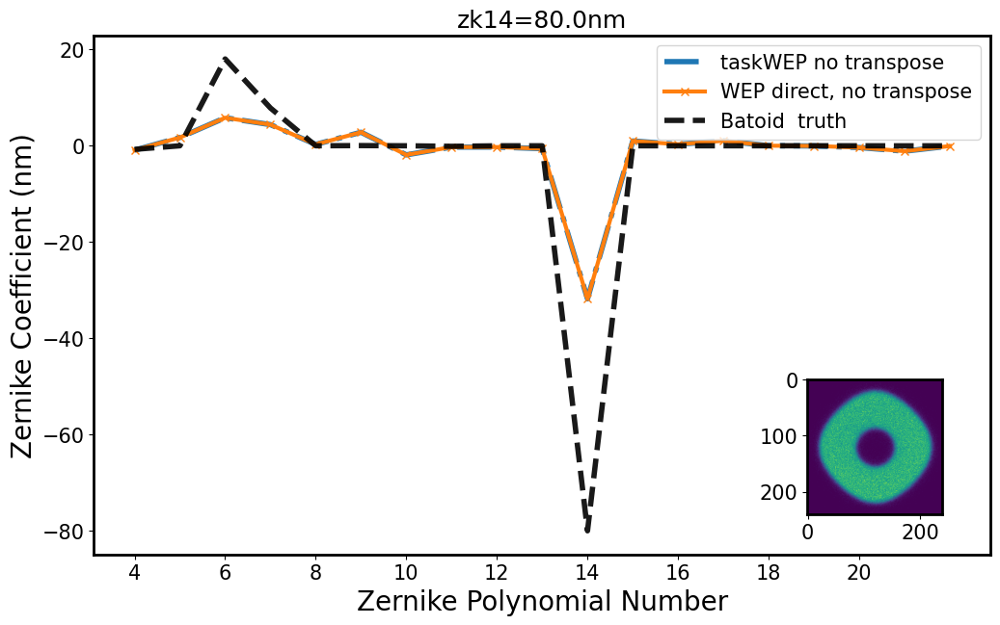

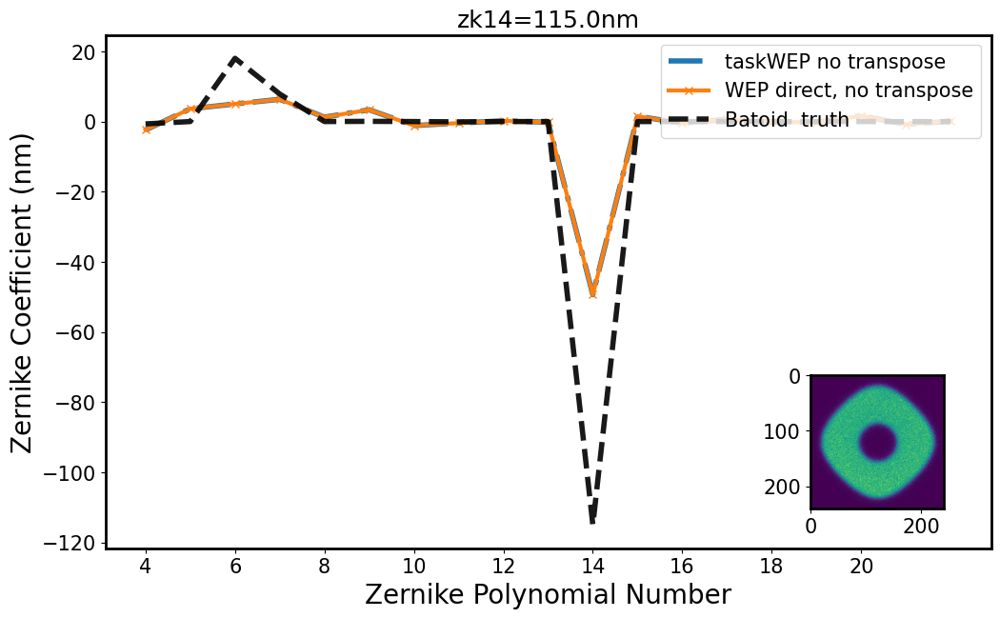

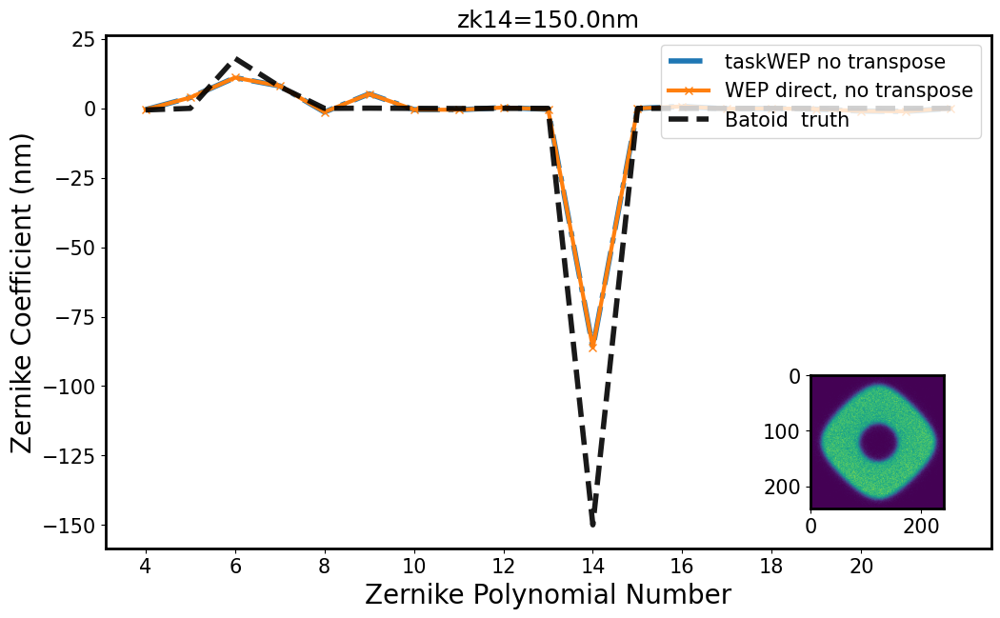

...

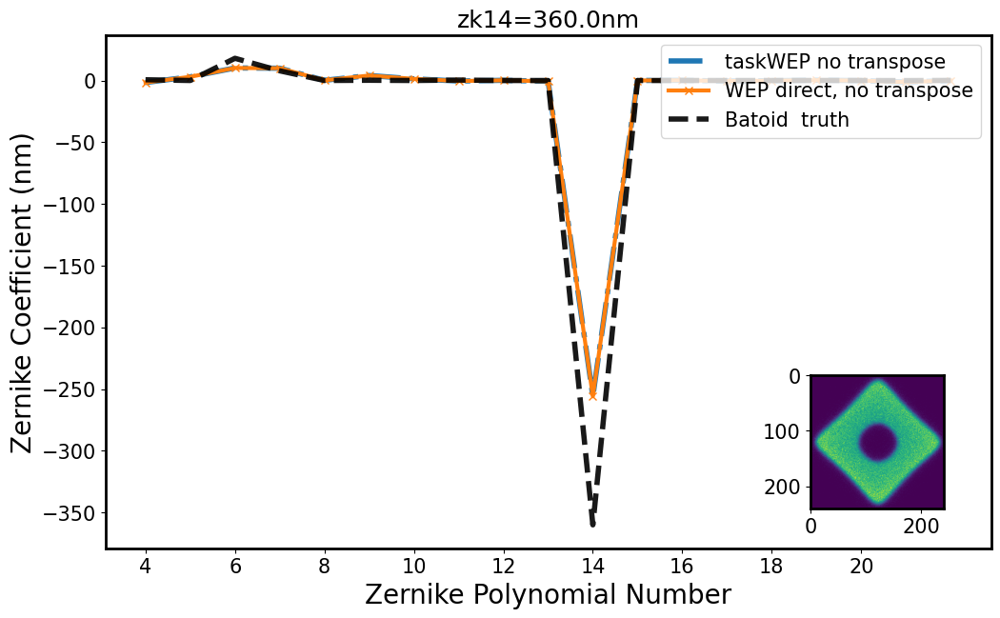

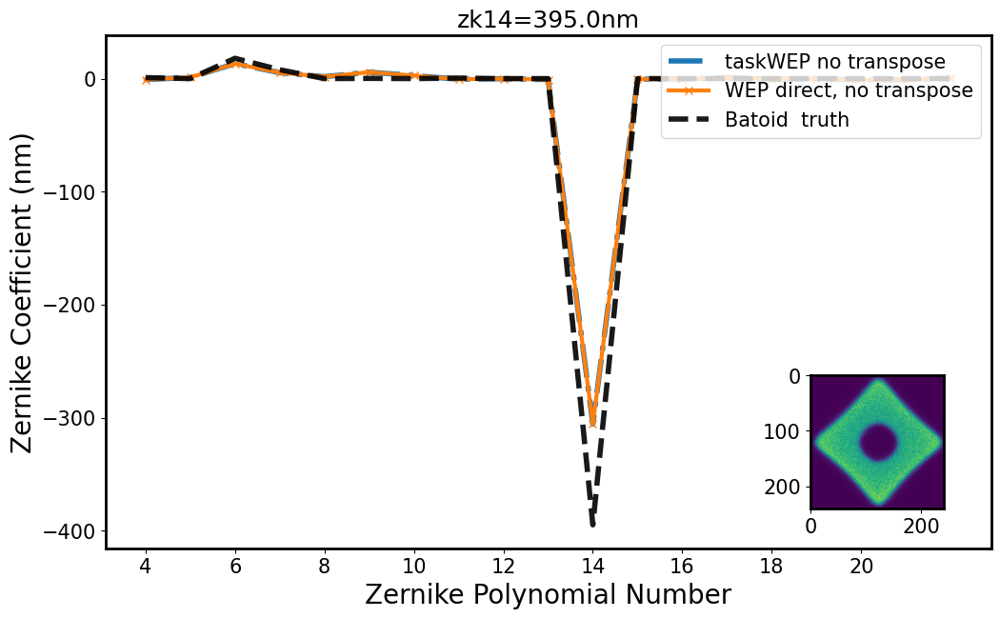

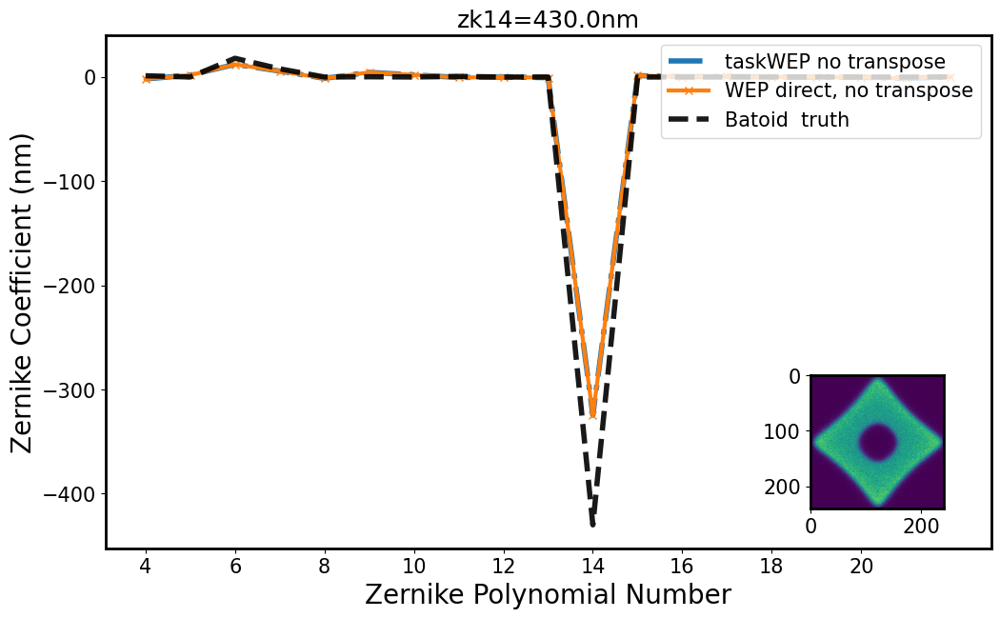

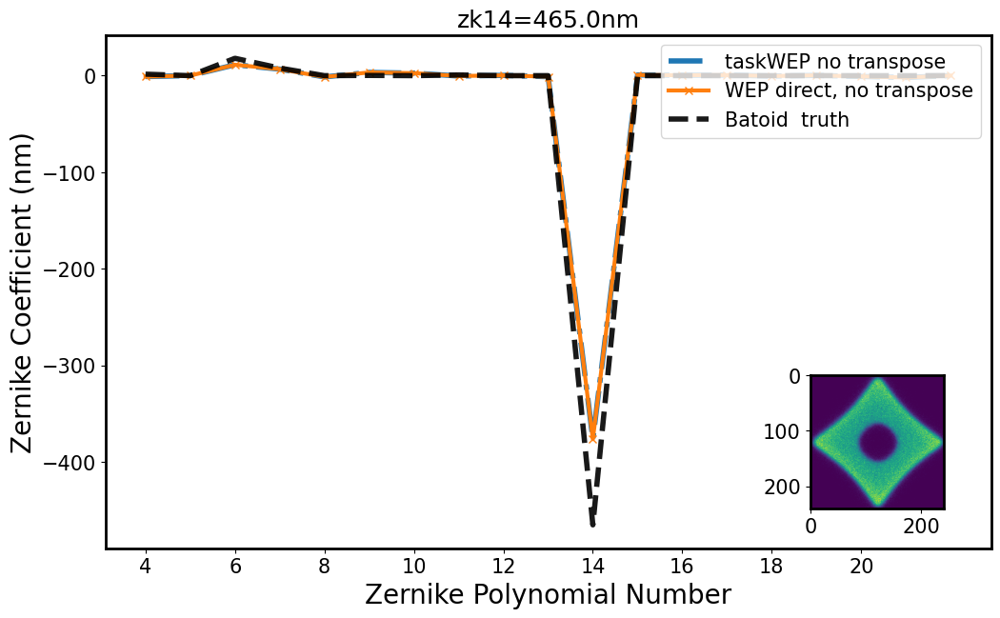

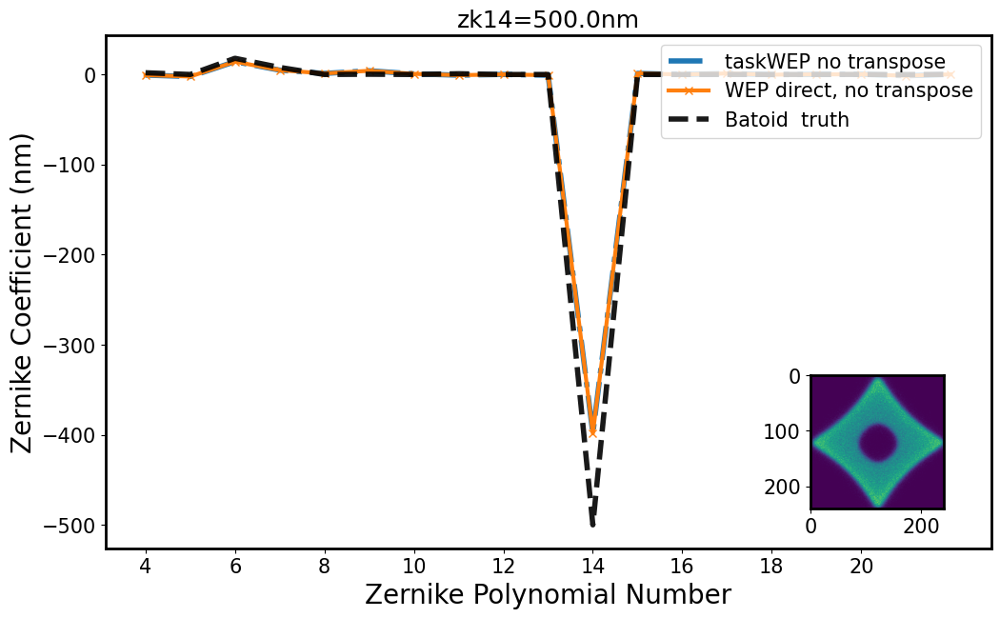

In [49]:
compare_wep_direct(zkNum = 14)

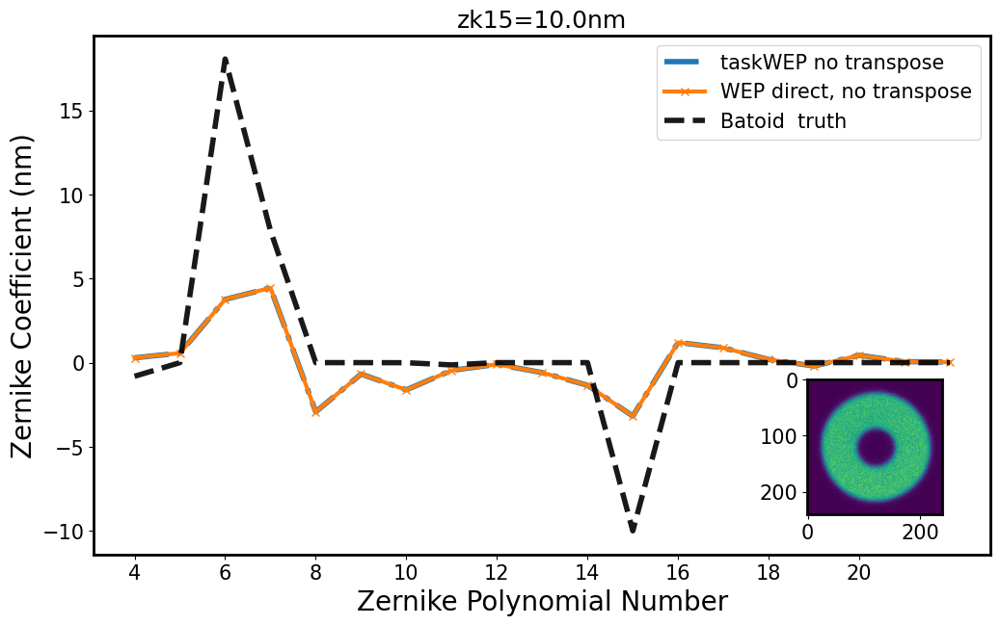

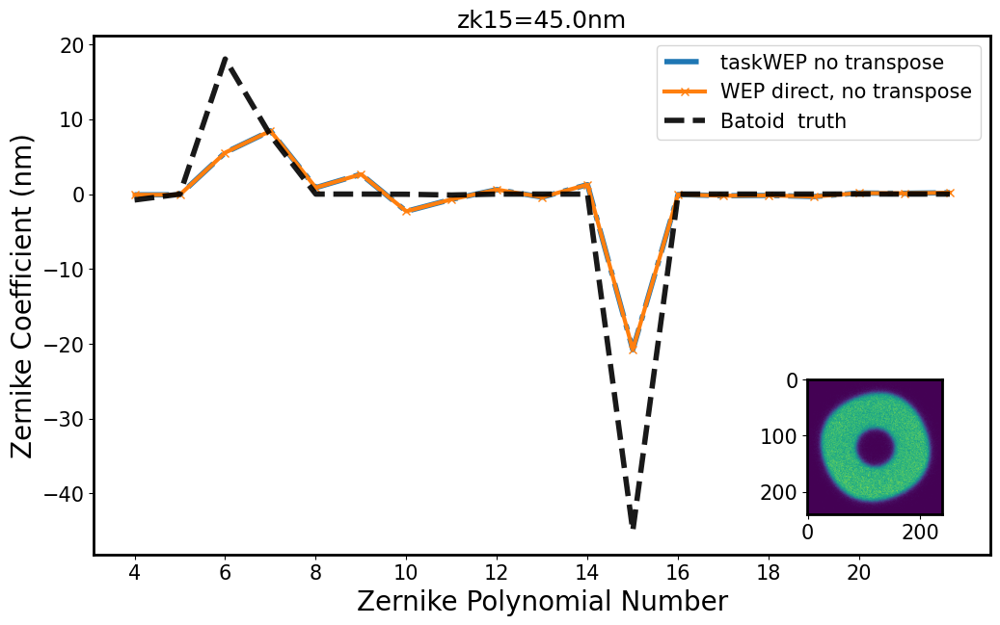

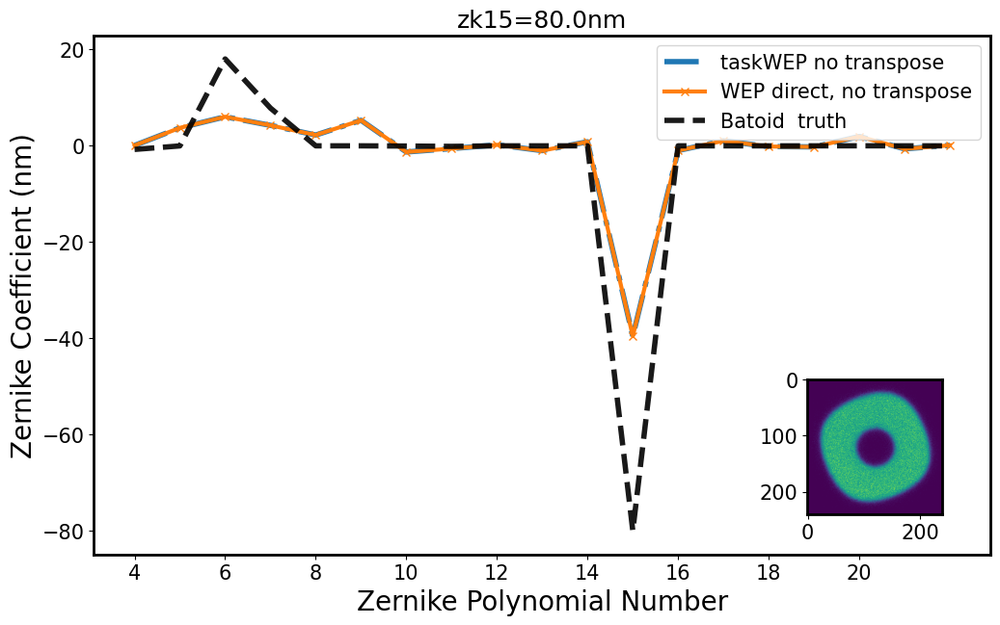

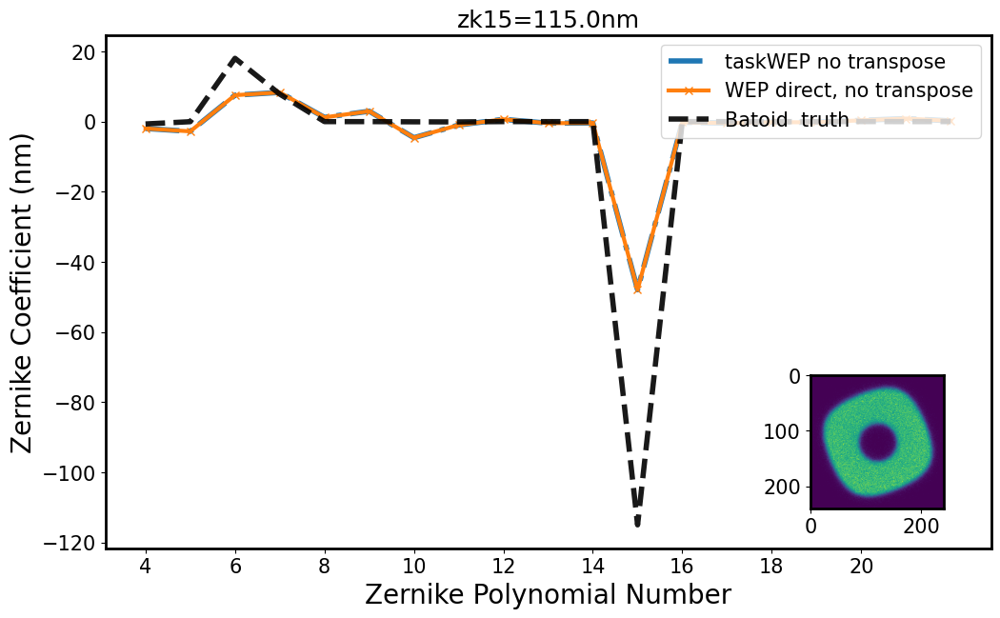

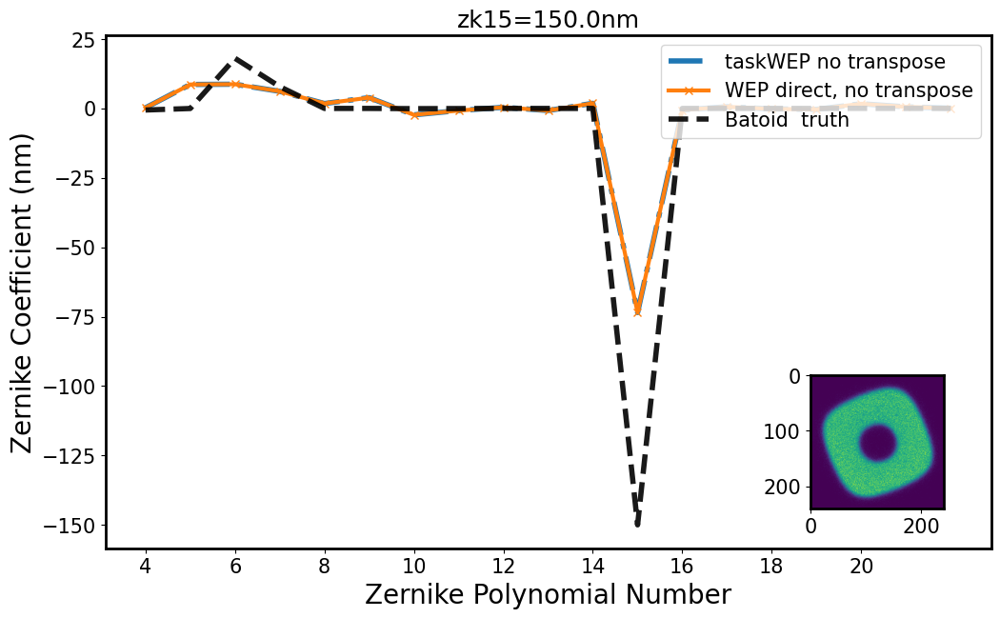

...

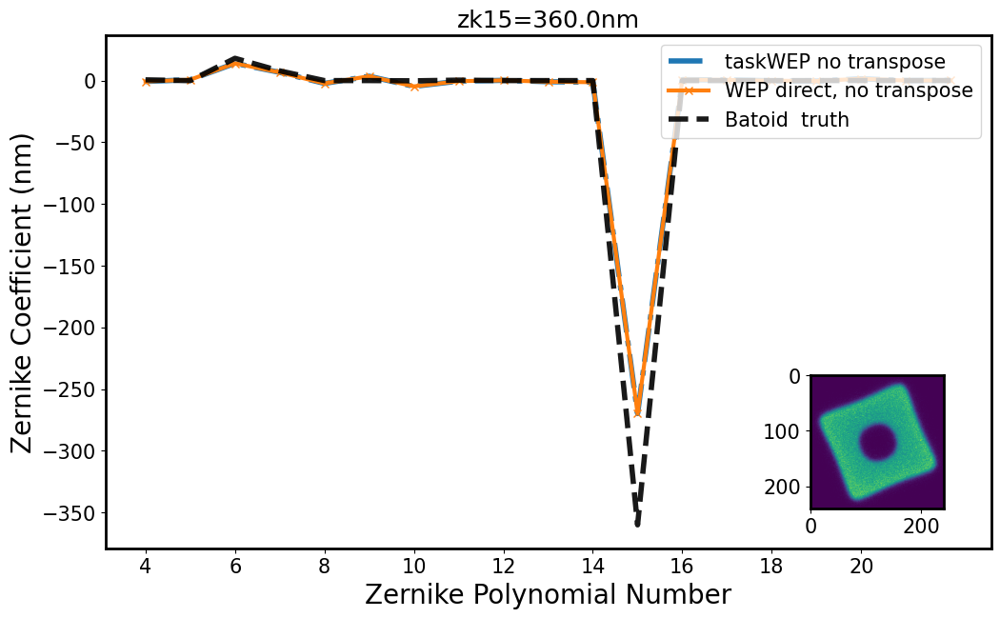

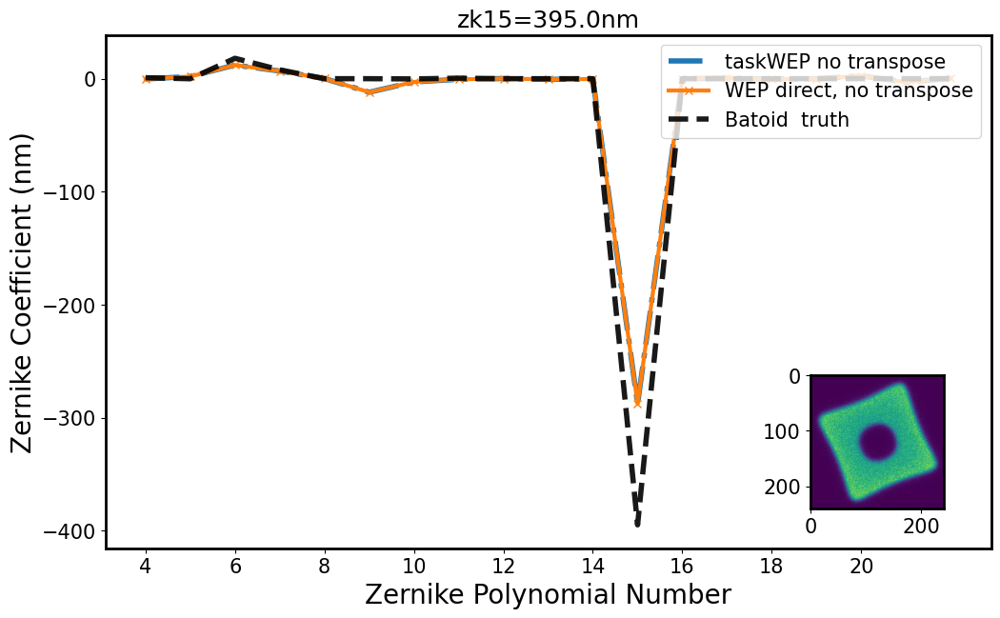

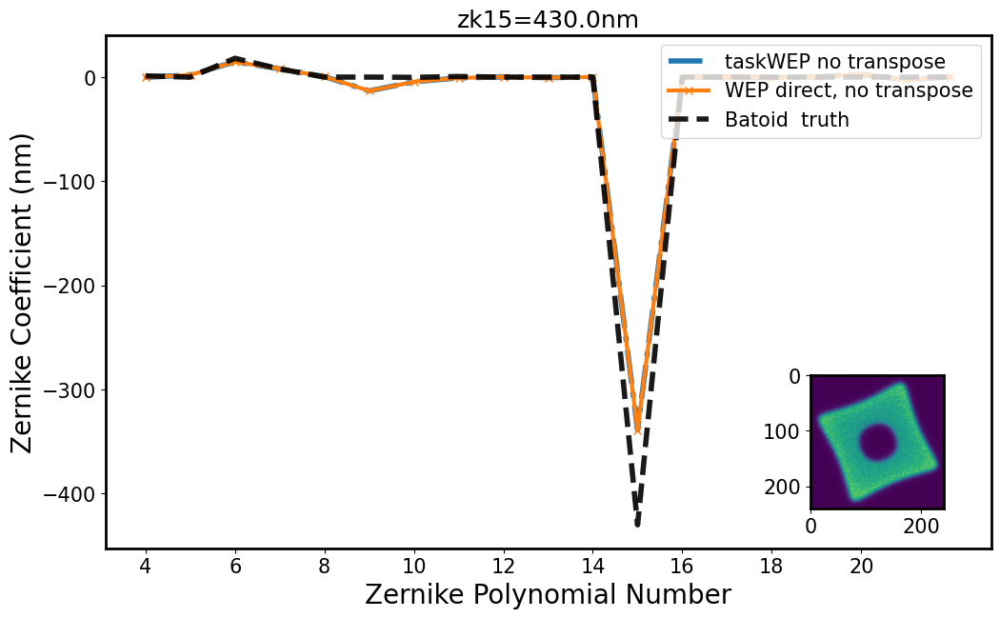

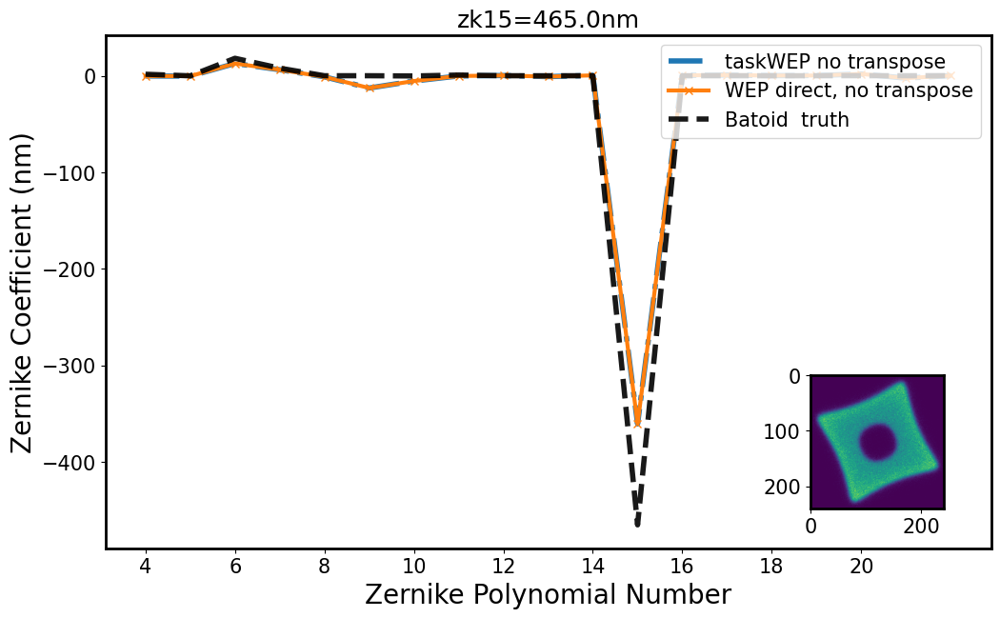

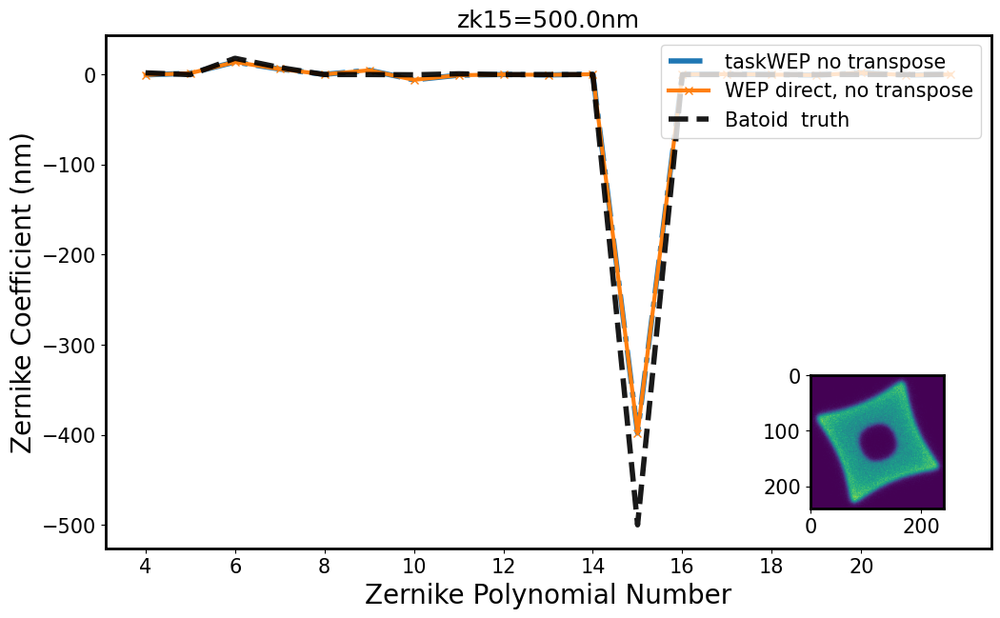

In [50]:
compare_wep_direct(zkNum = 15)

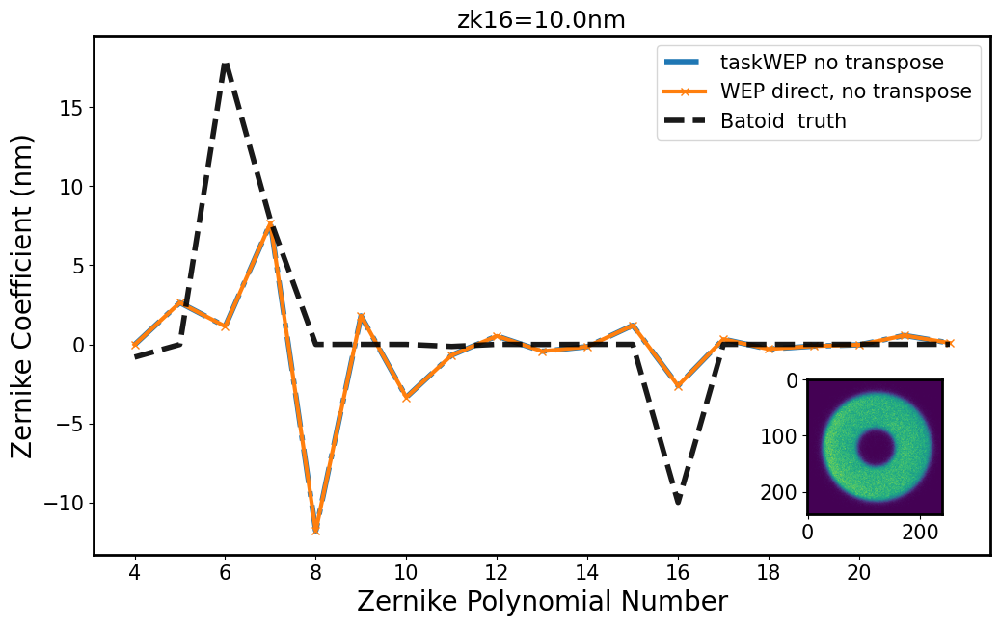

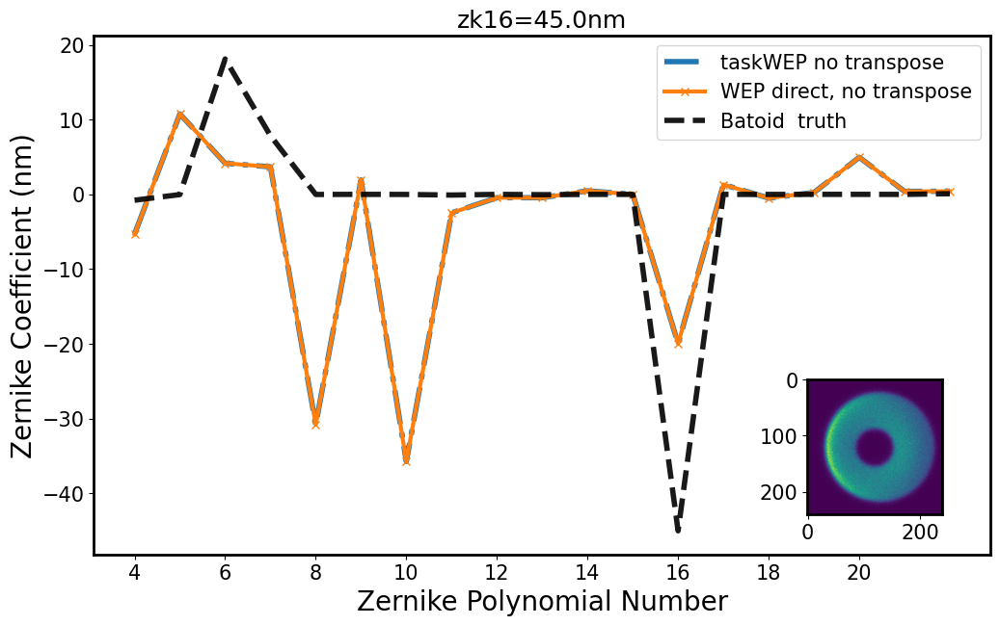

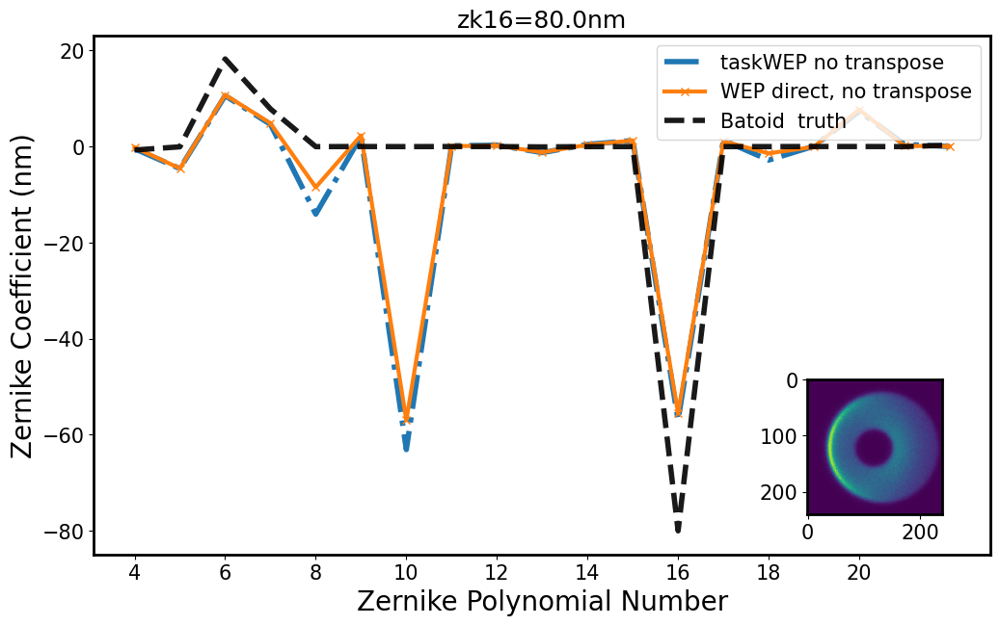

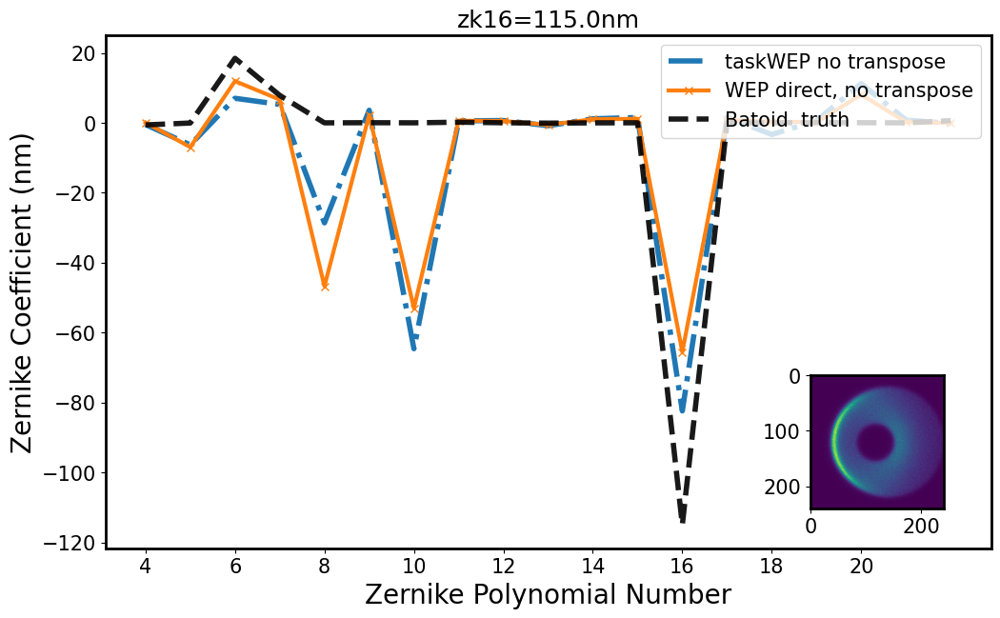

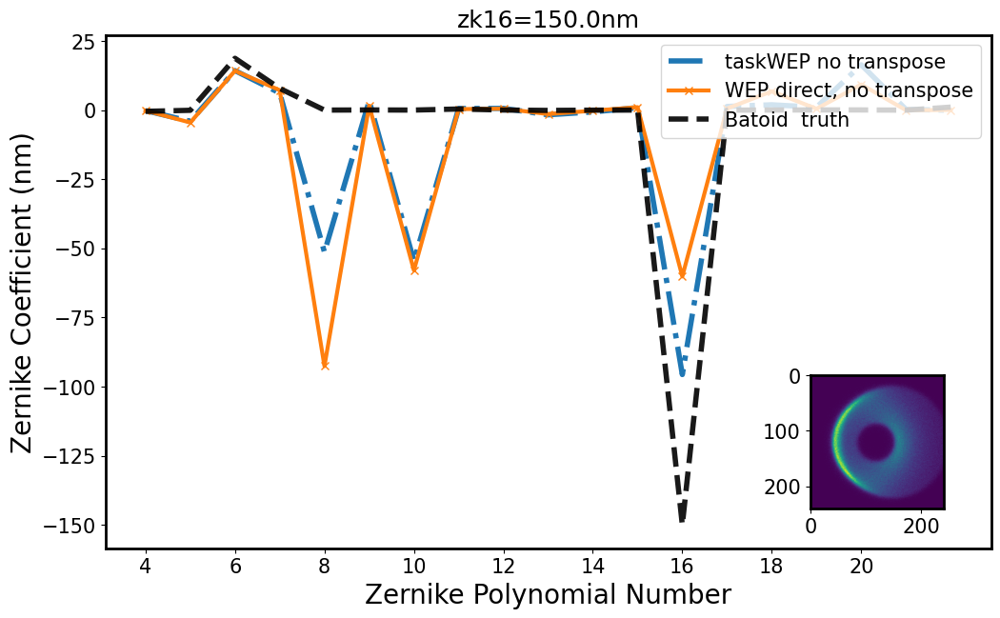

...

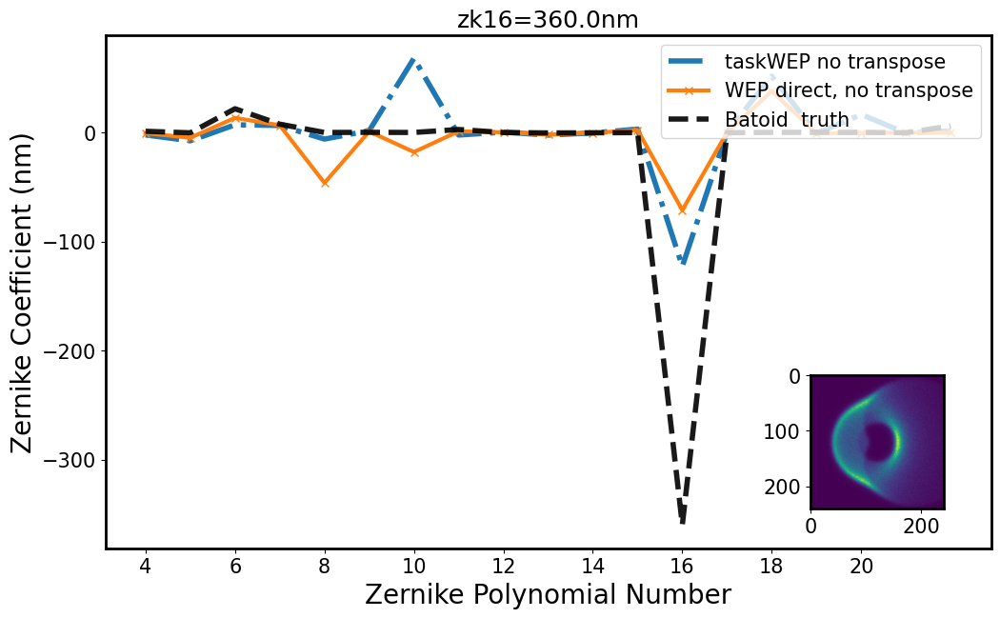

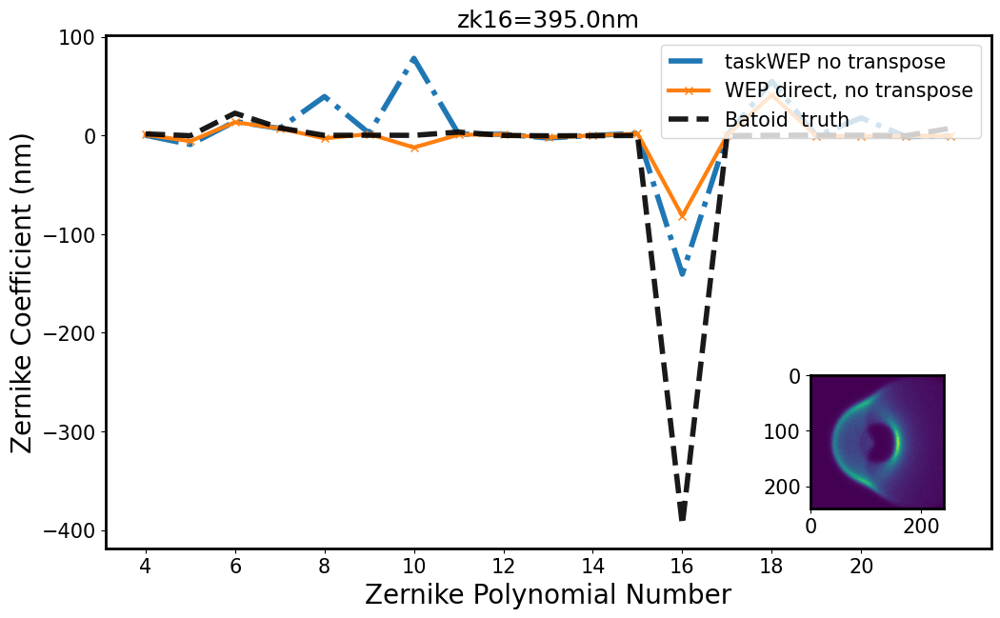

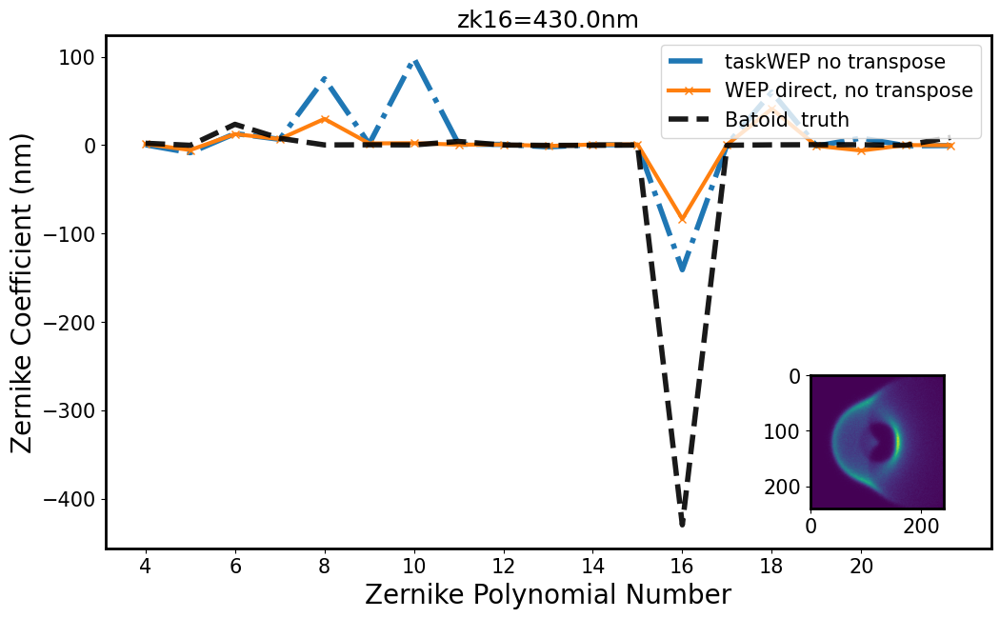

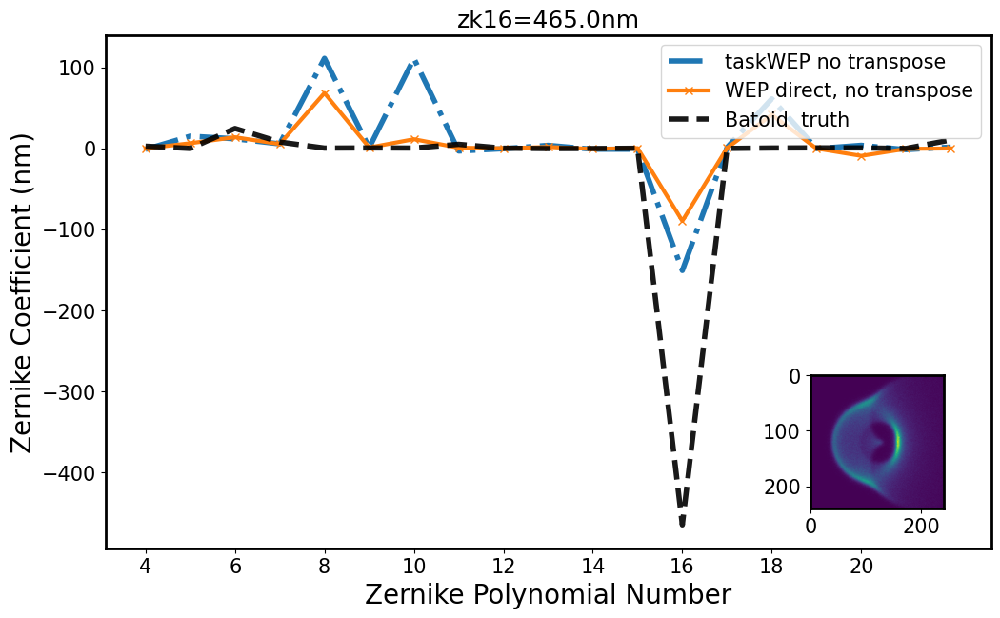

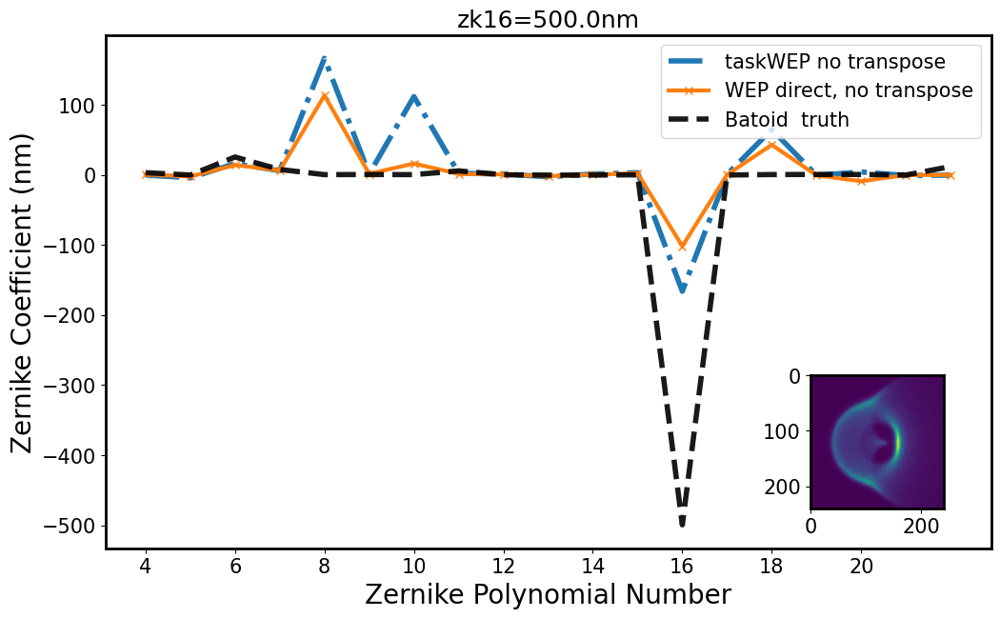

In [51]:
compare_wep_direct(zkNum = 16)

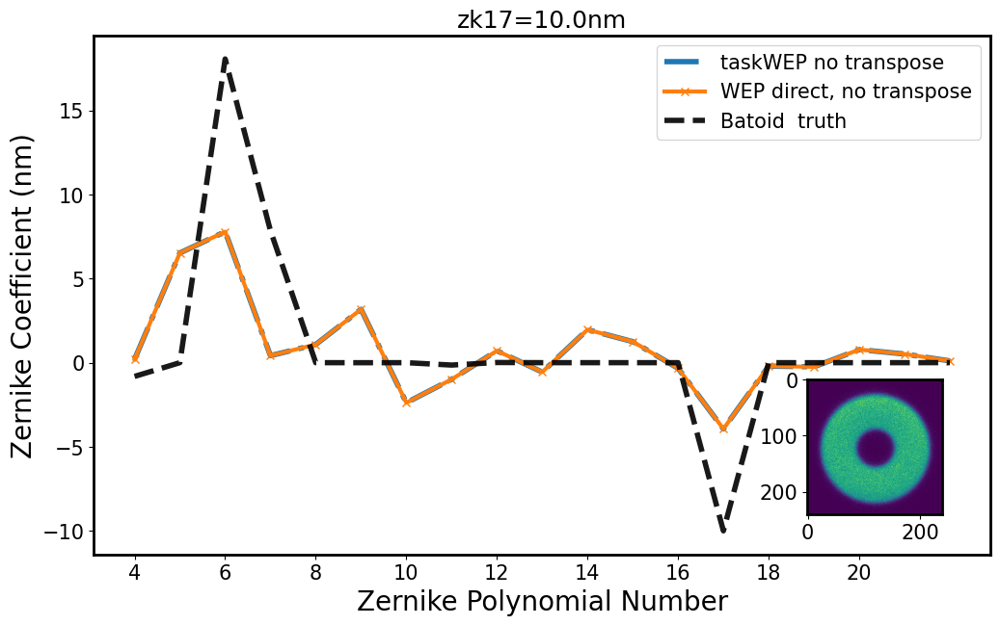

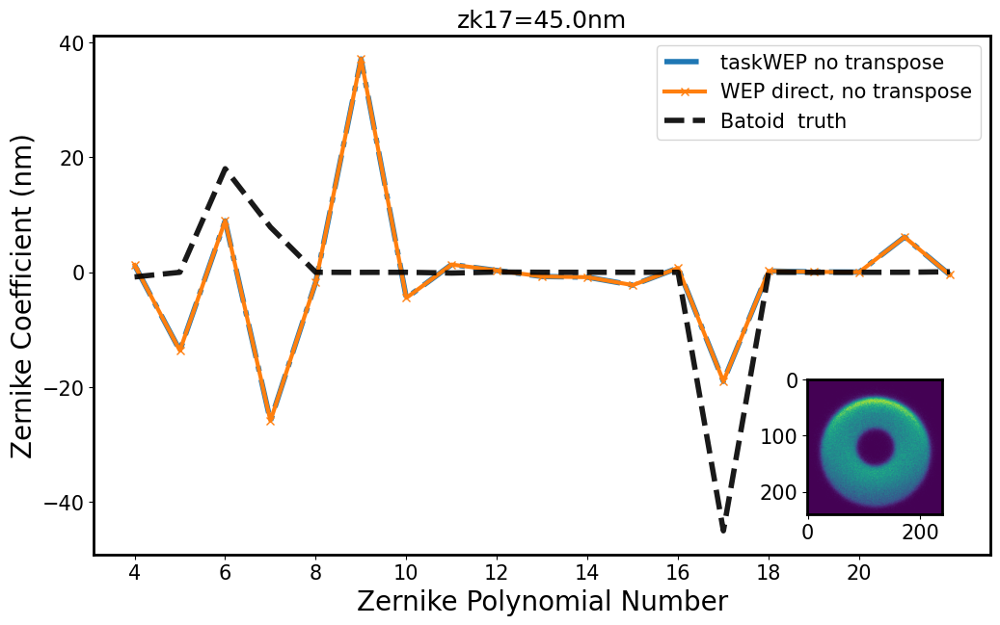

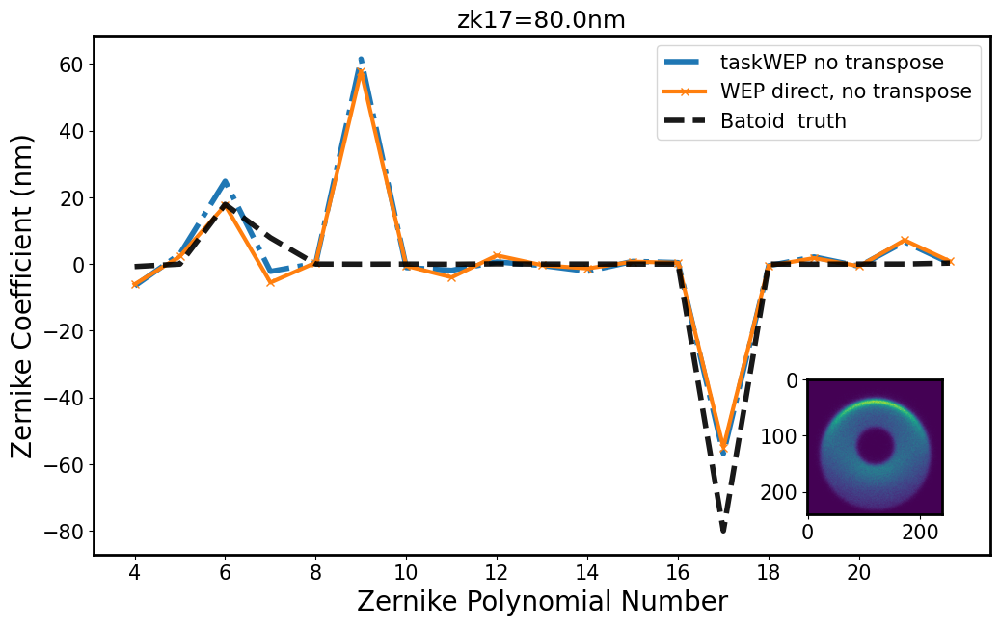

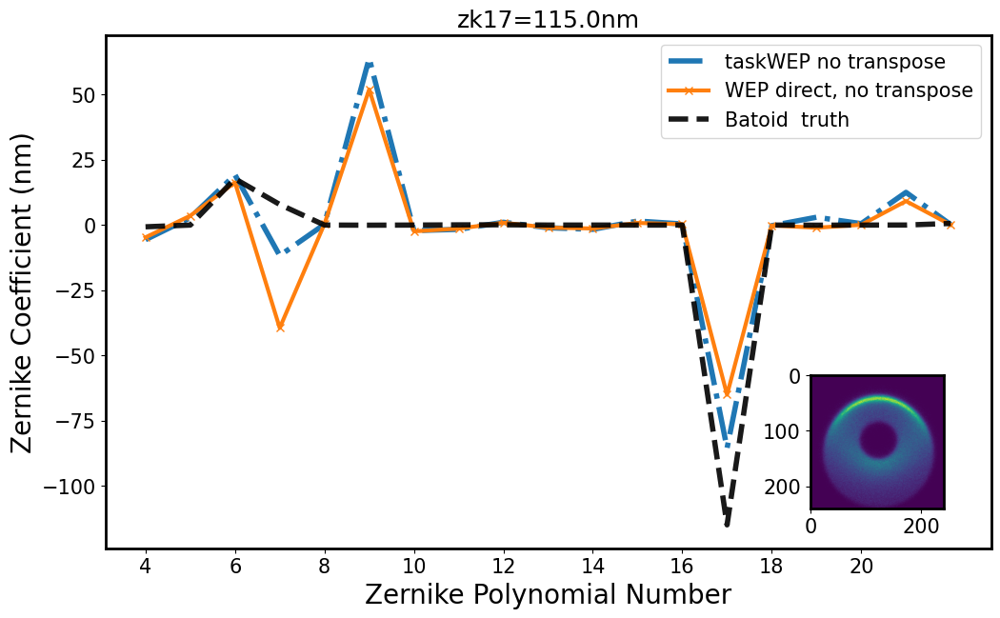

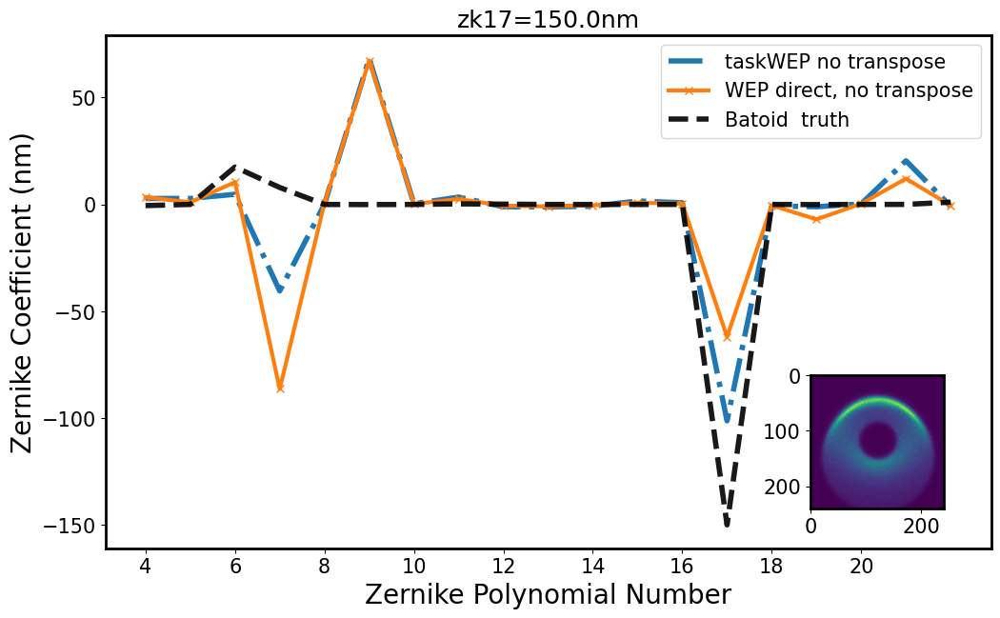

...

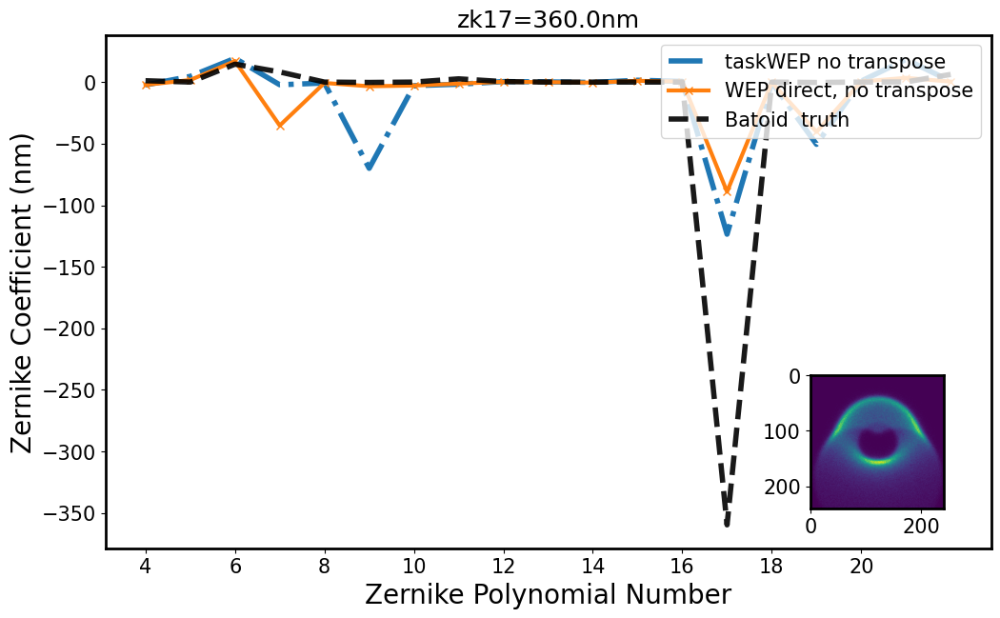

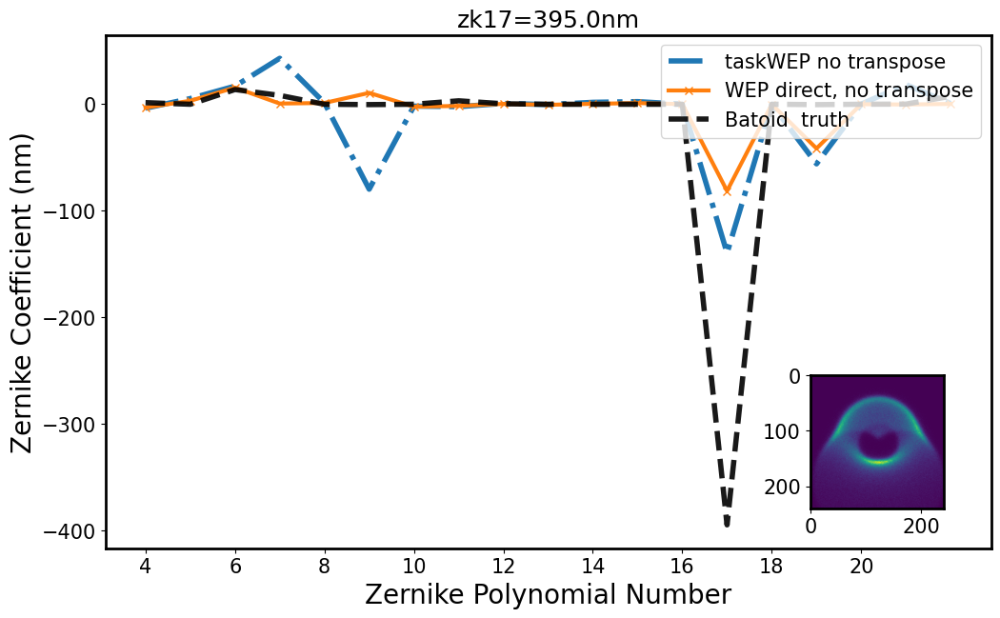

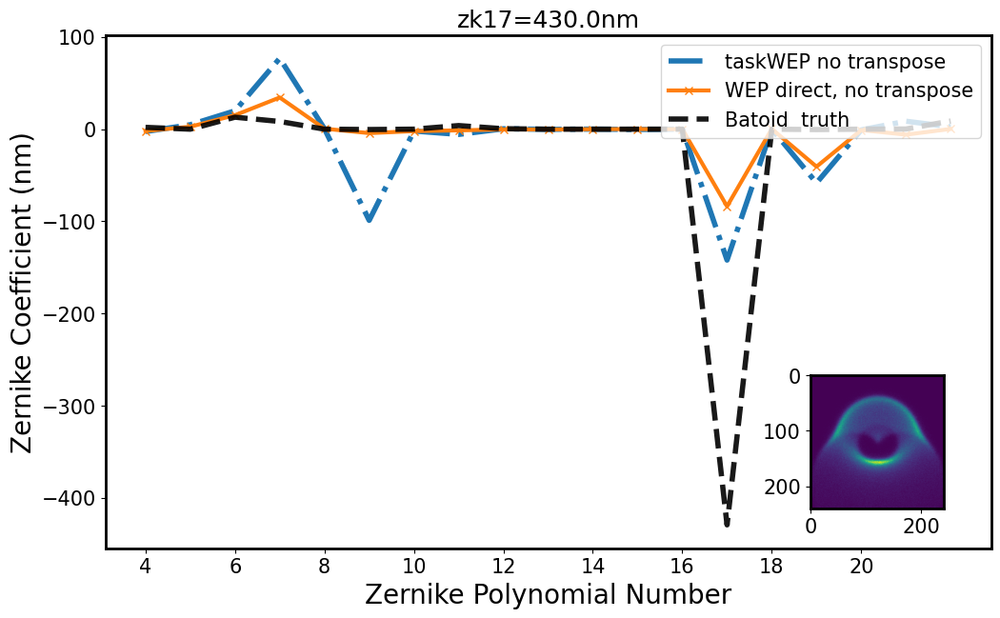

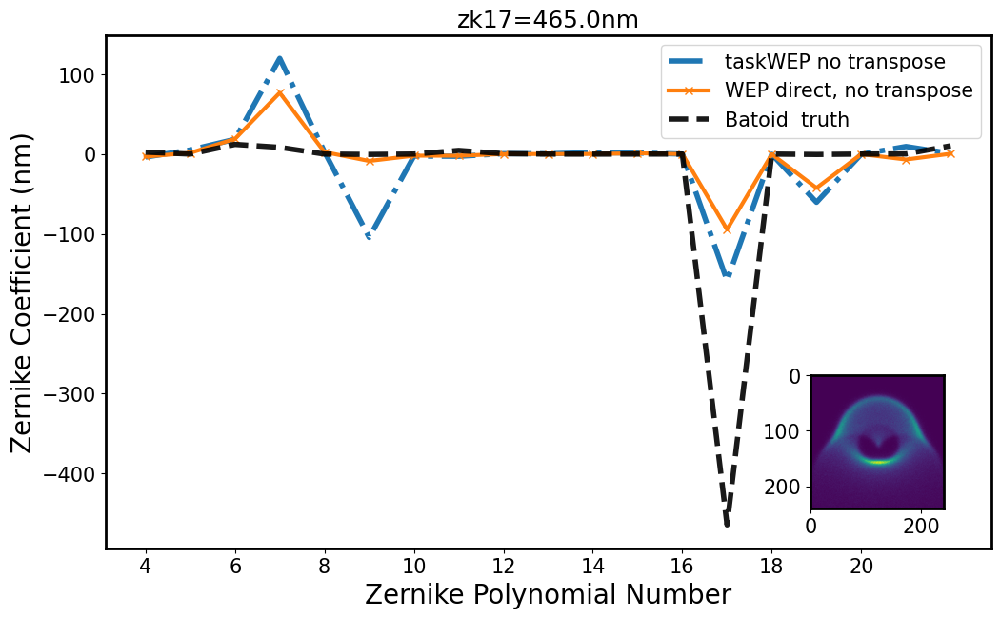

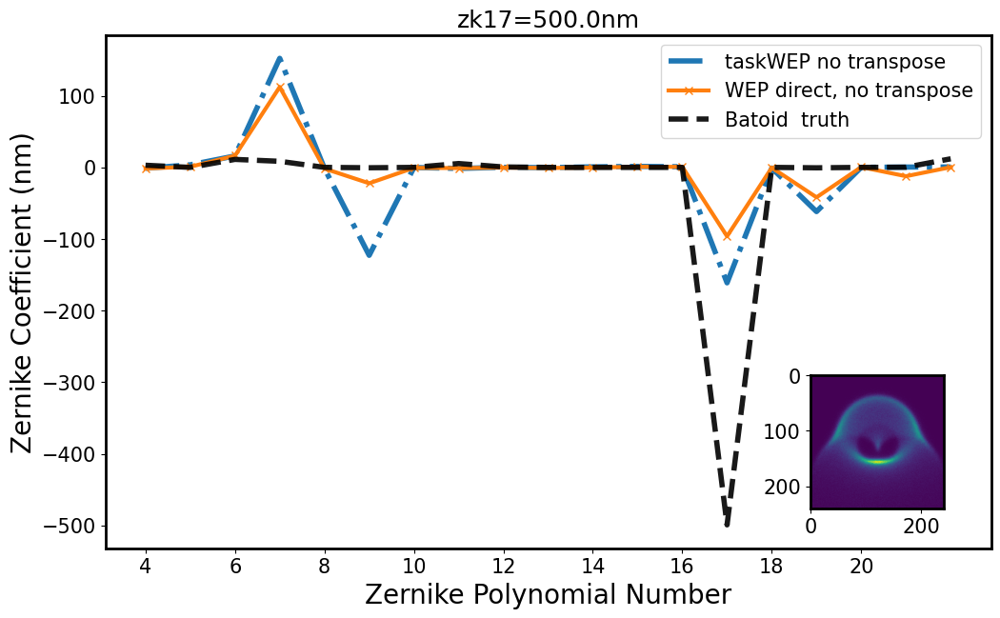

In [52]:
compare_wep_direct(zkNum = 17)

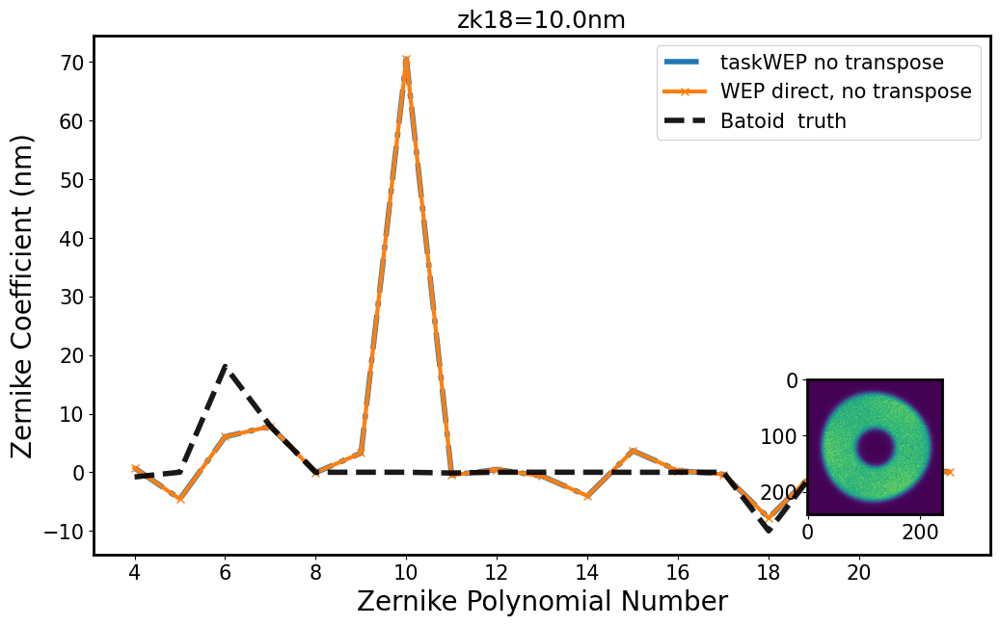

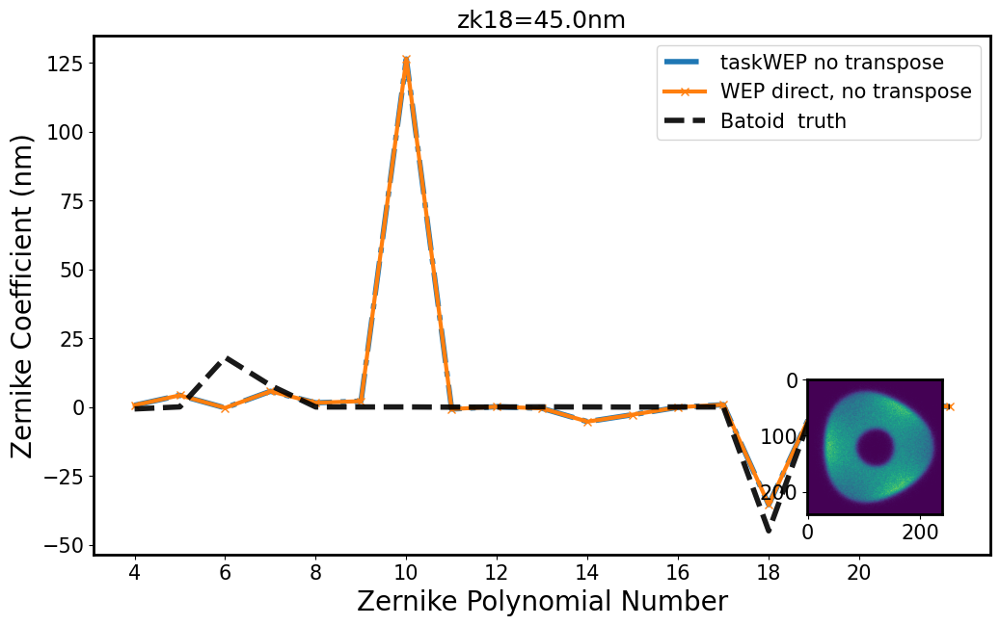

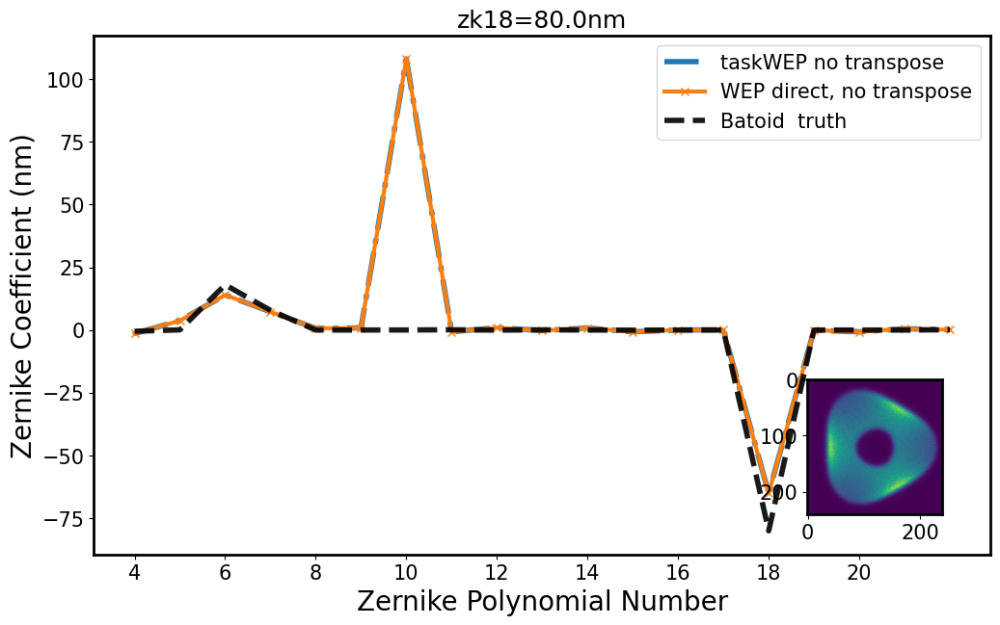

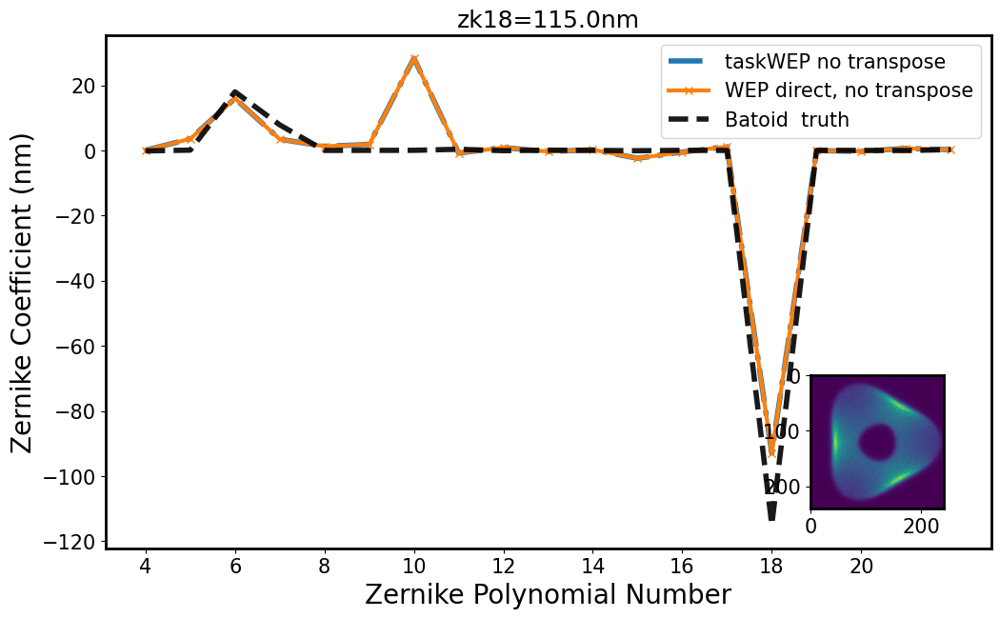

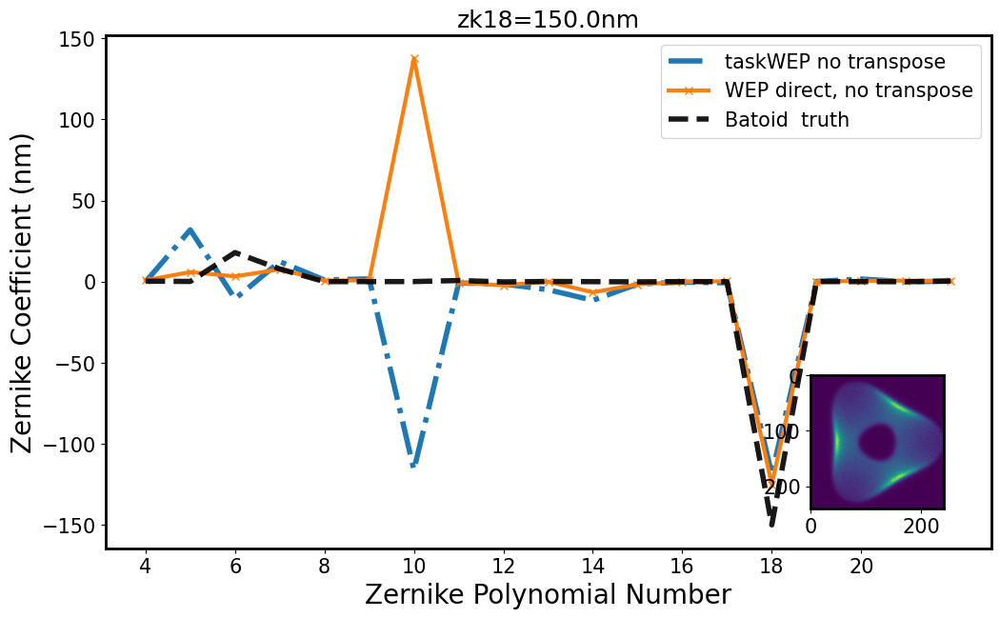

...

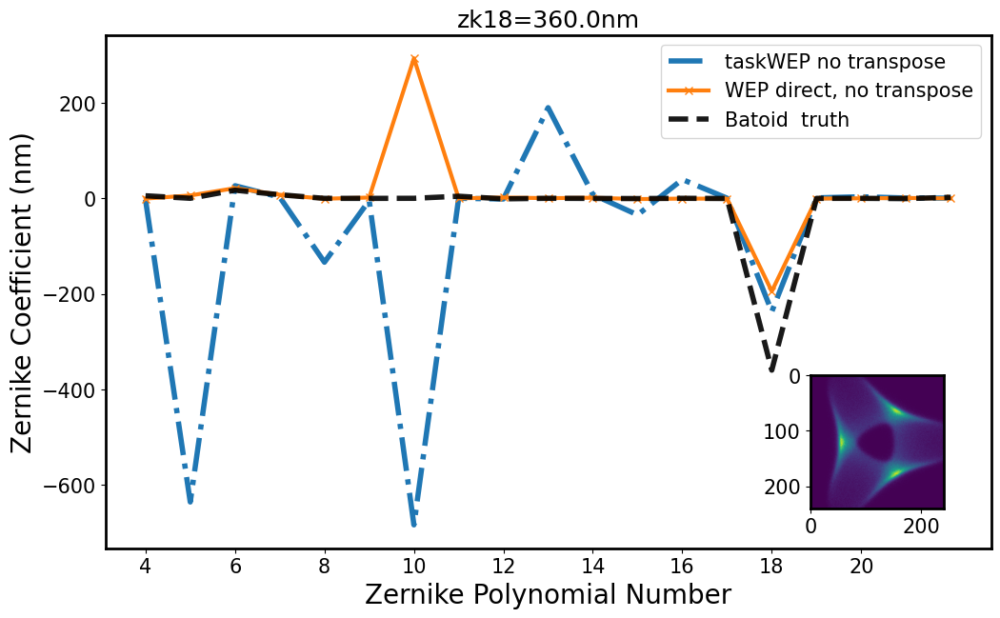

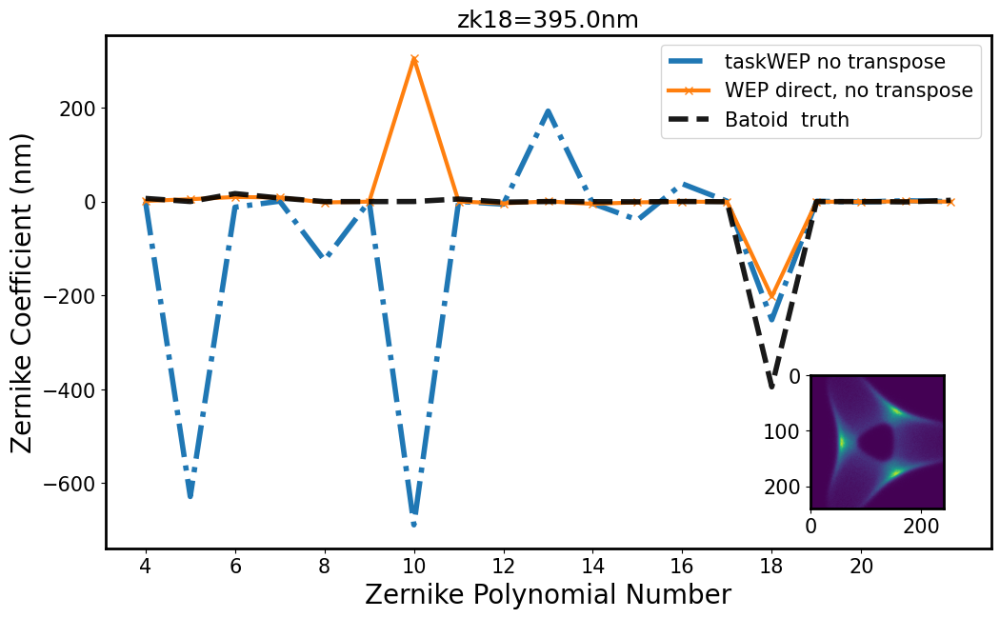

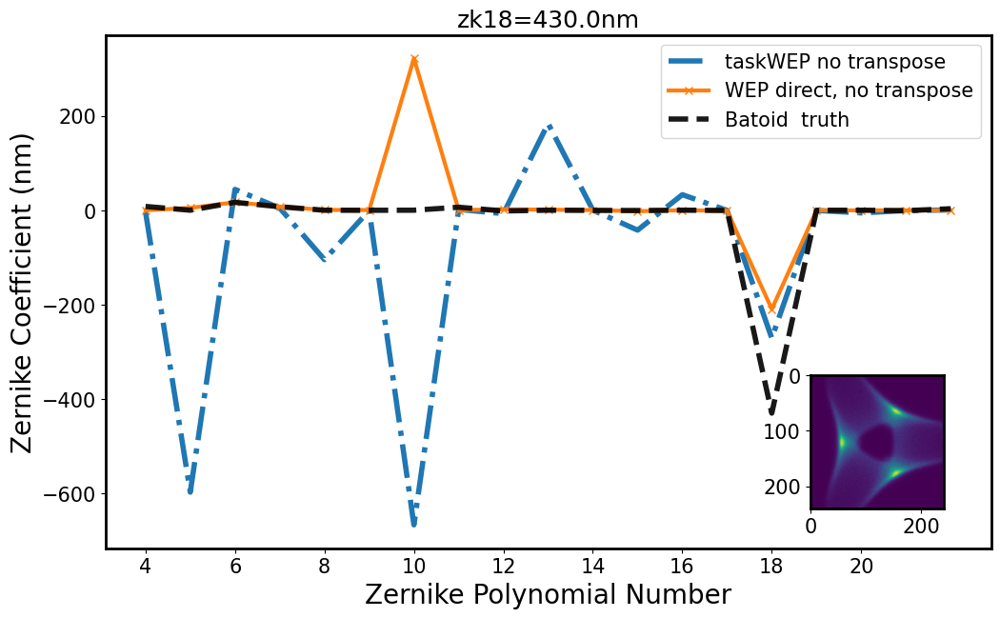

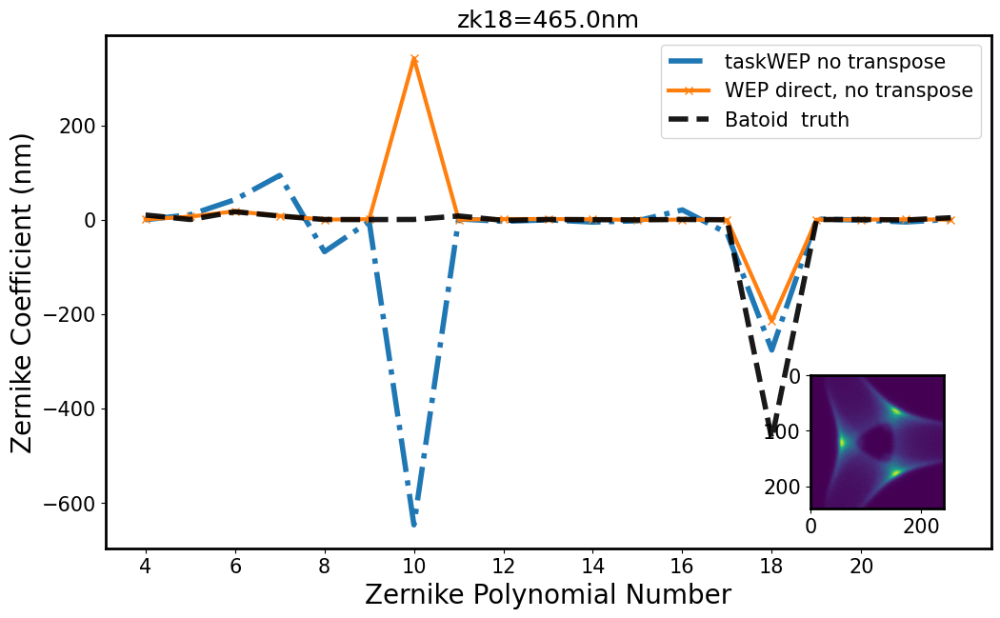

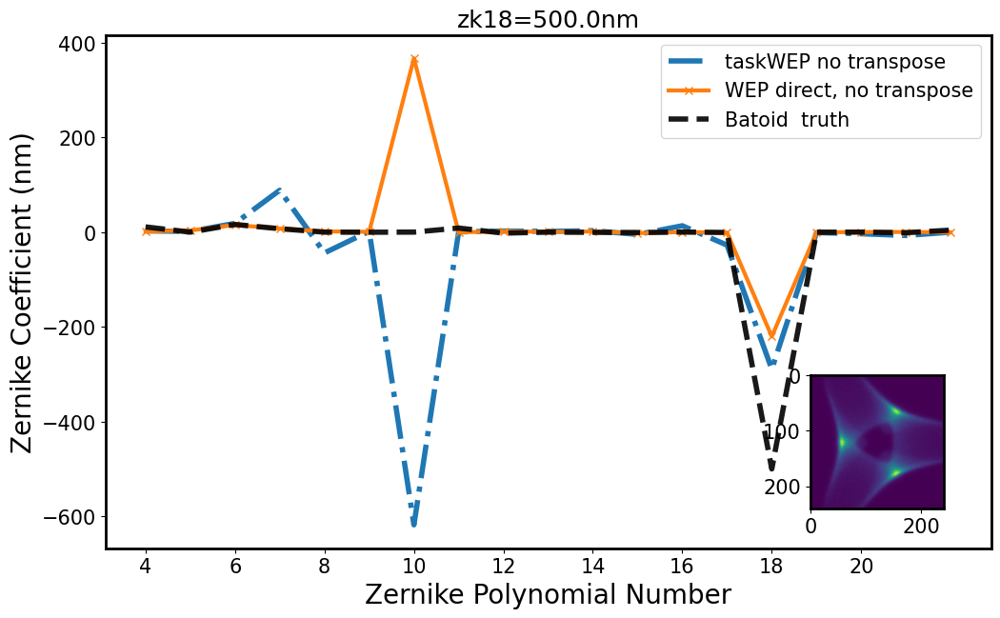

In [53]:
compare_wep_direct(zkNum = 18)

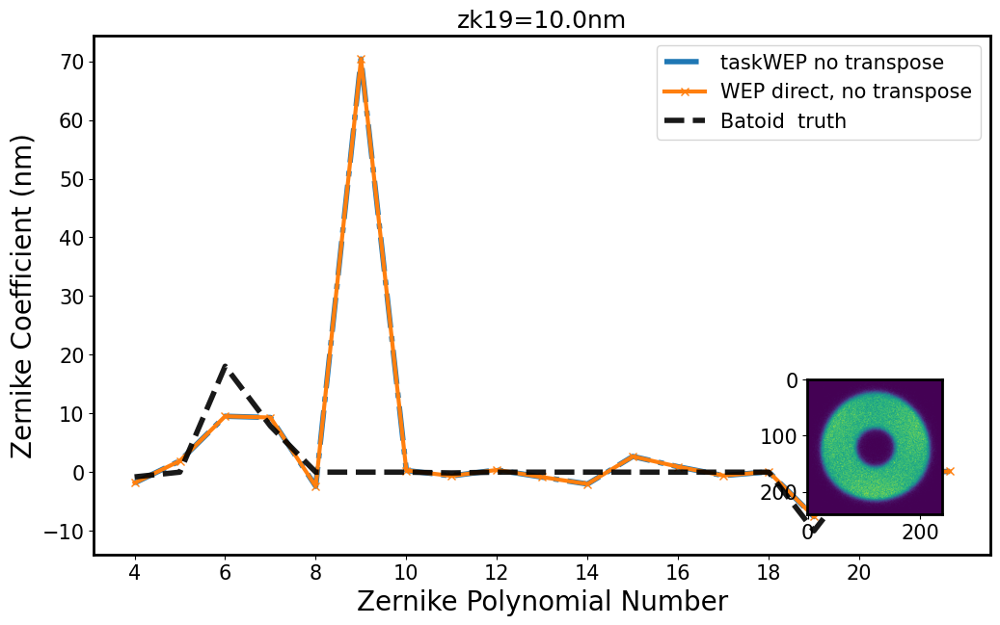

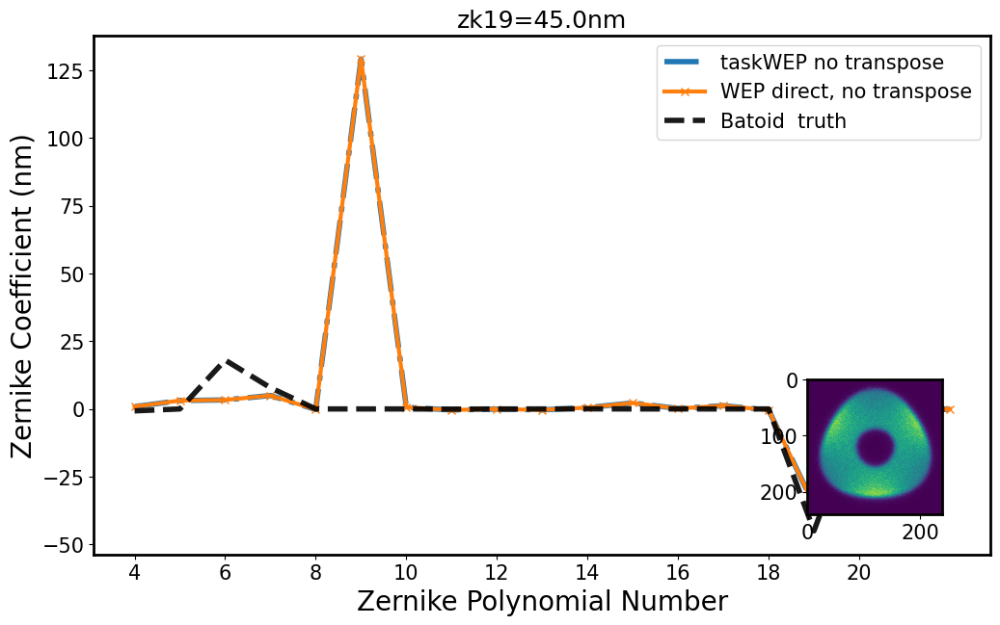

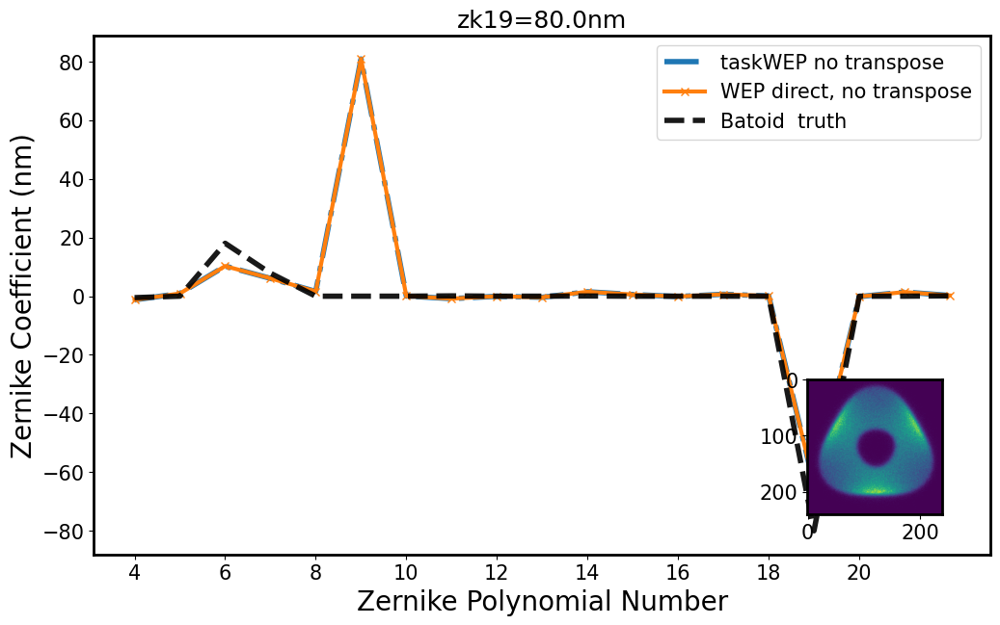

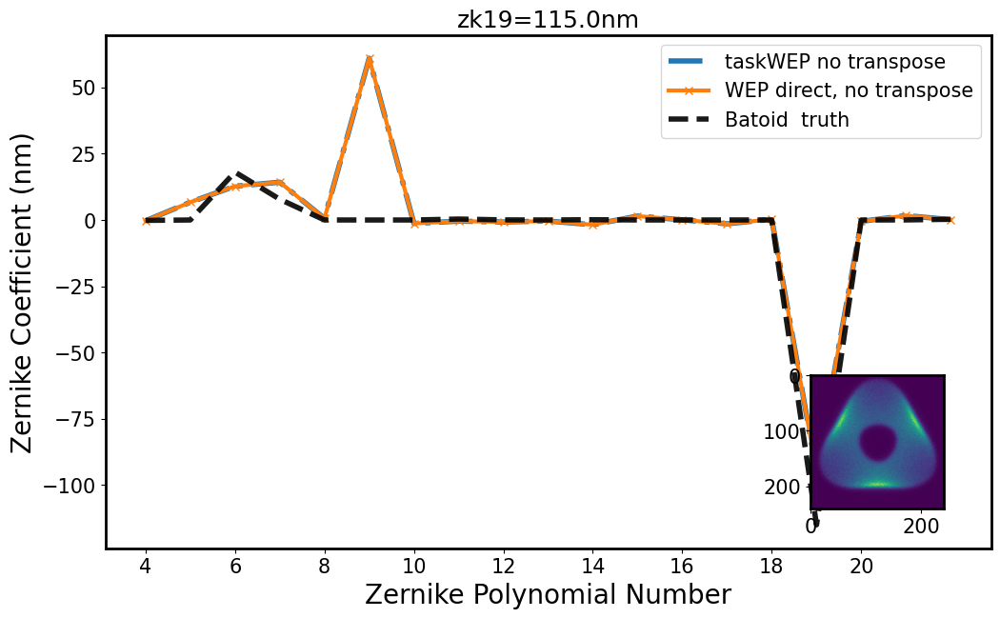

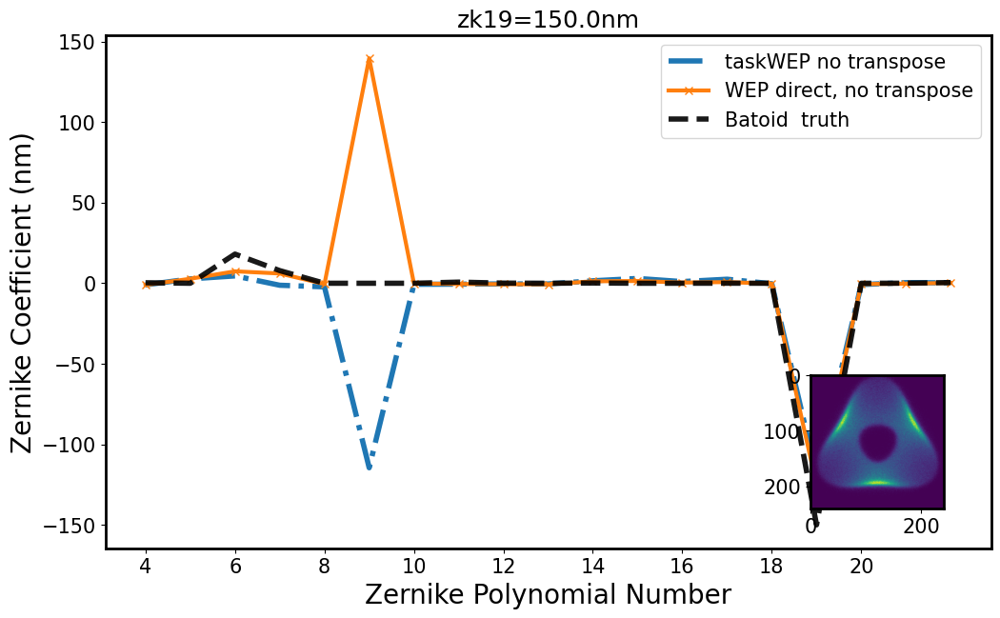

...

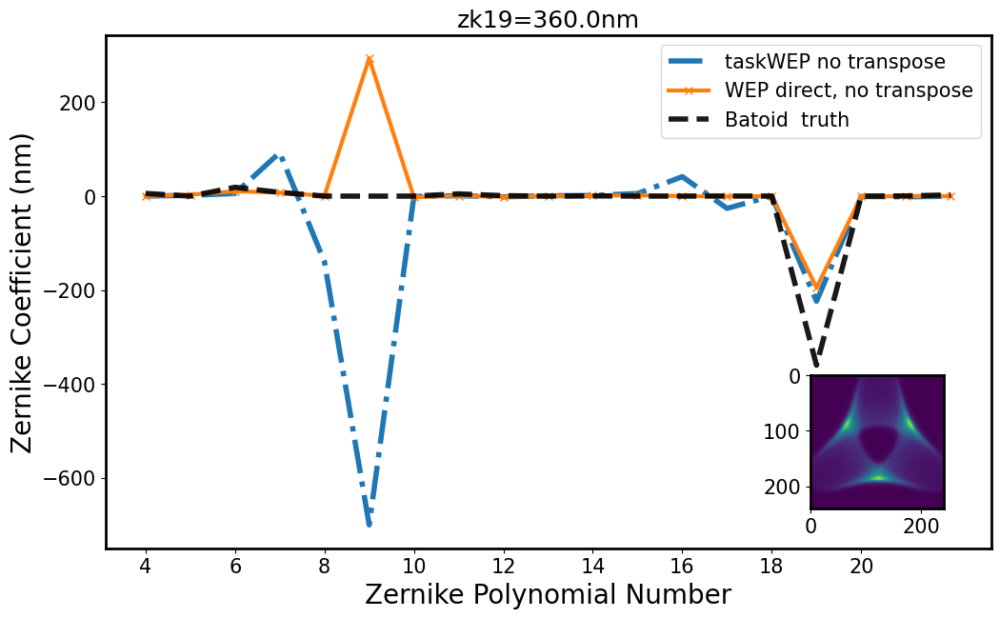

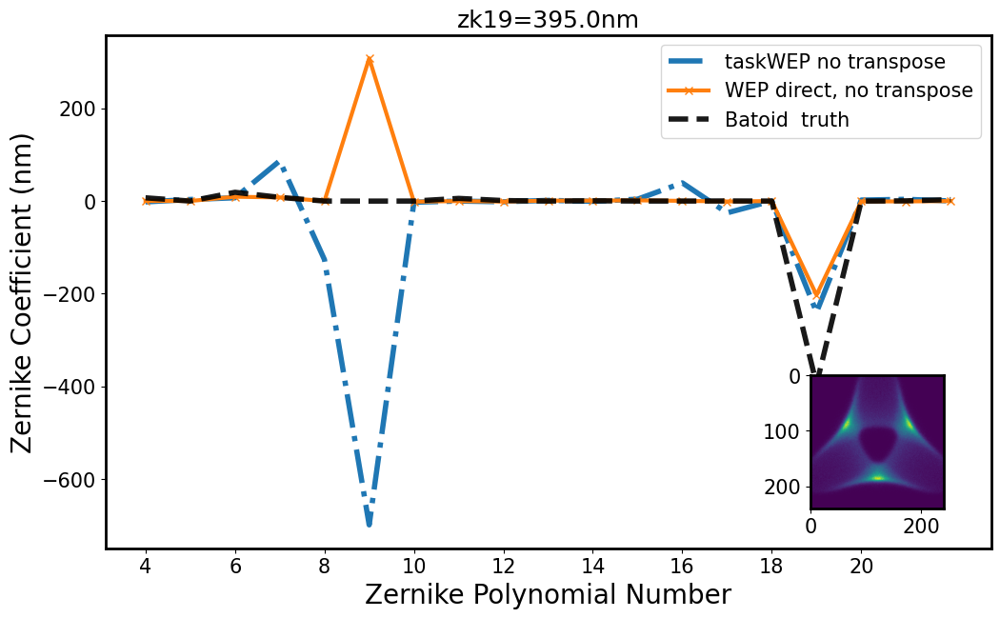

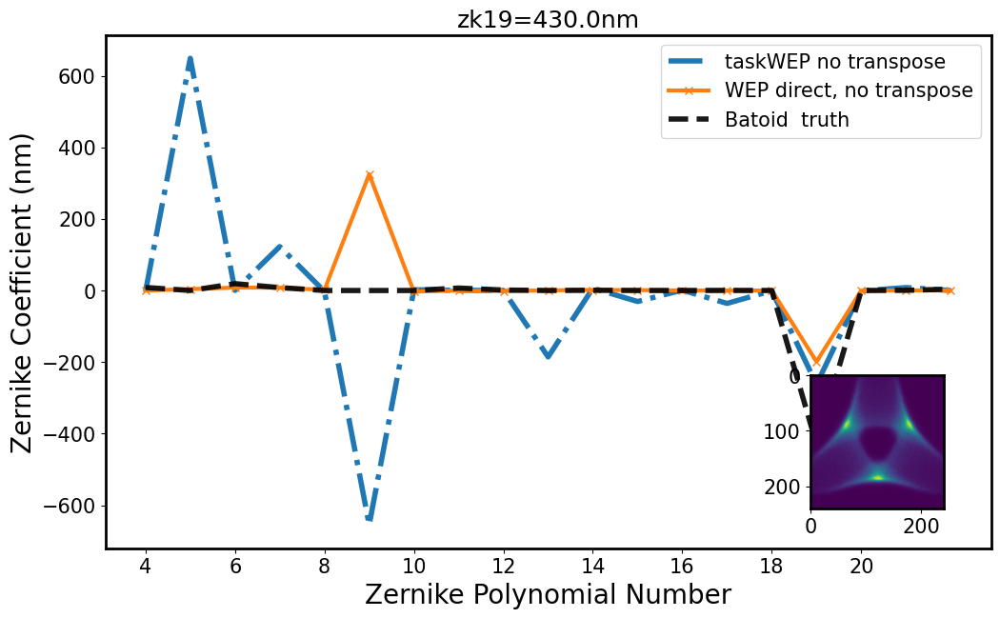

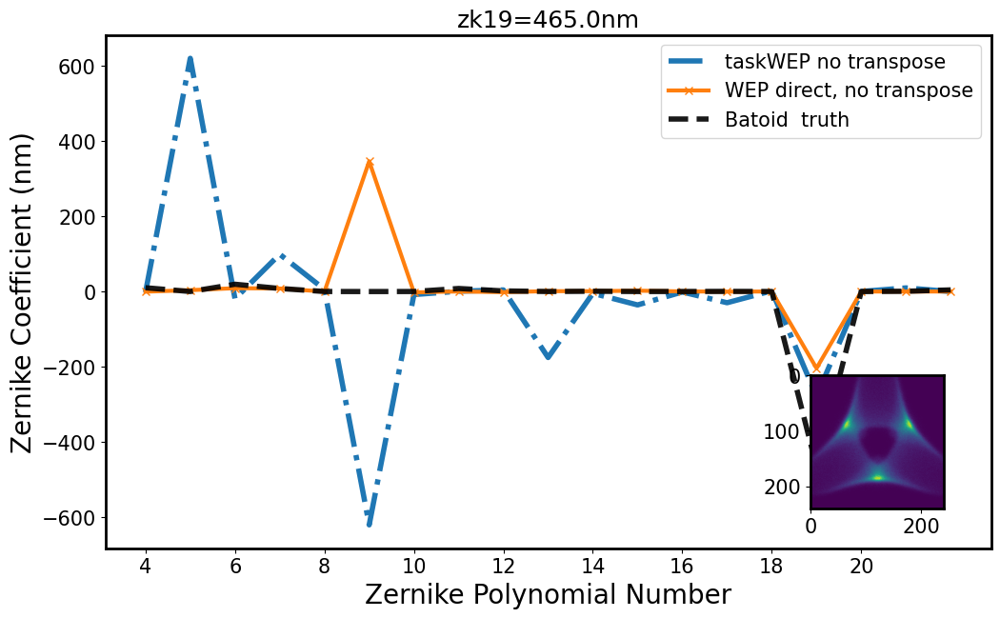

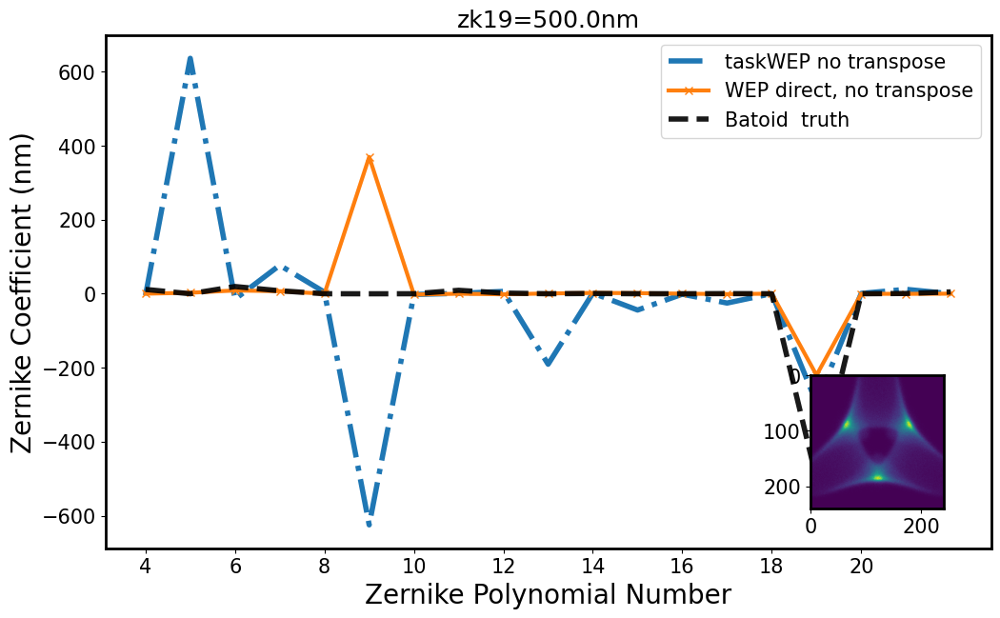

In [54]:
compare_wep_direct(zkNum = 19)

ok I think I see what's going on : the more zk11, the bigger the donut. So the donut cutout becomes too small! 

Calculate RMS difference (truth-fit)   for all Zernikes, as well as difference (truth-fit) for the injected Zk coefficient.

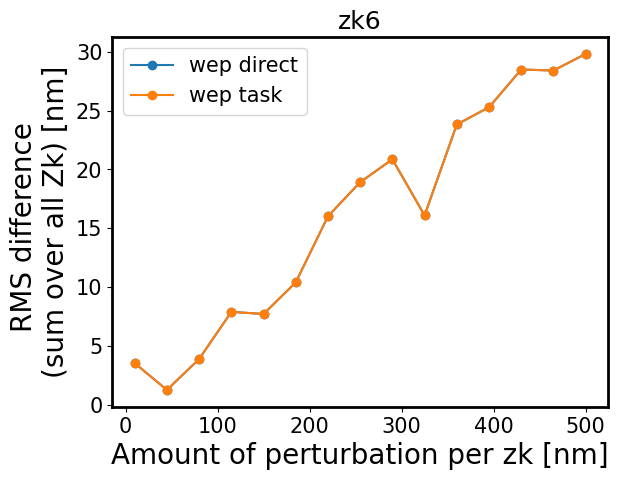

In [58]:
for zkNum = 6

fpath = os.path.join('DM-37629',f'auxtel_batoid_zk{zkNum}_500px_result_wep_no_transpose.npz')
file = np.load(fpath,allow_pickle=True)
results = file['results'].item()

fpath = os.path.join('DM-37629',f'auxtel_batoid_zk{zkNum}_500px_result_wep_cwfs_direct.npz')
file = np.load(fpath,allow_pickle=True)
resultsD = file['directresults'].item()

diffRms = {'zkMagNm':[],'wepDirect':[], 'wepTask':[]}
diffPerZk = {'zkMagNm':[], 'wepDirect':[], 'wepTask':[]}


position = zkNum - 4 # batoid starts from zk4
for f in np.linspace(minMagnitudeNm, maxMagnitudeNm, 15):

    zkTask = results[f]['zernOutAvg']*1e3 # WEP task nm 
    zkWep = resultsD[f]['wepZk'] # WEP direct nm 
    zk0 = results[f]['truth'][4:]*1e9 # batoid truth in nm 
   
    diffRmsW0 = np.sqrt(np.sum(np.abs(zkWep - zk0) ** 2) / len(zk0))
    diffRmsT0 = np.sqrt(np.sum(np.abs(zkTask - zk0) ** 2) / len(zk0))
    
    diffRms['wepDirect'].append(diffRmsW0)
    diffRms['wepTask'].append(diffRmsT0)
    diffRms['zkMagNm'].append(f)
    
    diffPerZk['wepDirect'].append(abs(zkWep[position]-zk0[position]))
    diffPerZk['wepTask'].append(abs(zkTask[position]-zk0[position]))
    diffPerZk['zkMagNm'].append(f)
    
plt.plot(diffRms['zkMagNm'], diffRms['wepDirect'], ls='-', marker='o', label='wep direct')
plt.plot(diffRms['zkMagNm'], diffRms['wepTask'], ls='-', marker='o', label='wep task')
plt.xlabel('Amount of perturbation per zk [nm]')
plt.ylabel('RMS difference \n(sum over all Zk) [nm]')
plt.title(f'zk{zkNum}')
plt.legend()